In [1]:
import math
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow import keras 

from tensorflow.python.keras import backend as K
import seaborn as sns

from tensorflow.python.keras.layers import Input, Dense,LSTM,GRU
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt
from skopt import gbrt_minimize, gp_minimize
from skopt.utils import use_named_args
from skopt.space import Real, Categorical, Integer 
plt.style.use('fivethirtyeight')

In [2]:
df = pd.read_excel('oil_date.xlsx')
df.head()

,date,oil
0,2021-06-24,0.19
1,2021-06-25,0.57
2,2021-06-26,1.03
3,2021-06-27,1.38
4,2021-06-28,1.42


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 633 entries, 0 to 632
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    633 non-null    datetime64[ns]
 1   oil     633 non-null    float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 10.0 KB


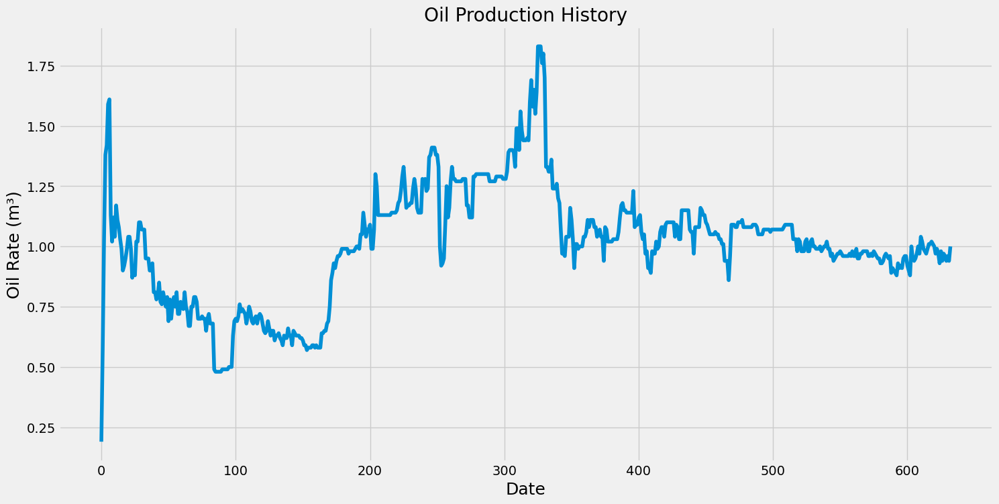

In [4]:
plt.figure(figsize=(16,8))
plt.title('Oil Production History')
plt.plot(df['oil'])
plt.xlabel('Date',fontsize=18)
plt.ylabel('Oil Rate (m³)',fontsize=18)
plt.show()

In [5]:
#Create a new dataframe with only the 'Close' column
data = df.filter(['oil'])
#Converting the dataframe to a numpy array
dataset = data.values
#Get /Compute the number of rows to train the model on
training_data_len = math.ceil( len(dataset) *.8) 

In [6]:
#Scale the all of the data to be values between 0 and 1 
scaler = MinMaxScaler(feature_range=(0, 1)) 
scaled_data = scaler.fit_transform(dataset)

In [7]:
#Create the scaled training data set 
train_data = scaled_data[0:training_data_len  , : ]
#Split the data into x_train and y_train data sets
x_train = []
y_train = []
for i in range(100,len(train_data)):
    x_train.append(train_data[i-100:i,0])
    y_train.append(train_data[i,0])

In [8]:
#Convert x_train and y_train to numpy arrays
x_train, y_train = np.array(x_train), np.array(y_train)

In [9]:
#Reshape the data into the shape accepted by the LSTM
x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))

In [10]:
print(x_train.shape)

(407, 100, 1)


In [11]:
'''
dim_learning_rate = Real(low=1e-4, high=1e-3, prior='log-uniform',
                         name='learning_rate')
dim_batch_size = Integer(low=16, high=32, name='batch_size')
dim_adam_decay = Real(low=1e-2,high=1e-1,name="decay")
dimensions = [dim_learning_rate,
              dim_batch_size,
              dim_decay,
             ]
default_parameters = [0.001, 15, 0.08]
'''

'\ndim_learning_rate = Real(low=1e-4, high=1e-3, prior=\'log-uniform\',\n                         name=\'learning_rate\')\ndim_batch_size = Integer(low=16, high=32, name=\'batch_size\')\ndim_adam_decay = Real(low=1e-2,high=1e-1,name="decay")\ndimensions = [dim_learning_rate,\n              dim_batch_size,\n              dim_decay,\n             ]\ndefault_parameters = [0.001, 15, 0.08]\n'

In [12]:
#Build the LSTM network model
#to have two LSTM layers with 50 neurons and two Dense layers, one with 25 neurons and the other with 1 neuron.
def LSTM_model(learning_rate):
    model = Sequential()
    model.add(keras.layers.LSTM(64, input_shape = (x_train.shape[1], 1),kernel_regularizer= 'l2',  return_sequences=True))
    
    model.add(keras.layers.Dense(32,activation='selu'))
    model.add(keras.layers.Dense(1,activation='linear'))
    optimizer = keras.optimizers.Adam(learning_rate = learning_rate)
    model.compile(loss = 'mse', optimizer = optimizer, metrics=['accuracy'])
    model.summary()
    return model

In [13]:
def fitness(x):
    
    learning_rate= x
    
    model = LSTM_model(learning_rate=learning_rate,
                       )
    

    #named blackbox becuase it represents the structure
    blackbox = model.fit(x=x_train,
                        y=y_train,
                        epochs=50,
                        batch_size=16,
                        validation_split=0.25,
                        )
    #return the validation accuracy for the last epoch.
    accuracy = blackbox.history['val_loss'][-1]

    # Print the classification accuracy.
    print()
    print("loss: {0:.2%}".format(accuracy))
    print()
    
    plt.plot(blackbox.history['loss'], label='train')
    plt.plot(blackbox.history['val_loss'], label='test')
    plt.legend()
    plt.show()
    # Delete the Keras model with these hyper-parameters from memory.
    del model
    
    # Clear the Keras session, otherwise it will keep adding new
    # models to the same TensorFlow graph each time we create
    # a model with a different set of hyper-parameters.
    K.clear_session()
    tf.compat.v1.reset_default_graph()
    
    # the optimizer aims for the lowest score, so we return our negative accuracy
    return accuracy

0.01
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 167ms/step - loss: 0.1180 - accuracy: 0.0036 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 91ms/step - loss: 0.0654 - accuracy: 0.0043 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

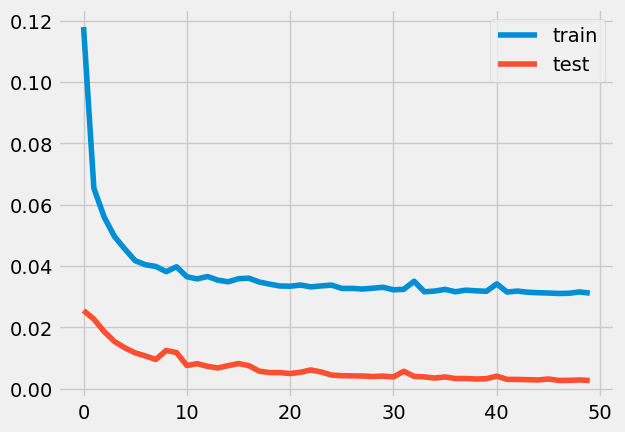

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 137ms/step - loss: 0.1391 - accuracy: 0.0027 - val_loss: 0.0278 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 78ms/step - loss: 0.0640 - accuracy: 0.0041 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

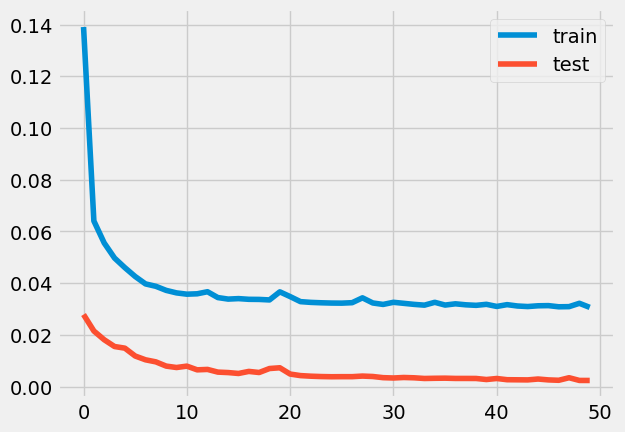

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 168ms/step - loss: 0.1270 - accuracy: 0.0000e+00 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0637 - accuracy: 0.0044 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

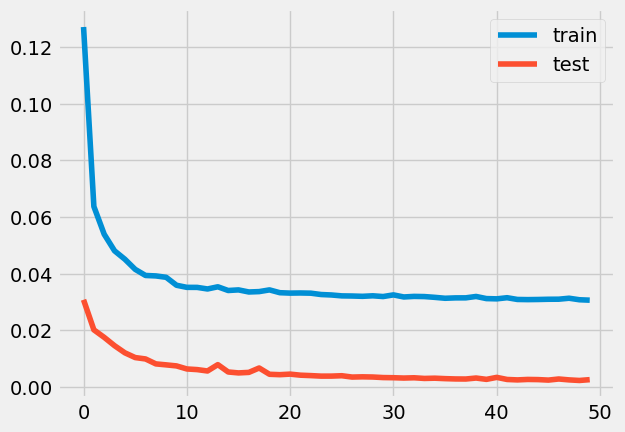

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 148ms/step - loss: 0.1837 - accuracy: 0.0033 - val_loss: 0.0363 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0619 - accuracy: 0.0042 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

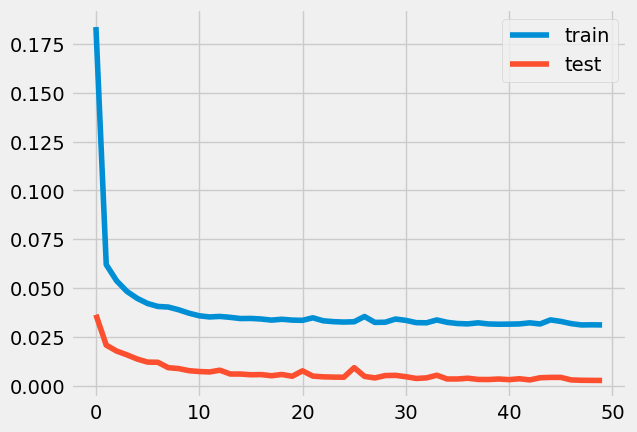

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 152ms/step - loss: 0.1130 - accuracy: 0.0036 - val_loss: 0.0264 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0621 - accuracy: 0.0049 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

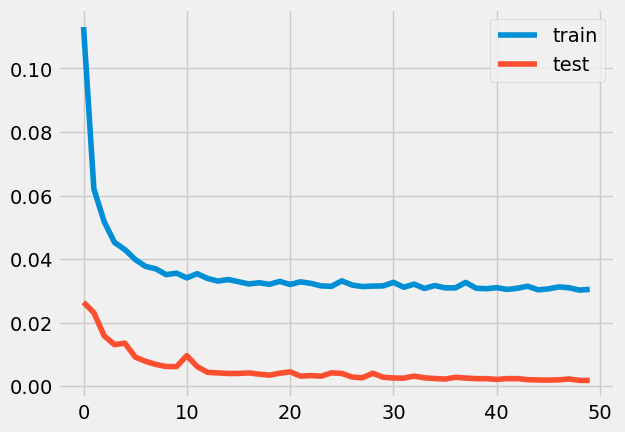

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 156ms/step - loss: 0.1259 - accuracy: 0.0067 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0634 - accuracy: 0.0039 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

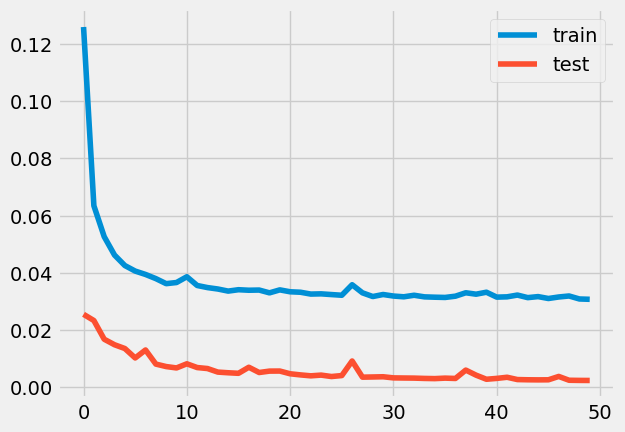

0.9471919977895492
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 189ms/step - loss: 0.1800 - accuracy: 0.0028 - val_loss: 0.0381 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 91ms/step - loss: 0.0616 - accuracy: 0.0048 - val_loss: 0.0187 - val_accuracy: 0.0000e+00
Epoch

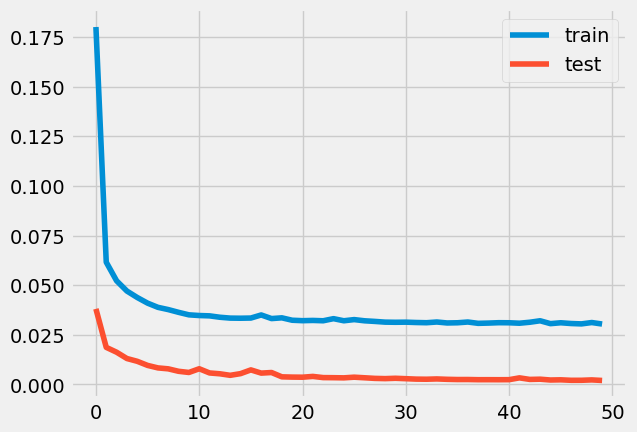

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 205ms/step - loss: 0.1216 - accuracy: 0.0053 - val_loss: 0.0264 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0624 - accuracy: 0.0045 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

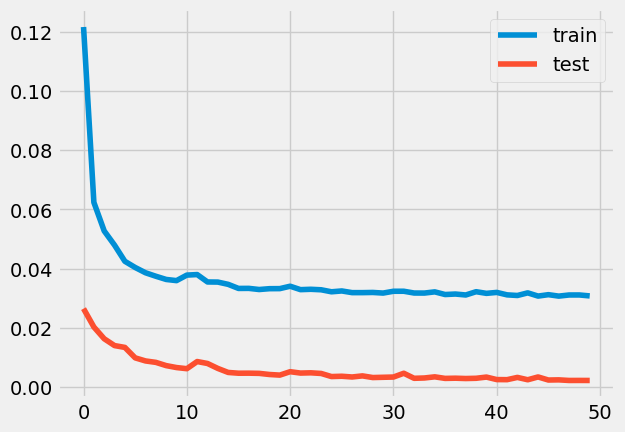

0.9836831222420094
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 179ms/step - loss: 0.1295 - accuracy: 0.0064 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0614 - accuracy: 0.0048 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch

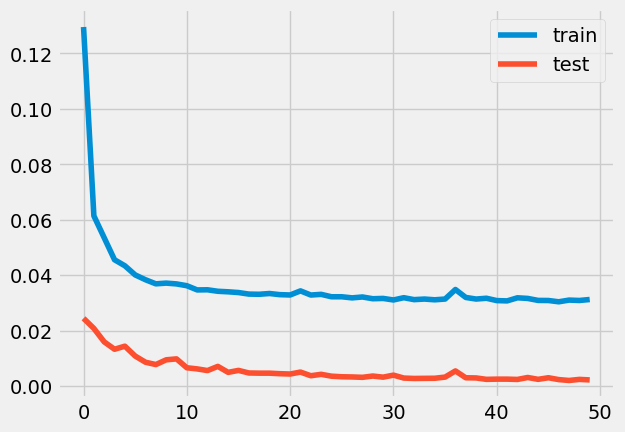

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 172ms/step - loss: 0.1169 - accuracy: 0.0022 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0637 - accuracy: 0.0046 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

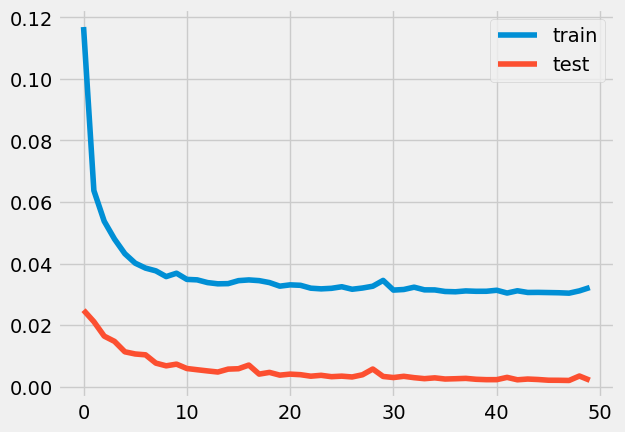

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 158ms/step - loss: 0.1427 - accuracy: 0.0019 - val_loss: 0.0339 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0605 - accuracy: 0.0052 - val_loss: 0.0188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

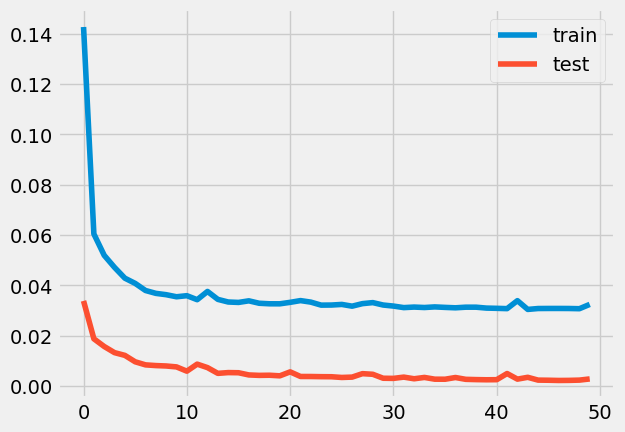

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 199ms/step - loss: 0.1052 - accuracy: 0.0038 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.0620 - accuracy: 0.0047 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

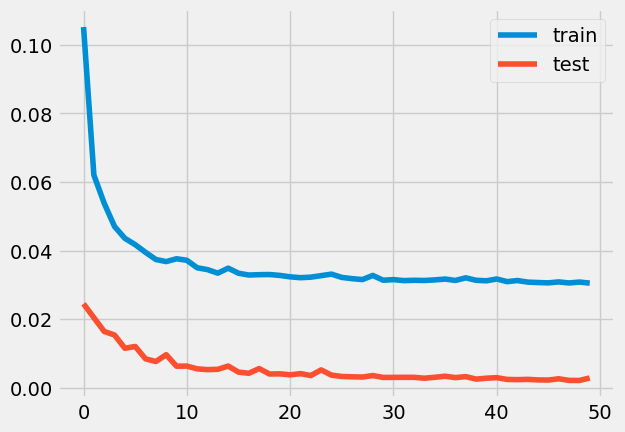

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 153ms/step - loss: 0.1805 - accuracy: 0.0000e+00 - val_loss: 0.0480 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 68ms/step - loss: 0.0660 - accuracy: 0.0047 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

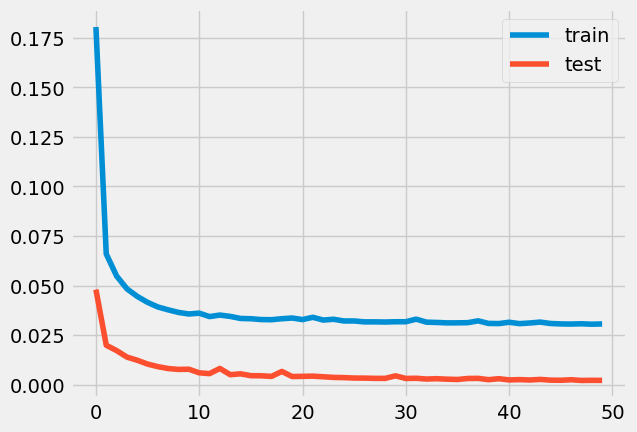

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 133ms/step - loss: 0.0947 - accuracy: 0.0052 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 71ms/step - loss: 0.0603 - accuracy: 0.0055 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

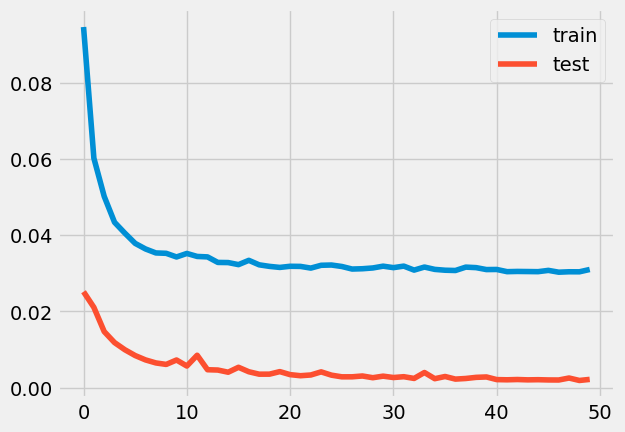

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 186ms/step - loss: 0.1030 - accuracy: 0.0031 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0596 - accuracy: 0.0057 - val_loss: 0.0187 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

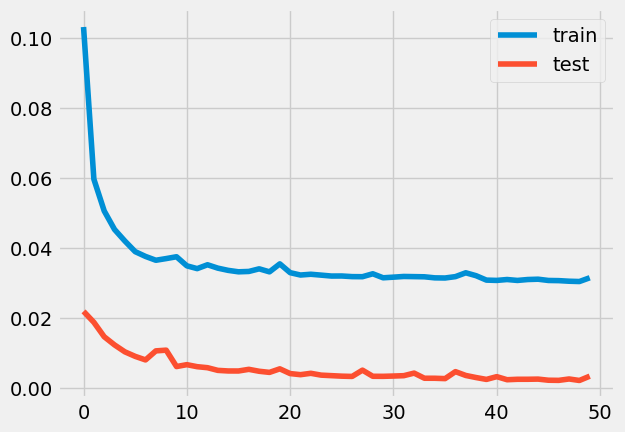

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 141ms/step - loss: 0.1085 - accuracy: 0.0044 - val_loss: 0.0276 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 73ms/step - loss: 0.0626 - accuracy: 0.0050 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

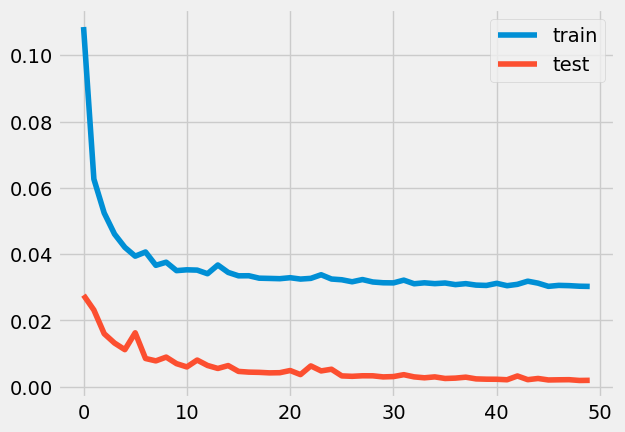

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 139ms/step - loss: 0.1829 - accuracy: 0.0028 - val_loss: 0.0450 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.0617 - accuracy: 0.0053 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

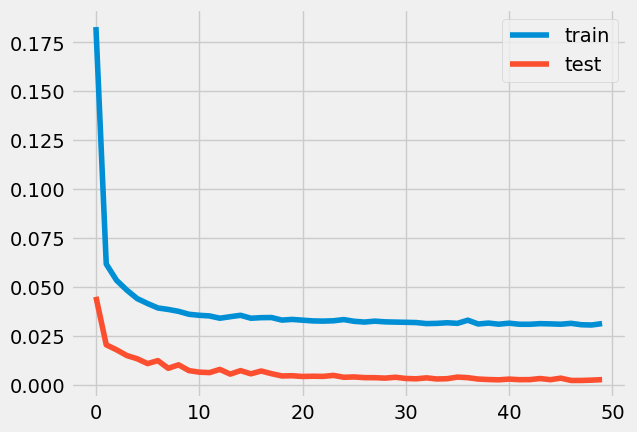

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 179ms/step - loss: 0.1557 - accuracy: 0.0019 - val_loss: 0.0274 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.0620 - accuracy: 0.0039 - val_loss: 0.0188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

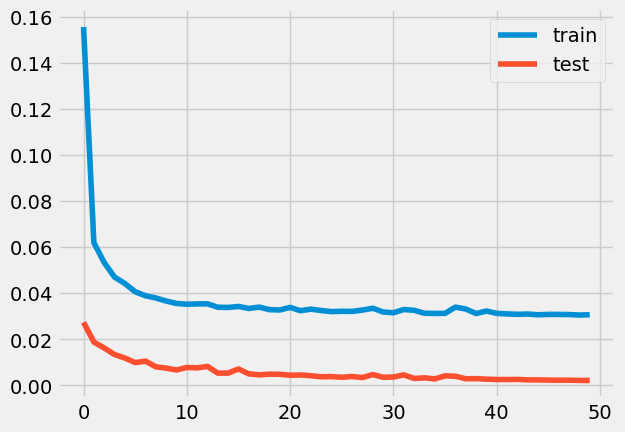

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 144ms/step - loss: 0.1056 - accuracy: 0.0039 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 78ms/step - loss: 0.0614 - accuracy: 0.0061 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

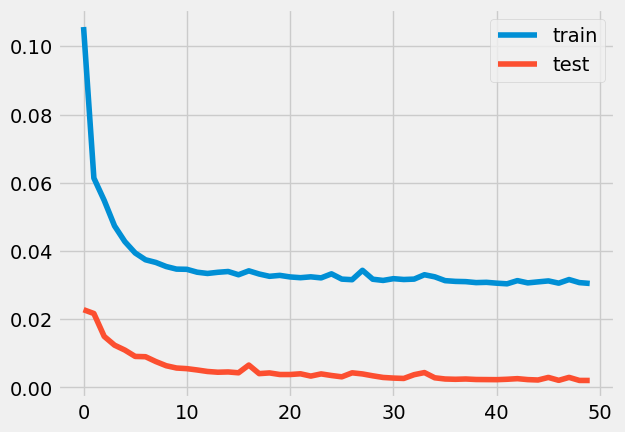

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 152ms/step - loss: 0.1128 - accuracy: 0.0040 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.0590 - accuracy: 0.0066 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

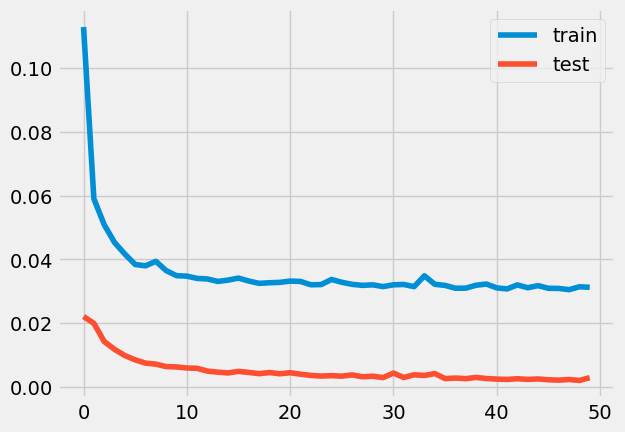

0.9140704584867062
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 194ms/step - loss: 0.0812 - accuracy: 0.0034 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0550 - accuracy: 0.0067 - val_loss: 0.0156 - val_accuracy: 0.0000e+00
Epoch 

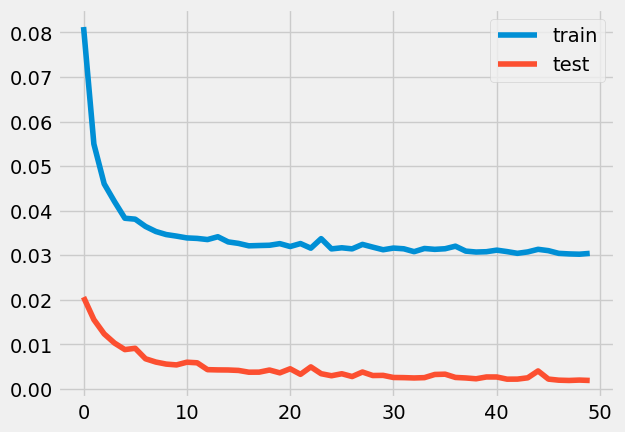

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 241ms/step - loss: 0.1120 - accuracy: 0.0026 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 131ms/step - loss: 0.0593 - accuracy: 0.0054 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

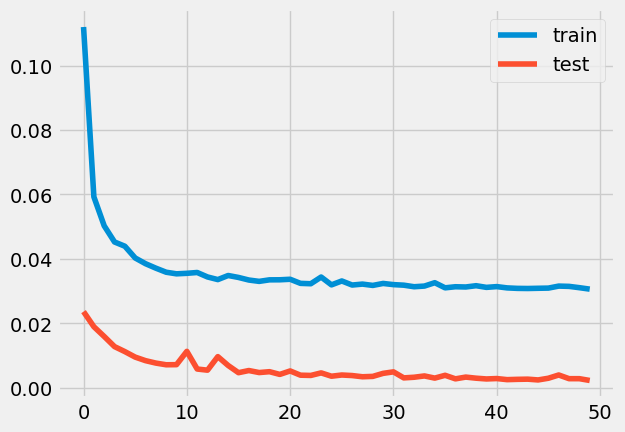

0.9661132901806317
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 181ms/step - loss: 0.1285 - accuracy: 7.7664e-04 - val_loss: 0.0273 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0643 - accuracy: 0.0048 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
E

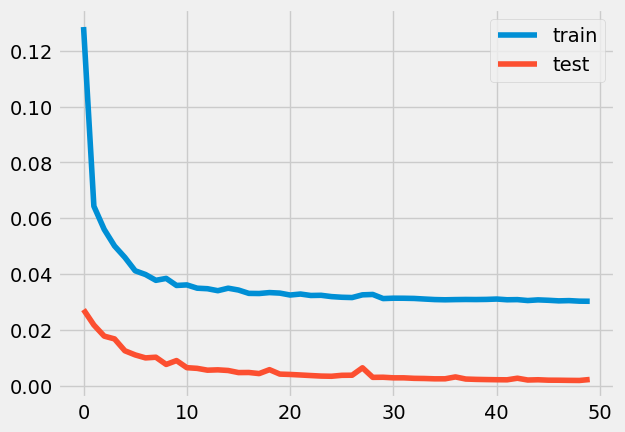

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 164ms/step - loss: 0.1107 - accuracy: 0.0075 - val_loss: 0.0256 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 97ms/step - loss: 0.0624 - accuracy: 0.0052 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

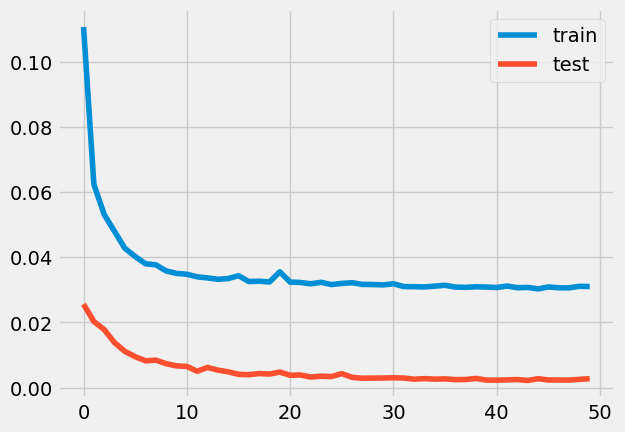

0.9515489707184344
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 153ms/step - loss: 0.1604 - accuracy: 0.0029 - val_loss: 0.0296 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0643 - accuracy: 0.0035 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 

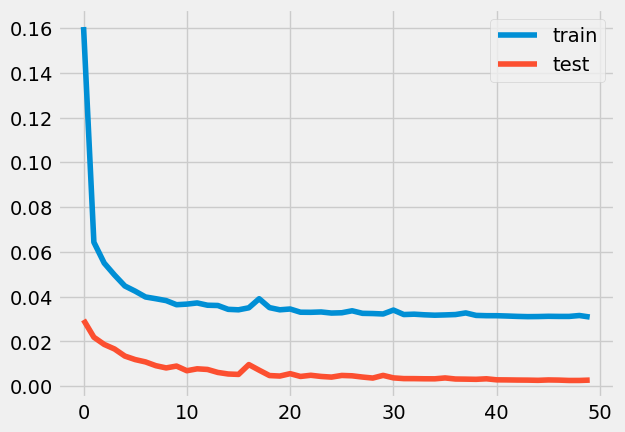

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 157ms/step - loss: 0.1166 - accuracy: 0.0054 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0606 - accuracy: 0.0058 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

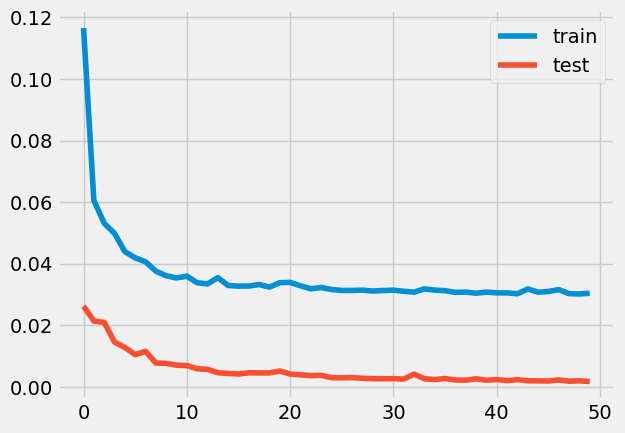

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 152ms/step - loss: 0.1444 - accuracy: 0.0000e+00 - val_loss: 0.0294 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0623 - accuracy: 0.0045 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

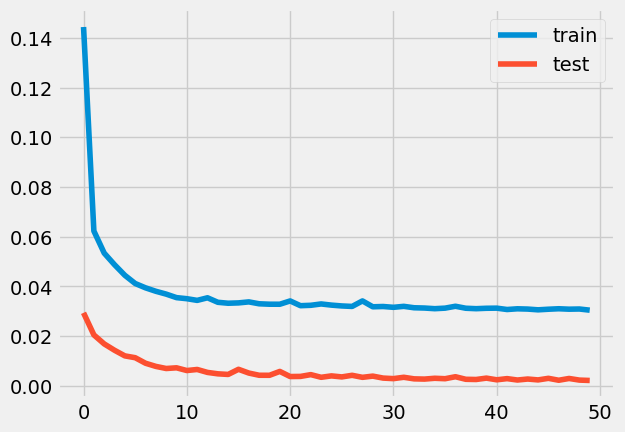

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 147ms/step - loss: 0.1525 - accuracy: 0.0052 - val_loss: 0.0367 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0651 - accuracy: 0.0059 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

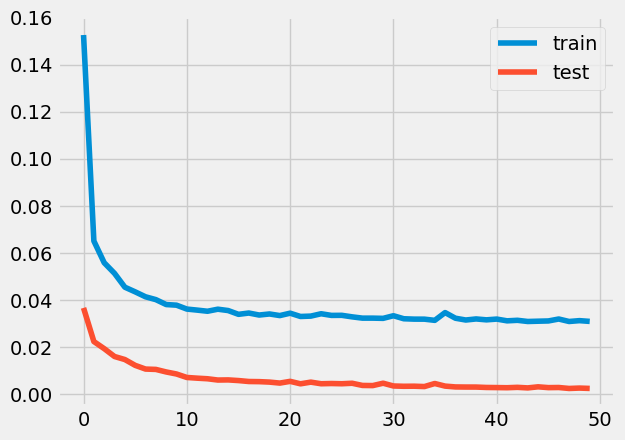

0.9622963059454294
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 156ms/step - loss: 0.1005 - accuracy: 0.0044 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0621 - accuracy: 0.0036 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 

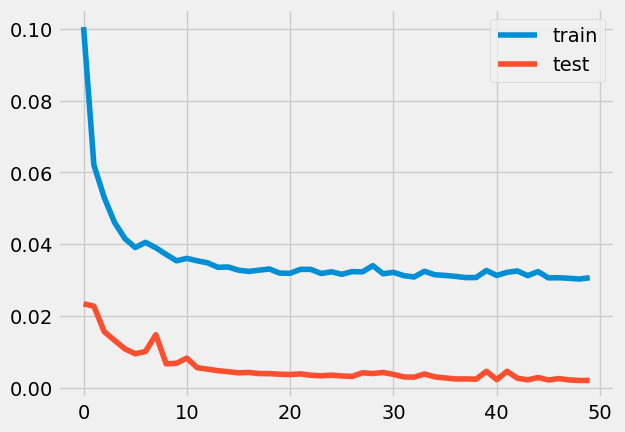

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 153ms/step - loss: 0.0915 - accuracy: 0.0043 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0592 - accuracy: 0.0051 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

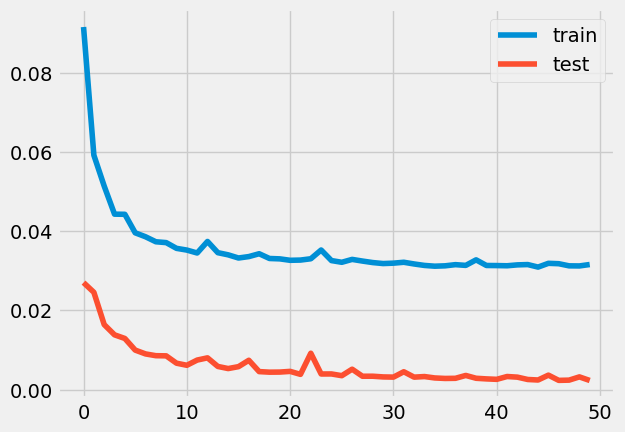

0.9754139171485823
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 155ms/step - loss: 0.1248 - accuracy: 0.0039 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0594 - accuracy: 0.0057 - val_loss: 0.0192 - val_accuracy: 0.0000e+00
Epoch 

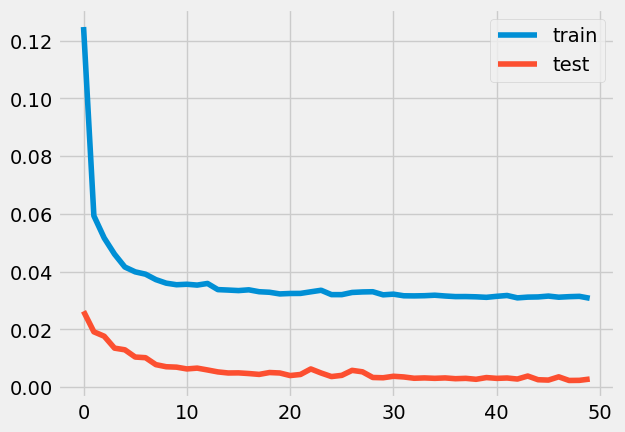

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 152ms/step - loss: 0.1011 - accuracy: 0.0022 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0610 - accuracy: 0.0049 - val_loss: 0.0197 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

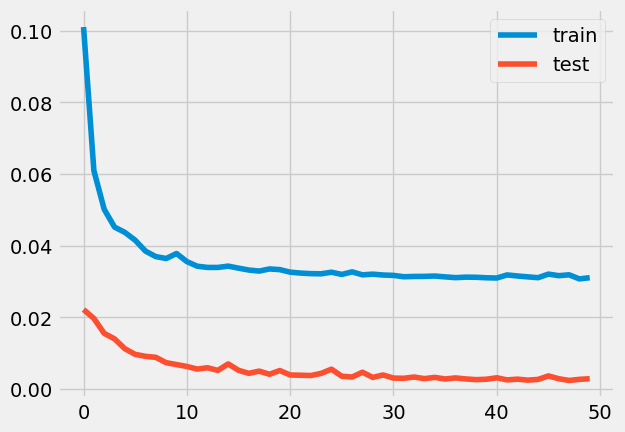

0.990919431157494
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 153ms/step - loss: 0.1260 - accuracy: 0.0034 - val_loss: 0.0385 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0653 - accuracy: 0.0055 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3

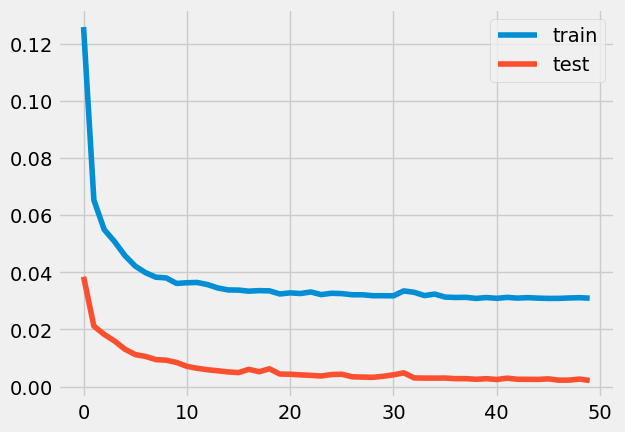

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 169ms/step - loss: 0.1821 - accuracy: 0.0013 - val_loss: 0.0567 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0658 - accuracy: 0.0059 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

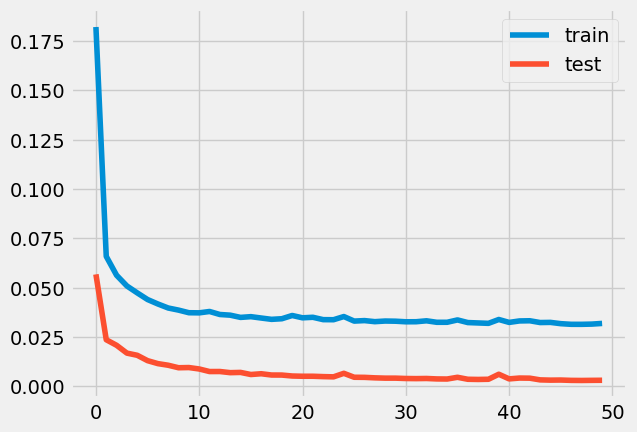

0.9190134942524779
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 151ms/step - loss: 0.0917 - accuracy: 0.0059 - val_loss: 0.0272 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0642 - accuracy: 0.0055 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 

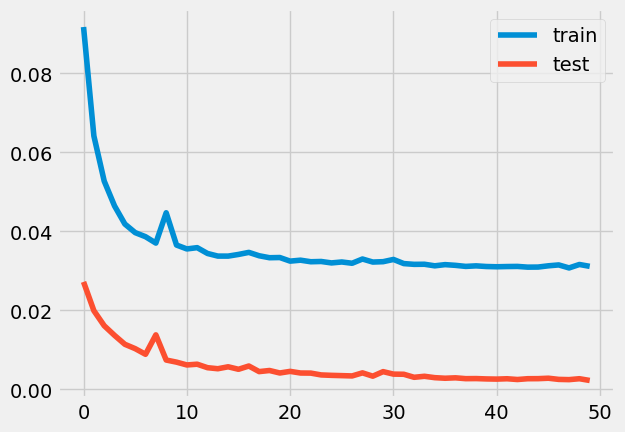

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 168ms/step - loss: 0.1402 - accuracy: 0.0043 - val_loss: 0.0268 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 113ms/step - loss: 0.0632 - accuracy: 0.0043 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

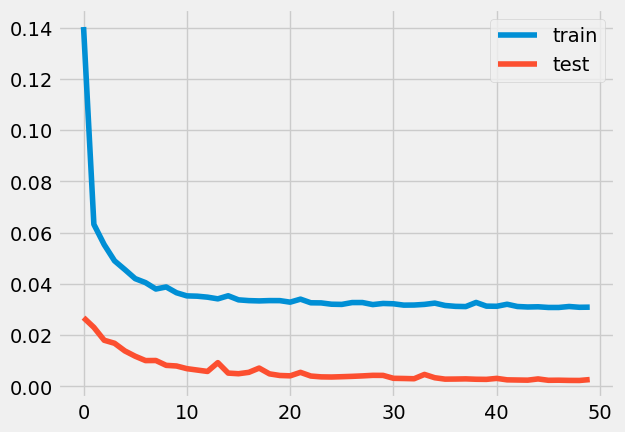

0.962887805879874
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 153ms/step - loss: 0.0975 - accuracy: 0.0038 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0605 - accuracy: 0.0062 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3

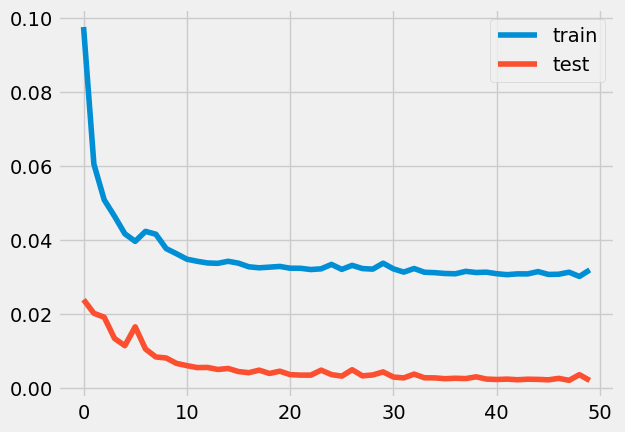

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 200ms/step - loss: 0.1300 - accuracy: 3.4836e-05 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0645 - accuracy: 0.0046 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

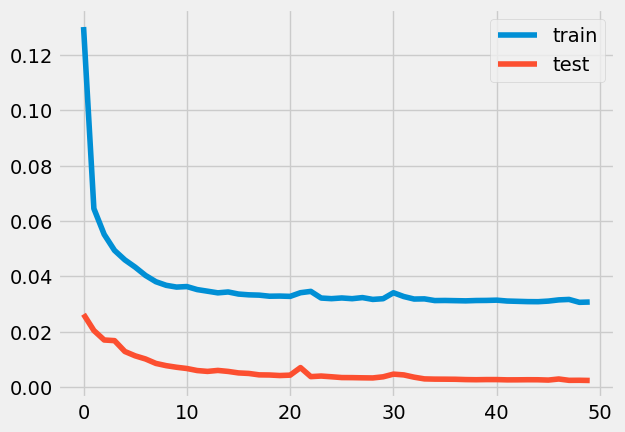

0.9668918650874792
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.1362 - accuracy: 0.0044 - val_loss: 0.0378 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0637 - accuracy: 0.0061 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 

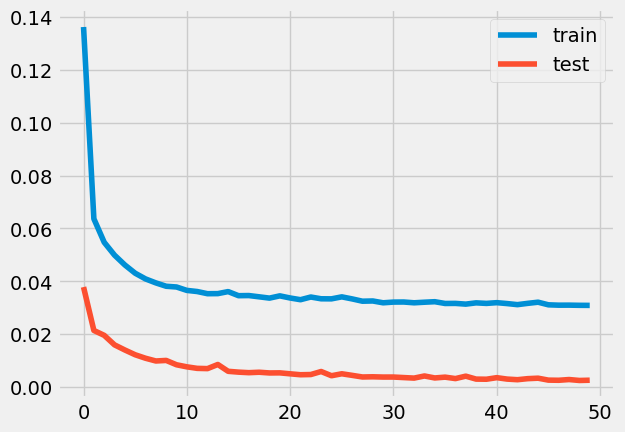

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.1975 - accuracy: 0.0000e+00 - val_loss: 0.0467 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0646 - accuracy: 0.0057 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

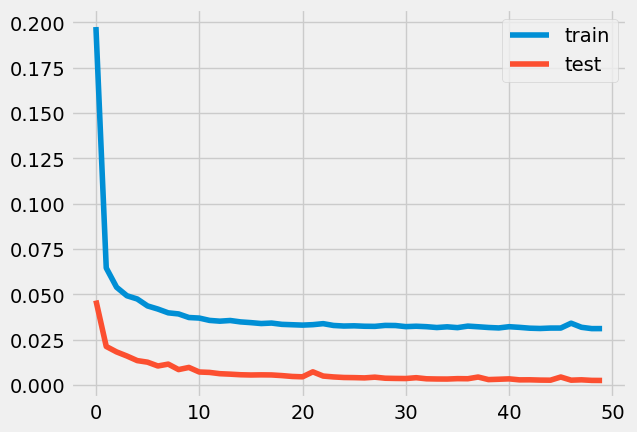

0.005
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 131ms/step - loss: 0.0948 - accuracy: 0.0069 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0643 - accuracy: 0.0038 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

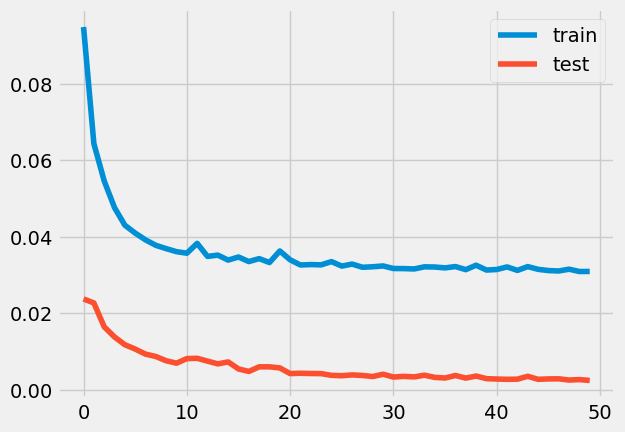

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 124ms/step - loss: 0.1319 - accuracy: 0.0043 - val_loss: 0.0319 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0626 - accuracy: 0.0055 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

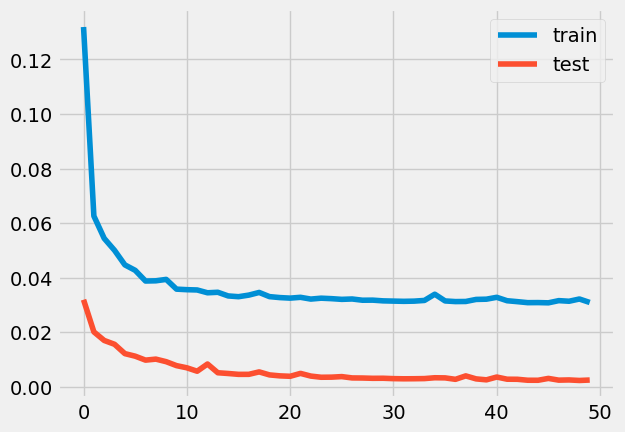

0.9881960892801395
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 120ms/step - loss: 0.1207 - accuracy: 0.0044 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 76ms/step - loss: 0.0623 - accuracy: 0.0051 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 

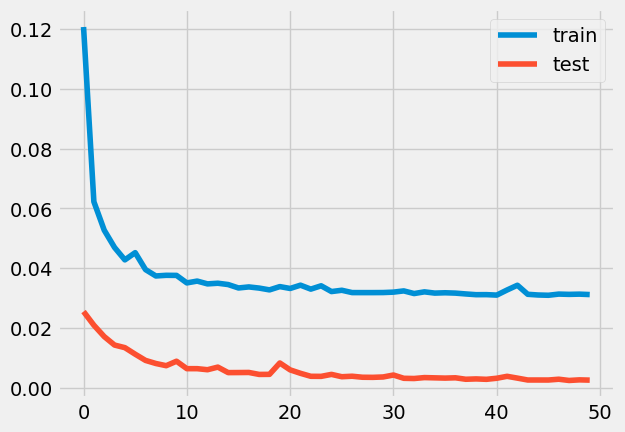

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 150ms/step - loss: 0.1269 - accuracy: 0.0023 - val_loss: 0.0346 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0669 - accuracy: 0.0047 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

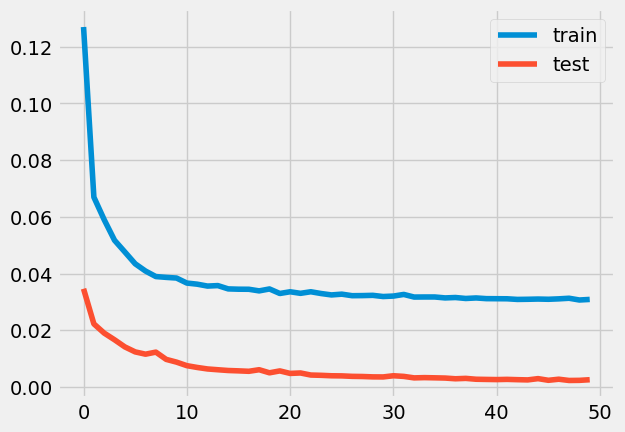

0.9953667268618035
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 154ms/step - loss: 0.1403 - accuracy: 0.0059 - val_loss: 0.0381 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0659 - accuracy: 0.0045 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 

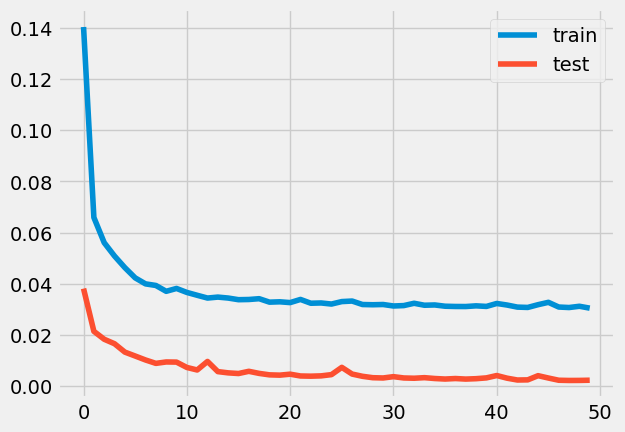

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 145ms/step - loss: 0.1049 - accuracy: 0.0041 - val_loss: 0.0259 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 78ms/step - loss: 0.0629 - accuracy: 0.0054 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

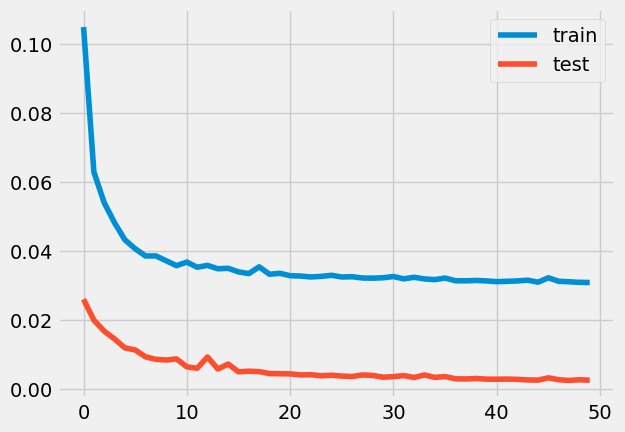

0.9717386034768004
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 136ms/step - loss: 0.1519 - accuracy: 0.0000e+00 - val_loss: 0.0331 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.0655 - accuracy: 0.0041 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Ep

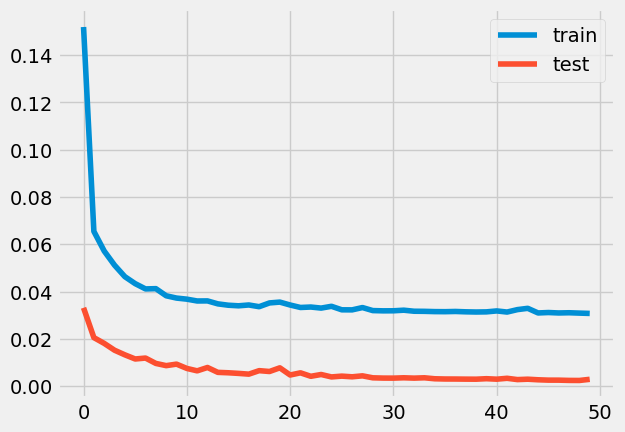

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 170ms/step - loss: 0.1374 - accuracy: 0.0023 - val_loss: 0.0357 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0639 - accuracy: 0.0059 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

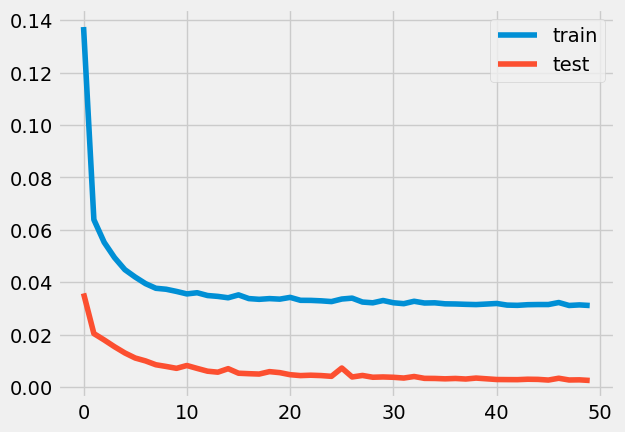

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.1621 - accuracy: 0.0031 - val_loss: 0.0405 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.0632 - accuracy: 0.0036 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

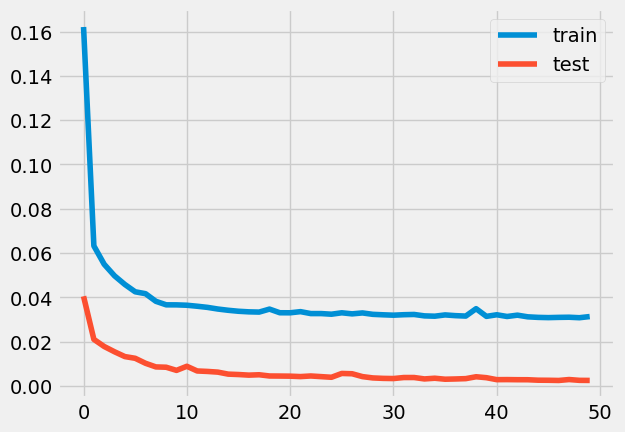

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 118ms/step - loss: 0.1228 - accuracy: 0.0067 - val_loss: 0.0269 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 72ms/step - loss: 0.0636 - accuracy: 0.0055 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

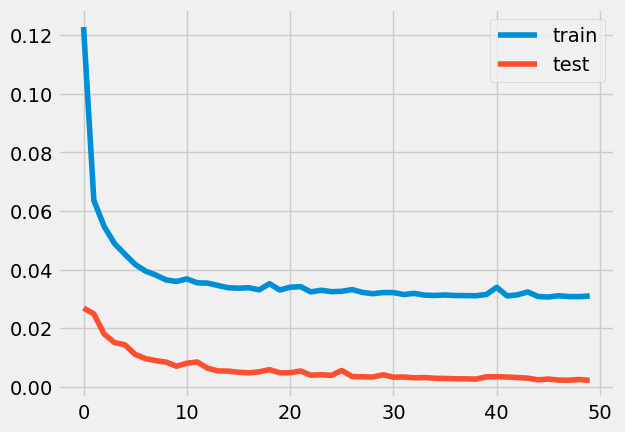

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 128ms/step - loss: 0.1510 - accuracy: 0.0000e+00 - val_loss: 0.0349 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 74ms/step - loss: 0.0619 - accuracy: 0.0054 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

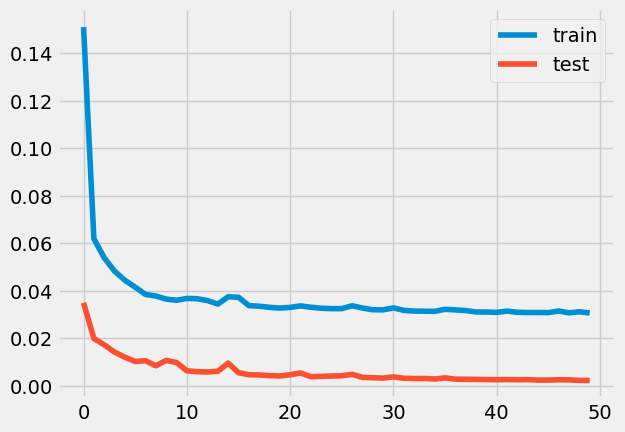

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 139ms/step - loss: 0.0946 - accuracy: 0.0054 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0588 - accuracy: 0.0062 - val_loss: 0.0183 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

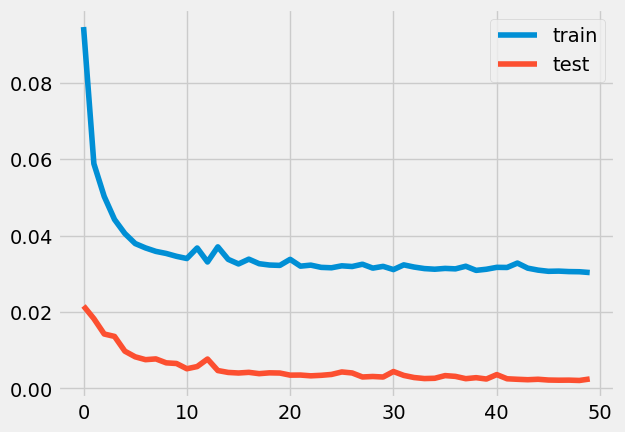

0.941698718816684
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 134ms/step - loss: 0.1085 - accuracy: 0.0066 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0637 - accuracy: 0.0038 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3

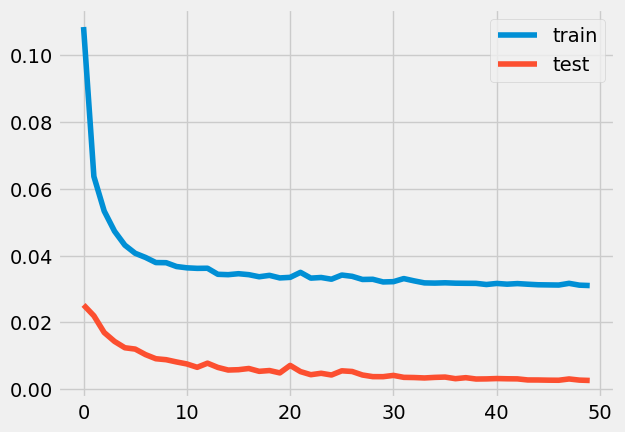

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 149ms/step - loss: 0.1661 - accuracy: 8.6475e-04 - val_loss: 0.0475 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0630 - accuracy: 0.0063 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

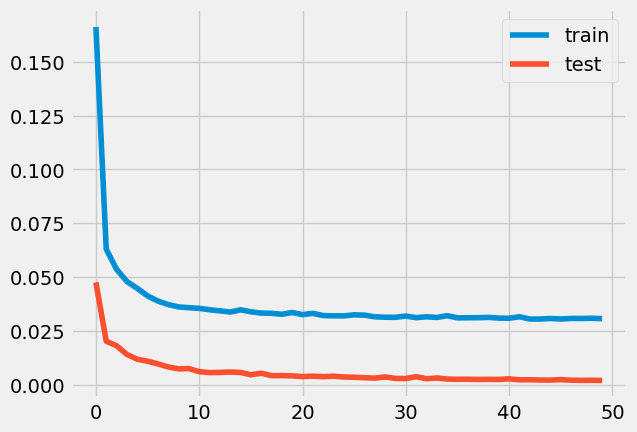

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 150ms/step - loss: 0.1605 - accuracy: 0.0061 - val_loss: 0.0407 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0609 - accuracy: 0.0068 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

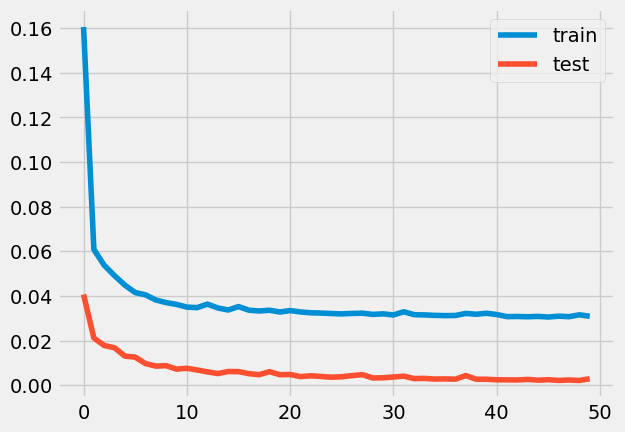

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 146ms/step - loss: 0.1428 - accuracy: 0.0023 - val_loss: 0.0341 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 92ms/step - loss: 0.0598 - accuracy: 0.0063 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

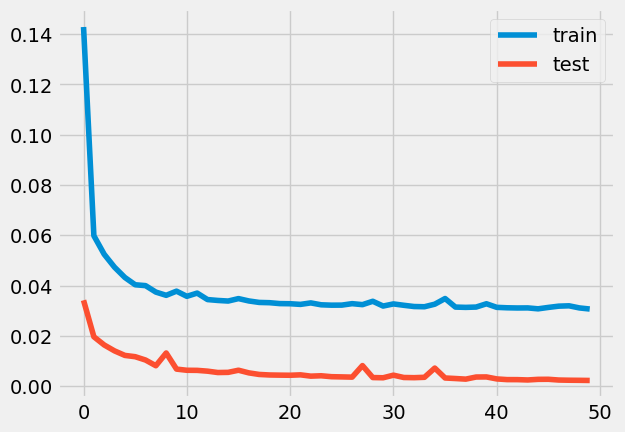

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 132ms/step - loss: 0.0995 - accuracy: 0.0071 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0610 - accuracy: 0.0055 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

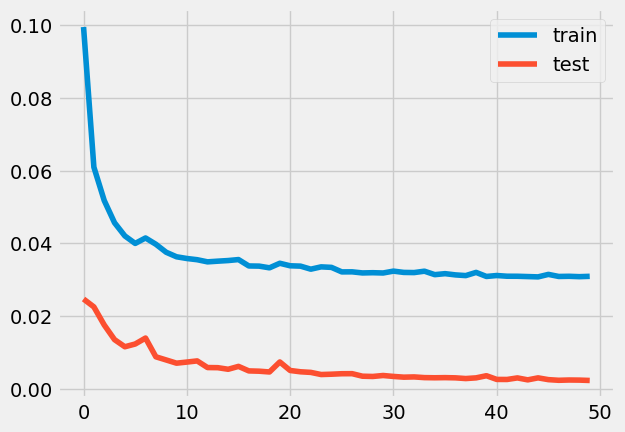

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 132ms/step - loss: 0.1322 - accuracy: 0.0054 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0652 - accuracy: 0.0038 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

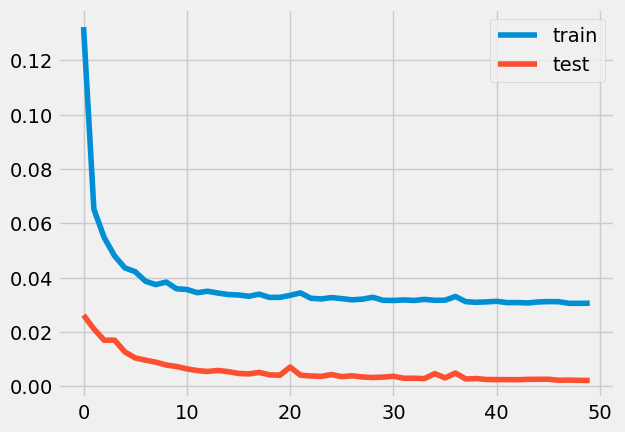

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 133ms/step - loss: 0.1196 - accuracy: 0.0028 - val_loss: 0.0353 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 78ms/step - loss: 0.0624 - accuracy: 0.0049 - val_loss: 0.0186 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

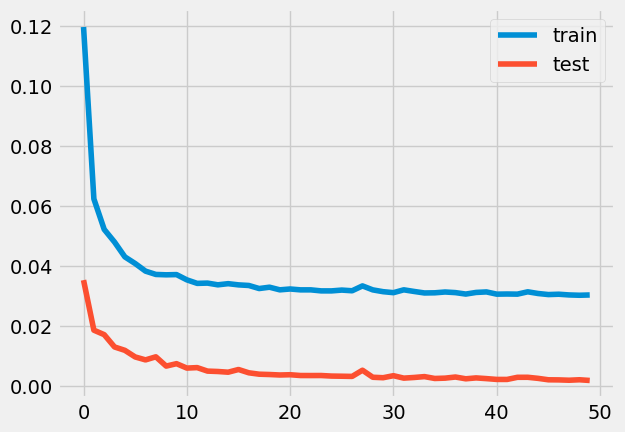

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 137ms/step - loss: 0.1659 - accuracy: 0.0039 - val_loss: 0.0332 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0644 - accuracy: 0.0034 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

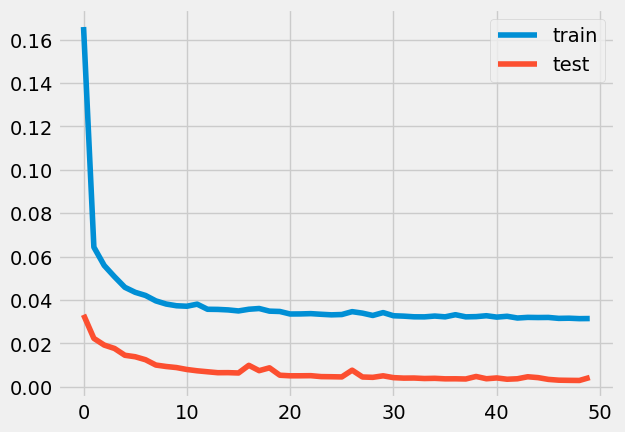

0.6229198847423423
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 136ms/step - loss: 0.1334 - accuracy: 0.0038 - val_loss: 0.0276 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0618 - accuracy: 0.0053 - val_loss: 0.0193 - val_accuracy: 0.0000e+00
Epoch 

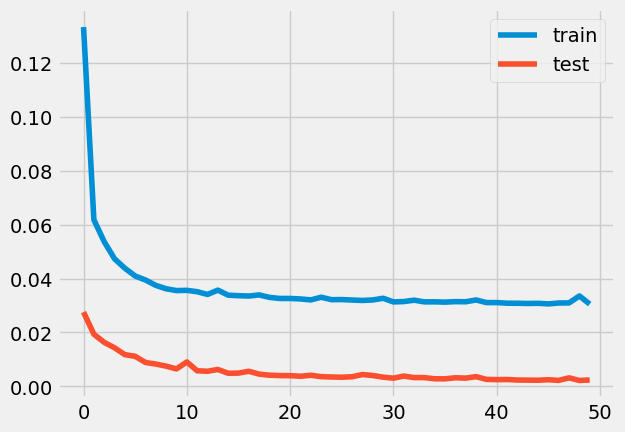

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 175ms/step - loss: 0.1410 - accuracy: 9.3238e-04 - val_loss: 0.0322 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0635 - accuracy: 0.0036 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

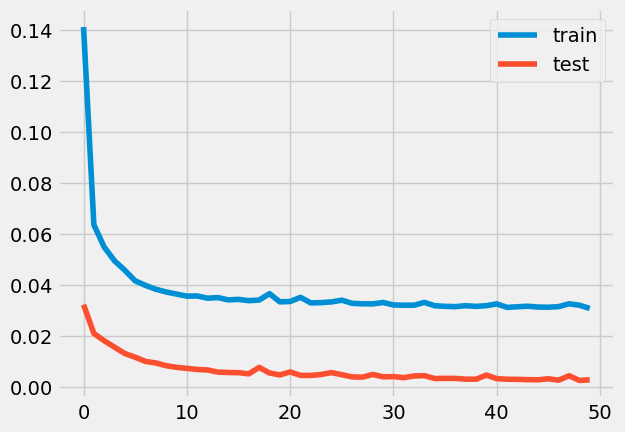

0.9233687479184952
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 143ms/step - loss: 0.2246 - accuracy: 0.0021 - val_loss: 0.0559 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0678 - accuracy: 0.0066 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 

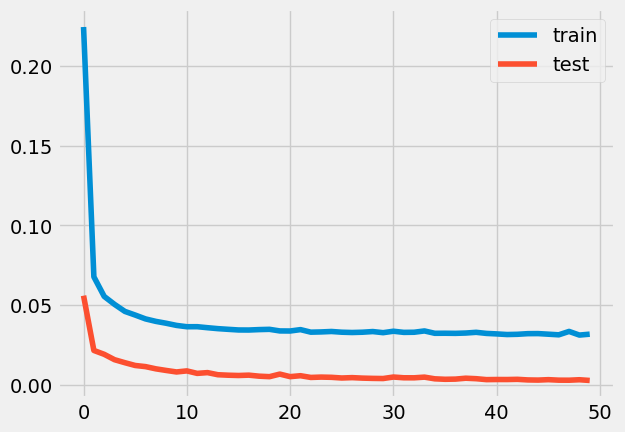

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 132ms/step - loss: 0.1004 - accuracy: 0.0036 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0614 - accuracy: 0.0052 - val_loss: 0.0194 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

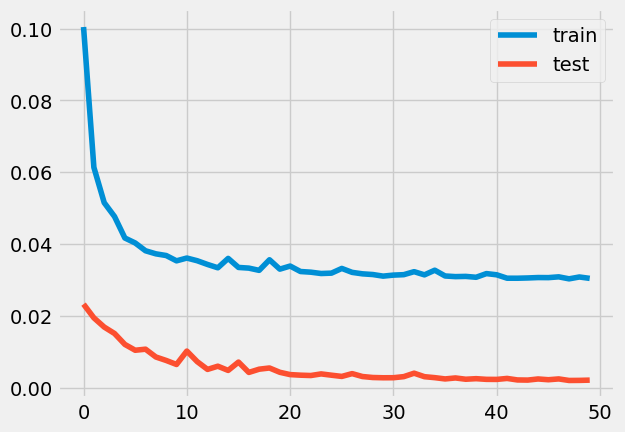

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 137ms/step - loss: 0.1117 - accuracy: 0.0040 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0615 - accuracy: 0.0059 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

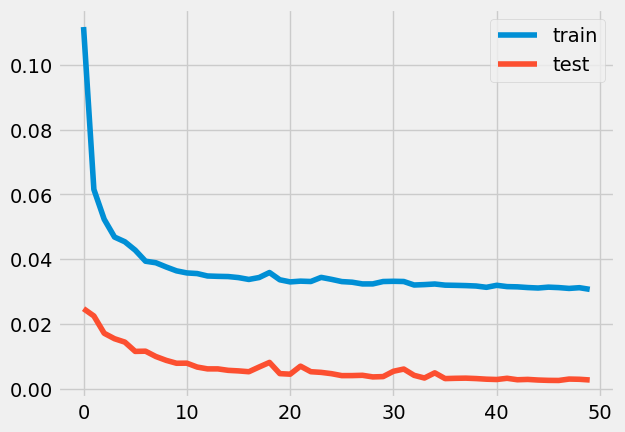

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 155ms/step - loss: 0.1210 - accuracy: 0.0039 - val_loss: 0.0275 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0591 - accuracy: 0.0057 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

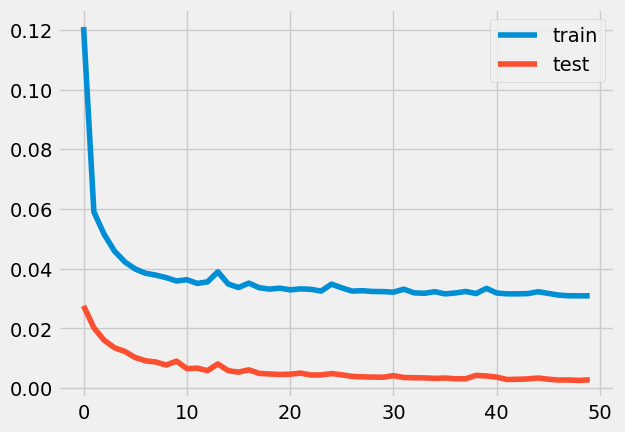

0.9737010885365616
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 166ms/step - loss: 0.1300 - accuracy: 0.0049 - val_loss: 0.0351 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.0627 - accuracy: 0.0046 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch

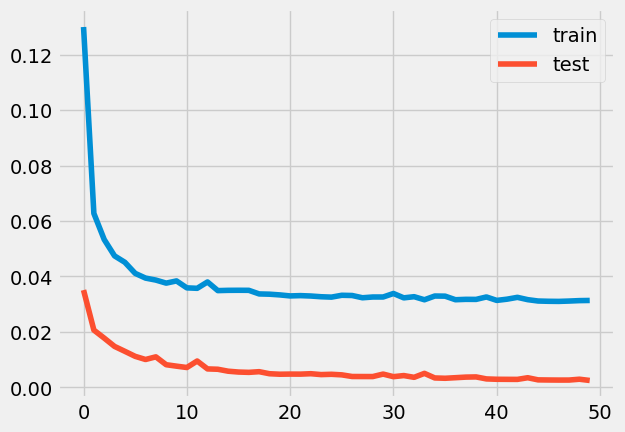

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 156ms/step - loss: 0.1551 - accuracy: 0.0015 - val_loss: 0.0446 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 100ms/step - loss: 0.0636 - accuracy: 0.0052 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

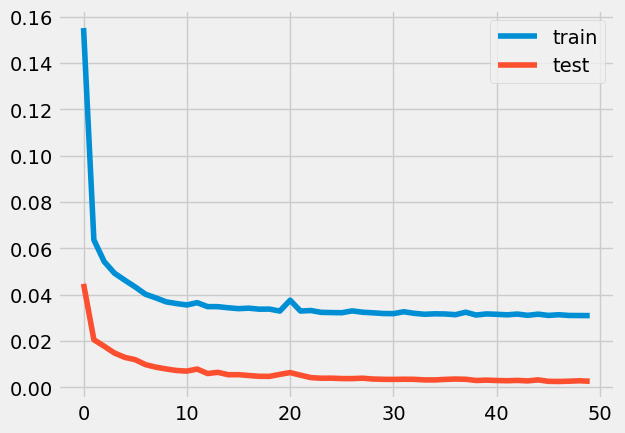

0.9816558797915623
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 144ms/step - loss: 0.1439 - accuracy: 0.0069 - val_loss: 0.0455 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.0670 - accuracy: 0.0052 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 

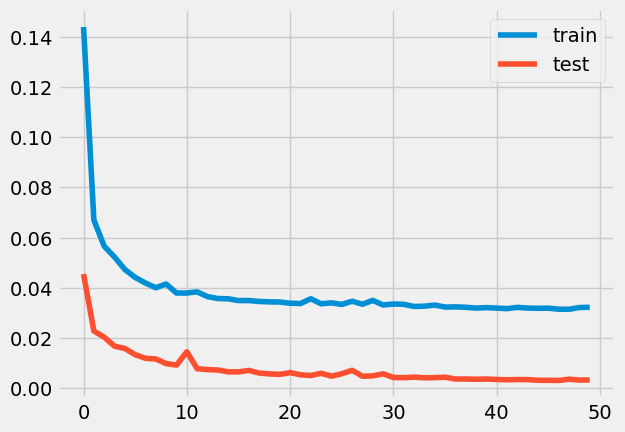

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 146ms/step - loss: 0.1105 - accuracy: 0.0018 - val_loss: 0.0272 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0621 - accuracy: 0.0044 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

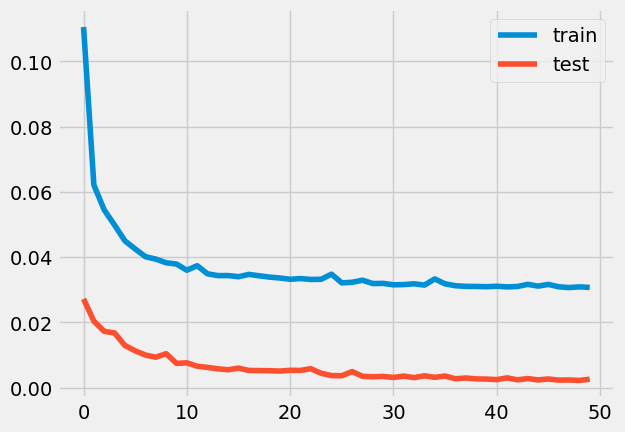

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 136ms/step - loss: 0.1154 - accuracy: 0.0059 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0636 - accuracy: 0.0048 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

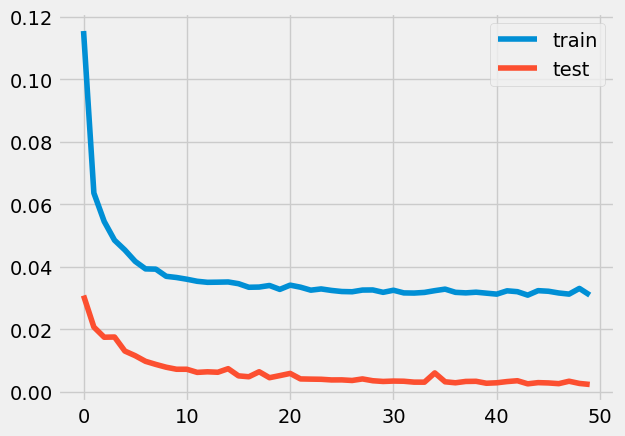

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 158ms/step - loss: 0.1245 - accuracy: 0.0025 - val_loss: 0.0317 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0661 - accuracy: 0.0057 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

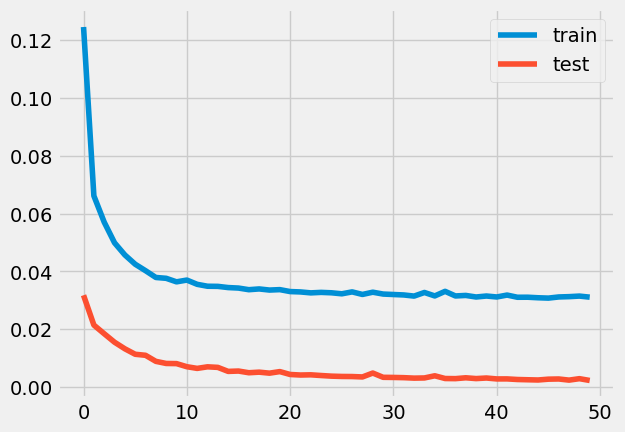

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 179ms/step - loss: 0.1645 - accuracy: 0.0014 - val_loss: 0.0405 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0636 - accuracy: 0.0053 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

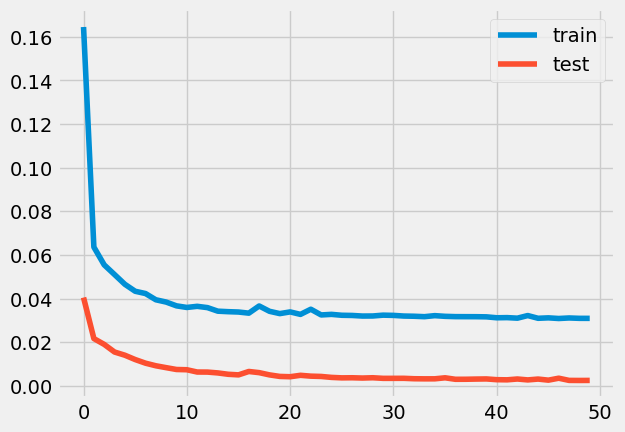

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 178ms/step - loss: 0.1173 - accuracy: 0.0039 - val_loss: 0.0277 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0634 - accuracy: 0.0041 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

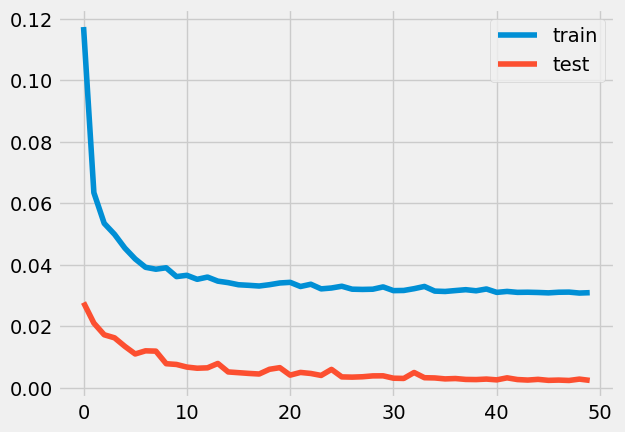

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 147ms/step - loss: 0.1322 - accuracy: 3.3607e-04 - val_loss: 0.0434 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0619 - accuracy: 0.0045 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

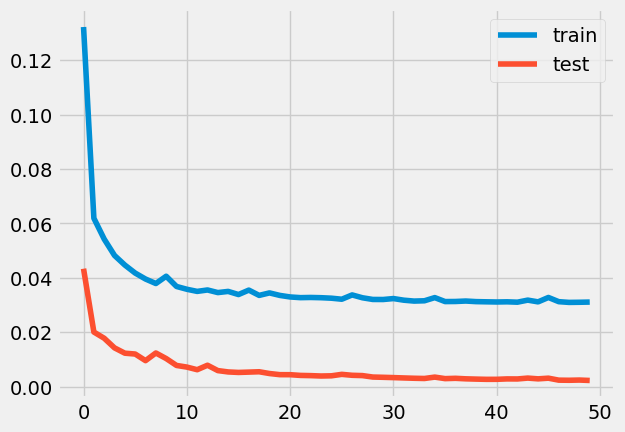

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 188ms/step - loss: 0.1426 - accuracy: 0.0026 - val_loss: 0.0367 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 111ms/step - loss: 0.0621 - accuracy: 0.0048 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

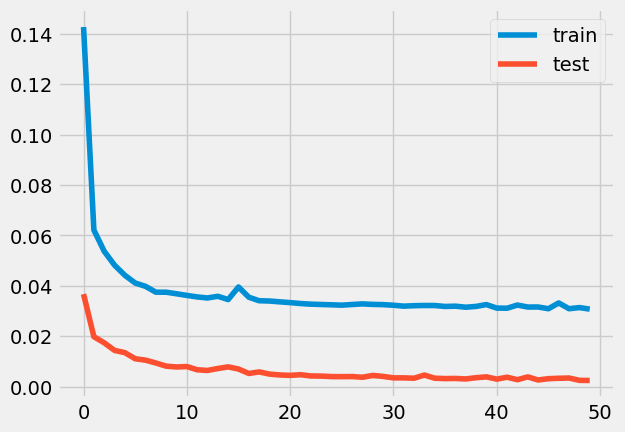

0.9673089260803784
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 130ms/step - loss: 0.1922 - accuracy: 4.6516e-04 - val_loss: 0.0431 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0638 - accuracy: 0.0056 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Ep

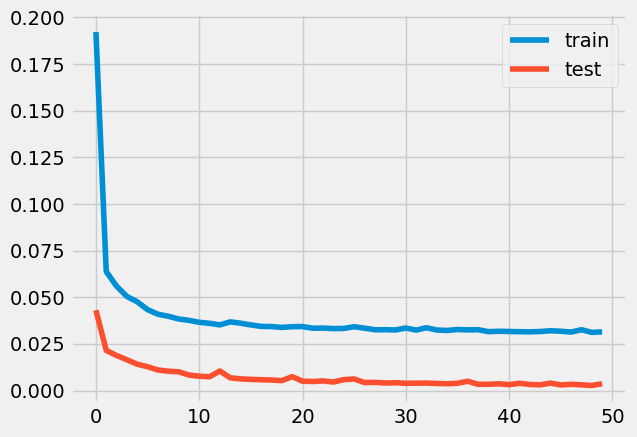

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 134ms/step - loss: 0.1092 - accuracy: 0.0046 - val_loss: 0.0243 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0598 - accuracy: 0.0048 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

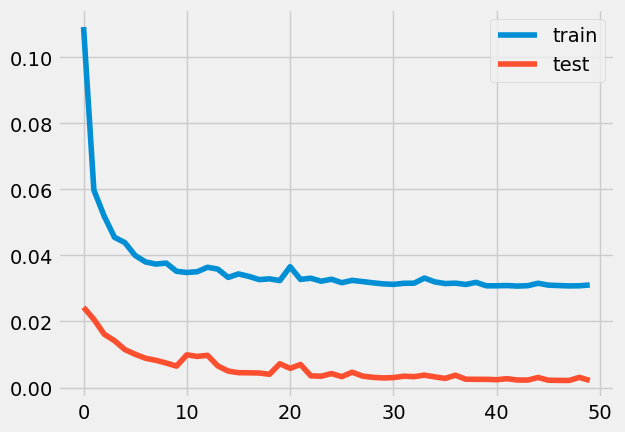

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 136ms/step - loss: 0.1029 - accuracy: 0.0064 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0633 - accuracy: 0.0033 - val_loss: 0.0194 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

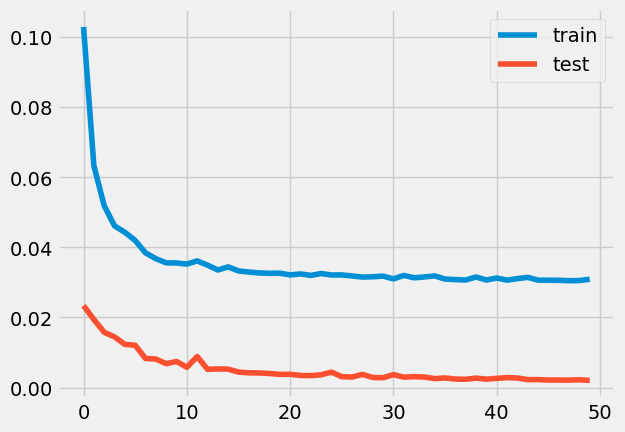

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 143ms/step - loss: 0.1211 - accuracy: 0.0053 - val_loss: 0.0251 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0663 - accuracy: 0.0033 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

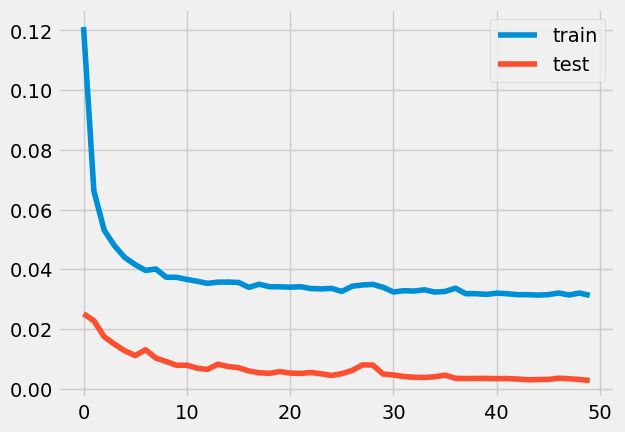

0.8644597255774465
0.0025
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 156ms/step - loss: 0.1531 - accuracy: 0.0022 - val_loss: 0.0387 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0613 - accuracy: 0.0063 - val_loss: 0.0199 - val_accuracy: 0.0000e+00

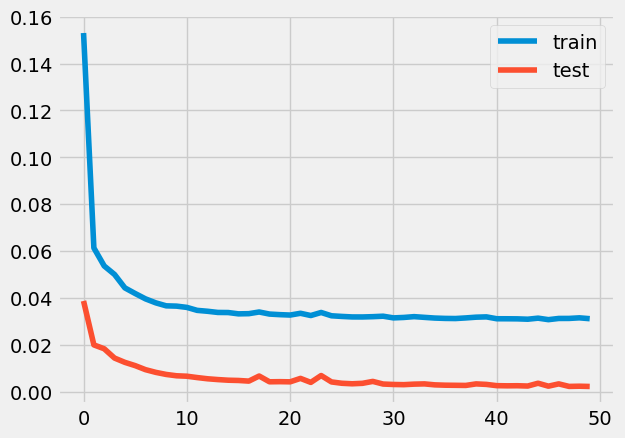

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 145ms/step - loss: 0.1687 - accuracy: 0.0043 - val_loss: 0.0464 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0675 - accuracy: 0.0046 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

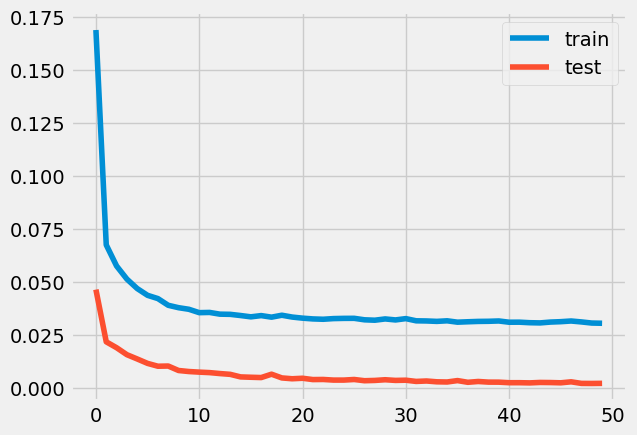

0.9929136482617115
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 142ms/step - loss: 0.1276 - accuracy: 0.0042 - val_loss: 0.0335 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0647 - accuracy: 0.0046 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 

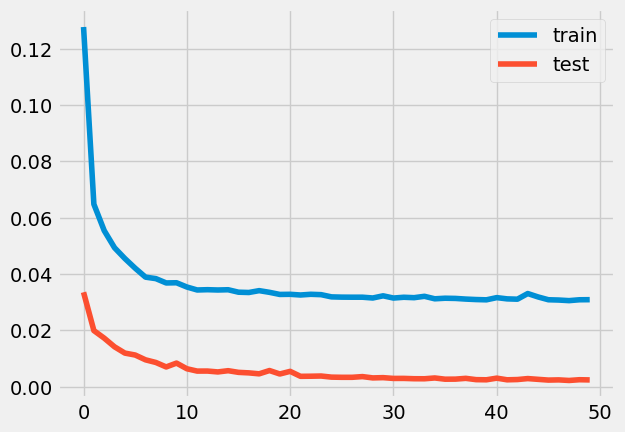

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 138ms/step - loss: 0.1681 - accuracy: 0.0060 - val_loss: 0.0462 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0653 - accuracy: 0.0051 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

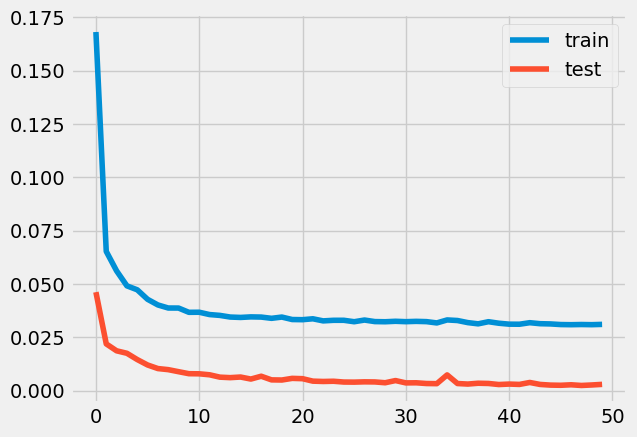

0.7780920786433599
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 141ms/step - loss: 0.1552 - accuracy: 0.0032 - val_loss: 0.0496 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0635 - accuracy: 0.0064 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 

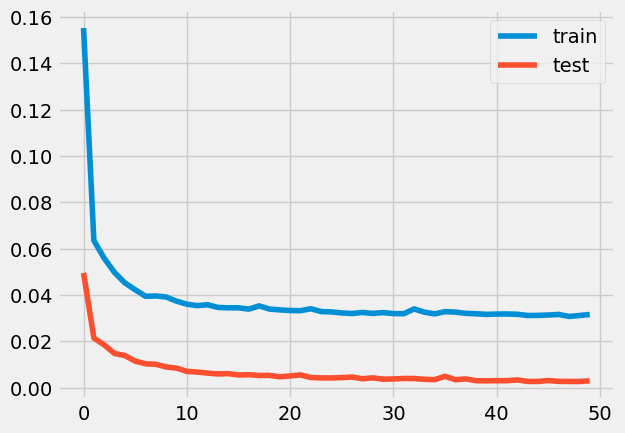

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 161ms/step - loss: 0.1147 - accuracy: 0.0038 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.0643 - accuracy: 0.0041 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

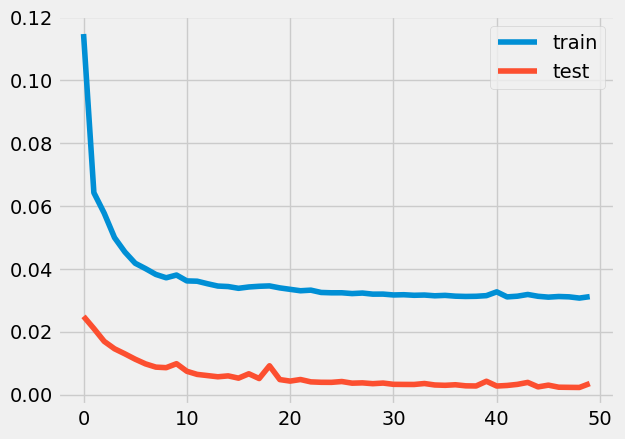

0.7934805283175178
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 173ms/step - loss: 0.1229 - accuracy: 0.0048 - val_loss: 0.0310 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0604 - accuracy: 0.0055 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoch 

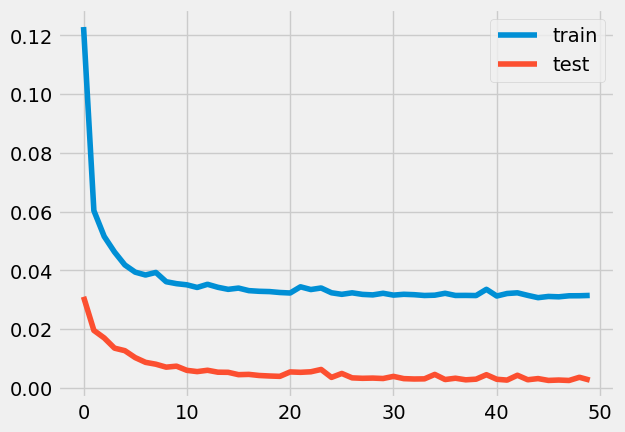

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 150ms/step - loss: 0.1330 - accuracy: 0.0017 - val_loss: 0.0349 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0677 - accuracy: 0.0046 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

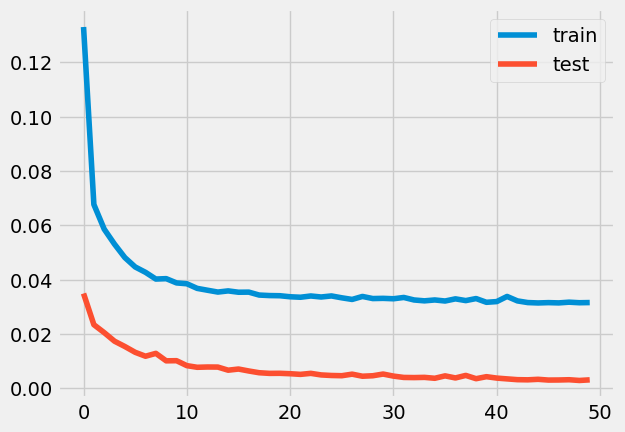

0.861805398987142
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 144ms/step - loss: 0.1209 - accuracy: 0.0047 - val_loss: 0.0301 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0620 - accuracy: 0.0050 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3

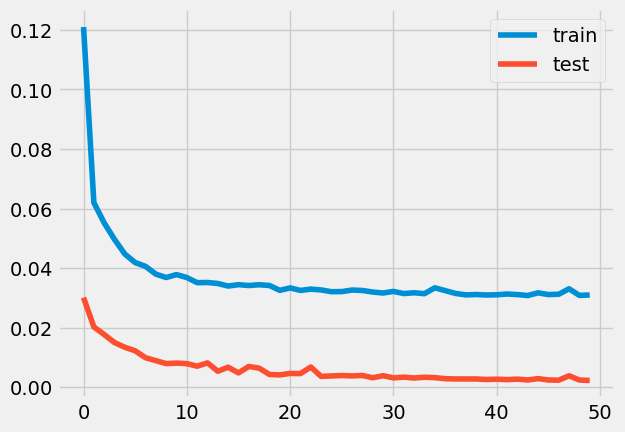

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 164ms/step - loss: 0.1498 - accuracy: 0.0034 - val_loss: 0.0513 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0668 - accuracy: 0.0061 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

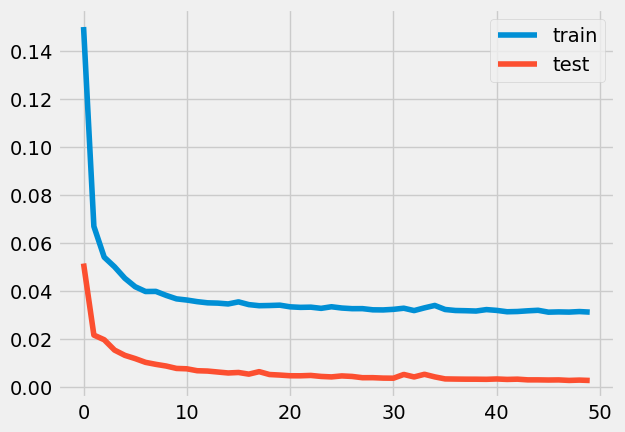

0.8699659751561121
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 132ms/step - loss: 0.1139 - accuracy: 0.0017 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0615 - accuracy: 0.0049 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 

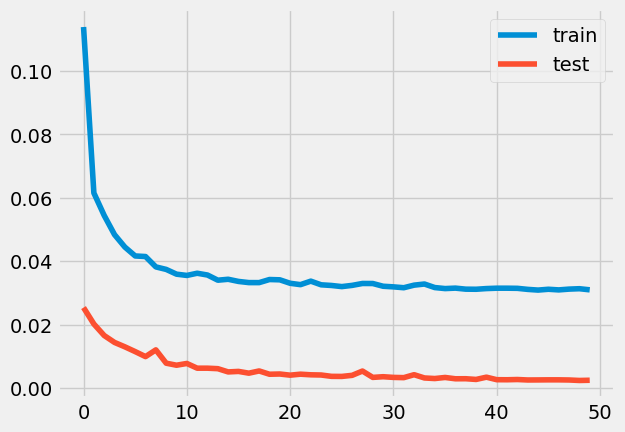

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 142ms/step - loss: 0.1290 - accuracy: 0.0035 - val_loss: 0.0418 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0680 - accuracy: 0.0057 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

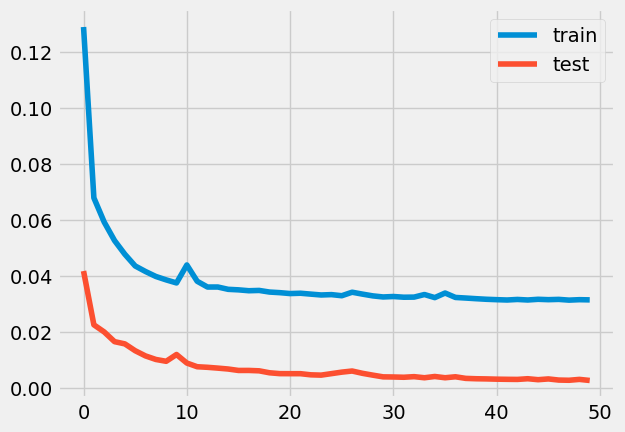

0.907837135892822
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 122ms/step - loss: 0.1385 - accuracy: 0.0014 - val_loss: 0.0425 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0661 - accuracy: 0.0040 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3

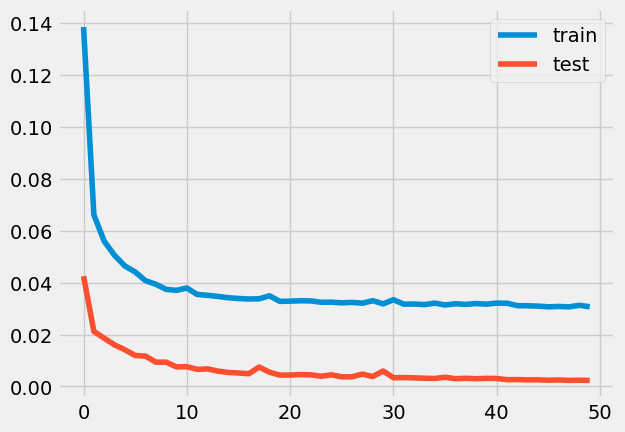

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 130ms/step - loss: 0.1430 - accuracy: 0.0043 - val_loss: 0.0404 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0647 - accuracy: 0.0052 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

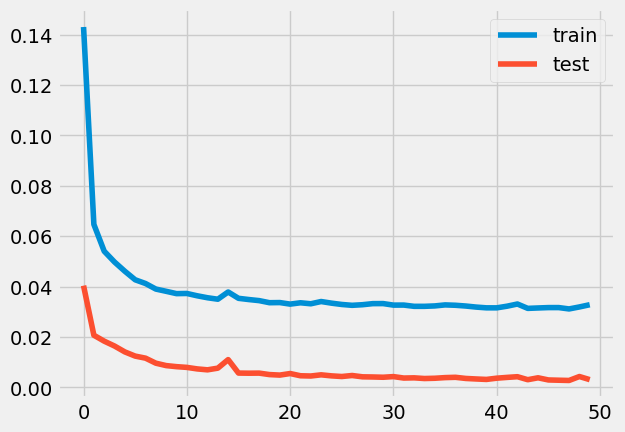

0.7415887655471708
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 123ms/step - loss: 0.1220 - accuracy: 0.0046 - val_loss: 0.0379 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0647 - accuracy: 0.0050 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 

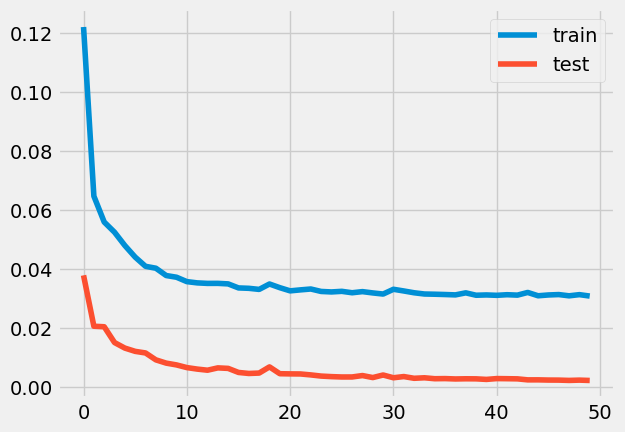

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.1246 - accuracy: 0.0020 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0637 - accuracy: 0.0048 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

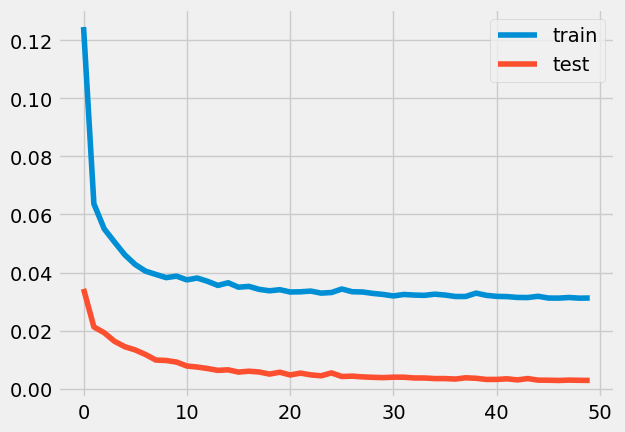

0.8023503517667997
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 121ms/step - loss: 0.1137 - accuracy: 0.0031 - val_loss: 0.0269 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.0656 - accuracy: 0.0046 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 

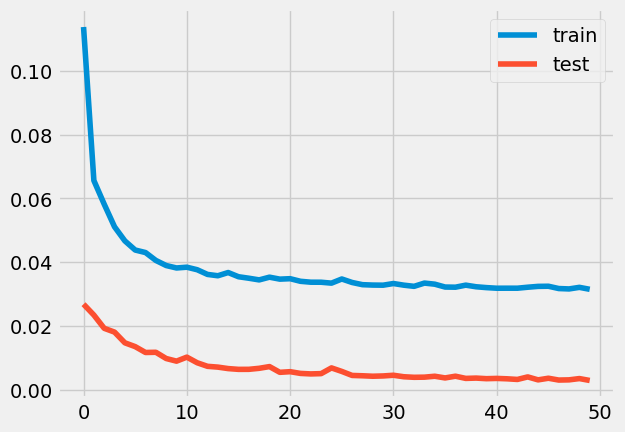

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 141ms/step - loss: 0.1393 - accuracy: 0.0040 - val_loss: 0.0433 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 97ms/step - loss: 0.0677 - accuracy: 0.0049 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

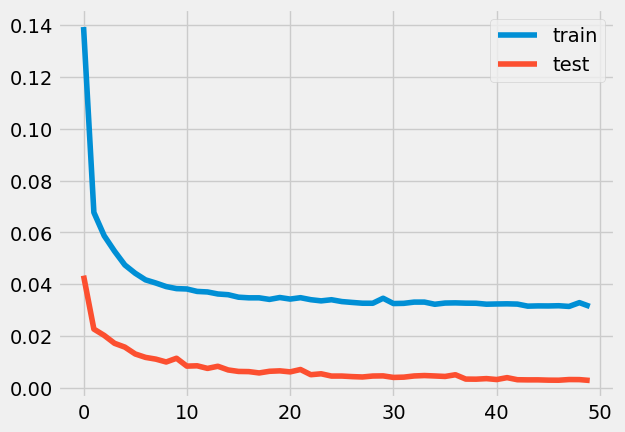

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 126ms/step - loss: 0.1820 - accuracy: 0.0000e+00 - val_loss: 0.0526 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0695 - accuracy: 0.0048 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

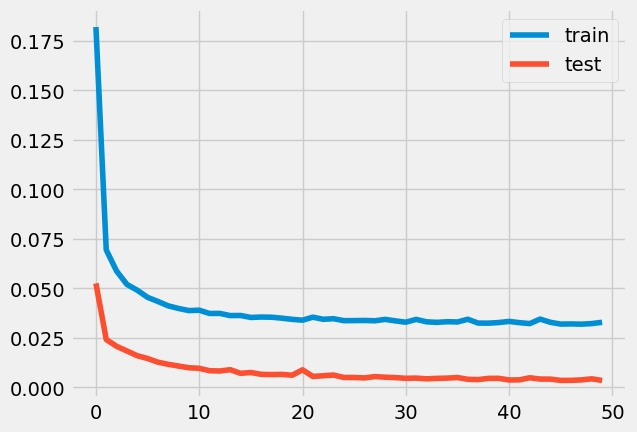

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 136ms/step - loss: 0.1207 - accuracy: 0.0031 - val_loss: 0.0376 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0643 - accuracy: 0.0064 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

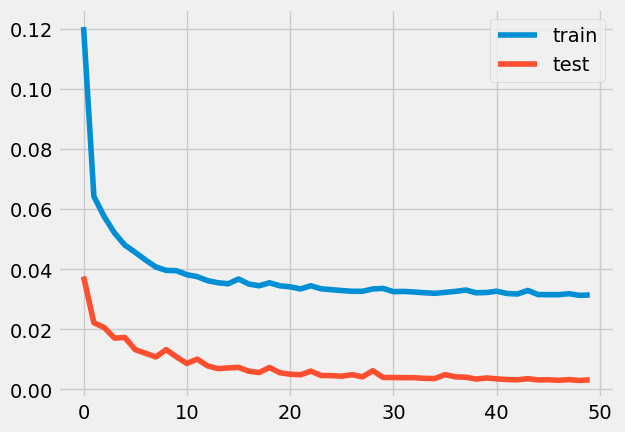

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 169ms/step - loss: 0.1690 - accuracy: 0.0017 - val_loss: 0.0534 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0709 - accuracy: 0.0058 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

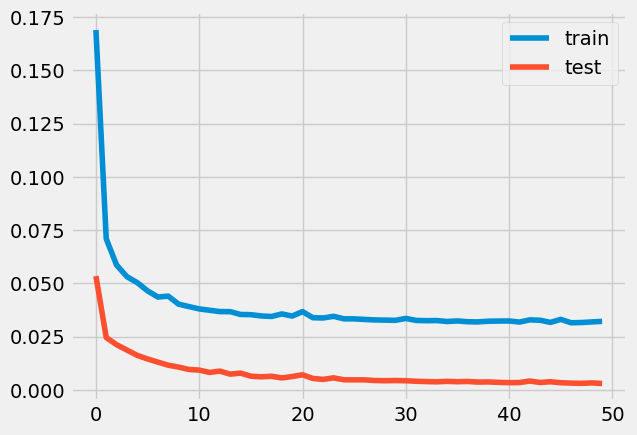

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 146ms/step - loss: 0.1979 - accuracy: 0.0000e+00 - val_loss: 0.0317 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0699 - accuracy: 0.0059 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

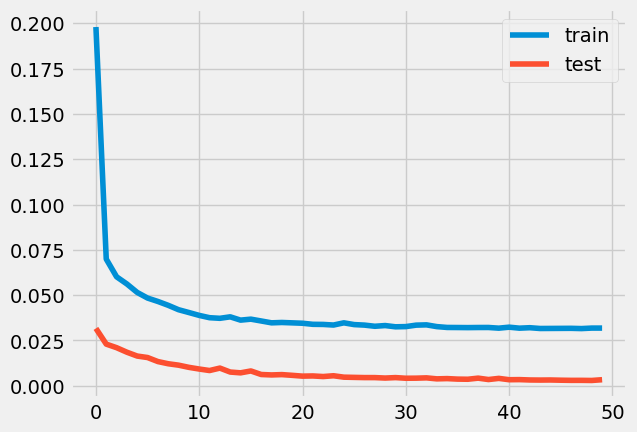

0.8548995532738604
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 186ms/step - loss: 0.1665 - accuracy: 0.0000e+00 - val_loss: 0.0474 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0678 - accuracy: 0.0052 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Ep

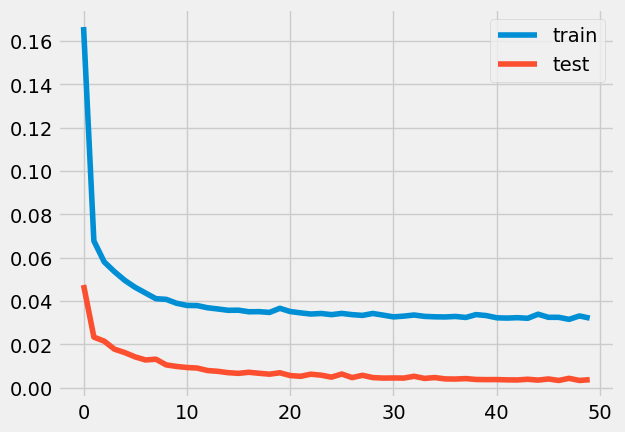

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 161ms/step - loss: 0.1258 - accuracy: 0.0039 - val_loss: 0.0414 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.0696 - accuracy: 0.0055 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

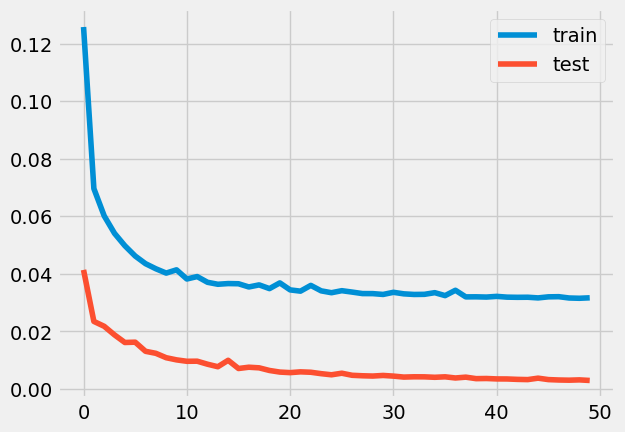

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 168ms/step - loss: 0.1173 - accuracy: 0.0054 - val_loss: 0.0313 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.0664 - accuracy: 0.0051 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

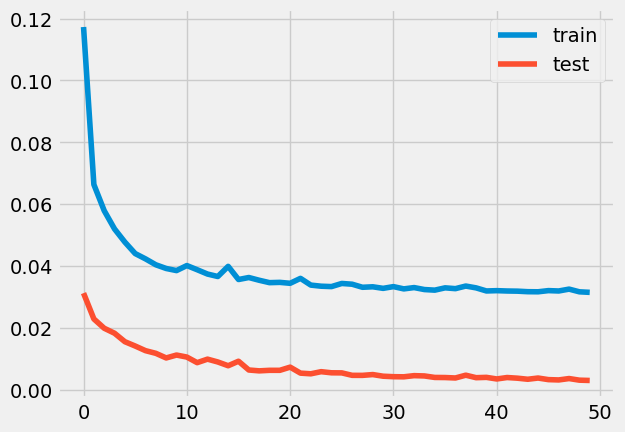

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 205ms/step - loss: 0.1750 - accuracy: 0.0017 - val_loss: 0.0455 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 110ms/step - loss: 0.0762 - accuracy: 0.0075 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

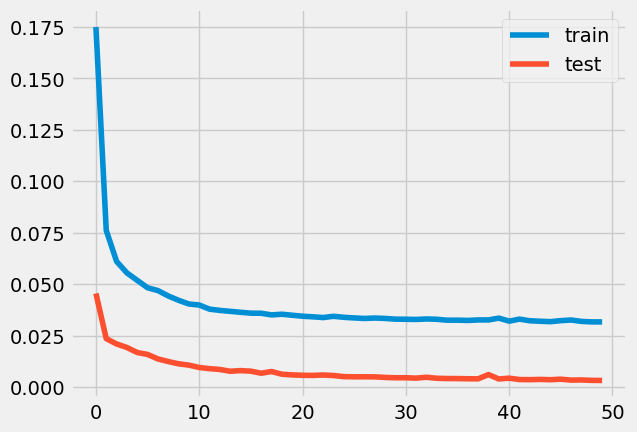

0.9323418306627885
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 150ms/step - loss: 0.1277 - accuracy: 0.0017 - val_loss: 0.0376 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.0687 - accuracy: 0.0064 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 

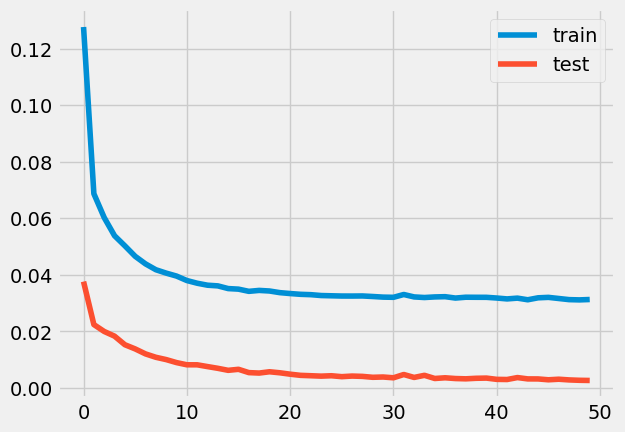

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 137ms/step - loss: 0.2059 - accuracy: 0.0000e+00 - val_loss: 0.0484 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 92ms/step - loss: 0.0781 - accuracy: 0.0058 - val_loss: 0.0278 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

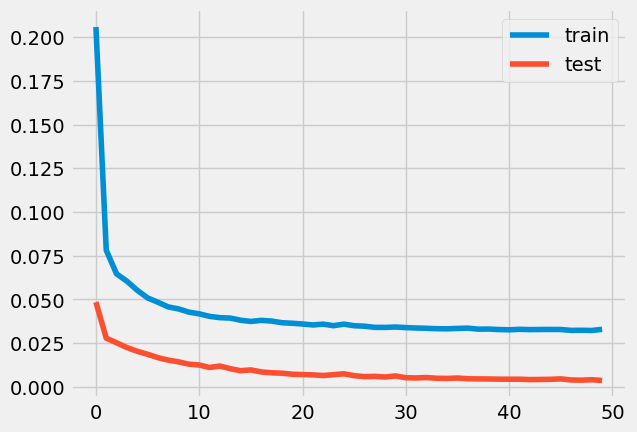

0.6736695116349524
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 150ms/step - loss: 0.1459 - accuracy: 5.7172e-04 - val_loss: 0.0463 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0755 - accuracy: 0.0053 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Ep

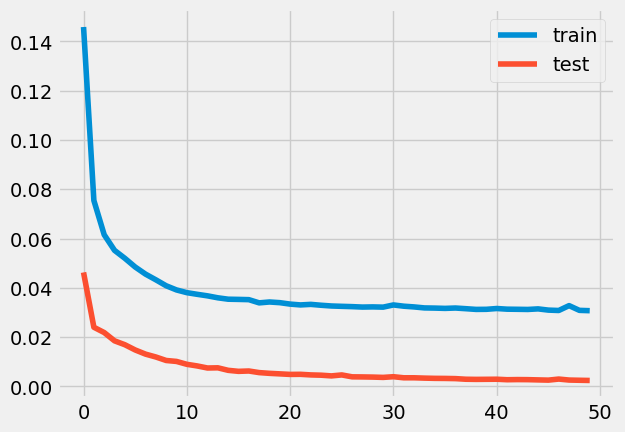

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.1524 - accuracy: 0.0000e+00 - val_loss: 0.0436 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.0713 - accuracy: 0.0057 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

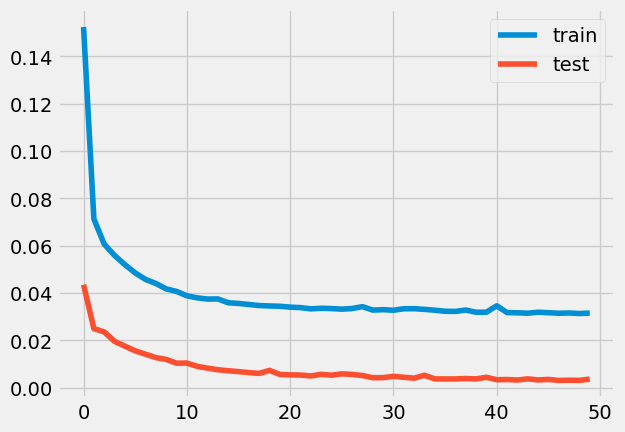

0.6140244684840359
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 151ms/step - loss: 0.1652 - accuracy: 0.0038 - val_loss: 0.0531 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 103ms/step - loss: 0.0718 - accuracy: 0.0053 - val_loss: 0.0256 - val_accuracy: 0.0000e+00
Epoch

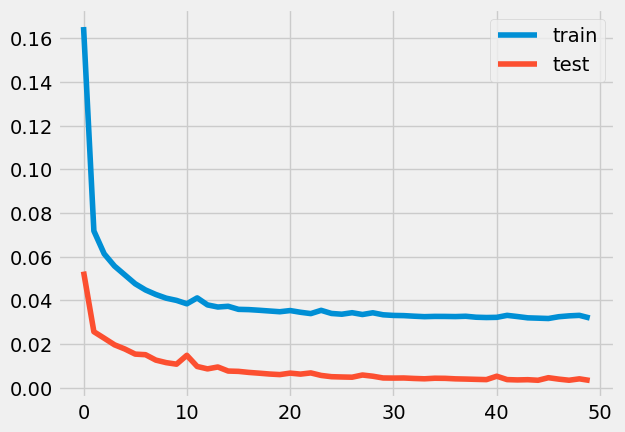

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 130ms/step - loss: 0.1561 - accuracy: 0.0000e+00 - val_loss: 0.0448 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0731 - accuracy: 0.0055 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

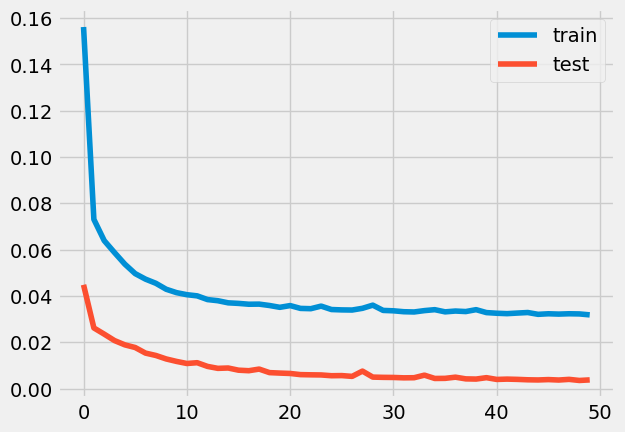

0.8258911780503371
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.2369 - accuracy: 0.0028 - val_loss: 0.0314 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0785 - accuracy: 0.0064 - val_loss: 0.0271 - val_accuracy: 0.0000e+00
Epoch 

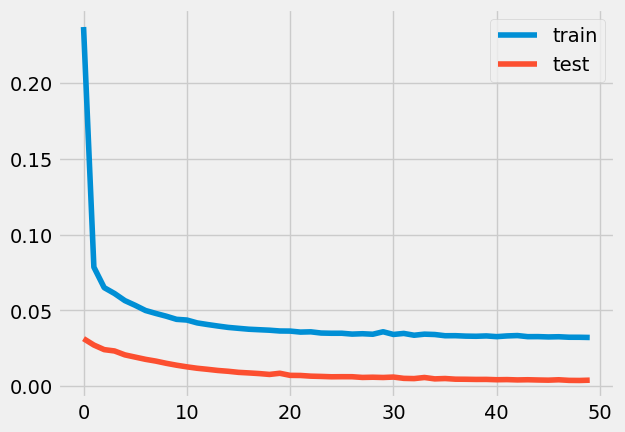

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 184ms/step - loss: 0.1163 - accuracy: 0.0021 - val_loss: 0.0388 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.0700 - accuracy: 0.0059 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

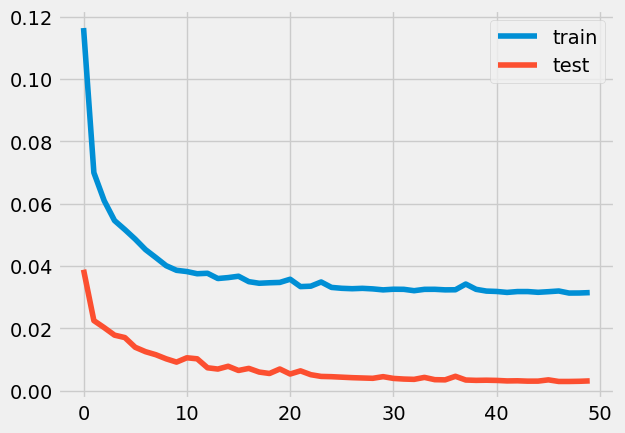

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 131ms/step - loss: 0.2189 - accuracy: 0.0000e+00 - val_loss: 0.0459 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0753 - accuracy: 0.0053 - val_loss: 0.0260 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

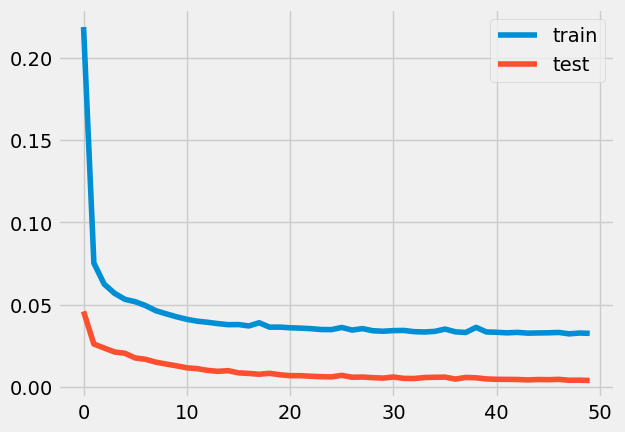

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 120ms/step - loss: 0.1790 - accuracy: 0.0013 - val_loss: 0.0471 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0698 - accuracy: 0.0053 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

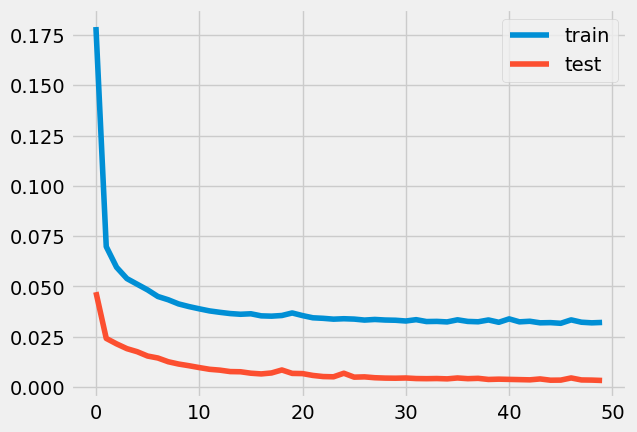

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.2094 - accuracy: 0.0000e+00 - val_loss: 0.0346 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.0736 - accuracy: 0.0064 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

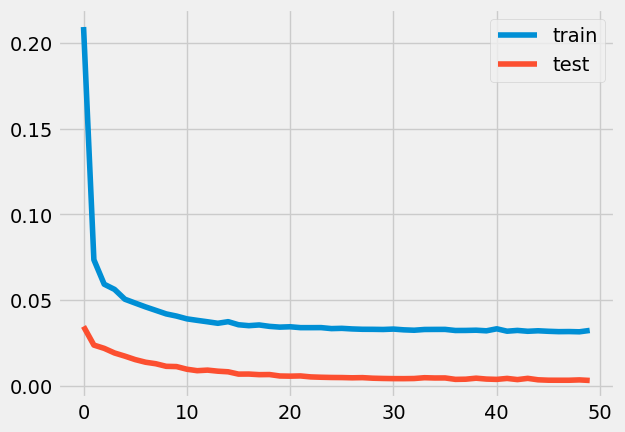

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 144ms/step - loss: 0.1426 - accuracy: 0.0000e+00 - val_loss: 0.0459 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0684 - accuracy: 0.0053 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

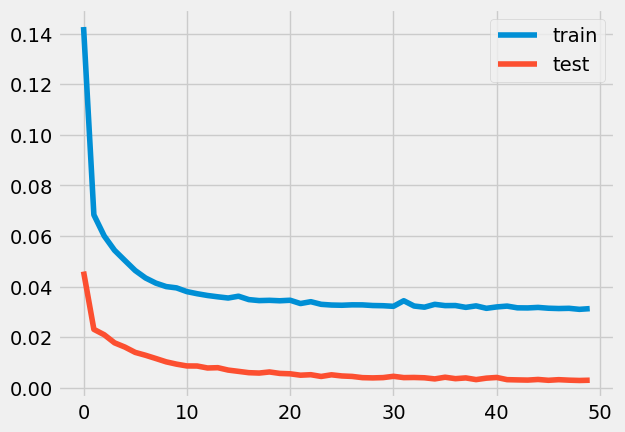

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 130ms/step - loss: 0.1177 - accuracy: 0.0033 - val_loss: 0.0396 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0706 - accuracy: 0.0047 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

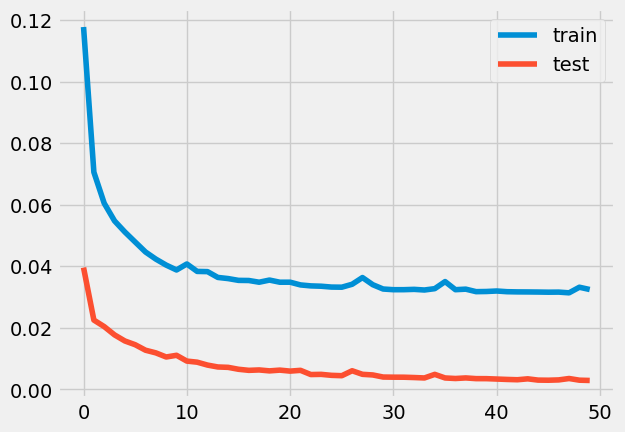

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 131ms/step - loss: 0.2286 - accuracy: 0.0000e+00 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0708 - accuracy: 0.0055 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

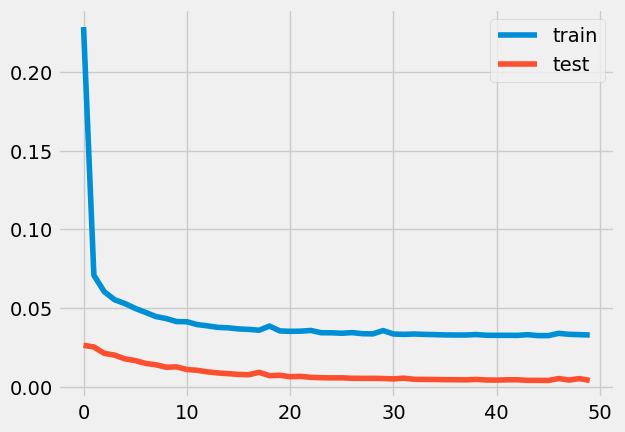

0.6686133254294301
0.00125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 129ms/step - loss: 0.2658 - accuracy: 0.0000e+00 - val_loss: 0.0309 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0716 - accuracy: 0.0057 - val_loss: 0.0270 - val_accuracy: 0.000

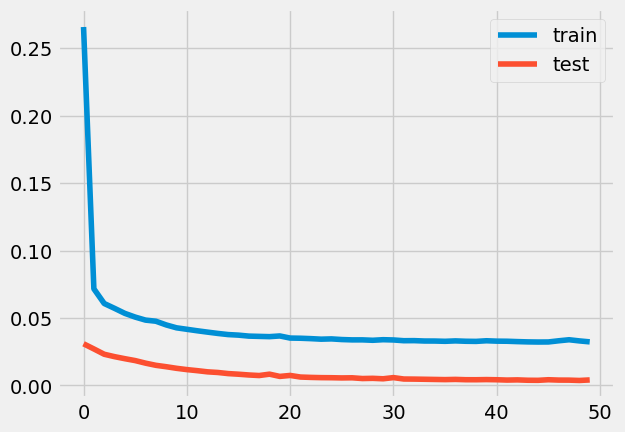

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 167ms/step - loss: 0.1299 - accuracy: 0.0023 - val_loss: 0.0452 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.0695 - accuracy: 0.0063 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

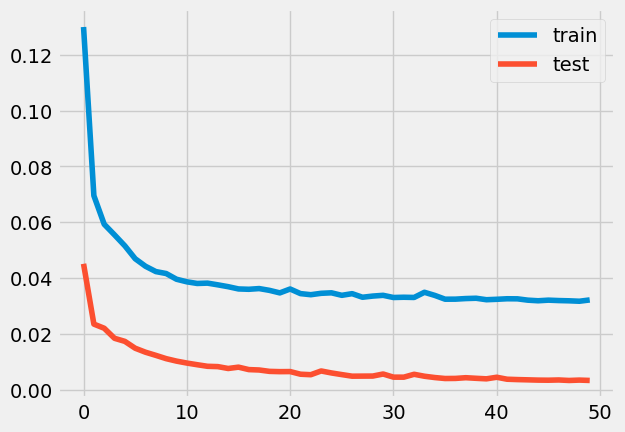

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.1152 - accuracy: 6.8033e-04 - val_loss: 0.0357 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 99ms/step - loss: 0.0678 - accuracy: 0.0070 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

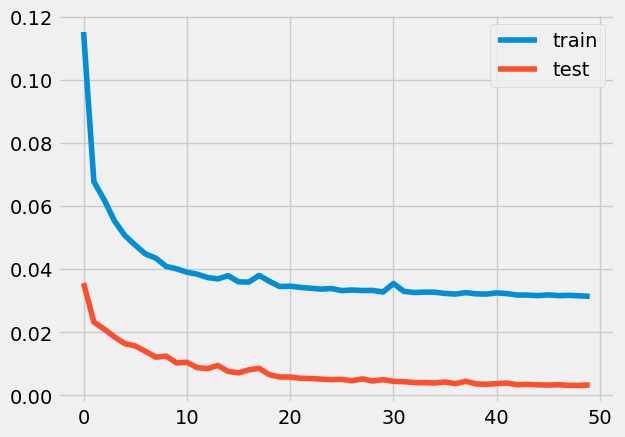

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 132ms/step - loss: 0.1300 - accuracy: 0.0000e+00 - val_loss: 0.0449 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0683 - accuracy: 0.0059 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

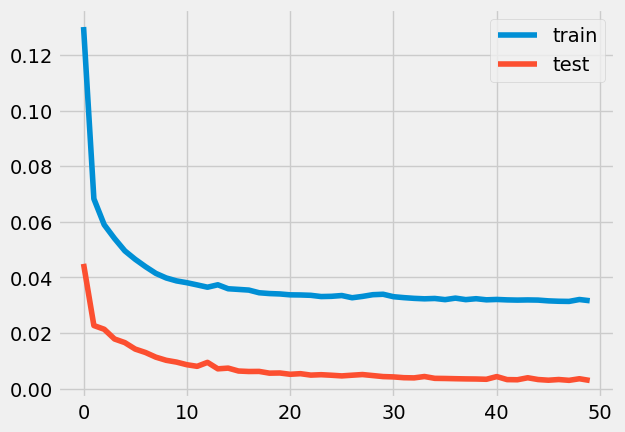

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 123ms/step - loss: 0.1993 - accuracy: 0.0033 - val_loss: 0.0366 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0699 - accuracy: 0.0052 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

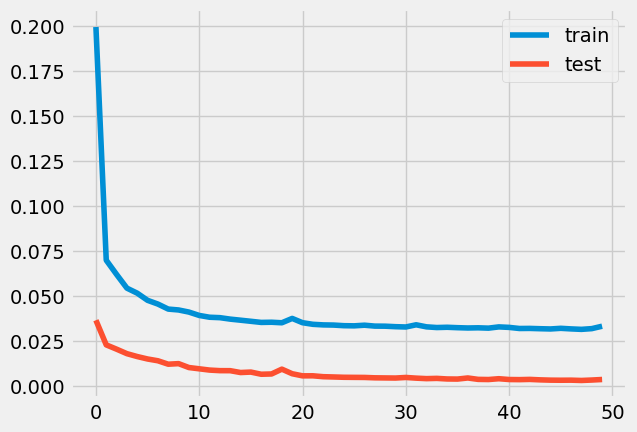

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 152ms/step - loss: 0.1174 - accuracy: 0.0023 - val_loss: 0.0374 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 92ms/step - loss: 0.0653 - accuracy: 0.0077 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

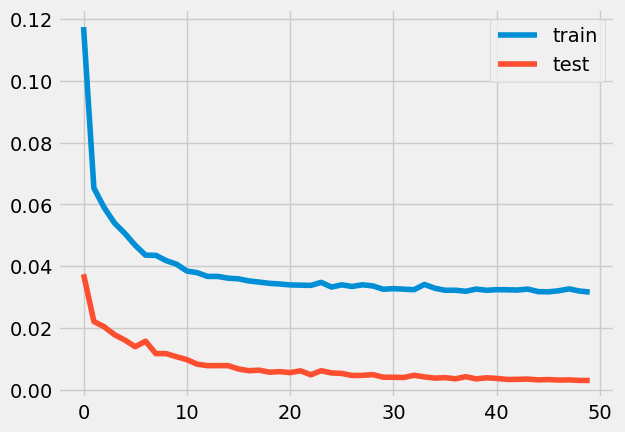

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 124ms/step - loss: 0.2243 - accuracy: 0.0000e+00 - val_loss: 0.0351 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0759 - accuracy: 0.0059 - val_loss: 0.0267 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

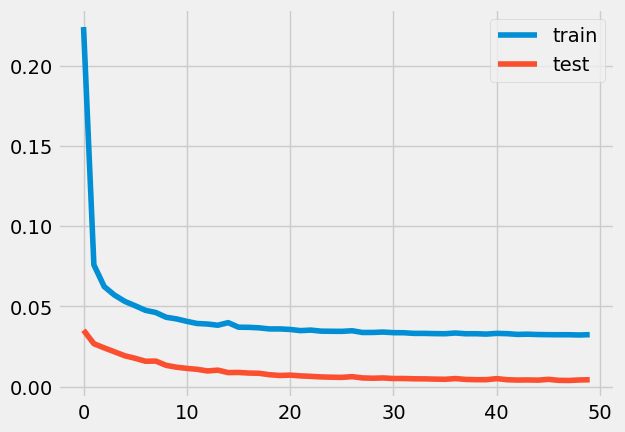

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 135ms/step - loss: 0.1262 - accuracy: 2.8484e-04 - val_loss: 0.0366 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0694 - accuracy: 0.0054 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

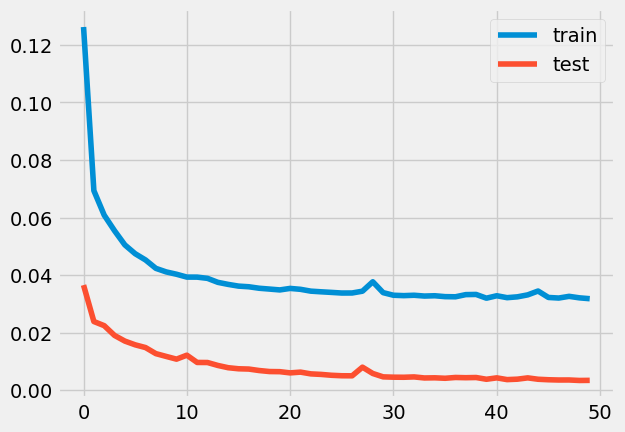

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 143ms/step - loss: 0.1385 - accuracy: 0.0012 - val_loss: 0.0424 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0735 - accuracy: 0.0061 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

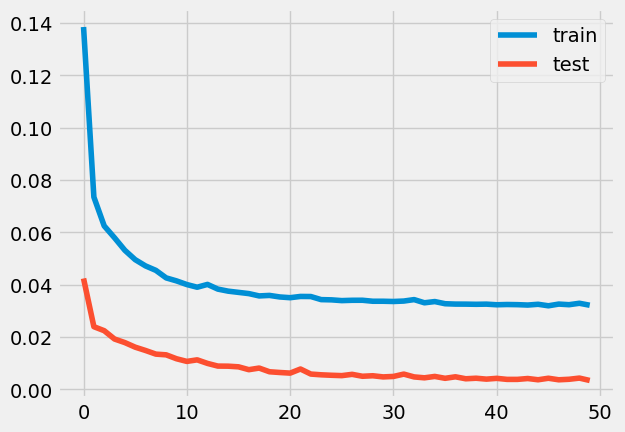

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.2594 - accuracy: 0.0000e+00 - val_loss: 0.0422 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.0737 - accuracy: 0.0049 - val_loss: 0.0316 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

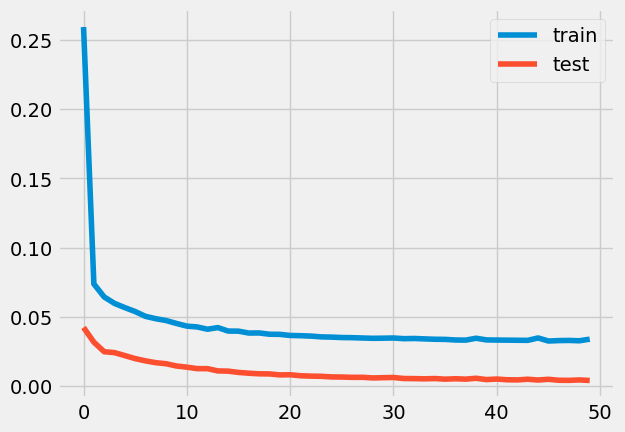

0.6518179106385648
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 129ms/step - loss: 0.1885 - accuracy: 7.3156e-04 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0701 - accuracy: 0.0058 - val_loss: 0.0264 - val_accuracy: 0.0000e+00
Ep

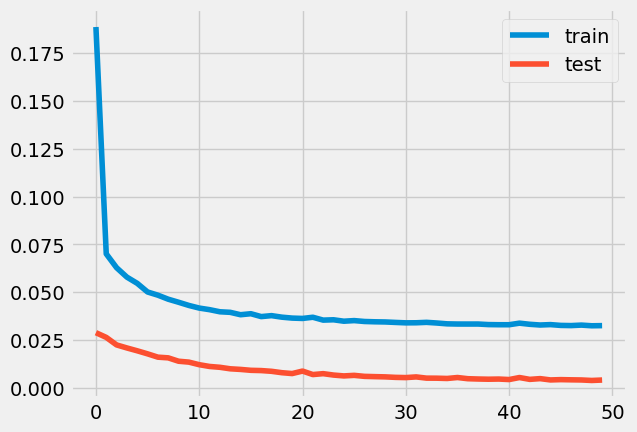

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 149ms/step - loss: 0.1136 - accuracy: 0.0029 - val_loss: 0.0383 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.0691 - accuracy: 0.0051 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

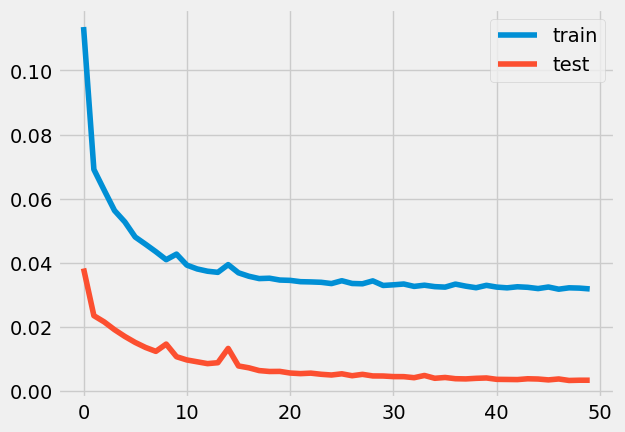

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 119ms/step - loss: 0.1713 - accuracy: 1.4139e-04 - val_loss: 0.0405 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0743 - accuracy: 0.0065 - val_loss: 0.0260 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

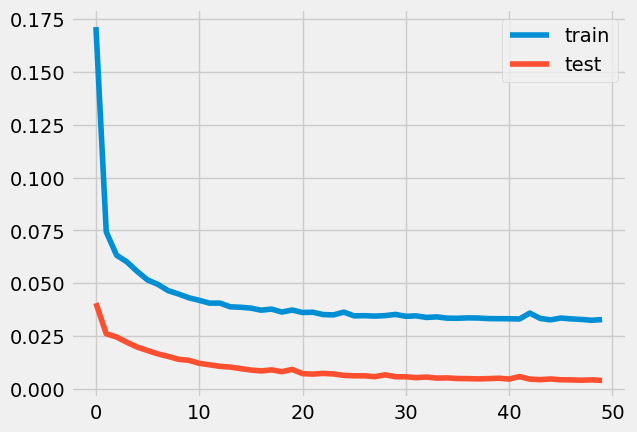

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 126ms/step - loss: 0.1571 - accuracy: 0.0018 - val_loss: 0.0417 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 74ms/step - loss: 0.0754 - accuracy: 0.0050 - val_loss: 0.0272 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

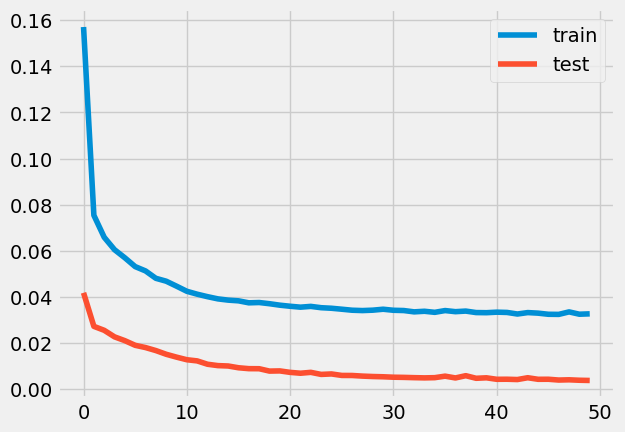

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 123ms/step - loss: 0.1575 - accuracy: 0.0000e+00 - val_loss: 0.0274 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0703 - accuracy: 0.0063 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

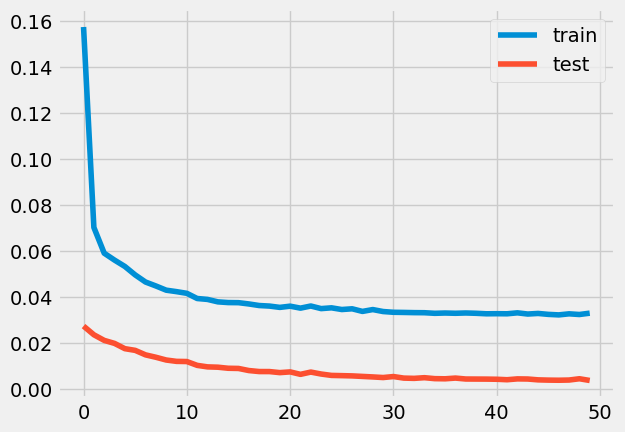

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 119ms/step - loss: 0.0988 - accuracy: 0.0022 - val_loss: 0.0346 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0676 - accuracy: 0.0047 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

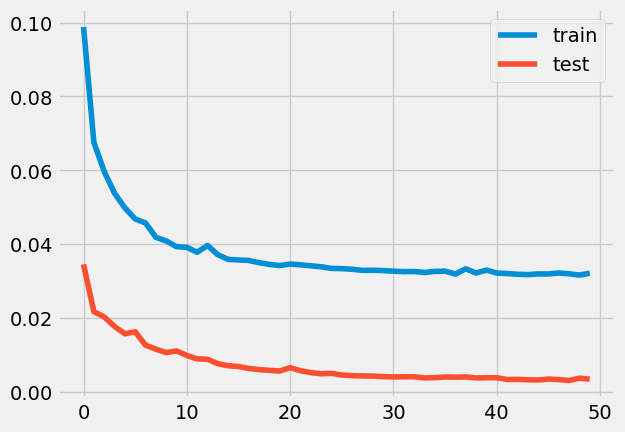

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.1135 - accuracy: 0.0035 - val_loss: 0.0438 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0734 - accuracy: 0.0048 - val_loss: 0.0257 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

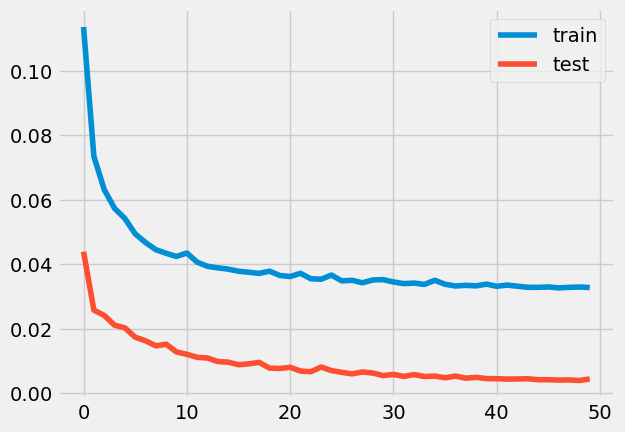

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 155ms/step - loss: 0.2244 - accuracy: 0.0000e+00 - val_loss: 0.0316 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 118ms/step - loss: 0.0715 - accuracy: 0.0058 - val_loss: 0.0271 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

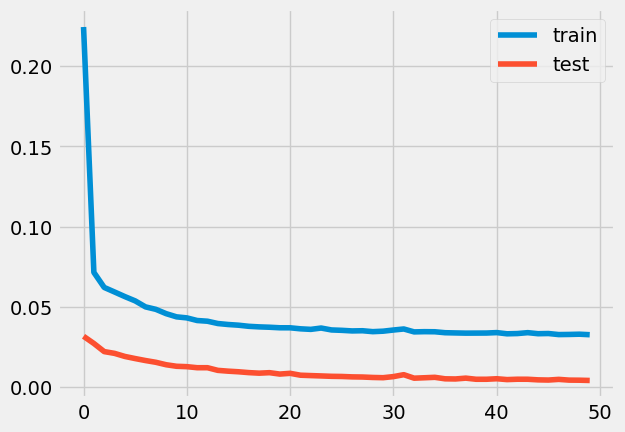

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 145ms/step - loss: 0.1712 - accuracy: 4.7951e-04 - val_loss: 0.0279 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 103ms/step - loss: 0.0725 - accuracy: 0.0051 - val_loss: 0.0253 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

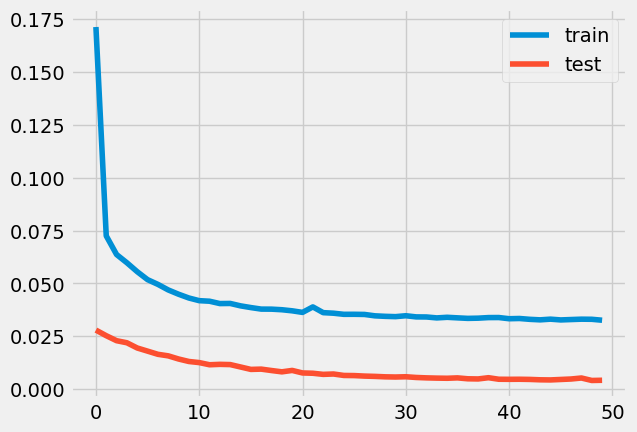

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 142ms/step - loss: 0.1610 - accuracy: 0.0026 - val_loss: 0.0319 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 91ms/step - loss: 0.0745 - accuracy: 0.0051 - val_loss: 0.0268 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

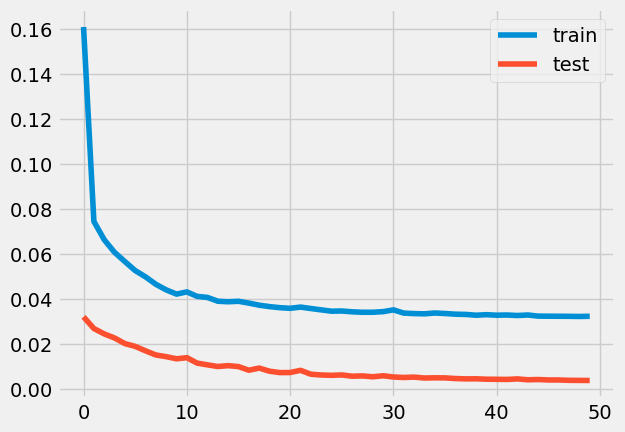

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 138ms/step - loss: 0.1109 - accuracy: 0.0018 - val_loss: 0.0342 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0693 - accuracy: 0.0048 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

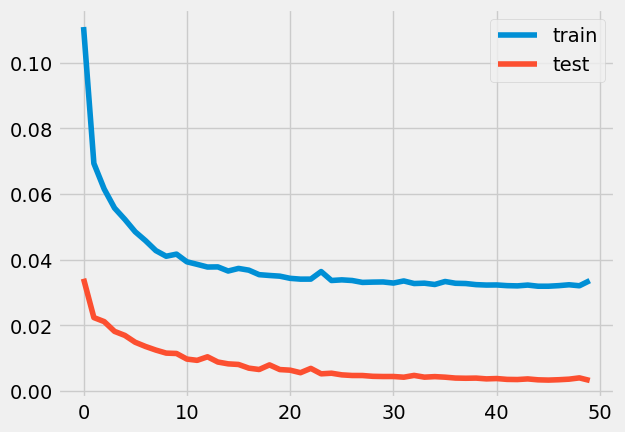

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 139ms/step - loss: 0.1798 - accuracy: 0.0015 - val_loss: 0.0376 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0752 - accuracy: 0.0065 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

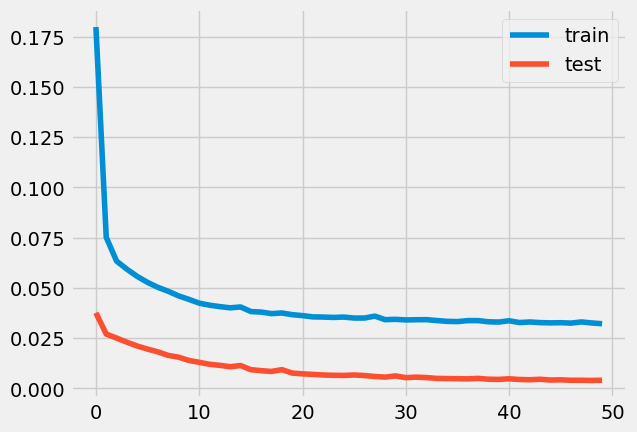

0.5162156646486838
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 159ms/step - loss: 0.1146 - accuracy: 0.0031 - val_loss: 0.0400 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.0721 - accuracy: 0.0053 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 

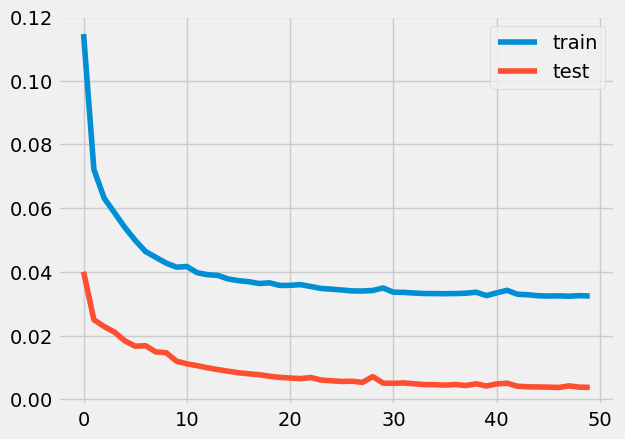

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 160ms/step - loss: 0.1442 - accuracy: 5.9426e-05 - val_loss: 0.0404 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 128ms/step - loss: 0.0721 - accuracy: 0.0060 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

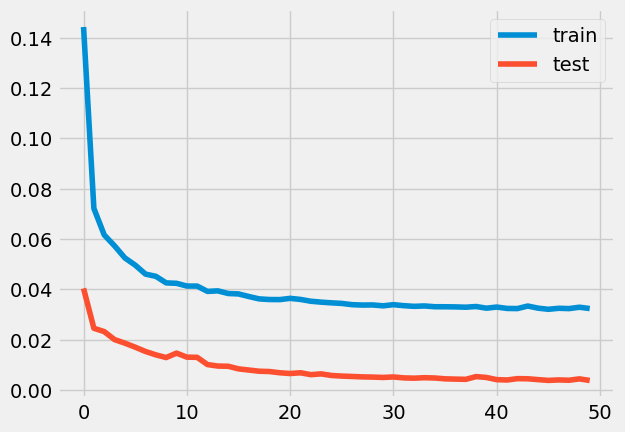

0.9573624433886897
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 137ms/step - loss: 0.1099 - accuracy: 0.0059 - val_loss: 0.0457 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0721 - accuracy: 0.0055 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 

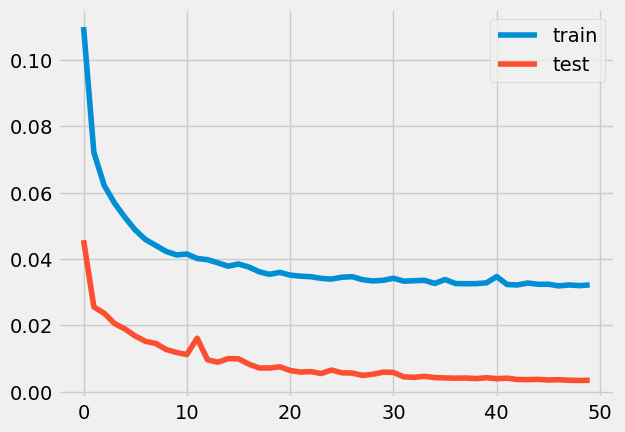

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 149ms/step - loss: 0.1412 - accuracy: 2.0492e-04 - val_loss: 0.0392 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 95ms/step - loss: 0.0705 - accuracy: 0.0066 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

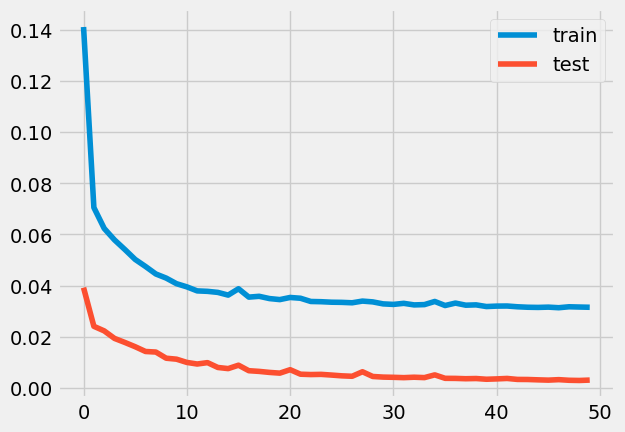

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.2398 - accuracy: 1.9057e-04 - val_loss: 0.0320 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 110ms/step - loss: 0.0816 - accuracy: 0.0055 - val_loss: 0.0275 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

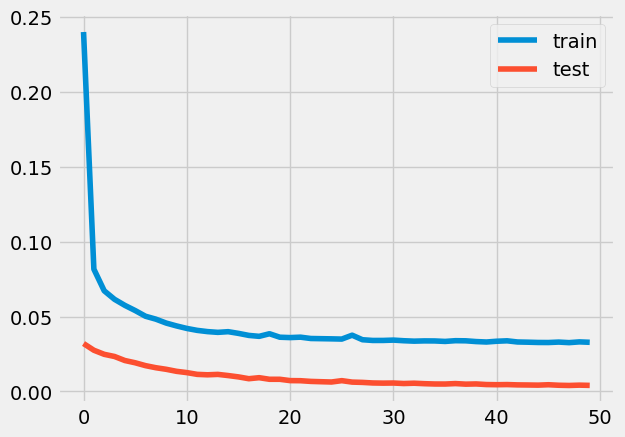

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 137ms/step - loss: 0.1457 - accuracy: 0.0019 - val_loss: 0.0314 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0724 - accuracy: 0.0052 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

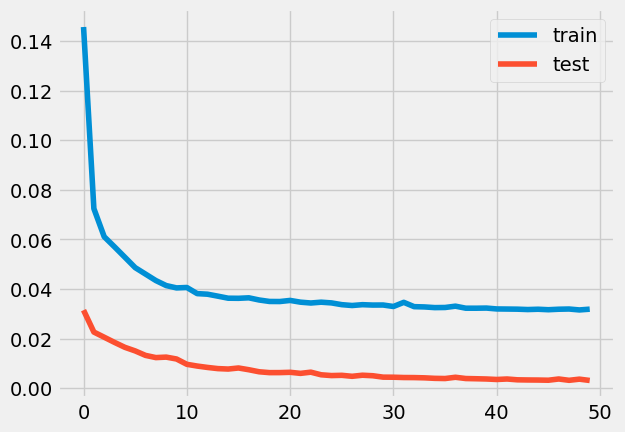

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 151ms/step - loss: 0.1622 - accuracy: 0.0019 - val_loss: 0.0465 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0699 - accuracy: 0.0047 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

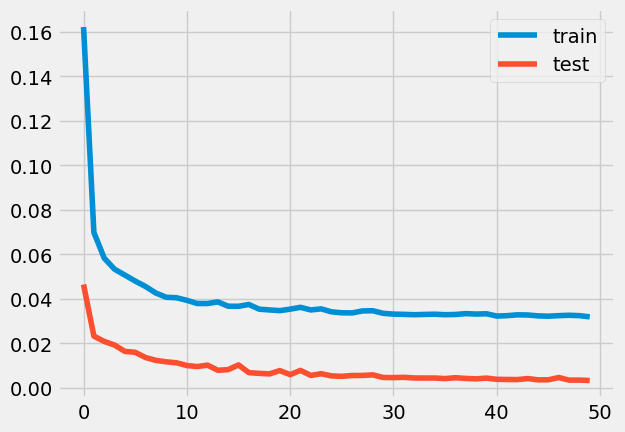

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 151ms/step - loss: 0.1205 - accuracy: 0.0018 - val_loss: 0.0419 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0712 - accuracy: 0.0065 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

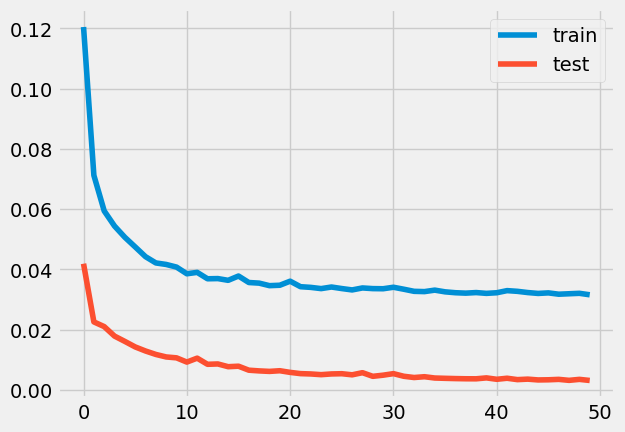

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 161ms/step - loss: 0.1543 - accuracy: 0.0012 - val_loss: 0.0427 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 102ms/step - loss: 0.0693 - accuracy: 0.0057 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

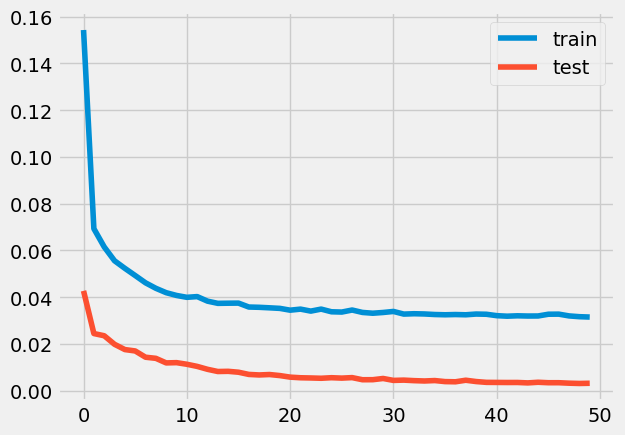

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 126ms/step - loss: 0.1052 - accuracy: 0.0012 - val_loss: 0.0349 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0658 - accuracy: 0.0054 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

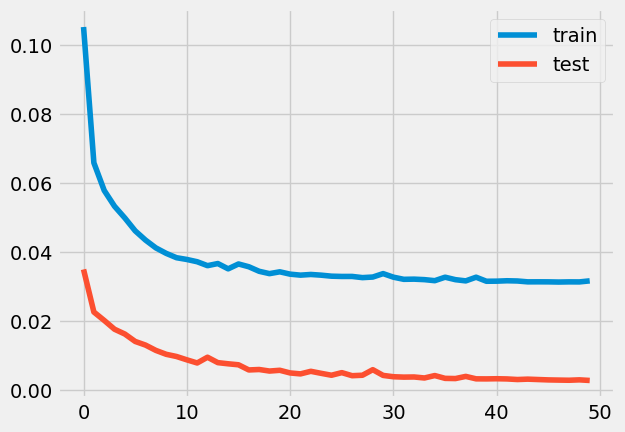

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 130ms/step - loss: 0.1691 - accuracy: 0.0037 - val_loss: 0.0542 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0737 - accuracy: 0.0060 - val_loss: 0.0271 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

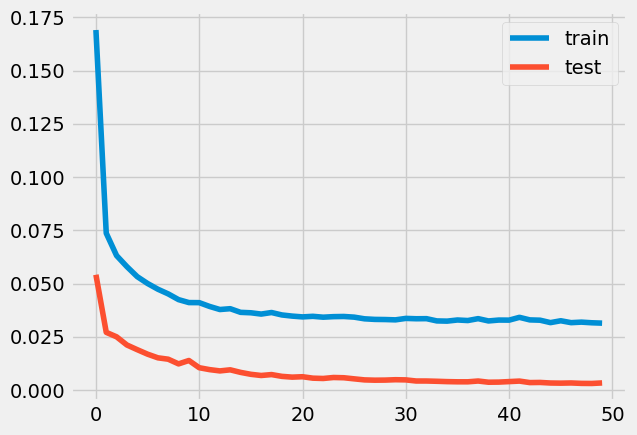

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 132ms/step - loss: 0.0937 - accuracy: 0.0044 - val_loss: 0.0292 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0649 - accuracy: 0.0061 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

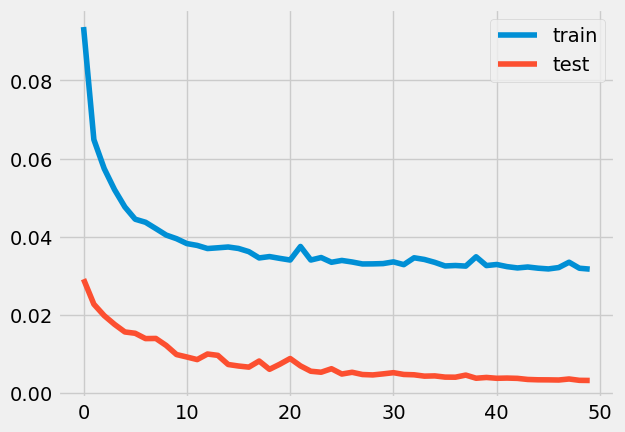

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 135ms/step - loss: 0.1089 - accuracy: 0.0043 - val_loss: 0.0362 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 92ms/step - loss: 0.0664 - accuracy: 0.0061 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

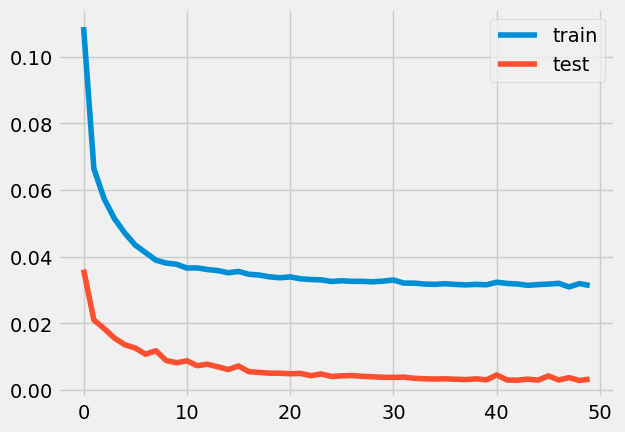

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 141ms/step - loss: 0.1217 - accuracy: 0.0025 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0661 - accuracy: 0.0061 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

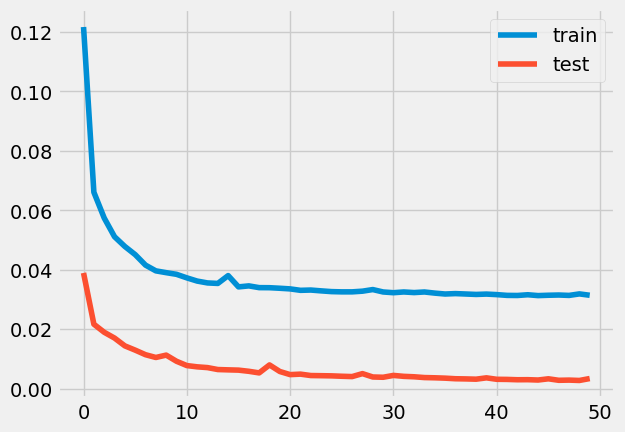

0.883467041241476
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 139ms/step - loss: 0.1524 - accuracy: 2.7459e-04 - val_loss: 0.0406 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 91ms/step - loss: 0.0700 - accuracy: 0.0058 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epo

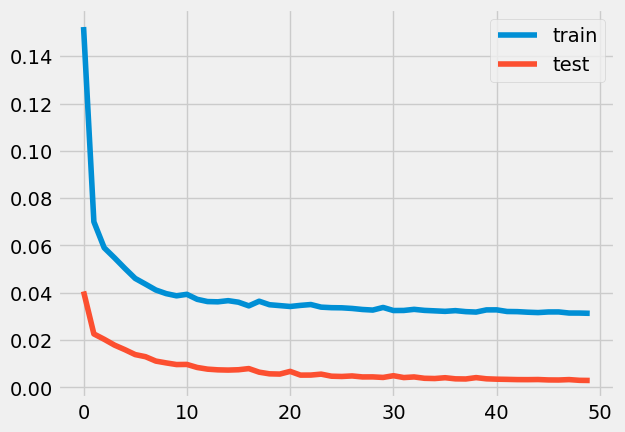

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 139ms/step - loss: 0.1150 - accuracy: 1.7008e-04 - val_loss: 0.0321 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0671 - accuracy: 0.0046 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

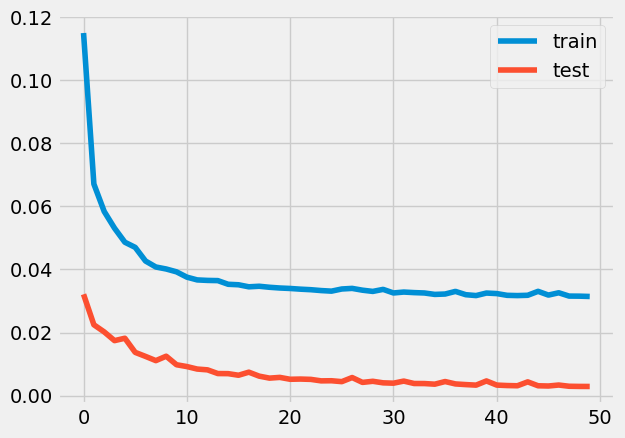

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 148ms/step - loss: 0.1116 - accuracy: 0.0054 - val_loss: 0.0383 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 100ms/step - loss: 0.0653 - accuracy: 0.0051 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

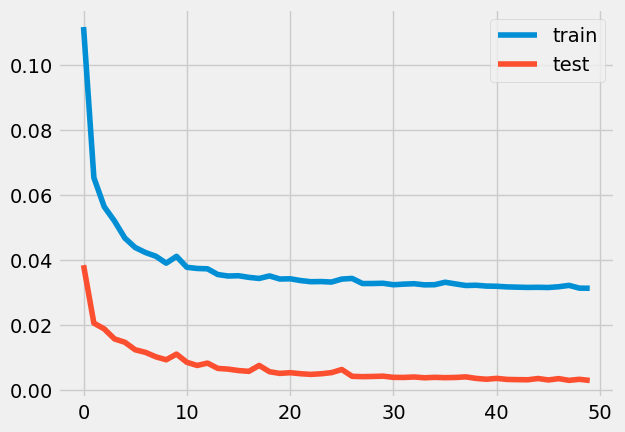

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 130ms/step - loss: 0.1446 - accuracy: 0.0021 - val_loss: 0.0487 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 91ms/step - loss: 0.0670 - accuracy: 0.0066 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

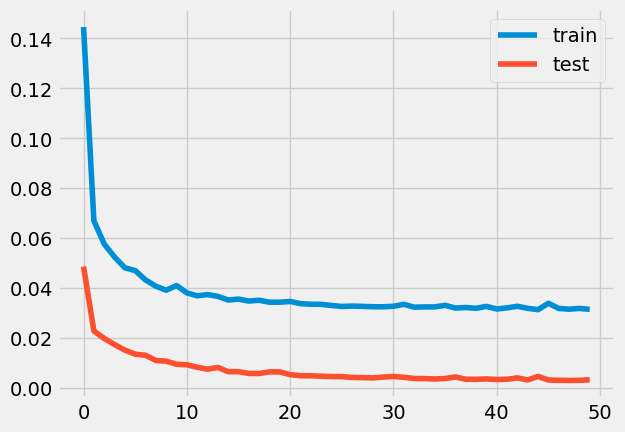

0.6683715767984867
0.000625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 128ms/step - loss: 0.1193 - accuracy: 0.0022 - val_loss: 0.0366 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0670 - accuracy: 0.0053 - val_loss: 0.0222 - val_accuracy: 0.0000e+

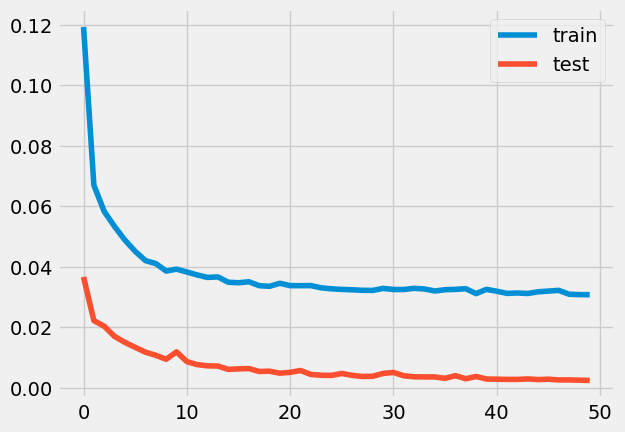

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 134ms/step - loss: 0.1056 - accuracy: 0.0043 - val_loss: 0.0291 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0664 - accuracy: 0.0062 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

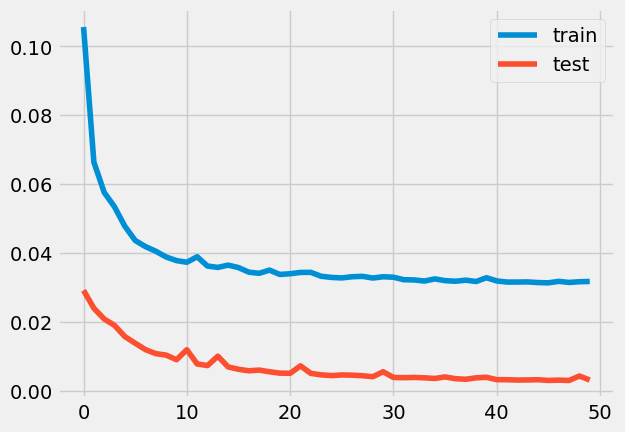

0.3300099051888912
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 129ms/step - loss: 0.1863 - accuracy: 0.0000e+00 - val_loss: 0.0417 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0686 - accuracy: 0.0059 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Ep

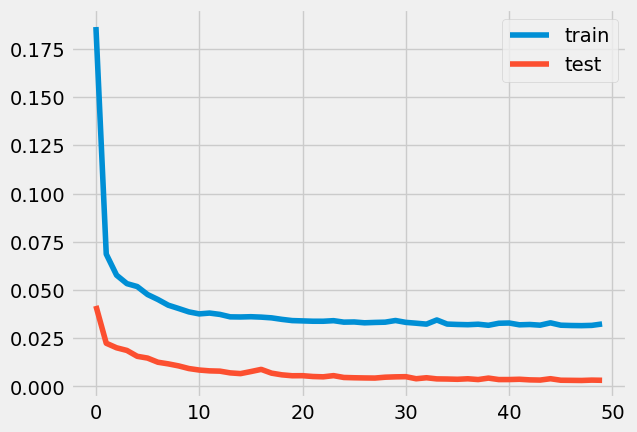

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 144ms/step - loss: 0.2036 - accuracy: 0.0010 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0710 - accuracy: 0.0052 - val_loss: 0.0243 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

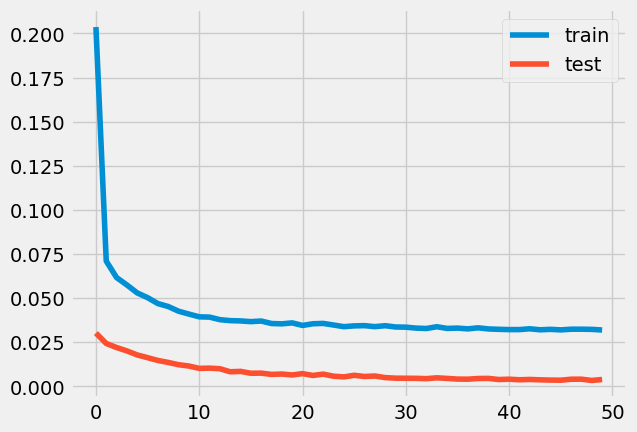

0.30015246502543014
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 147ms/step - loss: 0.1659 - accuracy: 0.0015 - val_loss: 0.0479 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 100ms/step - loss: 0.0714 - accuracy: 0.0052 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoc

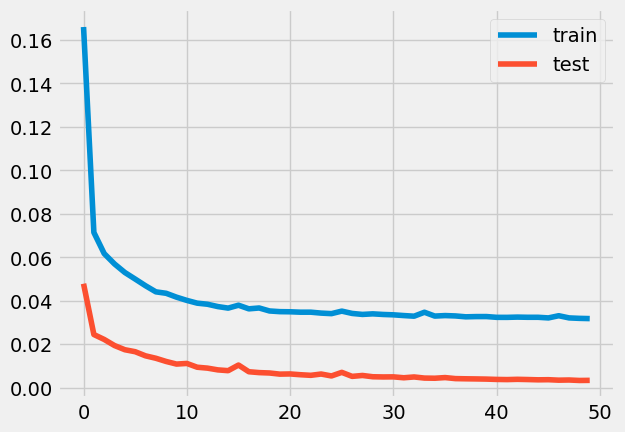

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 151ms/step - loss: 0.1664 - accuracy: 0.0030 - val_loss: 0.0415 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.0710 - accuracy: 0.0063 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

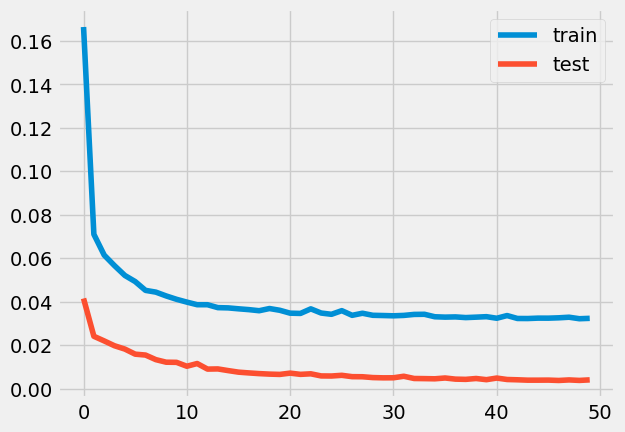

0.3360820605734967
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 141ms/step - loss: 0.1663 - accuracy: 0.0025 - val_loss: 0.0533 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0726 - accuracy: 0.0049 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 

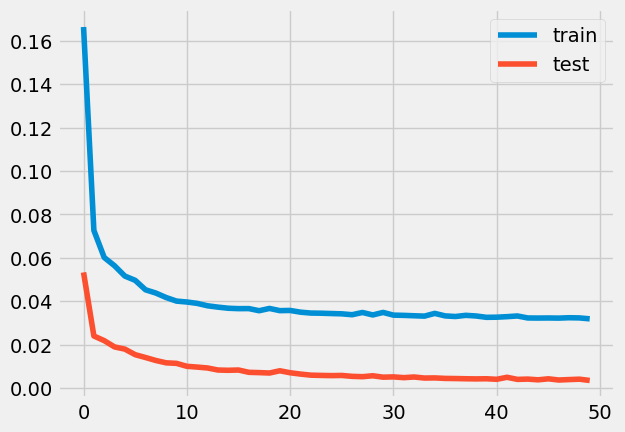

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 131ms/step - loss: 0.1054 - accuracy: 0.0042 - val_loss: 0.0358 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0652 - accuracy: 0.0055 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

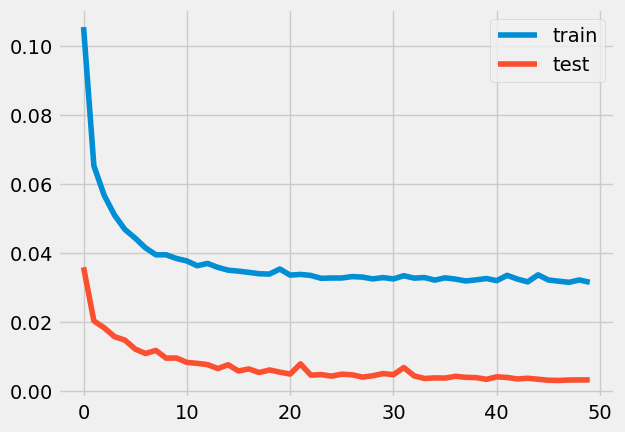

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 139ms/step - loss: 0.1100 - accuracy: 0.0047 - val_loss: 0.0348 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0674 - accuracy: 0.0049 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

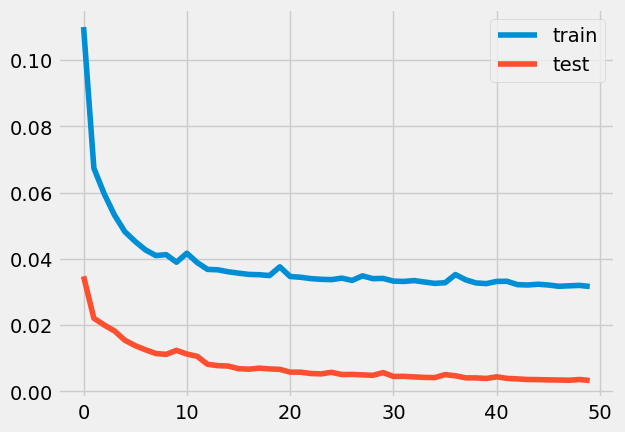

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 136ms/step - loss: 0.1509 - accuracy: 0.0000e+00 - val_loss: 0.0354 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0698 - accuracy: 0.0053 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

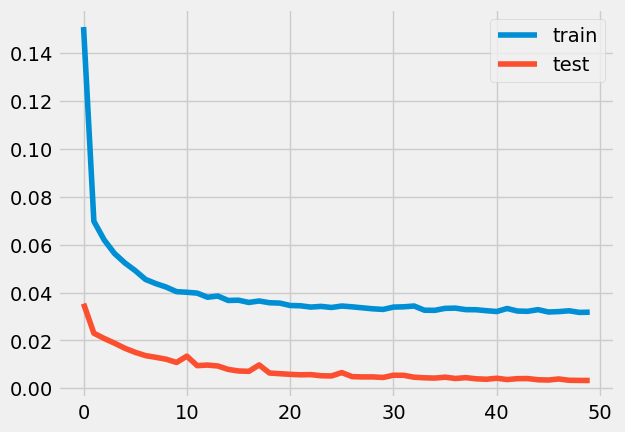

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 189ms/step - loss: 0.2382 - accuracy: 6.7623e-05 - val_loss: 0.0317 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 102ms/step - loss: 0.0775 - accuracy: 0.0054 - val_loss: 0.0281 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

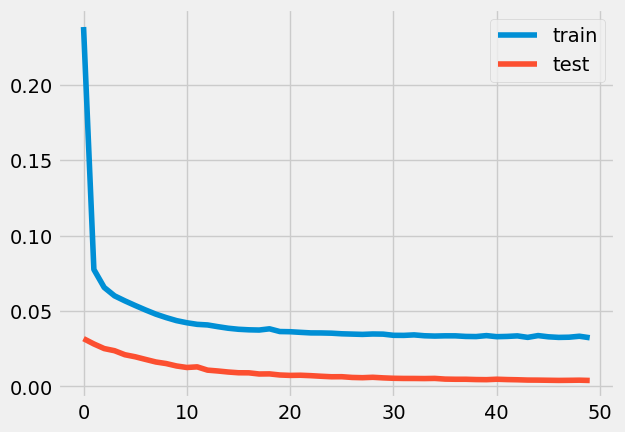

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 125ms/step - loss: 0.0854 - accuracy: 0.0049 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0632 - accuracy: 0.0051 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

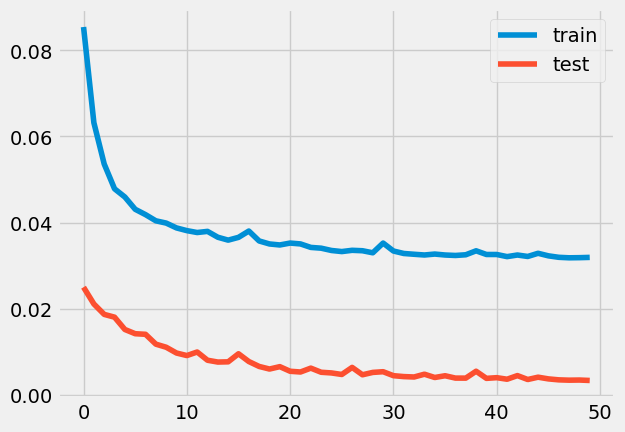

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.1211 - accuracy: 0.0047 - val_loss: 0.0452 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 76ms/step - loss: 0.0708 - accuracy: 0.0059 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

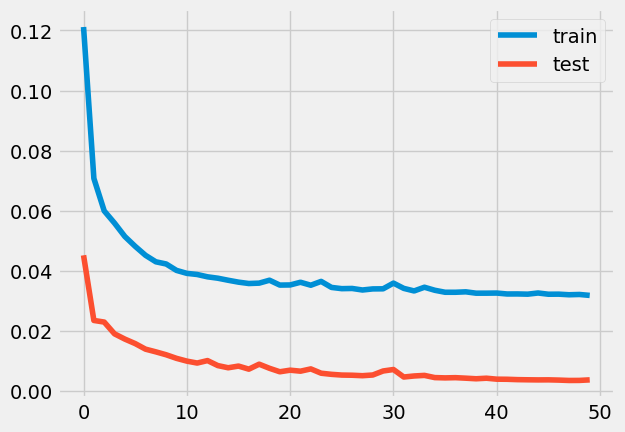

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 408ms/step - loss: 0.1209 - accuracy: 0.0043 - val_loss: 0.0473 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 6s 317ms/step - loss: 0.0730 - accuracy: 0.0058 - val_loss: 0.0248 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

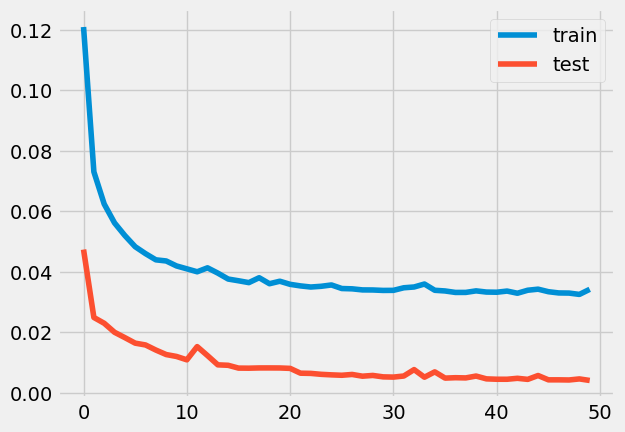

0.7408561319631601
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 207ms/step - loss: 0.1301 - accuracy: 0.0025 - val_loss: 0.0492 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 164ms/step - loss: 0.0713 - accuracy: 0.0051 - val_loss: 0.0267 - val_accuracy: 0.0000e+00
Epoch

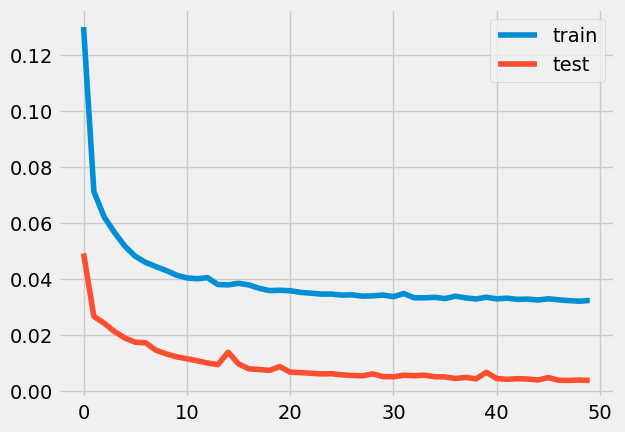

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 223ms/step - loss: 0.1549 - accuracy: 1.0861e-04 - val_loss: 0.0535 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 127ms/step - loss: 0.0746 - accuracy: 0.0056 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

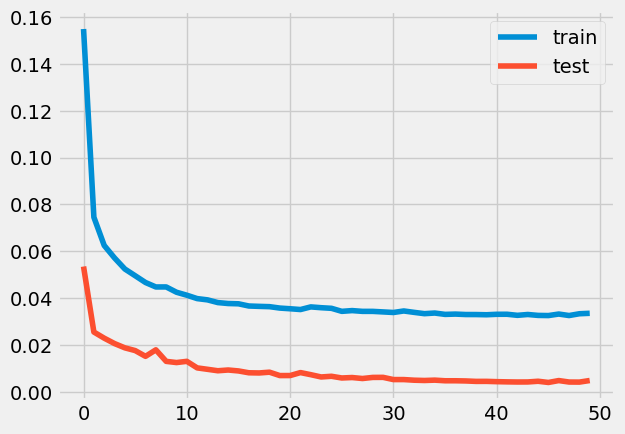

0.20327164570755316
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 206ms/step - loss: 0.1464 - accuracy: 0.0018 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 144ms/step - loss: 0.0724 - accuracy: 0.0055 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epo

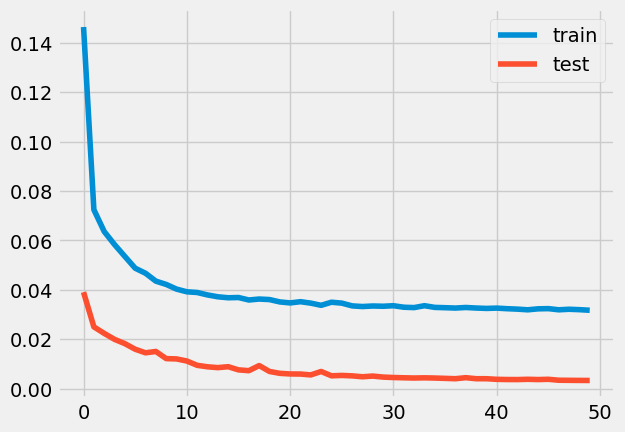

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 369ms/step - loss: 0.1652 - accuracy: 0.0018 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 209ms/step - loss: 0.0767 - accuracy: 0.0058 - val_loss: 0.0253 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

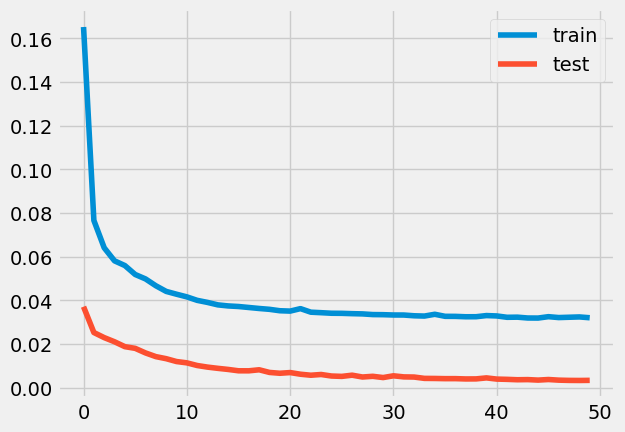

0.8186694233394615
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 203ms/step - loss: 0.1276 - accuracy: 0.0032 - val_loss: 0.0395 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 119ms/step - loss: 0.0687 - accuracy: 0.0050 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch

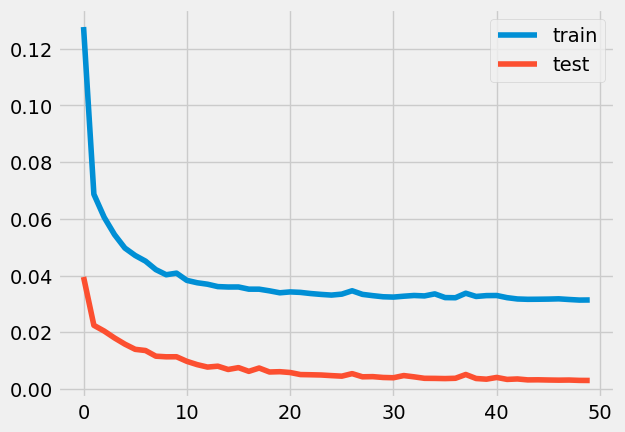

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 308ms/step - loss: 0.1431 - accuracy: 1.0656e-04 - val_loss: 0.0451 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 153ms/step - loss: 0.0710 - accuracy: 0.0044 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

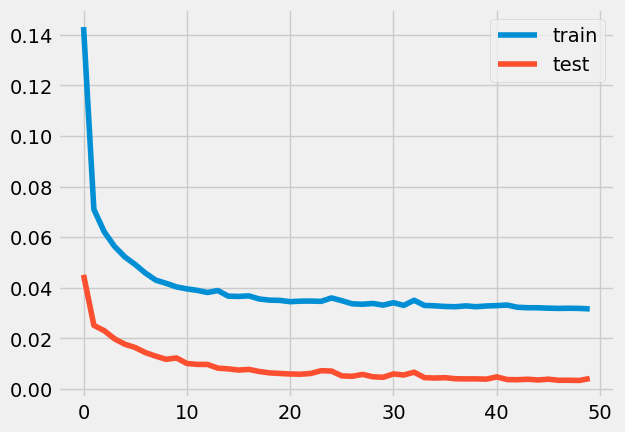

0.15249114774620515
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 266ms/step - loss: 0.2106 - accuracy: 2.1721e-04 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 160ms/step - loss: 0.0715 - accuracy: 0.0054 - val_loss: 0.0262 - val_accuracy: 0.0000e+00

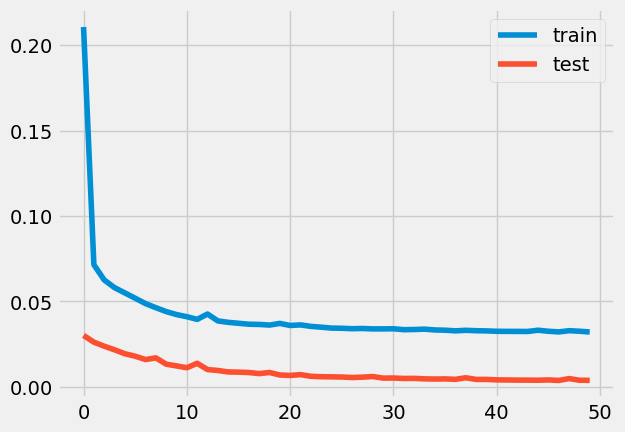

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 359ms/step - loss: 0.0895 - accuracy: 0.0038 - val_loss: 0.0277 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 180ms/step - loss: 0.0669 - accuracy: 0.0051 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

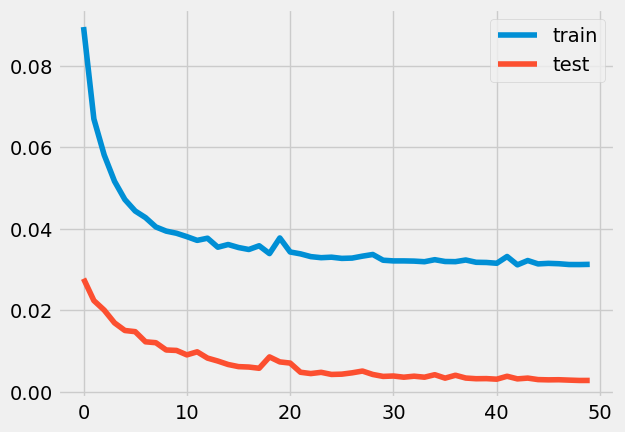

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 216ms/step - loss: 0.1277 - accuracy: 0.0018 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 136ms/step - loss: 0.0701 - accuracy: 0.0055 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

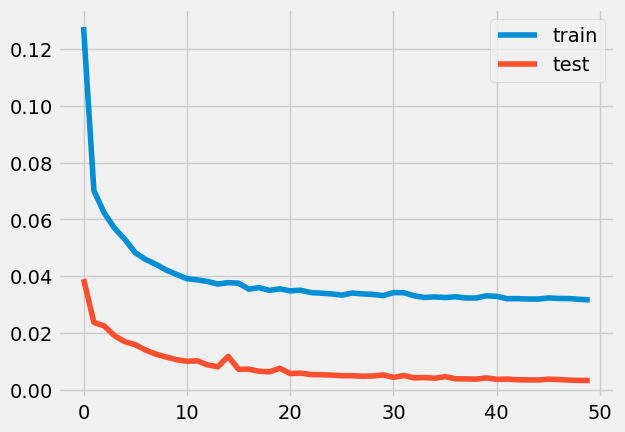

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 225ms/step - loss: 0.1330 - accuracy: 0.0012 - val_loss: 0.0413 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 125ms/step - loss: 0.0702 - accuracy: 0.0050 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

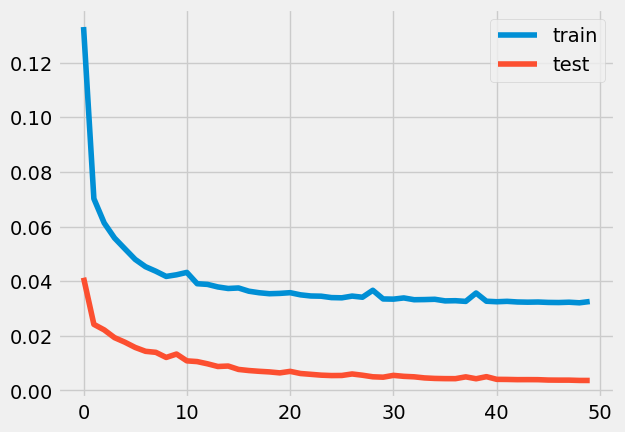

0.5718315114398127
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 215ms/step - loss: 0.1202 - accuracy: 0.0016 - val_loss: 0.0403 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 122ms/step - loss: 0.0696 - accuracy: 0.0056 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoc

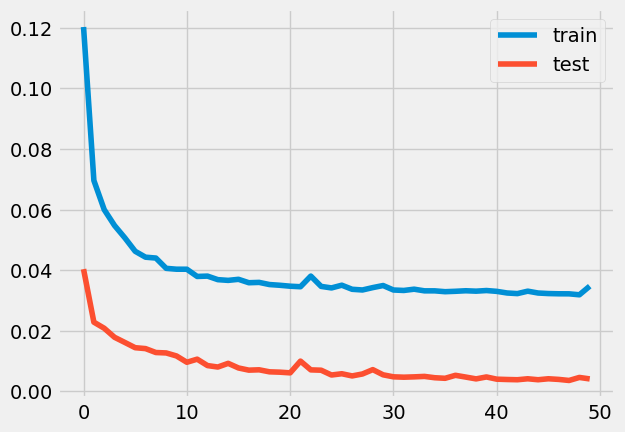

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 120ms/step - loss: 0.1207 - accuracy: 0.0048 - val_loss: 0.0461 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0684 - accuracy: 0.0057 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

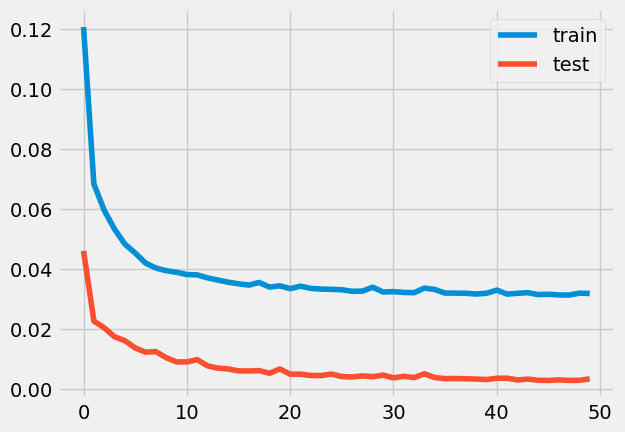

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 123ms/step - loss: 0.1756 - accuracy: 0.0017 - val_loss: 0.0554 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0740 - accuracy: 0.0054 - val_loss: 0.0251 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

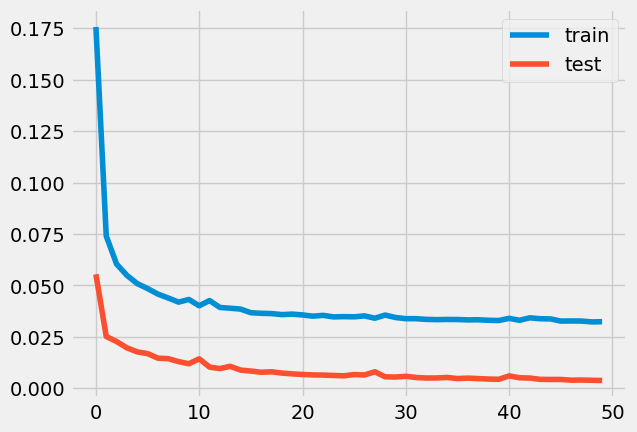

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.1528 - accuracy: 1.4344e-04 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0723 - accuracy: 0.0059 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

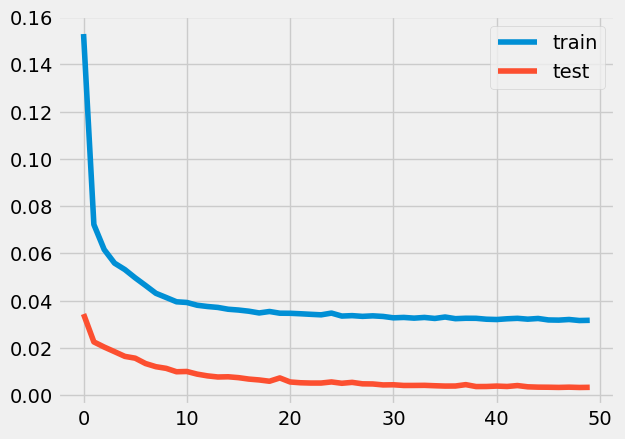

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.1153 - accuracy: 0.0017 - val_loss: 0.0384 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0687 - accuracy: 0.0056 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

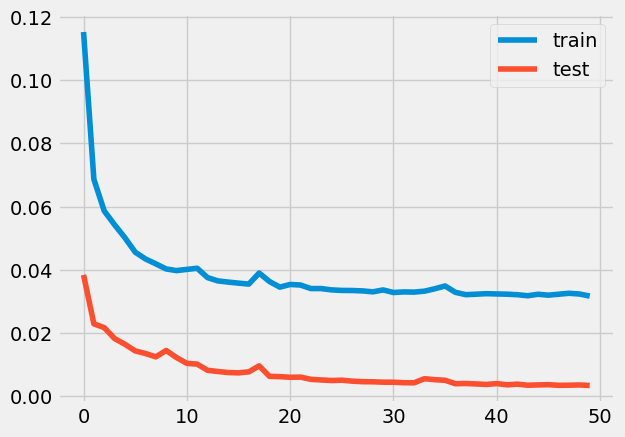

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 166ms/step - loss: 0.0886 - accuracy: 0.0038 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.0638 - accuracy: 0.0049 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

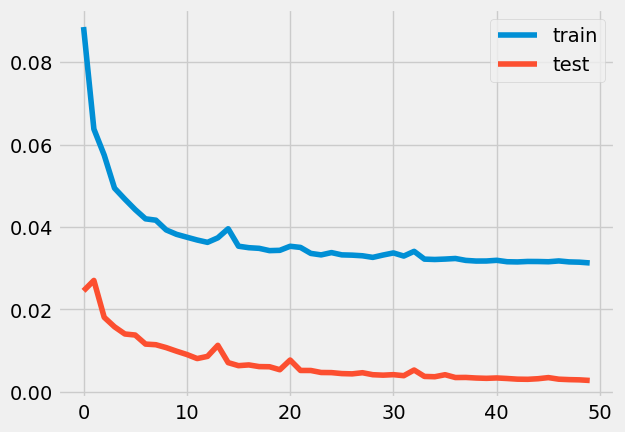

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 119ms/step - loss: 0.2026 - accuracy: 0.0017 - val_loss: 0.0300 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0733 - accuracy: 0.0050 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

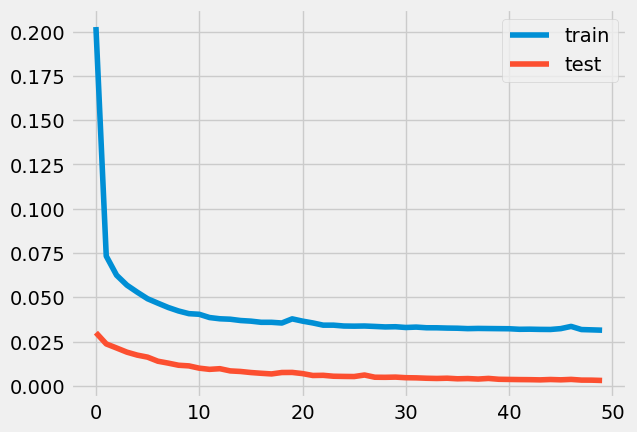

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 135ms/step - loss: 0.1489 - accuracy: 0.0025 - val_loss: 0.0463 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0722 - accuracy: 0.0056 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

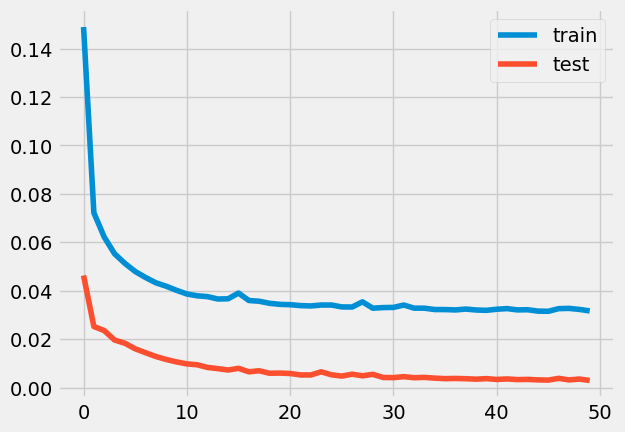

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.1677 - accuracy: 3.4221e-04 - val_loss: 0.0484 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0716 - accuracy: 0.0052 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

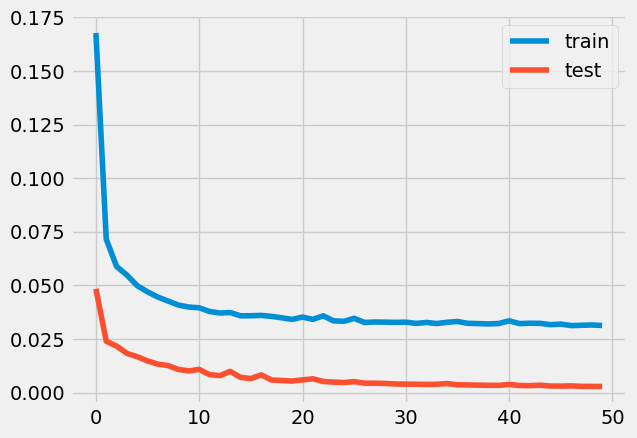

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.1333 - accuracy: 0.0033 - val_loss: 0.0471 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0715 - accuracy: 0.0048 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

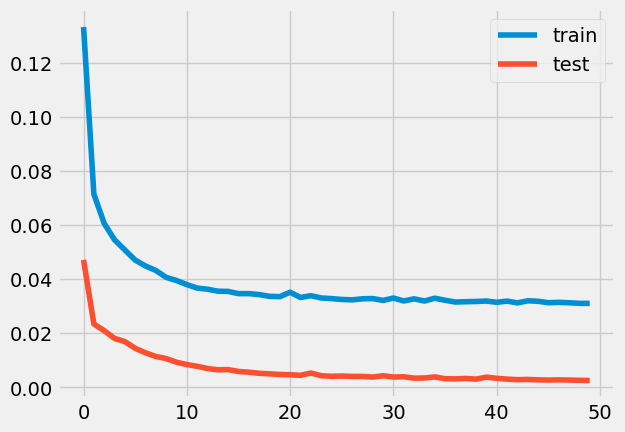

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 123ms/step - loss: 0.1375 - accuracy: 0.0043 - val_loss: 0.0477 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0684 - accuracy: 0.0056 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

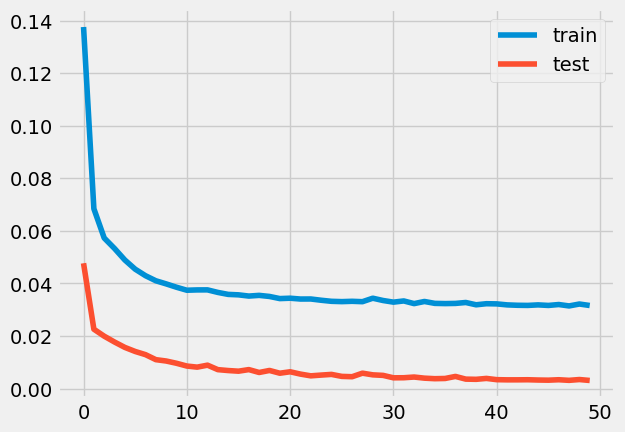

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 122ms/step - loss: 0.0911 - accuracy: 0.0054 - val_loss: 0.0258 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0673 - accuracy: 0.0045 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

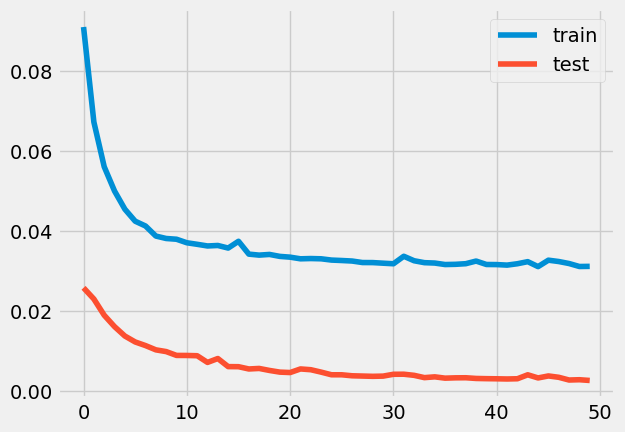

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 122ms/step - loss: 0.0900 - accuracy: 0.0042 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.0643 - accuracy: 0.0051 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

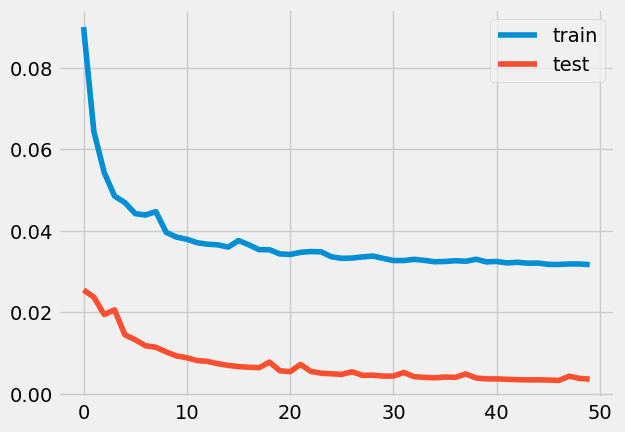

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 125ms/step - loss: 0.1124 - accuracy: 0.0000e+00 - val_loss: 0.0421 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.0689 - accuracy: 0.0046 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

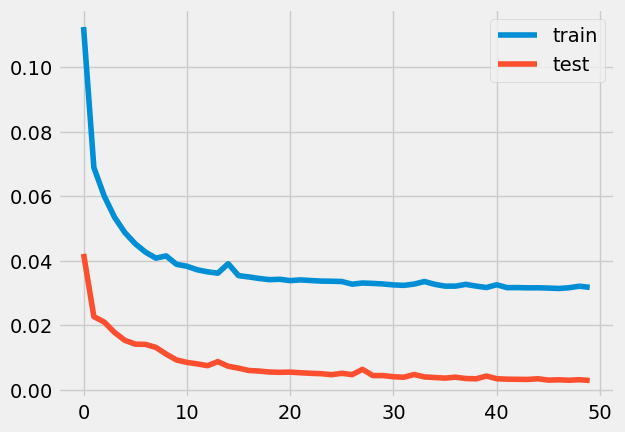

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 124ms/step - loss: 0.1161 - accuracy: 0.0043 - val_loss: 0.0358 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0665 - accuracy: 0.0065 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

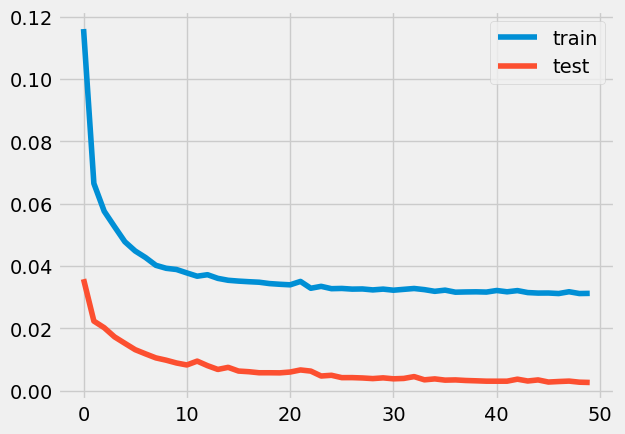

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 117ms/step - loss: 0.1357 - accuracy: 5.7992e-04 - val_loss: 0.0387 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 74ms/step - loss: 0.0654 - accuracy: 0.0052 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

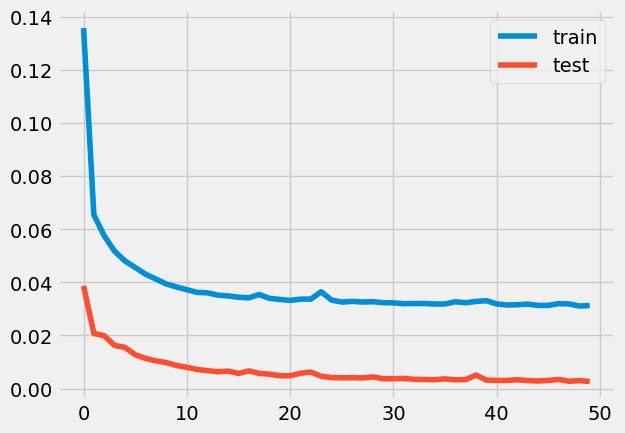

0.0003125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.2360 - accuracy: 0.0000e+00 - val_loss: 0.0407 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0735 - accuracy: 0.0071 - val_loss: 0.0258 - val_accuracy: 0.0000e+00
Epoch 3/50


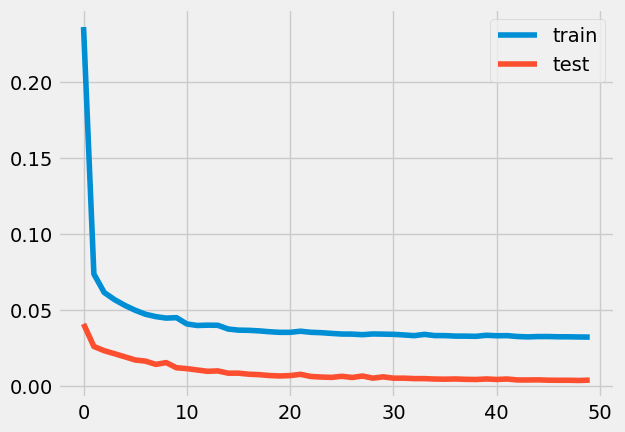

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.0900 - accuracy: 0.0058 - val_loss: 0.0261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0654 - accuracy: 0.0053 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

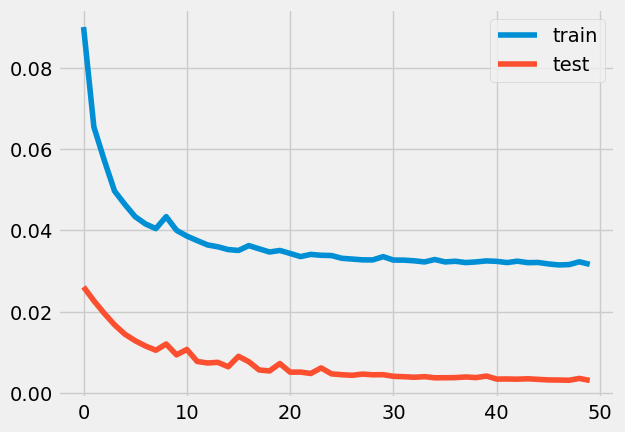

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 121ms/step - loss: 0.1124 - accuracy: 0.0043 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0673 - accuracy: 0.0047 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

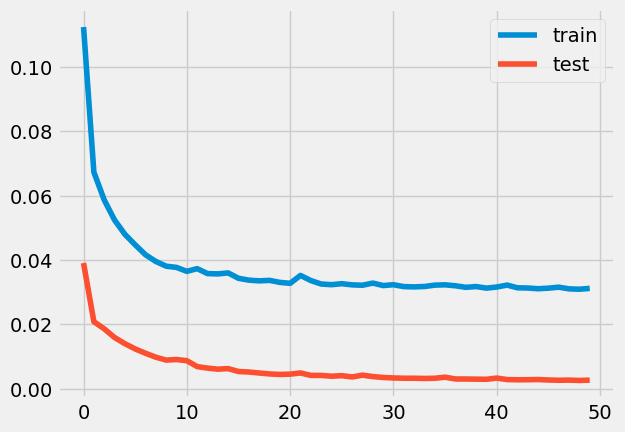

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 124ms/step - loss: 0.1339 - accuracy: 2.0492e-05 - val_loss: 0.0418 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0695 - accuracy: 0.0063 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

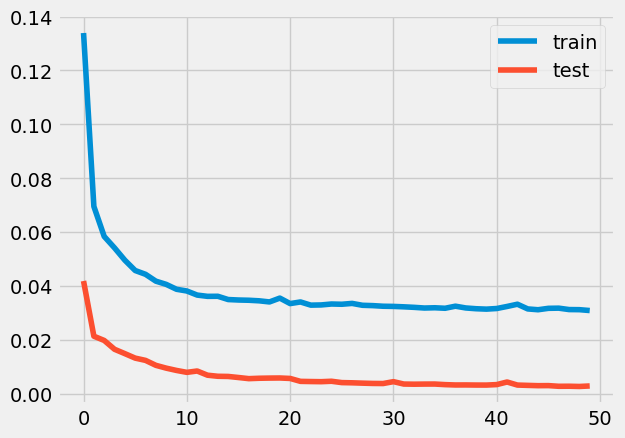

0.623889079062505
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 121ms/step - loss: 0.1167 - accuracy: 0.0029 - val_loss: 0.0356 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 82ms/step - loss: 0.0653 - accuracy: 0.0054 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3

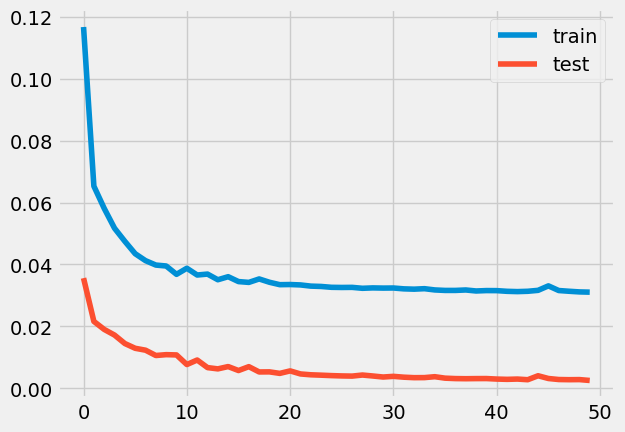

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 120ms/step - loss: 0.2283 - accuracy: 6.8852e-04 - val_loss: 0.0266 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.0680 - accuracy: 0.0059 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

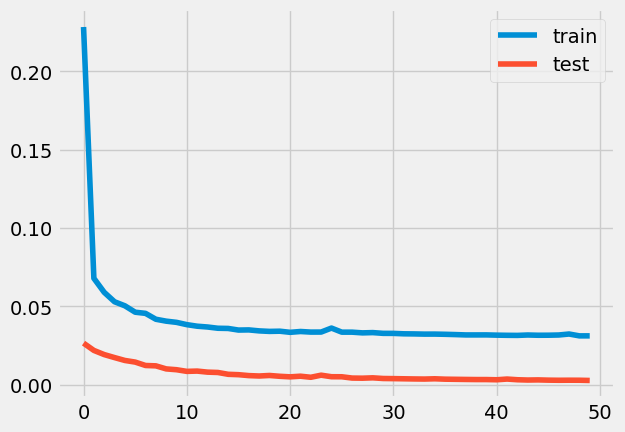

0.4453221976586386
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 136ms/step - loss: 0.2053 - accuracy: 0.0000e+00 - val_loss: 0.0363 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.0692 - accuracy: 0.0060 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Ep

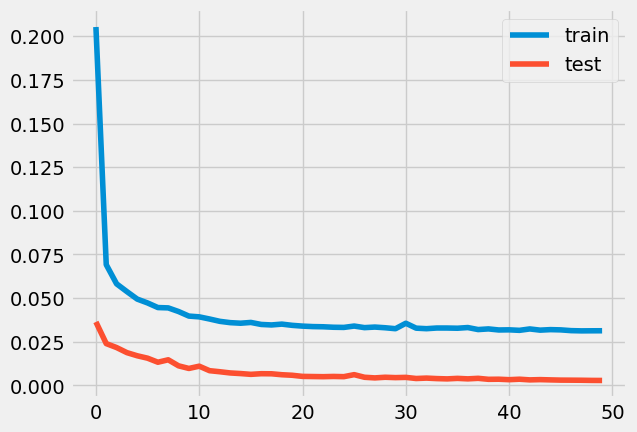

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.1412 - accuracy: 0.0061 - val_loss: 0.0473 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0693 - accuracy: 0.0048 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

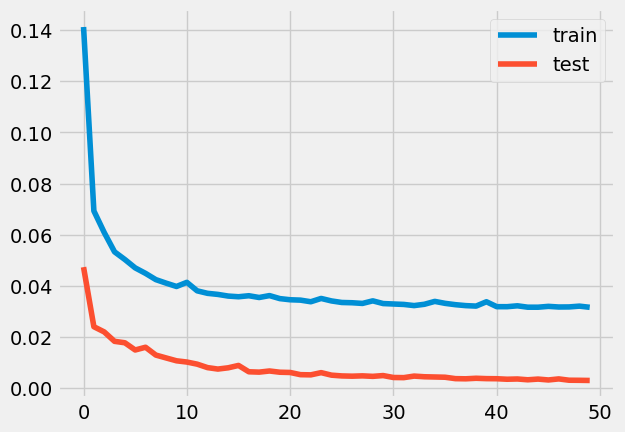

0.6299317062767158
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 127ms/step - loss: 0.1466 - accuracy: 0.0041 - val_loss: 0.0442 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0653 - accuracy: 0.0062 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 

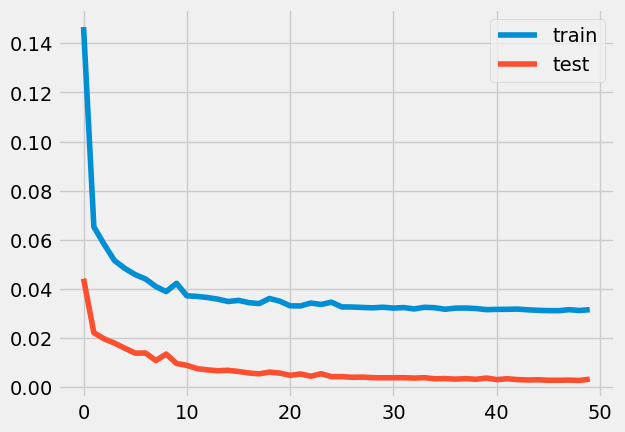

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 127ms/step - loss: 0.1289 - accuracy: 0.0040 - val_loss: 0.0414 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0686 - accuracy: 0.0049 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

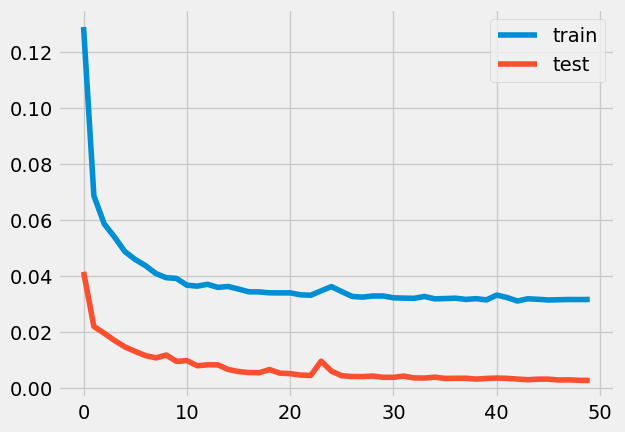

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 130ms/step - loss: 0.1141 - accuracy: 0.0035 - val_loss: 0.0330 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 97ms/step - loss: 0.0647 - accuracy: 0.0056 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

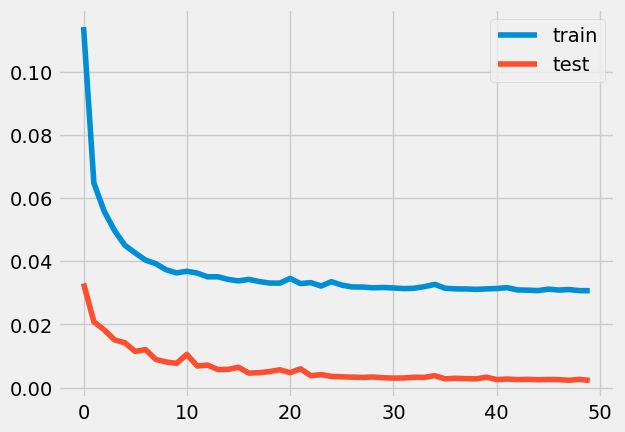

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 156ms/step - loss: 0.1575 - accuracy: 0.0024 - val_loss: 0.0488 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0654 - accuracy: 0.0057 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

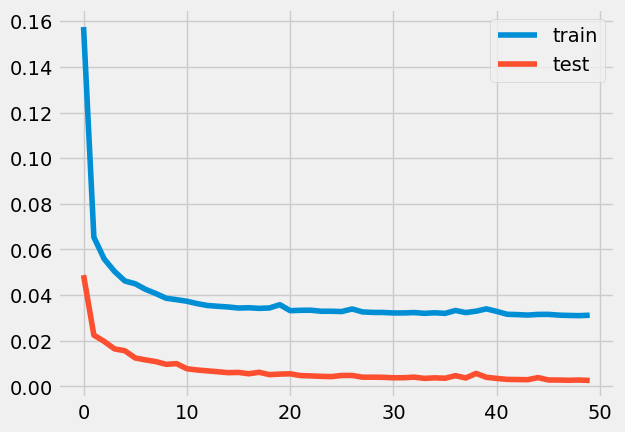

0.3081564175017931
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 129ms/step - loss: 0.1274 - accuracy: 0.0040 - val_loss: 0.0323 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0686 - accuracy: 0.0047 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 

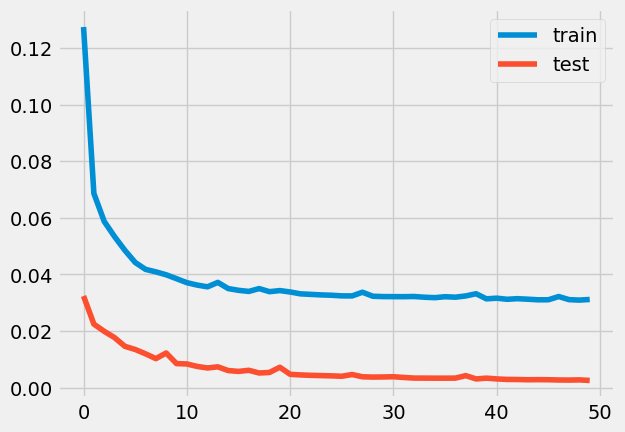

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 128ms/step - loss: 0.1752 - accuracy: 0.0024 - val_loss: 0.0501 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0692 - accuracy: 0.0040 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

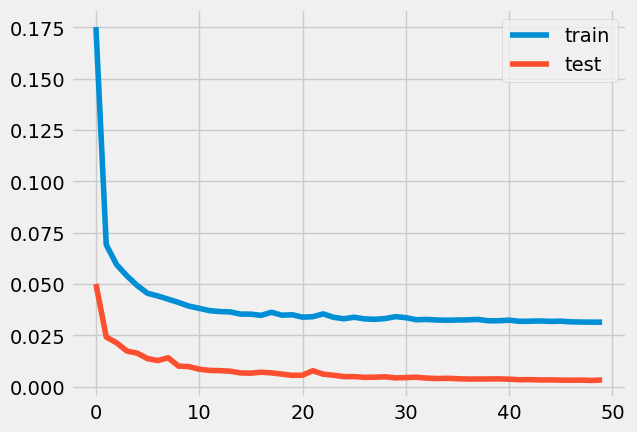

0.07181982537911047
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 131ms/step - loss: 0.1255 - accuracy: 0.0042 - val_loss: 0.0370 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.0675 - accuracy: 0.0054 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch

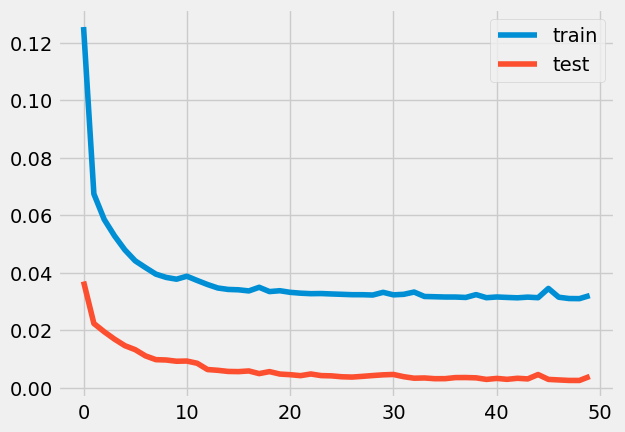

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 125ms/step - loss: 0.1816 - accuracy: 0.0014 - val_loss: 0.0466 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0682 - accuracy: 0.0049 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

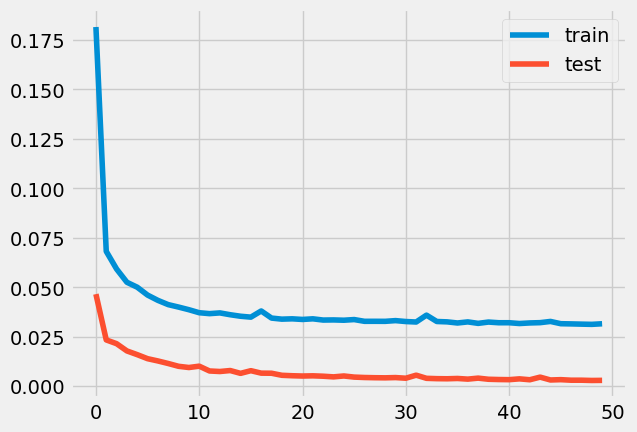

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 130ms/step - loss: 0.1591 - accuracy: 0.0020 - val_loss: 0.0489 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0677 - accuracy: 0.0053 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

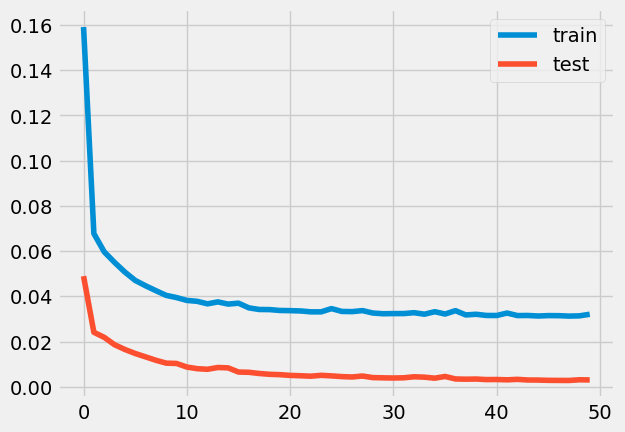

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 121ms/step - loss: 0.1773 - accuracy: 0.0000e+00 - val_loss: 0.0516 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0714 - accuracy: 0.0050 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

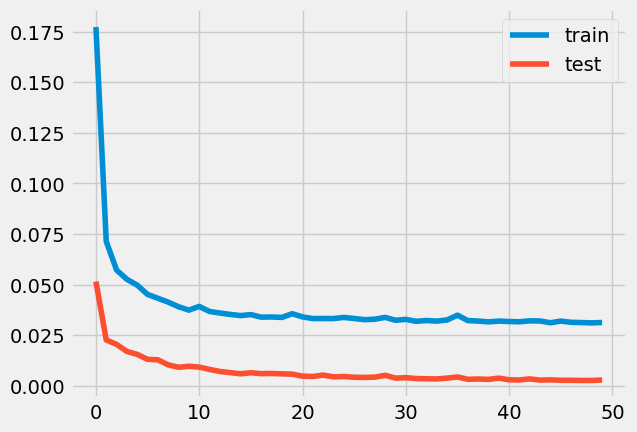

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 131ms/step - loss: 0.1260 - accuracy: 0.0019 - val_loss: 0.0414 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0717 - accuracy: 0.0042 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

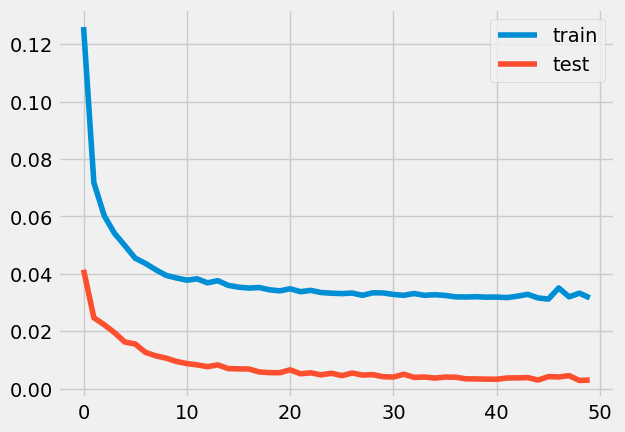

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 128ms/step - loss: 0.0962 - accuracy: 0.0060 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0624 - accuracy: 0.0053 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

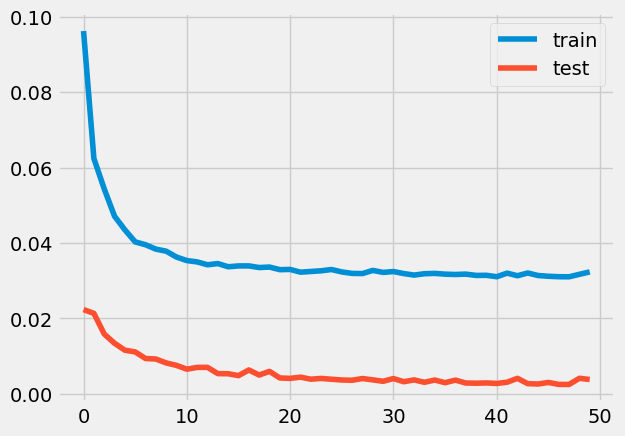

0.0886280128151803
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 130ms/step - loss: 0.1028 - accuracy: 0.0068 - val_loss: 0.0278 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 94ms/step - loss: 0.0678 - accuracy: 0.0040 - val_loss: 0.0265 - val_accuracy: 0.0000e+00
Epoch 

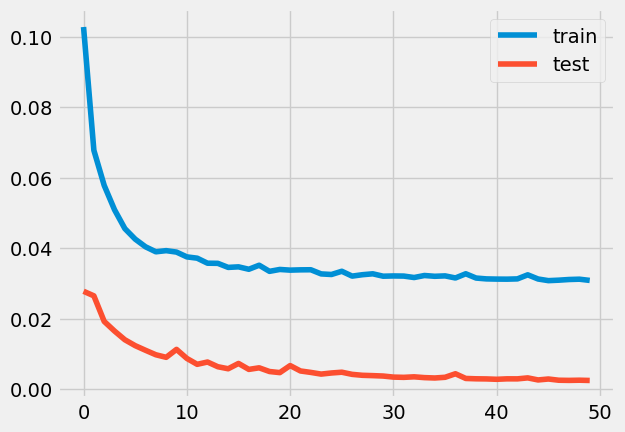

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 130ms/step - loss: 0.0989 - accuracy: 0.0035 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0634 - accuracy: 0.0060 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

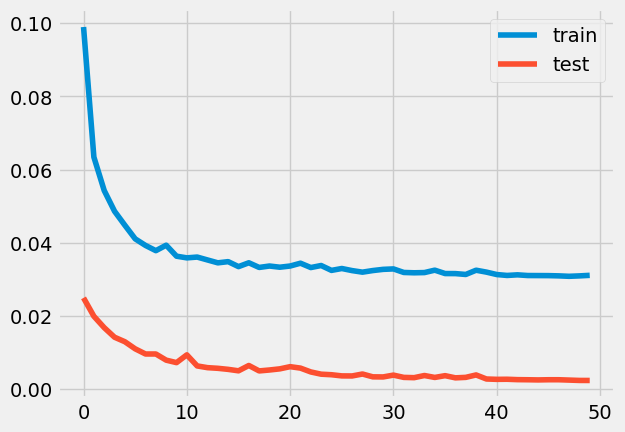

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 128ms/step - loss: 0.1407 - accuracy: 0.0051 - val_loss: 0.0399 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0663 - accuracy: 0.0054 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

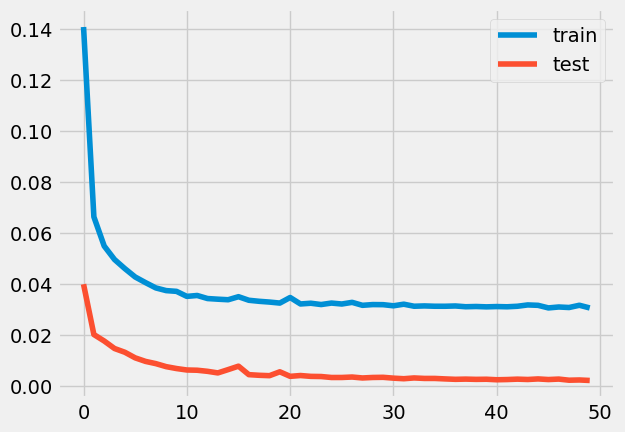

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 127ms/step - loss: 0.1474 - accuracy: 9.2213e-05 - val_loss: 0.0407 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0646 - accuracy: 0.0060 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

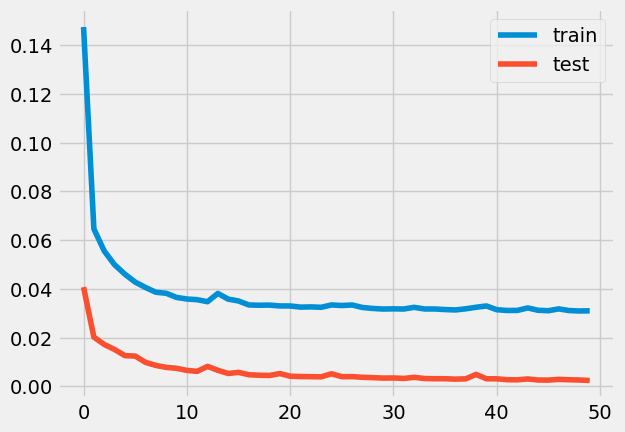

0.5176159084538396
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 136ms/step - loss: 0.1538 - accuracy: 0.0068 - val_loss: 0.0561 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 92ms/step - loss: 0.0688 - accuracy: 0.0052 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 

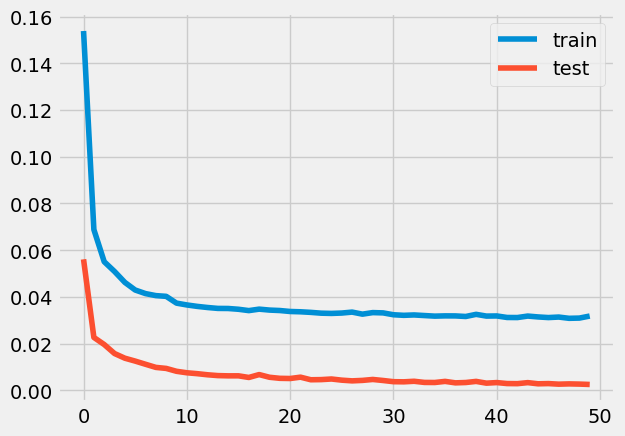

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 193ms/step - loss: 0.1349 - accuracy: 0.0049 - val_loss: 0.0387 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 105ms/step - loss: 0.0647 - accuracy: 0.0062 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

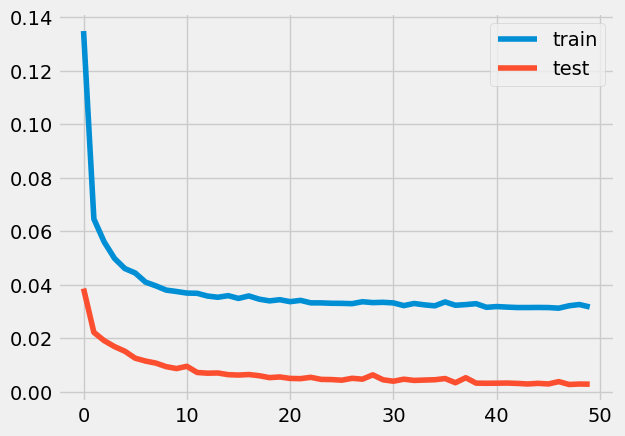

0.2729319902015693
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 124ms/step - loss: 0.1727 - accuracy: 0.0041 - val_loss: 0.0528 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0681 - accuracy: 0.0045 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 

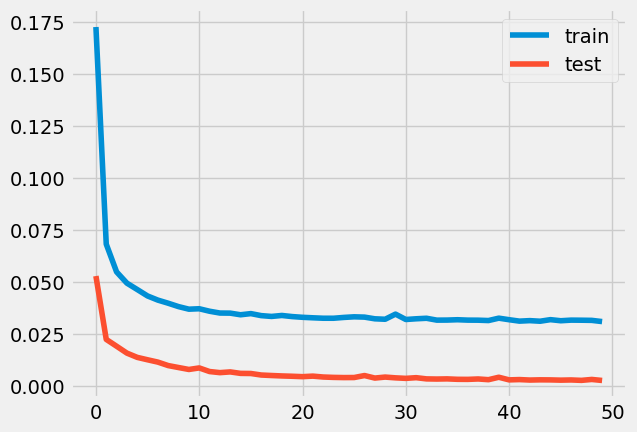

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 129ms/step - loss: 0.1078 - accuracy: 0.0071 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.0628 - accuracy: 0.0043 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

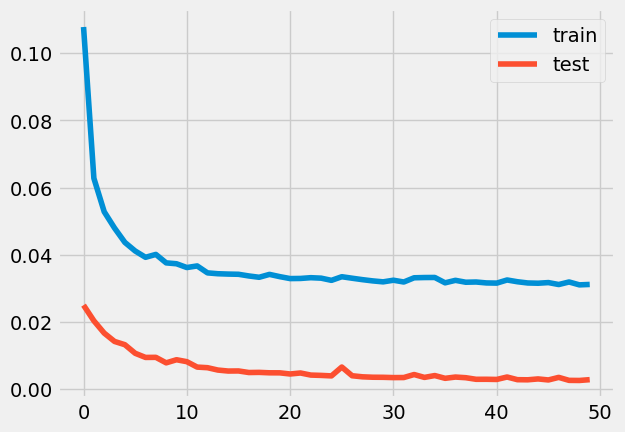

0.33800435414595953
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 154ms/step - loss: 0.1577 - accuracy: 0.0018 - val_loss: 0.0546 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 109ms/step - loss: 0.0700 - accuracy: 0.0055 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoc

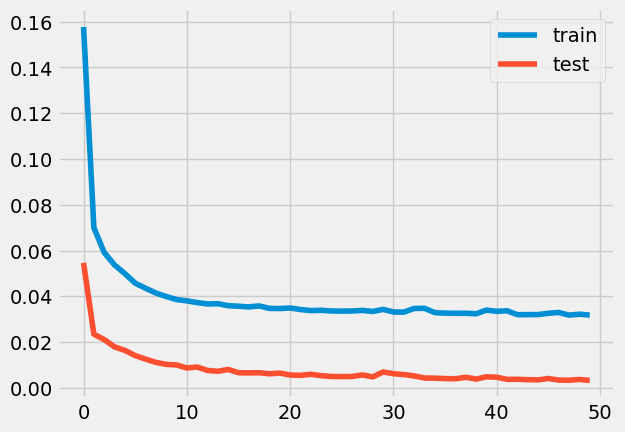

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 136ms/step - loss: 0.1380 - accuracy: 0.0000e+00 - val_loss: 0.0423 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 87ms/step - loss: 0.0676 - accuracy: 0.0044 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

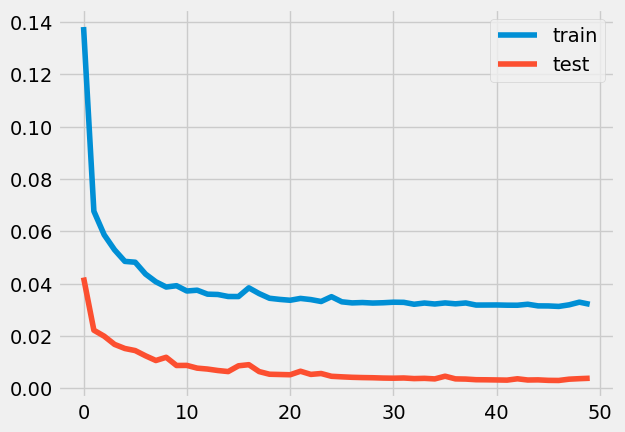

0.1508611427565007
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 127ms/step - loss: 0.1546 - accuracy: 0.0021 - val_loss: 0.0465 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 95ms/step - loss: 0.0655 - accuracy: 0.0066 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 

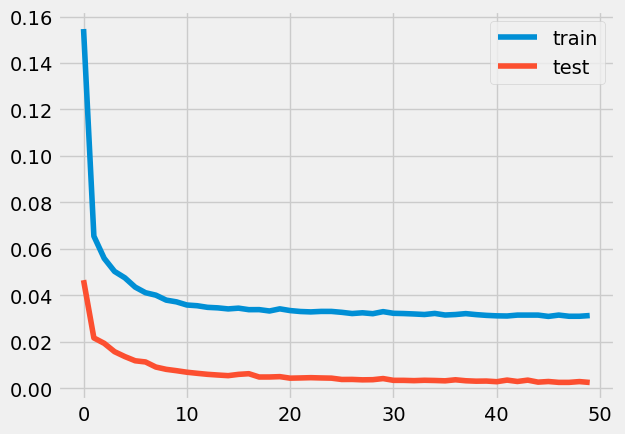

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 127ms/step - loss: 0.1242 - accuracy: 0.0042 - val_loss: 0.0310 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.0655 - accuracy: 0.0056 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

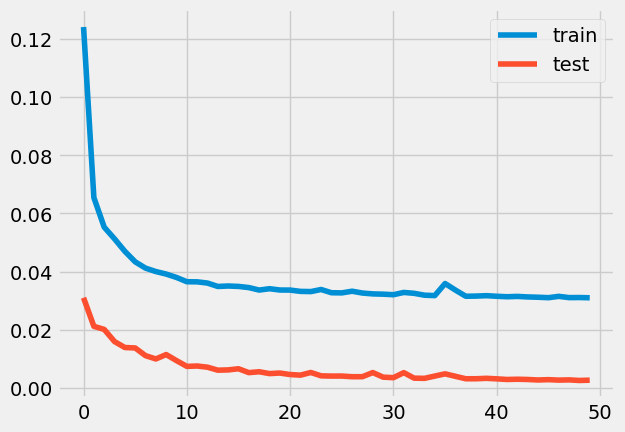

0.6559851154823058
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 197ms/step - loss: 0.1220 - accuracy: 0.0042 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 144ms/step - loss: 0.0655 - accuracy: 0.0050 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch

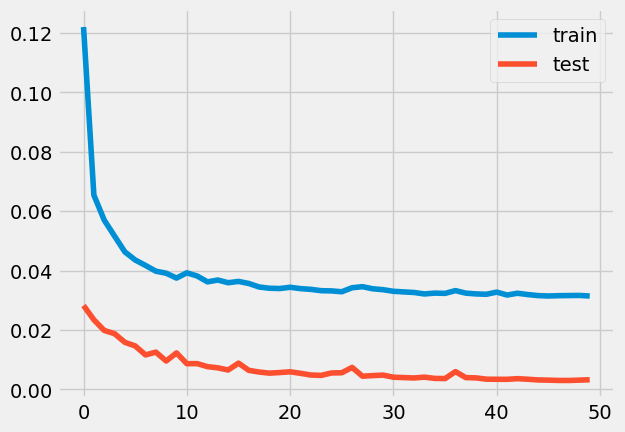

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 188ms/step - loss: 0.1238 - accuracy: 0.0000e+00 - val_loss: 0.0349 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 135ms/step - loss: 0.0649 - accuracy: 0.0049 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

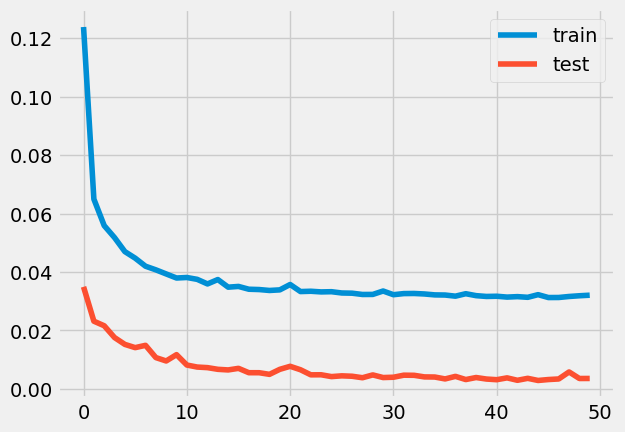

0.4027976267194485
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 189ms/step - loss: 0.1244 - accuracy: 0.0017 - val_loss: 0.0328 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 129ms/step - loss: 0.0654 - accuracy: 0.0043 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch

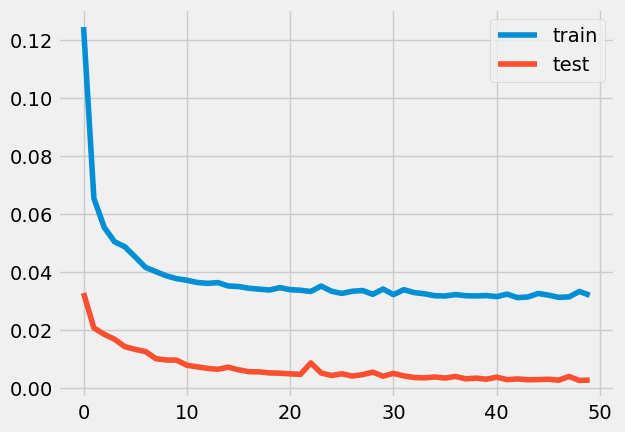

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 182ms/step - loss: 0.1200 - accuracy: 0.0020 - val_loss: 0.0377 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.0651 - accuracy: 0.0042 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

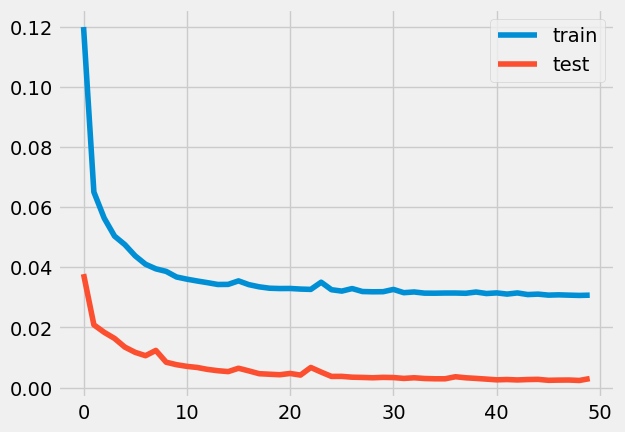

0.6228923432355332
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 159ms/step - loss: 0.0971 - accuracy: 0.0039 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 100ms/step - loss: 0.0630 - accuracy: 0.0059 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch

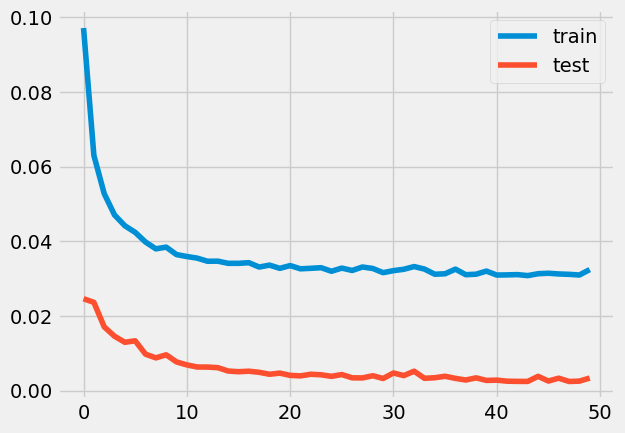

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 166ms/step - loss: 0.2109 - accuracy: 0.0000e+00 - val_loss: 0.0514 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 110ms/step - loss: 0.0760 - accuracy: 0.0052 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

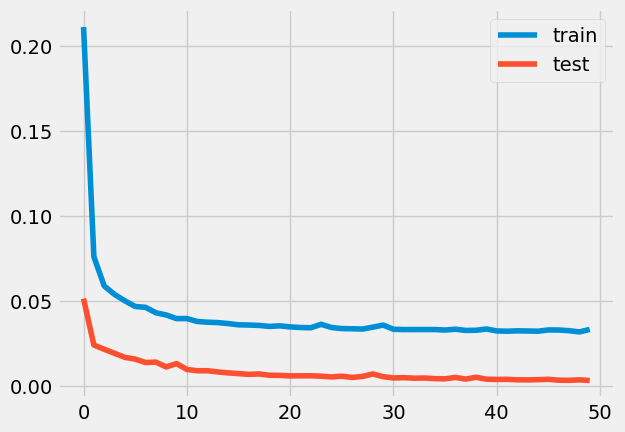

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 195ms/step - loss: 0.1182 - accuracy: 0.0039 - val_loss: 0.0346 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 111ms/step - loss: 0.0664 - accuracy: 0.0050 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

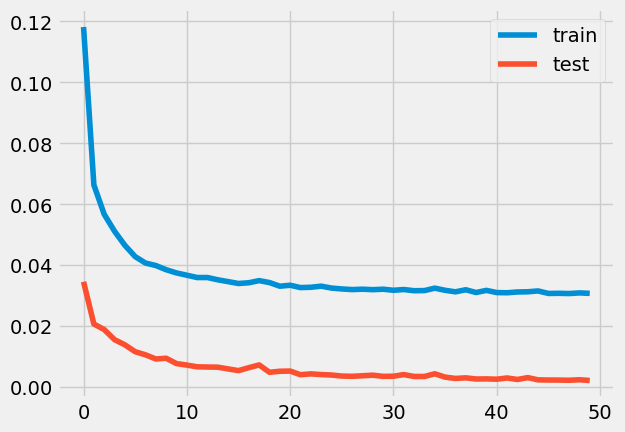

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 205ms/step - loss: 0.1195 - accuracy: 0.0055 - val_loss: 0.0324 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 139ms/step - loss: 0.0691 - accuracy: 0.0039 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

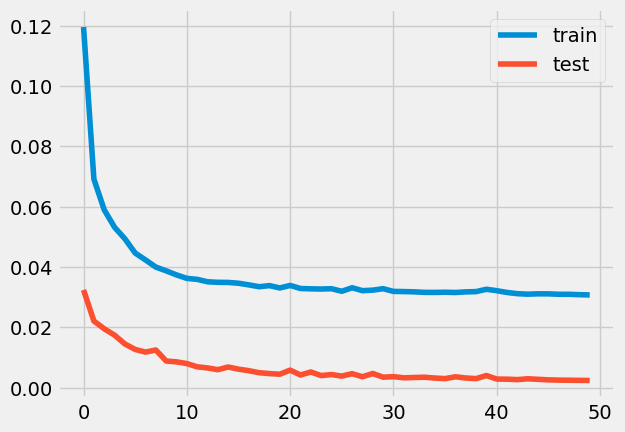

0.6849660998234136
0.00015625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 208ms/step - loss: 0.1151 - accuracy: 0.0012 - val_loss: 0.0317 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 135ms/step - loss: 0.0658 - accuracy: 0.0054 - val_loss: 0.0218 - val_accuracy: 0.000

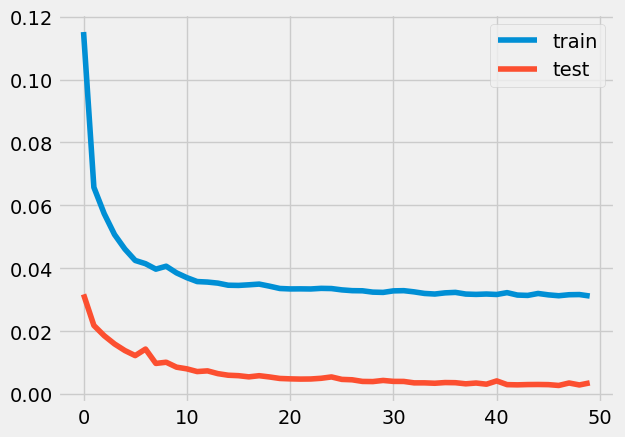

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 181ms/step - loss: 0.0945 - accuracy: 0.0035 - val_loss: 0.0258 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 138ms/step - loss: 0.0645 - accuracy: 0.0055 - val_loss: 0.0251 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

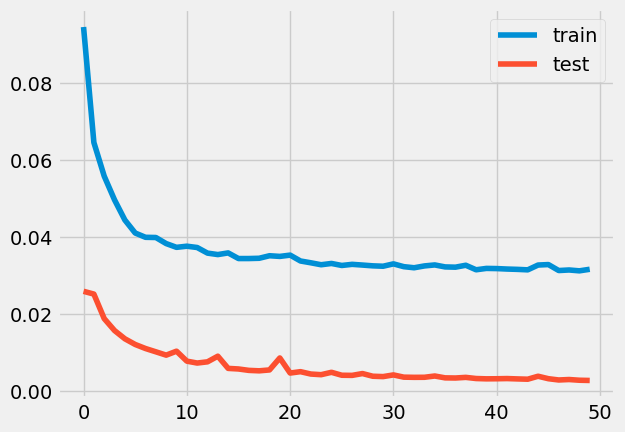

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 206ms/step - loss: 0.1002 - accuracy: 0.0033 - val_loss: 0.0257 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 123ms/step - loss: 0.0640 - accuracy: 0.0063 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

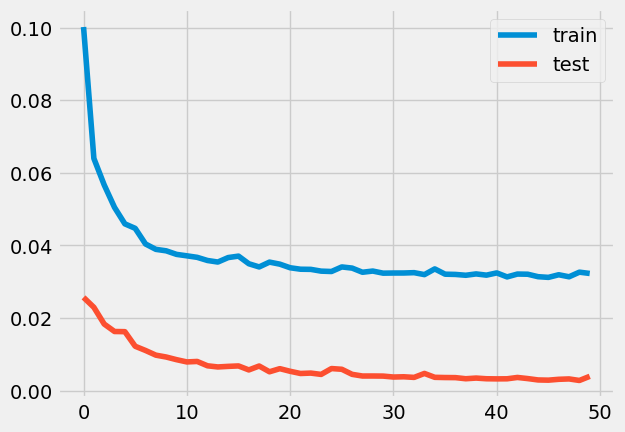

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 175ms/step - loss: 0.0915 - accuracy: 0.0062 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 116ms/step - loss: 0.0629 - accuracy: 0.0057 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

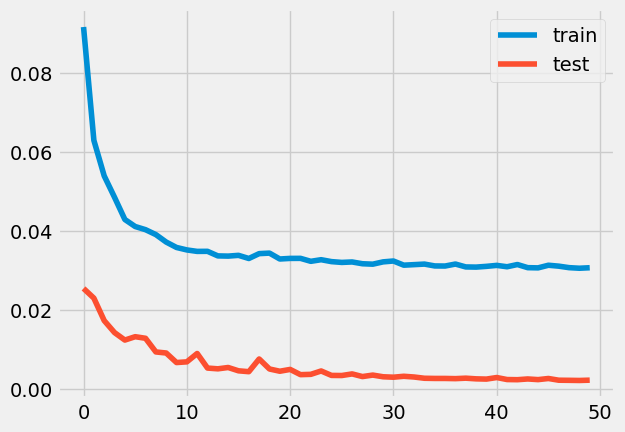

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 159ms/step - loss: 0.1686 - accuracy: 0.0047 - val_loss: 0.0447 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.0646 - accuracy: 0.0054 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

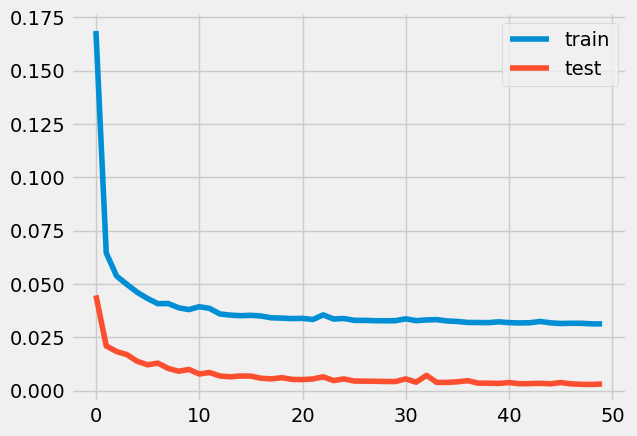

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 197ms/step - loss: 0.1067 - accuracy: 0.0052 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 121ms/step - loss: 0.0650 - accuracy: 0.0047 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

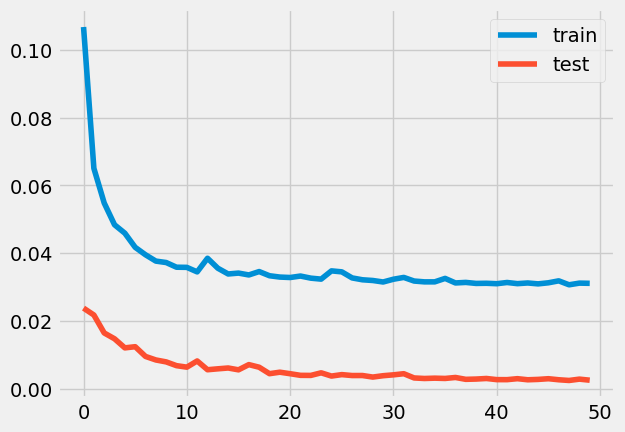

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 185ms/step - loss: 0.1958 - accuracy: 2.2746e-04 - val_loss: 0.0528 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 114ms/step - loss: 0.0687 - accuracy: 0.0047 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

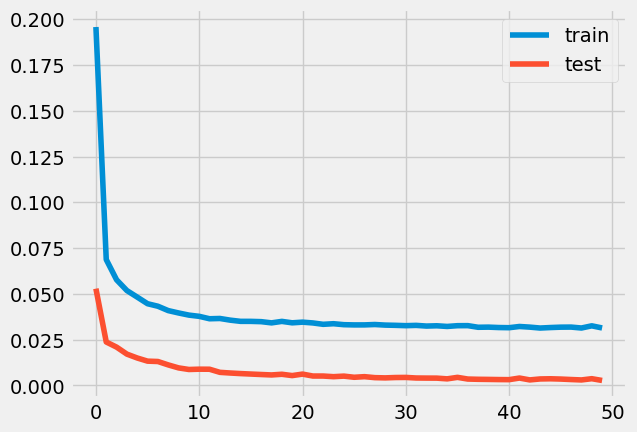

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 188ms/step - loss: 0.1644 - accuracy: 0.0042 - val_loss: 0.0598 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.0674 - accuracy: 0.0057 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

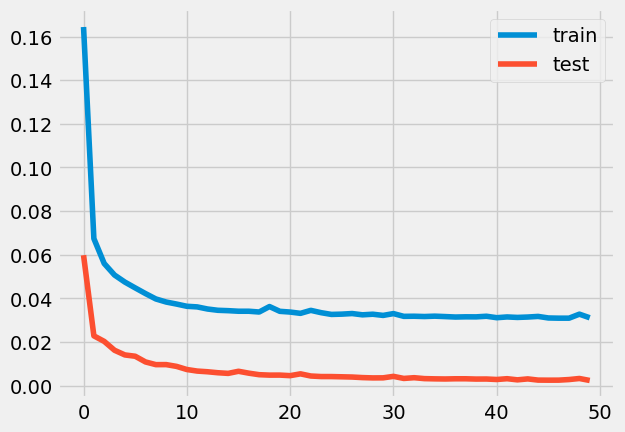

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 224ms/step - loss: 0.0996 - accuracy: 0.0041 - val_loss: 0.0261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 143ms/step - loss: 0.0633 - accuracy: 0.0048 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

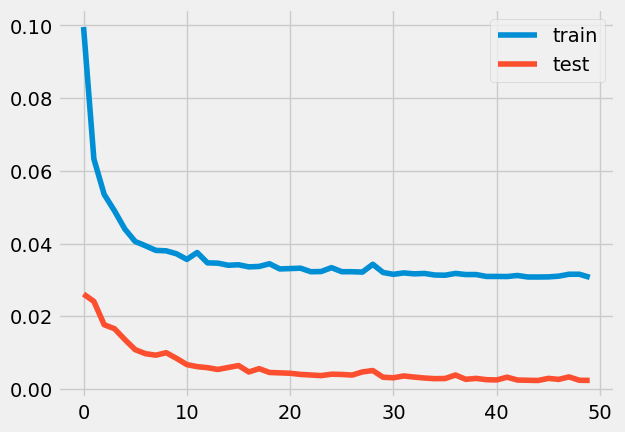

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 254ms/step - loss: 0.1690 - accuracy: 0.0043 - val_loss: 0.0478 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 123ms/step - loss: 0.0688 - accuracy: 0.0043 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

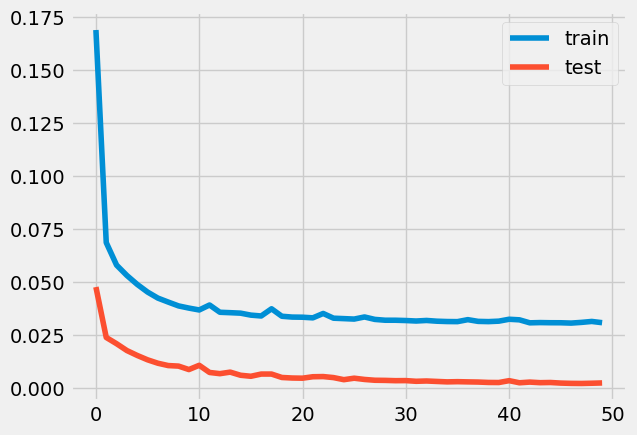

0.2082524242677857
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 234ms/step - loss: 0.1126 - accuracy: 0.0041 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 129ms/step - loss: 0.0610 - accuracy: 0.0046 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoc

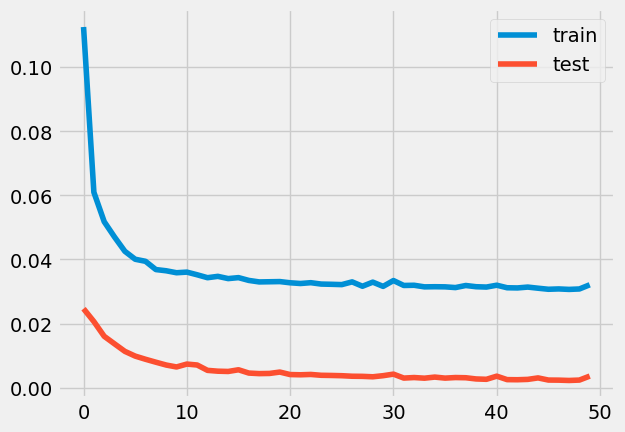

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 177ms/step - loss: 0.1580 - accuracy: 0.0017 - val_loss: 0.0338 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 120ms/step - loss: 0.0631 - accuracy: 0.0044 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

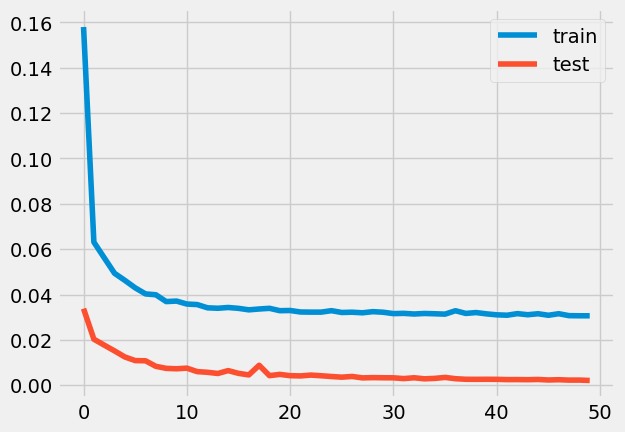

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 168ms/step - loss: 0.1100 - accuracy: 0.0035 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 103ms/step - loss: 0.0618 - accuracy: 0.0054 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

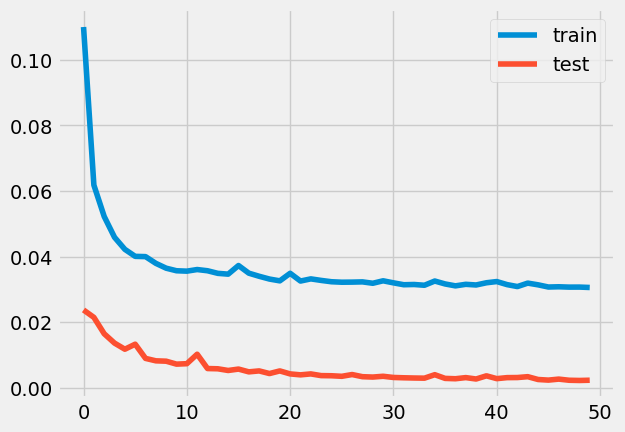

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 168ms/step - loss: 0.1513 - accuracy: 0.0060 - val_loss: 0.0374 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 119ms/step - loss: 0.0642 - accuracy: 0.0040 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

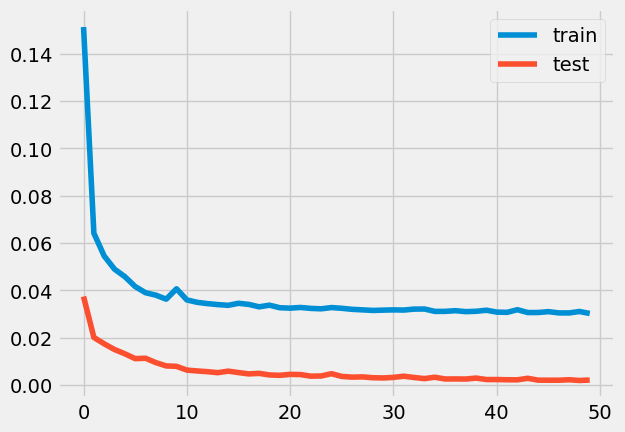

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 185ms/step - loss: 0.1775 - accuracy: 0.0019 - val_loss: 0.0321 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 114ms/step - loss: 0.0636 - accuracy: 0.0042 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

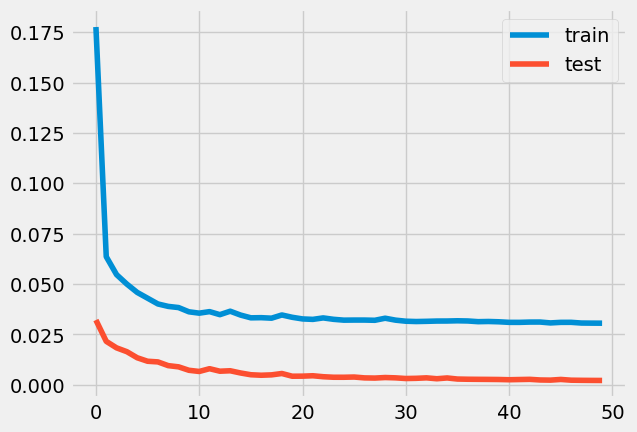

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 150ms/step - loss: 0.1094 - accuracy: 0.0041 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.0585 - accuracy: 0.0061 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

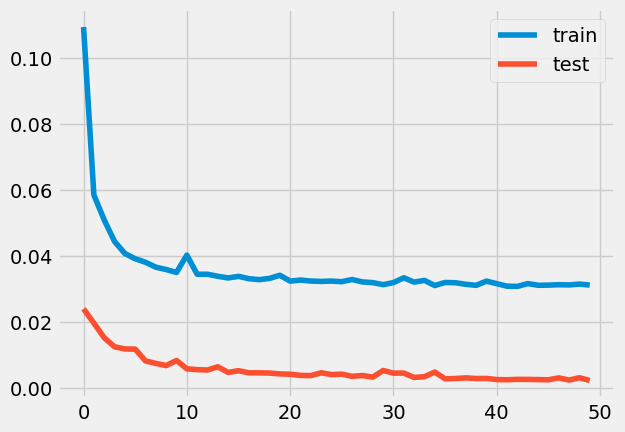

0.435391942434621
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 141ms/step - loss: 0.1143 - accuracy: 0.0020 - val_loss: 0.0295 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 91ms/step - loss: 0.0661 - accuracy: 0.0051 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 3

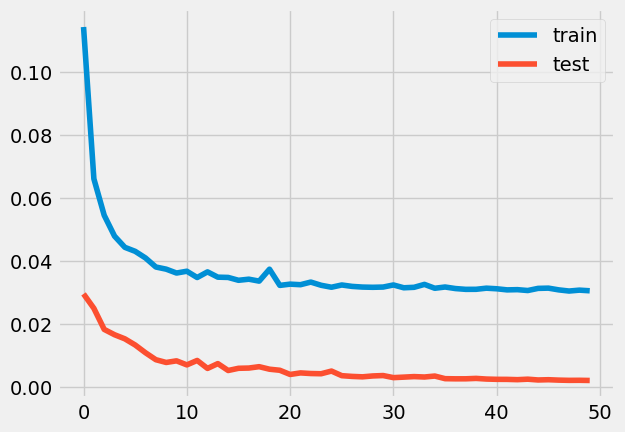

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 147ms/step - loss: 0.1235 - accuracy: 0.0028 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 101ms/step - loss: 0.0621 - accuracy: 0.0054 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

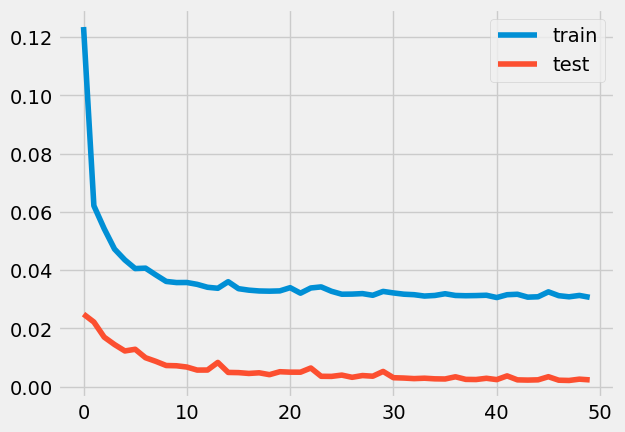

0.17938568353305423
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 153ms/step - loss: 0.1251 - accuracy: 0.0032 - val_loss: 0.0277 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.0600 - accuracy: 0.0057 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch

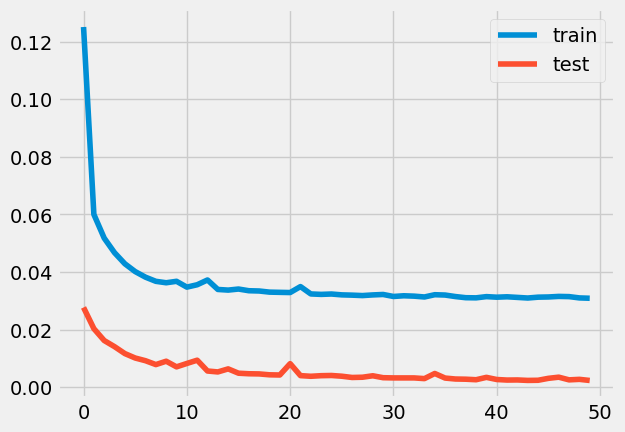

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 167ms/step - loss: 0.1591 - accuracy: 0.0036 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.0621 - accuracy: 0.0048 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

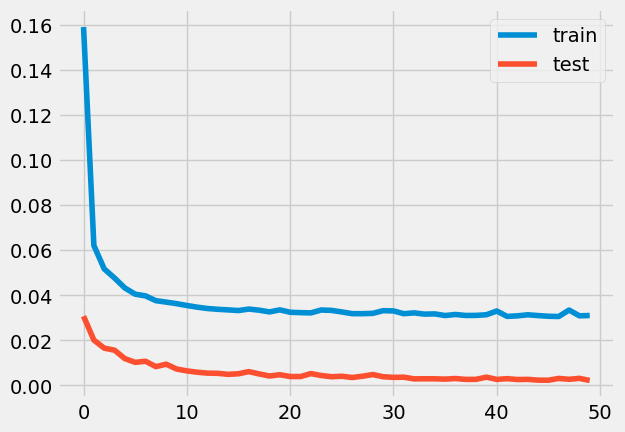

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 159ms/step - loss: 0.1343 - accuracy: 0.0024 - val_loss: 0.0265 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.0604 - accuracy: 0.0056 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

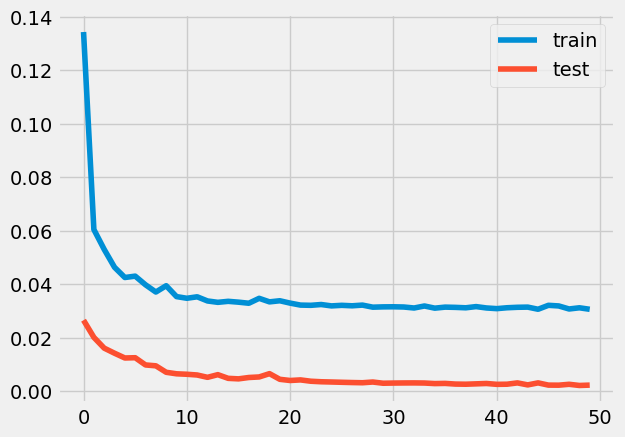

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 162ms/step - loss: 0.1177 - accuracy: 0.0061 - val_loss: 0.0251 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 120ms/step - loss: 0.0622 - accuracy: 0.0047 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

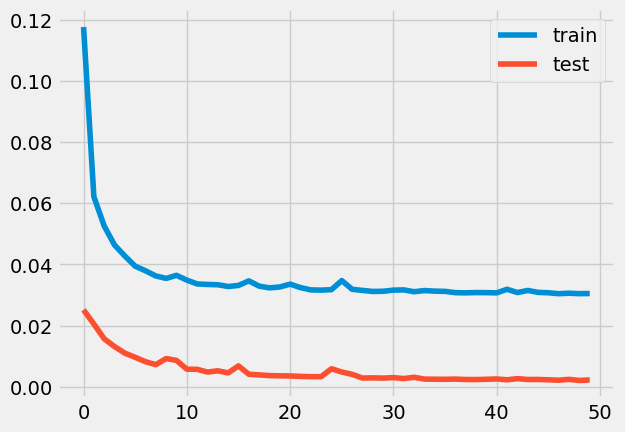

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 150ms/step - loss: 0.1379 - accuracy: 0.0017 - val_loss: 0.0279 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 102ms/step - loss: 0.0624 - accuracy: 0.0040 - val_loss: 0.0193 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

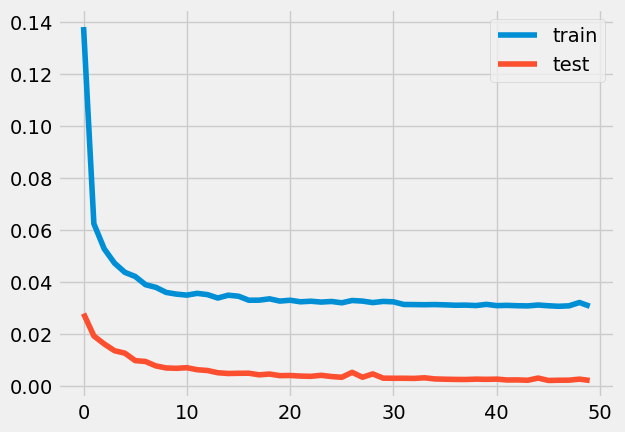

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 176ms/step - loss: 0.1272 - accuracy: 0.0055 - val_loss: 0.0251 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.0640 - accuracy: 0.0045 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

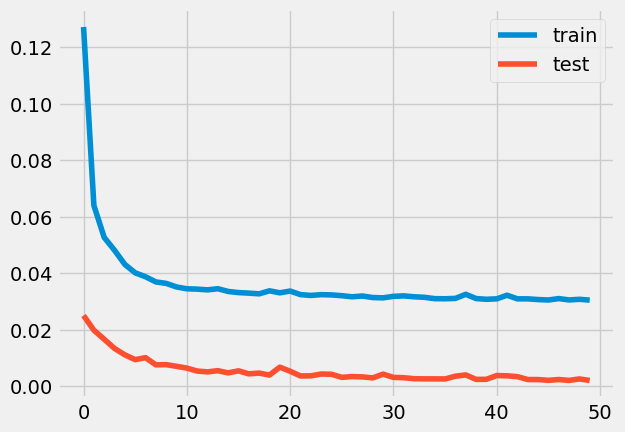

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 149ms/step - loss: 0.1248 - accuracy: 0.0015 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.0636 - accuracy: 0.0050 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

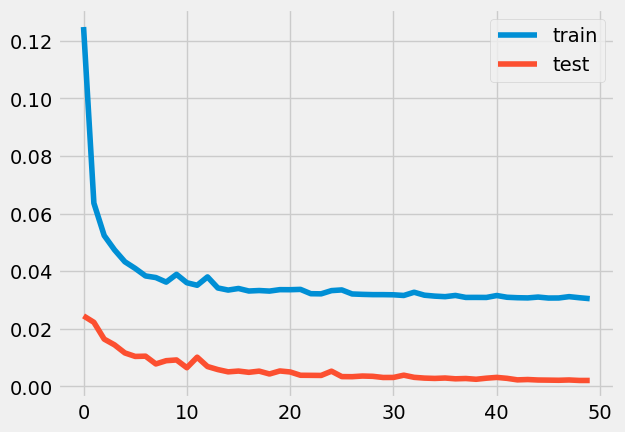

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 163ms/step - loss: 0.1235 - accuracy: 0.0040 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 90ms/step - loss: 0.0617 - accuracy: 0.0046 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

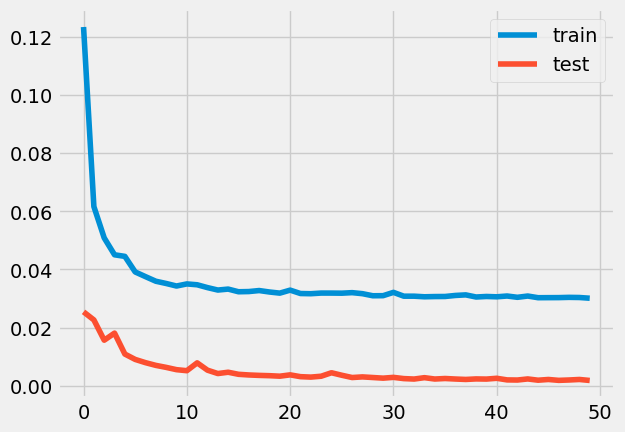

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 195ms/step - loss: 0.1542 - accuracy: 0.0020 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 121ms/step - loss: 0.0630 - accuracy: 0.0035 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

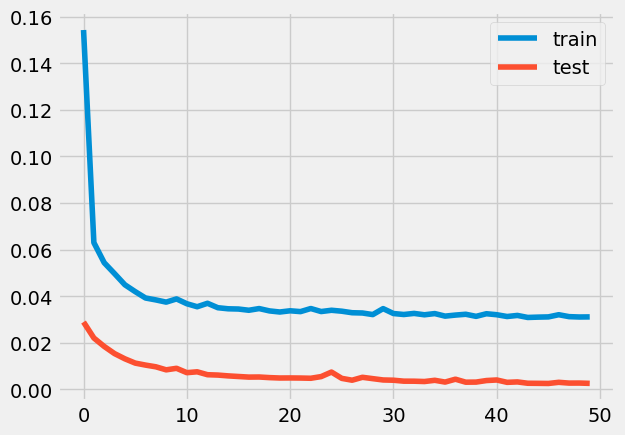

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 163ms/step - loss: 0.1960 - accuracy: 0.0037 - val_loss: 0.0470 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.0664 - accuracy: 0.0046 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

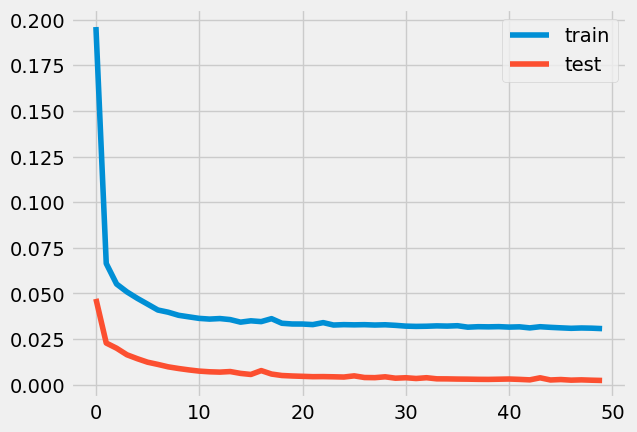

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 152ms/step - loss: 0.1454 - accuracy: 0.0054 - val_loss: 0.0268 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.0660 - accuracy: 0.0039 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

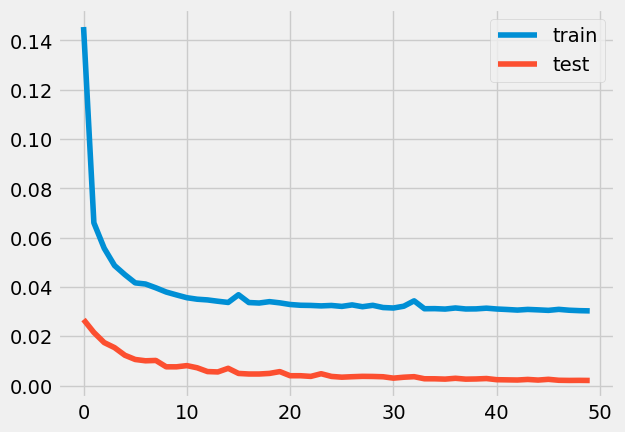

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 161ms/step - loss: 0.0929 - accuracy: 0.0050 - val_loss: 0.0269 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.0590 - accuracy: 0.0065 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

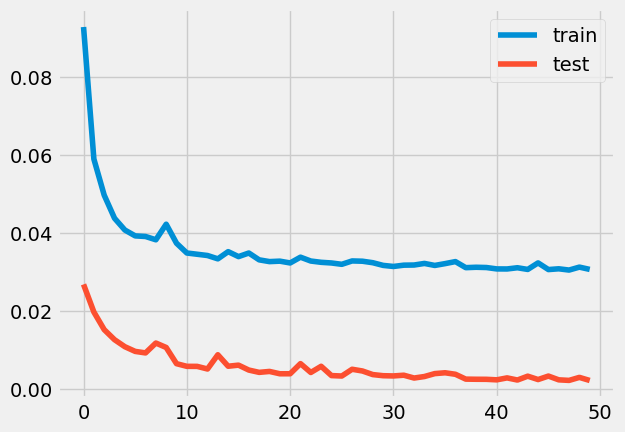

0.3207143369037603
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 188ms/step - loss: 0.1112 - accuracy: 0.0046 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.0592 - accuracy: 0.0056 - val_loss: 0.0184 - val_accuracy: 0.0000e+00
Epoch

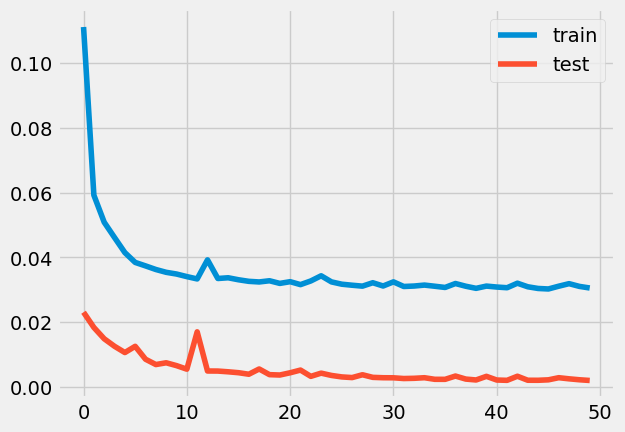

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 174ms/step - loss: 0.1567 - accuracy: 0.0021 - val_loss: 0.0360 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 111ms/step - loss: 0.0601 - accuracy: 0.0038 - val_loss: 0.0186 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

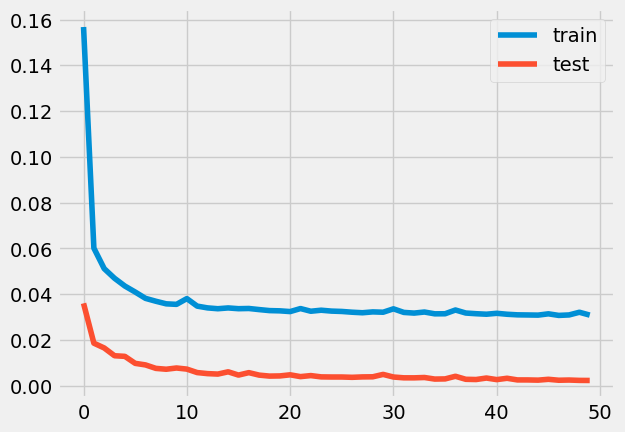

0.19627248144086784
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 147ms/step - loss: 0.1125 - accuracy: 0.0040 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 114ms/step - loss: 0.0626 - accuracy: 0.0054 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoc

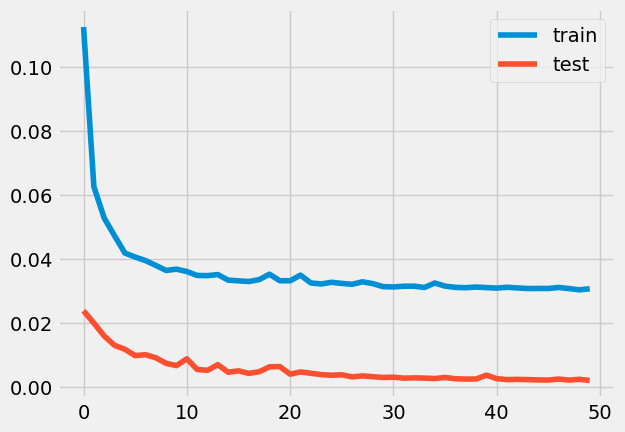

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 183ms/step - loss: 0.1058 - accuracy: 0.0022 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.0596 - accuracy: 0.0058 - val_loss: 0.0194 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

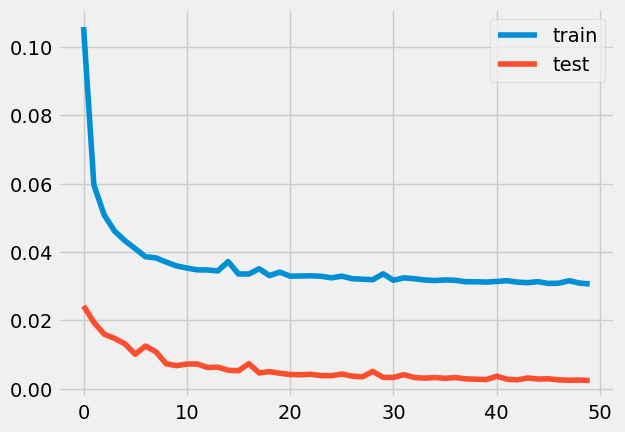

0.21411883335098733
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 173ms/step - loss: 0.1291 - accuracy: 0.0047 - val_loss: 0.0267 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.0608 - accuracy: 0.0042 - val_loss: 0.0186 - val_accuracy: 0.0000e+00
Epoc

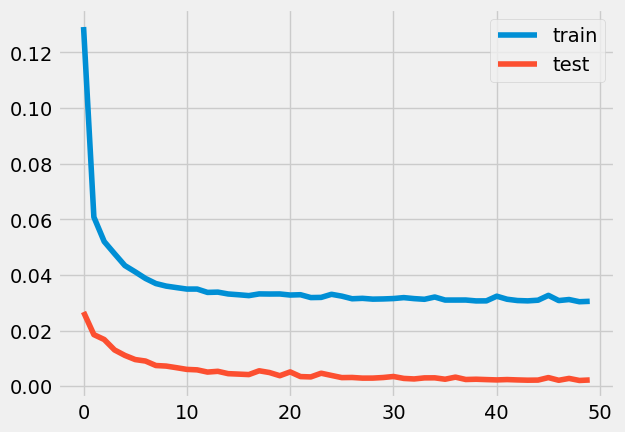

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 200ms/step - loss: 0.1474 - accuracy: 0.0043 - val_loss: 0.0365 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.0631 - accuracy: 0.0052 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

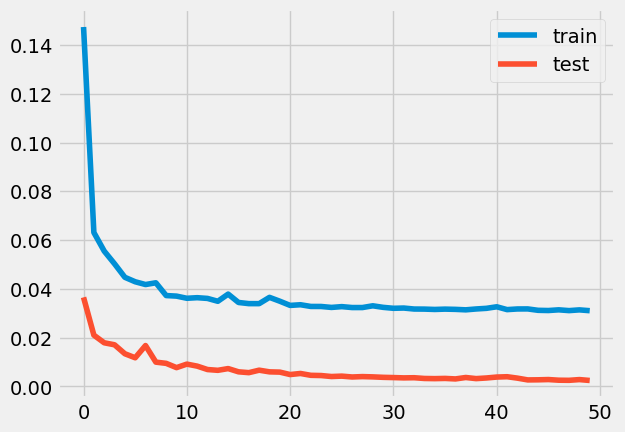

0.3108013816964628
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 162ms/step - loss: 0.1126 - accuracy: 0.0069 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 123ms/step - loss: 0.0577 - accuracy: 0.0053 - val_loss: 0.0177 - val_accuracy: 0.0000e+00
Epoch

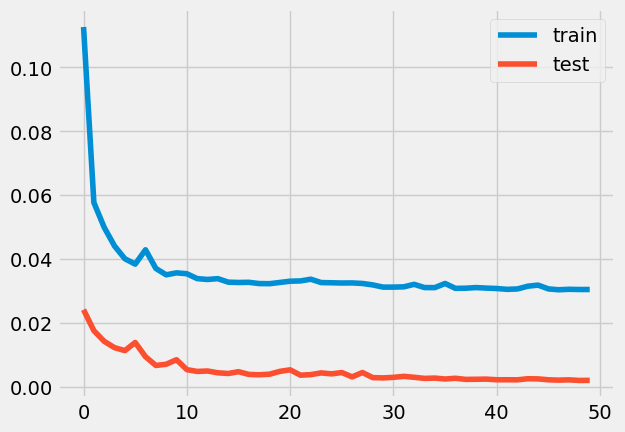

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 266ms/step - loss: 0.1803 - accuracy: 0.0023 - val_loss: 0.0447 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 161ms/step - loss: 0.0617 - accuracy: 0.0035 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

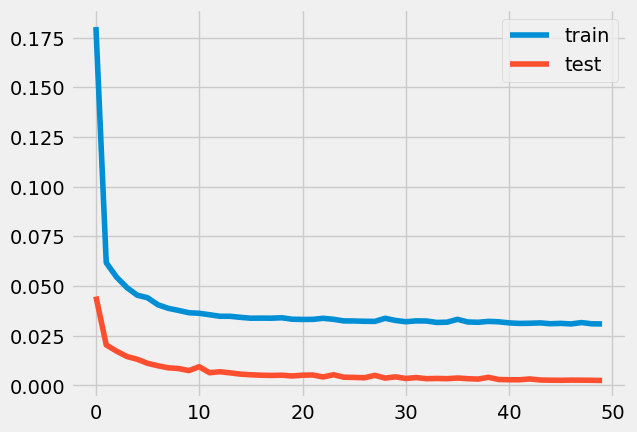

0.11862707249737262
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 207ms/step - loss: 0.1099 - accuracy: 0.0047 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 136ms/step - loss: 0.0619 - accuracy: 0.0046 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoc

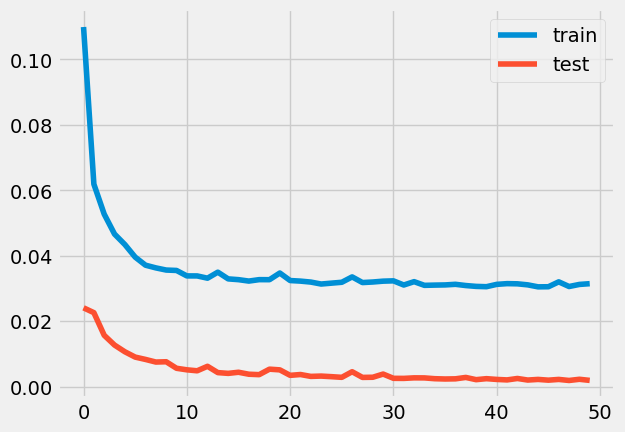

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 206ms/step - loss: 0.1729 - accuracy: 0.0025 - val_loss: 0.0425 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 126ms/step - loss: 0.0623 - accuracy: 0.0039 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

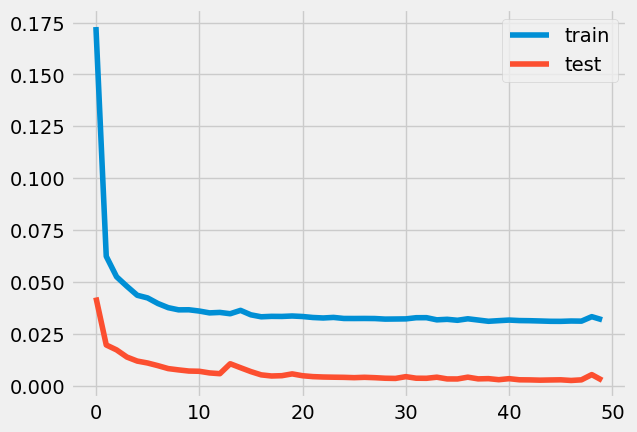

0.022483572143978676
7.8125e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 248ms/step - loss: 0.1167 - accuracy: 0.0063 - val_loss: 0.0261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 156ms/step - loss: 0.0629 - accuracy: 0.0051 - val_loss: 0.0209 - val_accuracy: 0.

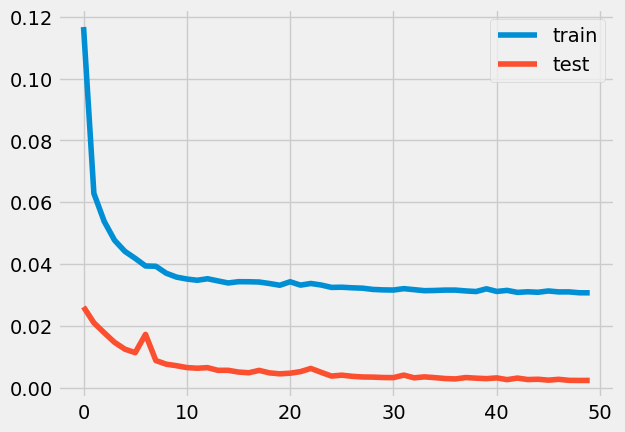

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 204ms/step - loss: 0.0913 - accuracy: 1.6393e-04 - val_loss: 0.0269 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 129ms/step - loss: 0.0601 - accuracy: 0.0054 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

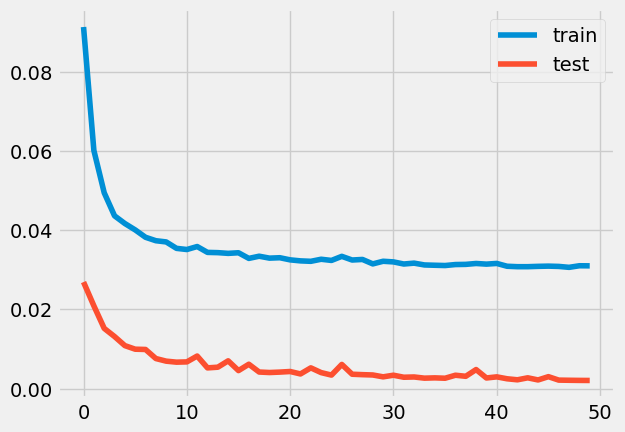

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 208ms/step - loss: 0.1318 - accuracy: 0.0037 - val_loss: 0.0284 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 127ms/step - loss: 0.0581 - accuracy: 0.0046 - val_loss: 0.0172 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

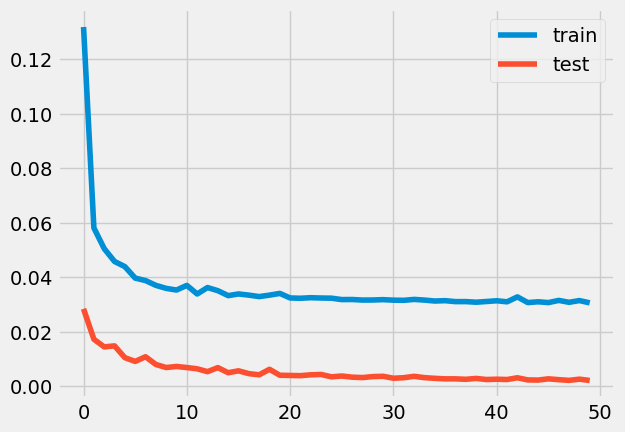

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 225ms/step - loss: 0.1327 - accuracy: 0.0020 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 170ms/step - loss: 0.0624 - accuracy: 0.0026 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

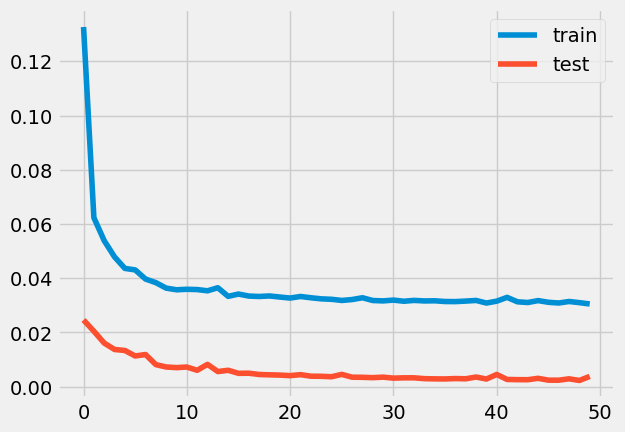

4.58564120669342e-10
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 195ms/step - loss: 0.0866 - accuracy: 0.0017 - val_loss: 0.0257 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 132ms/step - loss: 0.0578 - accuracy: 0.0049 - val_loss: 0.0183 - val_accuracy: 0.0000e+00
Epo

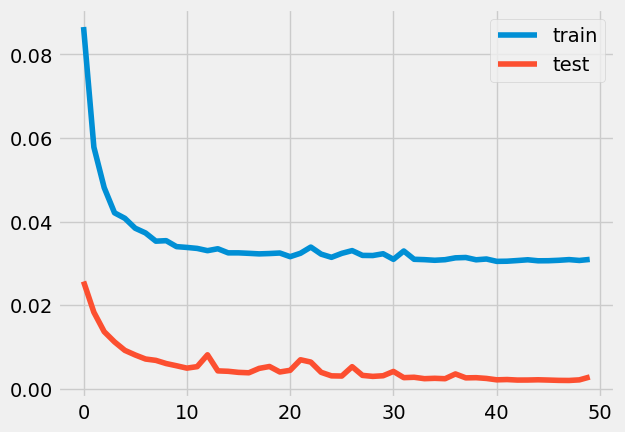

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 188ms/step - loss: 0.1536 - accuracy: 0.0063 - val_loss: 0.0358 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 138ms/step - loss: 0.0623 - accuracy: 0.0044 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

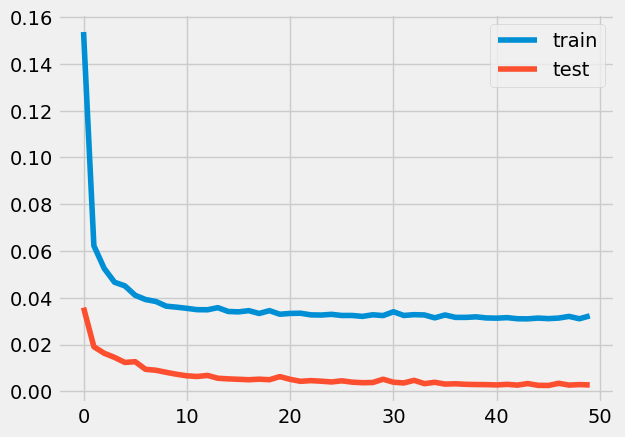

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 183ms/step - loss: 0.2081 - accuracy: 0.0035 - val_loss: 0.0476 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 118ms/step - loss: 0.0662 - accuracy: 0.0062 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

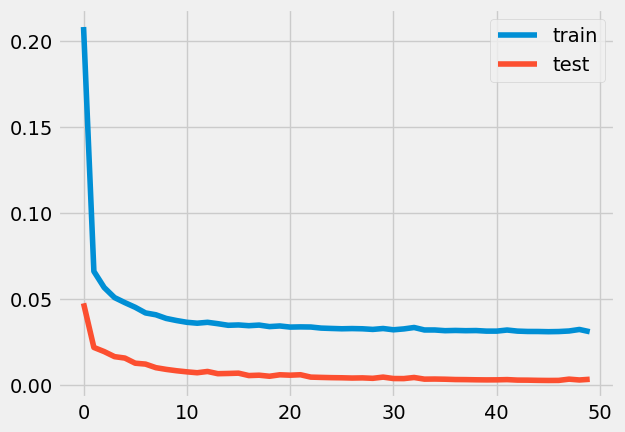

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 191ms/step - loss: 0.1345 - accuracy: 0.0020 - val_loss: 0.0279 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 125ms/step - loss: 0.0607 - accuracy: 0.0048 - val_loss: 0.0188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

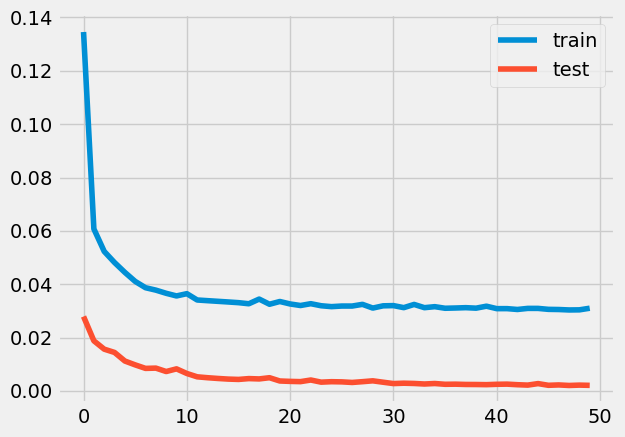

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 206ms/step - loss: 0.0955 - accuracy: 0.0059 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 128ms/step - loss: 0.0605 - accuracy: 0.0057 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

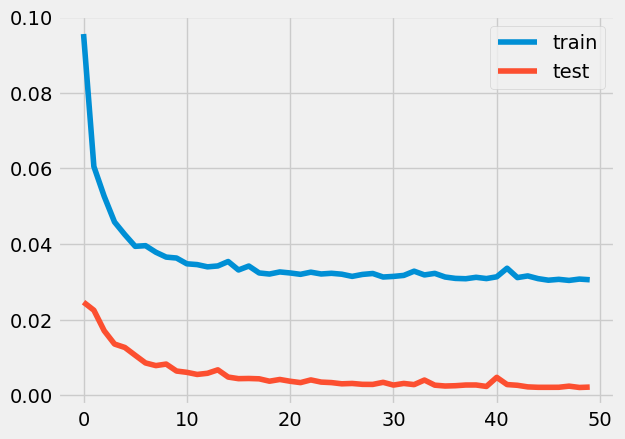

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 187ms/step - loss: 0.1542 - accuracy: 0.0040 - val_loss: 0.0314 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 124ms/step - loss: 0.0608 - accuracy: 0.0032 - val_loss: 0.0194 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

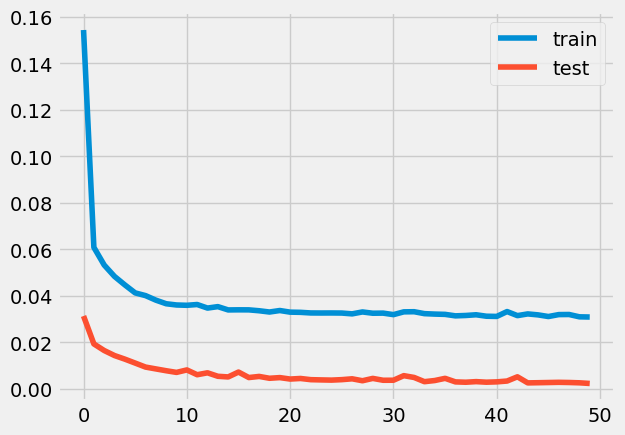

0.0806119411571053
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.1846 - accuracy: 0.0031 - val_loss: 0.0468 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0667 - accuracy: 0.0051 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 3

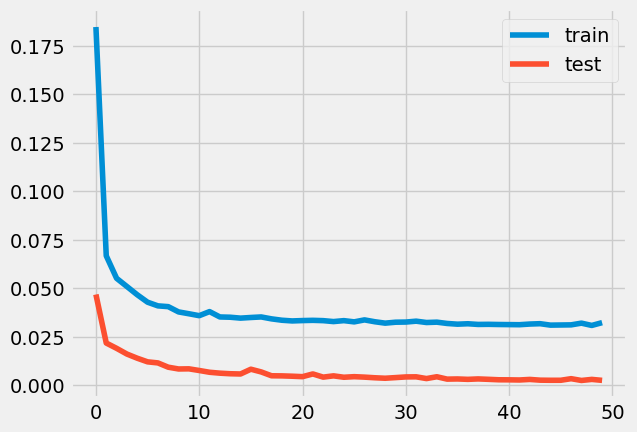

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 92ms/step - loss: 0.1582 - accuracy: 0.0042 - val_loss: 0.0382 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0662 - accuracy: 0.0054 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

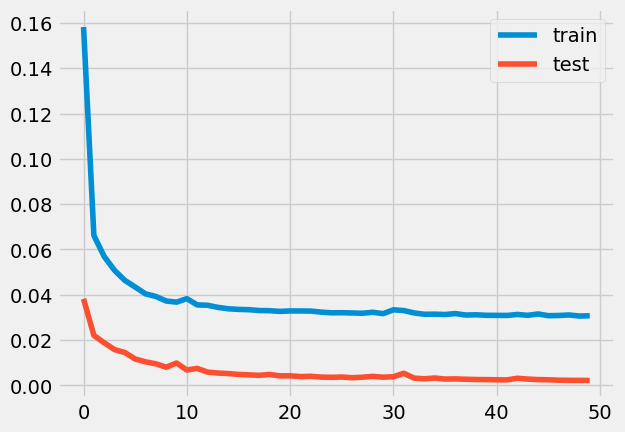

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.1337 - accuracy: 0.0049 - val_loss: 0.0275 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0619 - accuracy: 0.0052 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

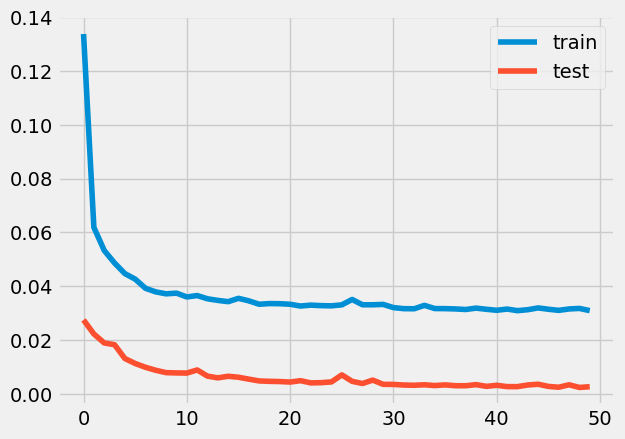

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.1841 - accuracy: 0.0010 - val_loss: 0.0481 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0653 - accuracy: 0.0055 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

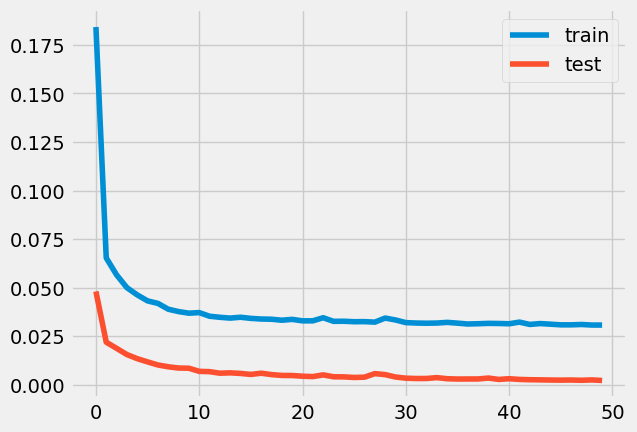

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 97ms/step - loss: 0.1349 - accuracy: 0.0044 - val_loss: 0.0374 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0639 - accuracy: 0.0046 - val_loss: 0.0191 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

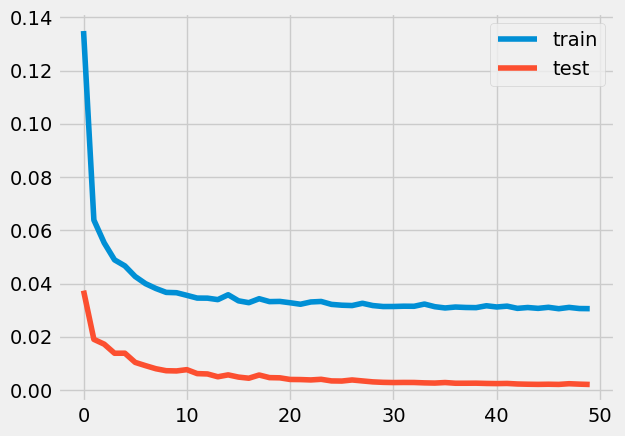

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1227 - accuracy: 0.0066 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0630 - accuracy: 0.0050 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

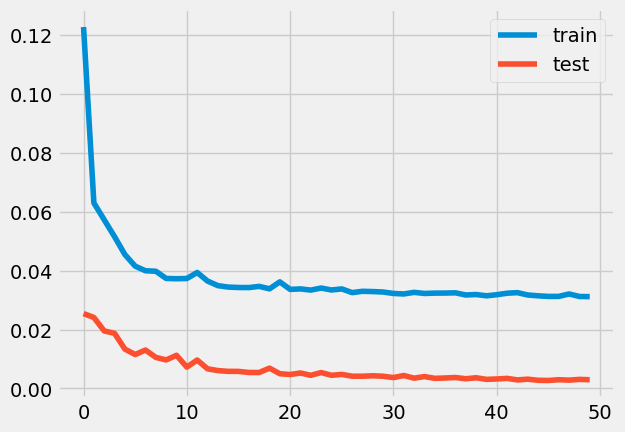

4.0752228198506965e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.1069 - accuracy: 0.0031 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0620 - accuracy: 0.0052 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epo

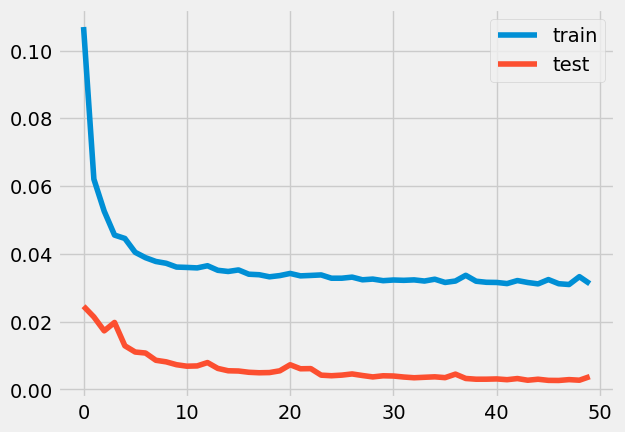

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 96ms/step - loss: 0.1687 - accuracy: 0.0045 - val_loss: 0.0477 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0653 - accuracy: 0.0052 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

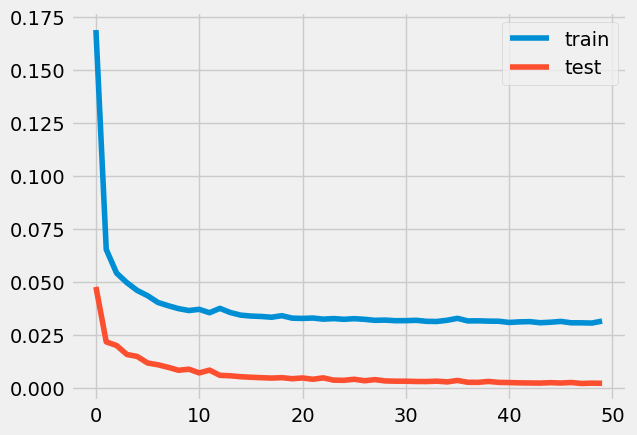

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 95ms/step - loss: 0.1206 - accuracy: 0.0037 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0640 - accuracy: 0.0052 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

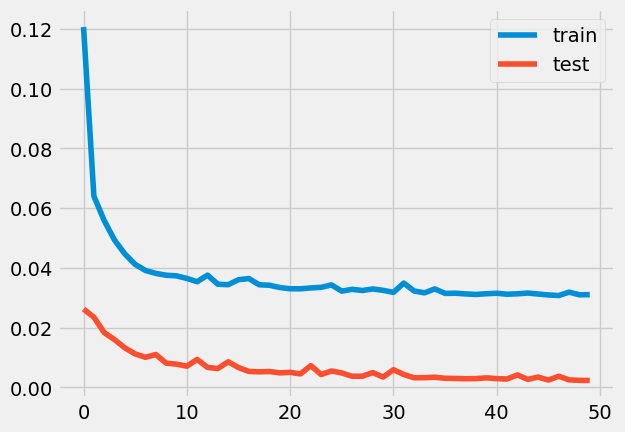

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.1416 - accuracy: 0.0056 - val_loss: 0.0303 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0606 - accuracy: 0.0050 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

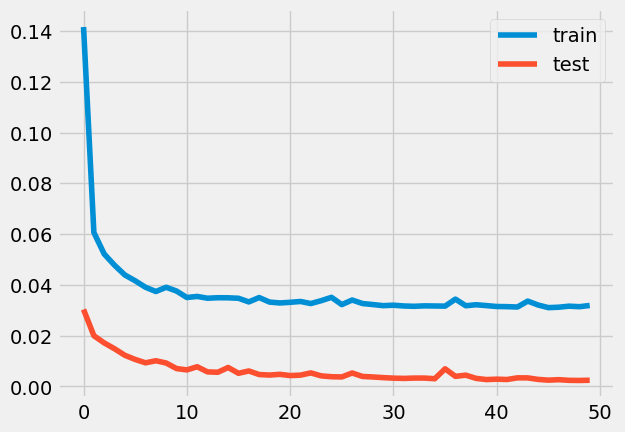

0.17544776702045178
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1276 - accuracy: 0.0023 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0611 - accuracy: 0.0046 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 

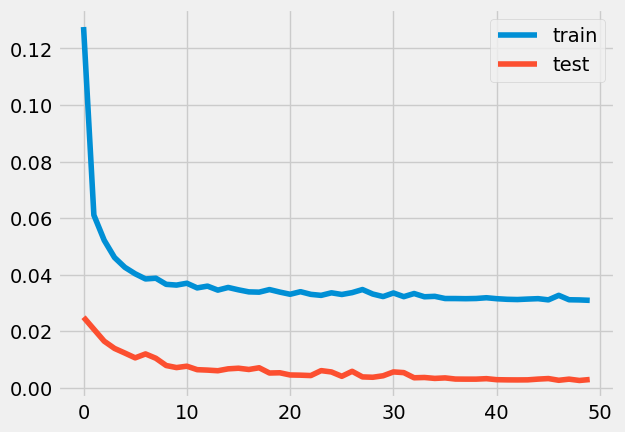

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.1231 - accuracy: 0.0021 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0591 - accuracy: 0.0055 - val_loss: 0.0191 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

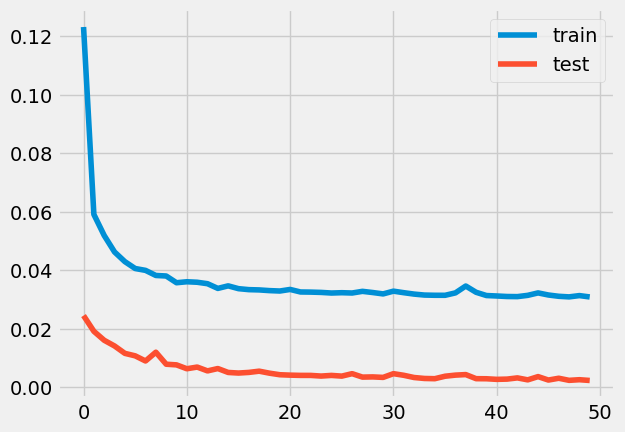

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 100ms/step - loss: 0.1166 - accuracy: 0.0045 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.0588 - accuracy: 0.0061 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

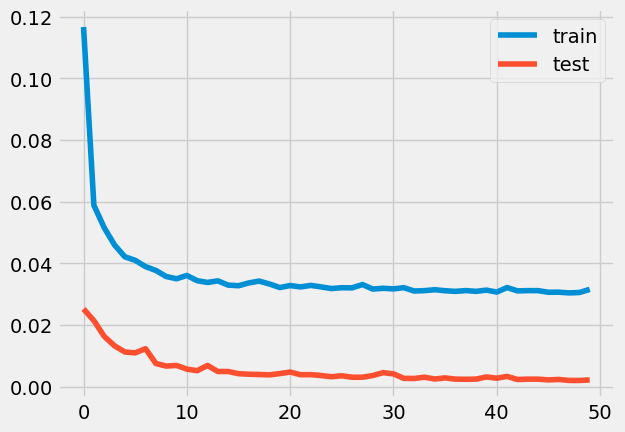

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 103ms/step - loss: 0.2059 - accuracy: 0.0011 - val_loss: 0.0406 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.0652 - accuracy: 0.0056 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

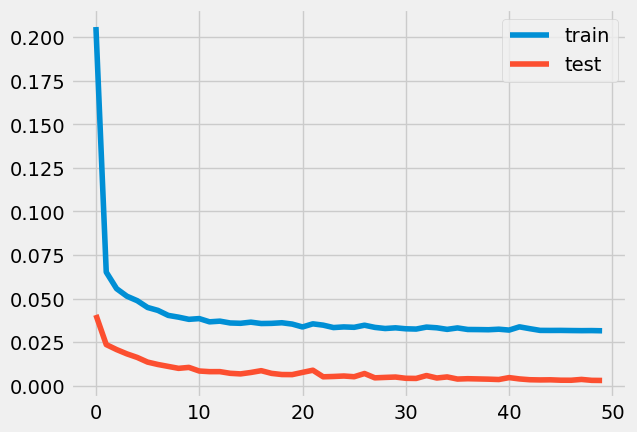

3.0009088075402227e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 100ms/step - loss: 0.0981 - accuracy: 0.0022 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0639 - accuracy: 0.0034 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Ep

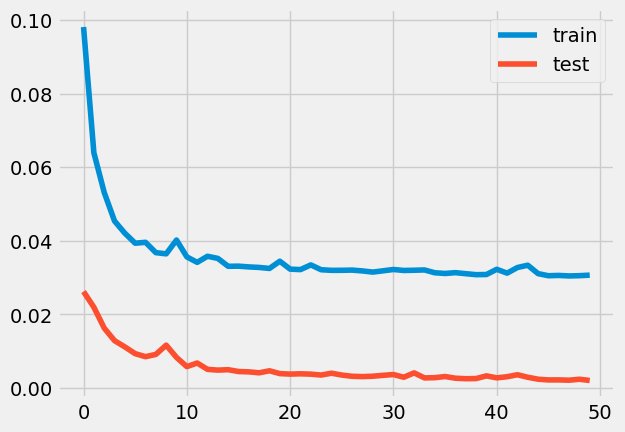

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1136 - accuracy: 0.0045 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.0623 - accuracy: 0.0044 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

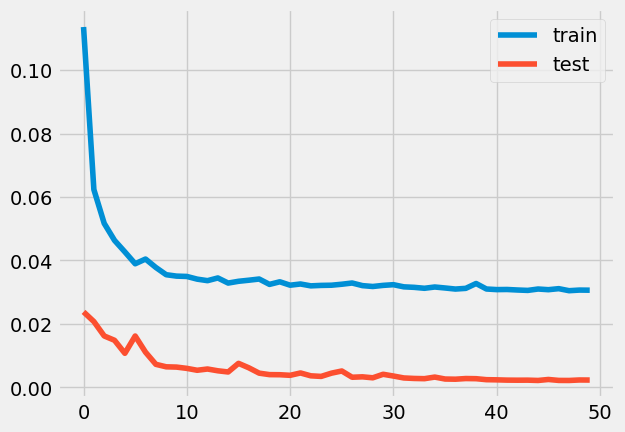

0.03862946034473932
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 95ms/step - loss: 0.1413 - accuracy: 0.0018 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0641 - accuracy: 0.0049 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 

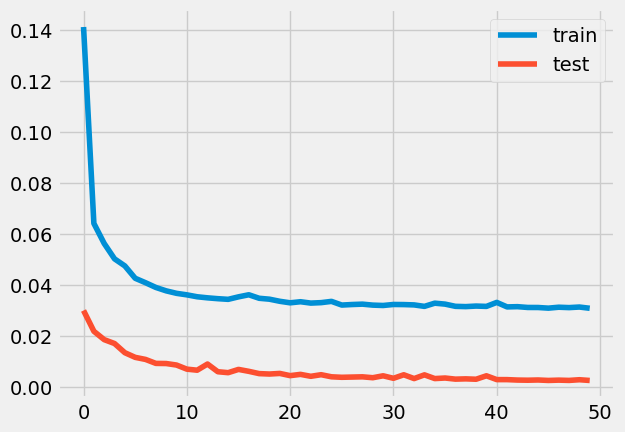

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1380 - accuracy: 0.0048 - val_loss: 0.0303 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0634 - accuracy: 0.0053 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

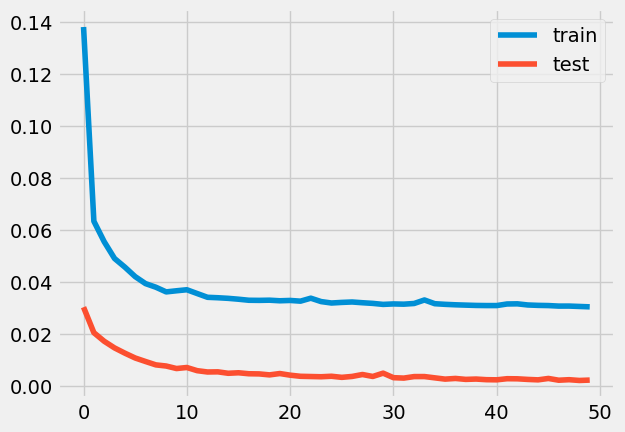

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 102ms/step - loss: 0.1004 - accuracy: 0.0040 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0607 - accuracy: 0.0047 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

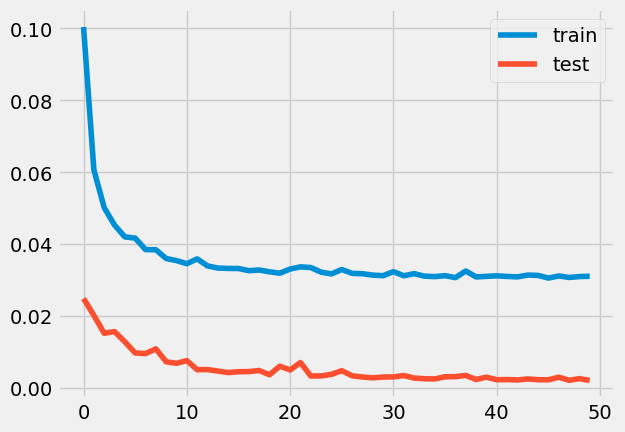

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 100ms/step - loss: 0.1106 - accuracy: 0.0044 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0631 - accuracy: 0.0055 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

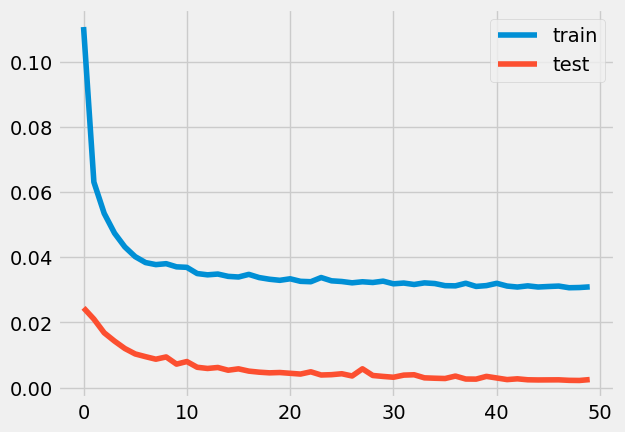

0.021255184293754024
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 98ms/step - loss: 0.1856 - accuracy: 0.0047 - val_loss: 0.0407 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0646 - accuracy: 0.0063 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch

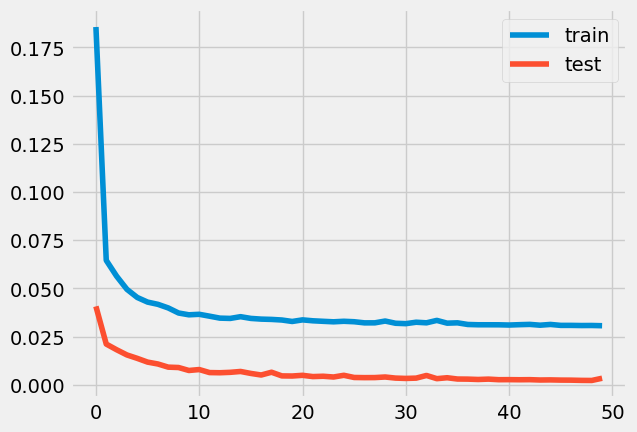

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 95ms/step - loss: 0.1015 - accuracy: 0.0065 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.0578 - accuracy: 0.0060 - val_loss: 0.0183 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

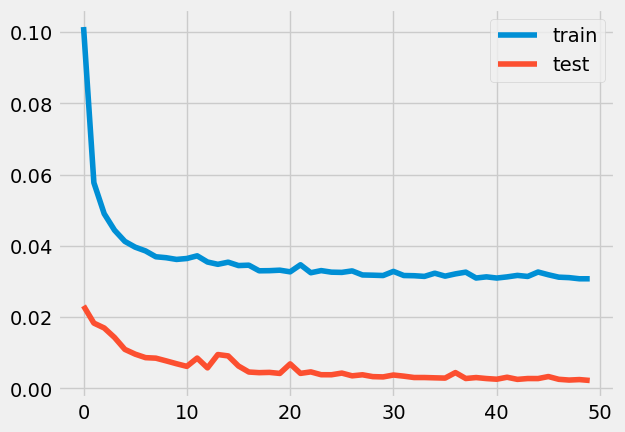

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 95ms/step - loss: 0.2028 - accuracy: 0.0017 - val_loss: 0.0401 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0609 - accuracy: 0.0067 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

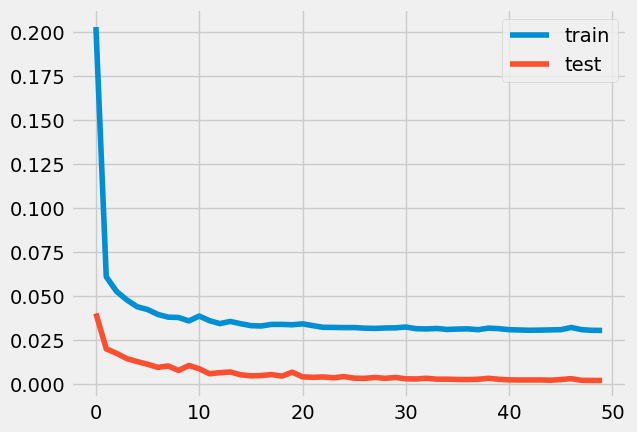

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 103ms/step - loss: 0.1234 - accuracy: 0.0069 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.0613 - accuracy: 0.0046 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

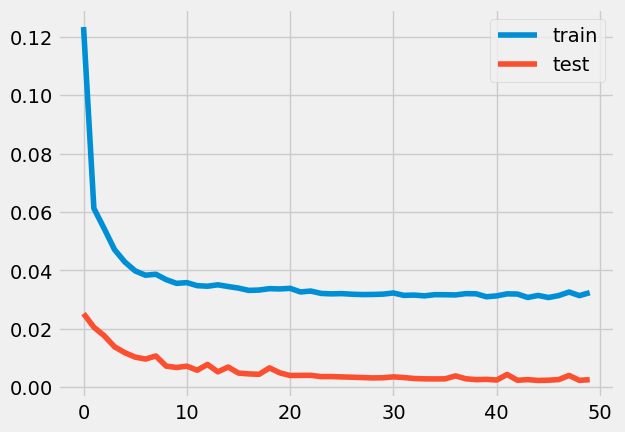

0.0004862476361956299
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 92ms/step - loss: 0.0932 - accuracy: 0.0061 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.0630 - accuracy: 0.0043 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoc

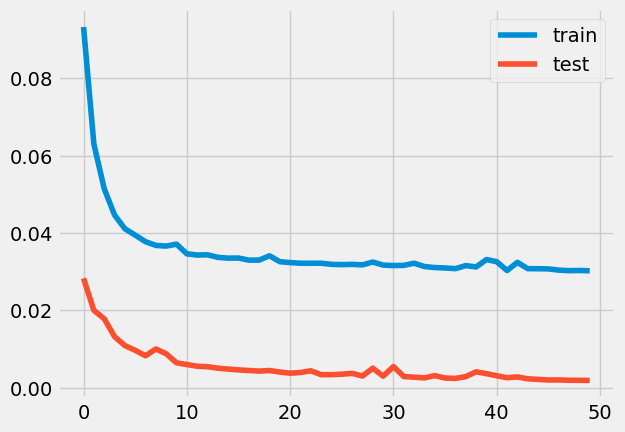

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 98ms/step - loss: 0.1074 - accuracy: 0.0013 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0580 - accuracy: 0.0057 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

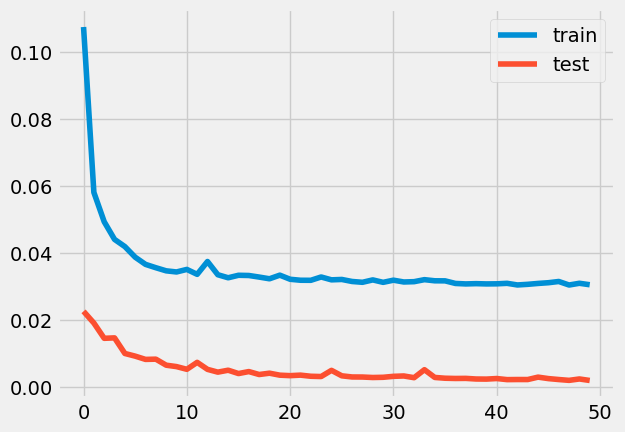

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 107ms/step - loss: 0.1847 - accuracy: 0.0014 - val_loss: 0.0419 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0651 - accuracy: 0.0040 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

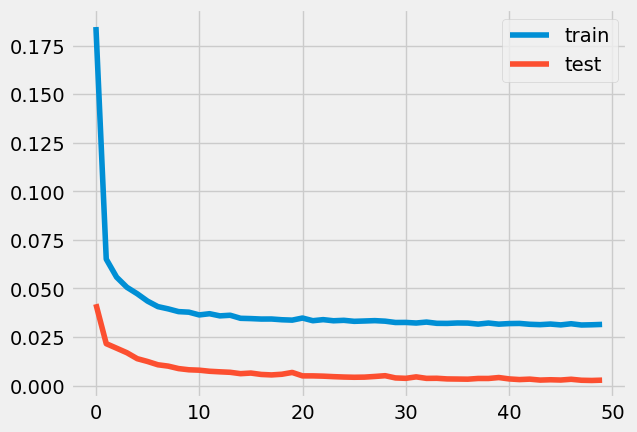

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 105ms/step - loss: 0.0960 - accuracy: 0.0032 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0563 - accuracy: 0.0060 - val_loss: 0.0177 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

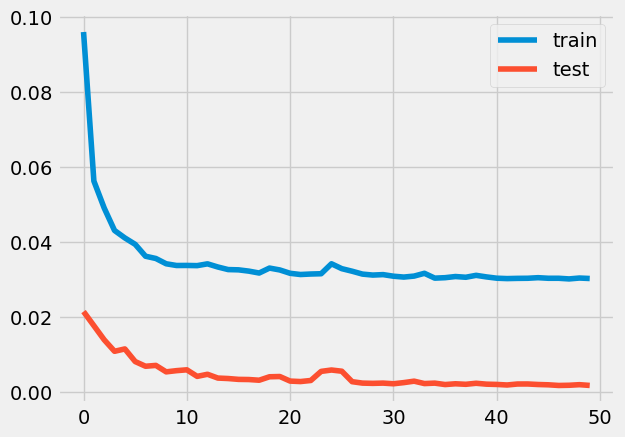

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 105ms/step - loss: 0.0845 - accuracy: 0.0050 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0577 - accuracy: 0.0055 - val_loss: 0.0175 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

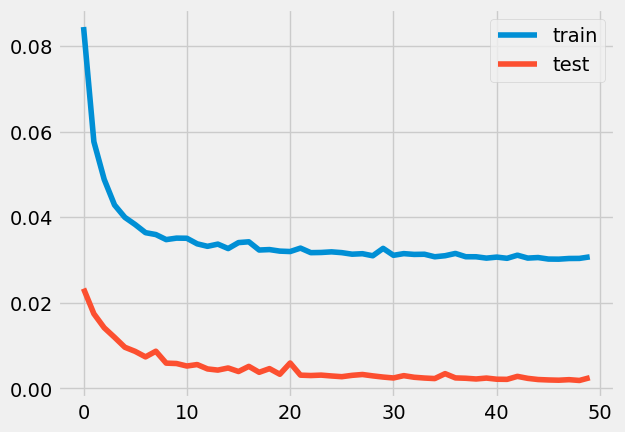

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 103ms/step - loss: 0.0852 - accuracy: 0.0041 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0567 - accuracy: 0.0065 - val_loss: 0.0178 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

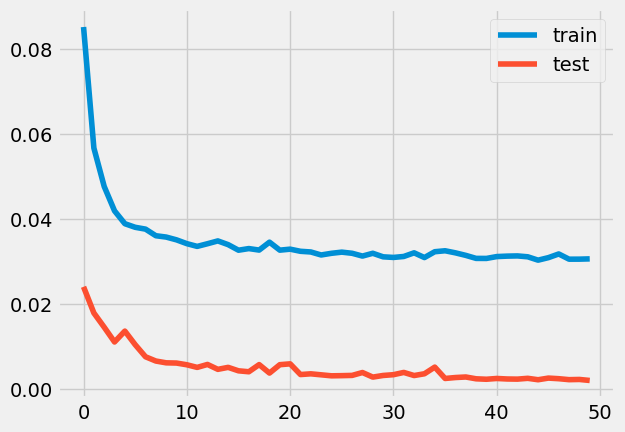

3.90625e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 105ms/step - loss: 0.1289 - accuracy: 0.0021 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 62ms/step - loss: 0.0580 - accuracy: 0.0051 - val_loss: 0.0186 - val_accuracy: 0.0000e+00
Epoch 3/50
20

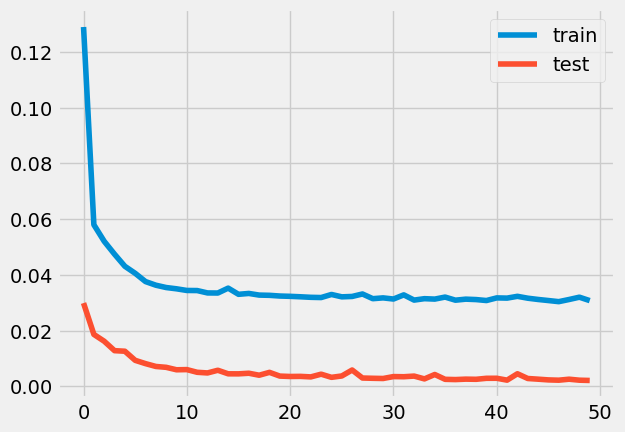

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 101ms/step - loss: 0.1339 - accuracy: 0.0021 - val_loss: 0.0267 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0646 - accuracy: 0.0041 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

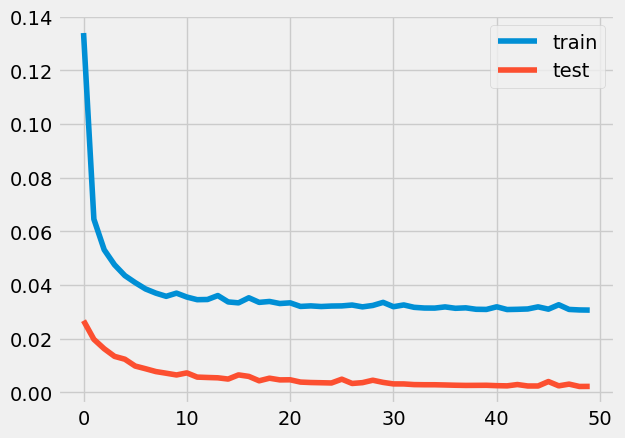

0.019577232506084296
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1410 - accuracy: 0.0025 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0616 - accuracy: 0.0043 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch

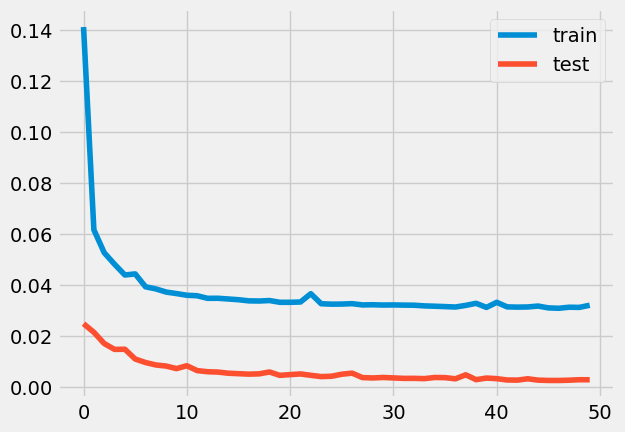

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1201 - accuracy: 0.0026 - val_loss: 0.0287 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 74ms/step - loss: 0.0645 - accuracy: 0.0053 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

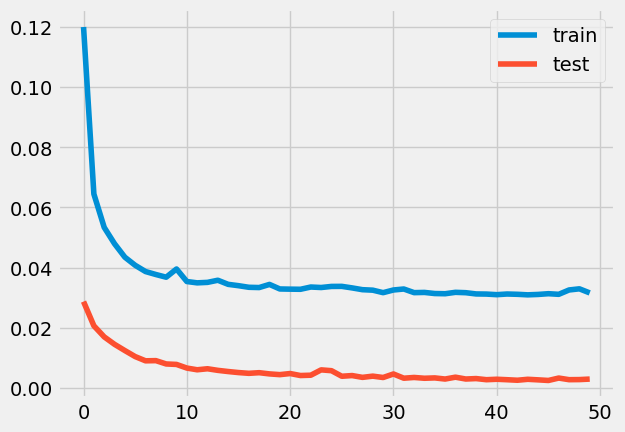

0.1730806163201251
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 98ms/step - loss: 0.0994 - accuracy: 0.0029 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0595 - accuracy: 0.0049 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3

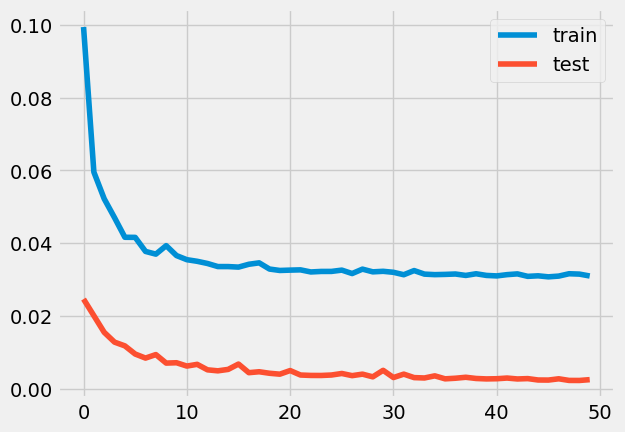

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 93ms/step - loss: 0.1695 - accuracy: 1.8648e-04 - val_loss: 0.0293 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0661 - accuracy: 0.0040 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

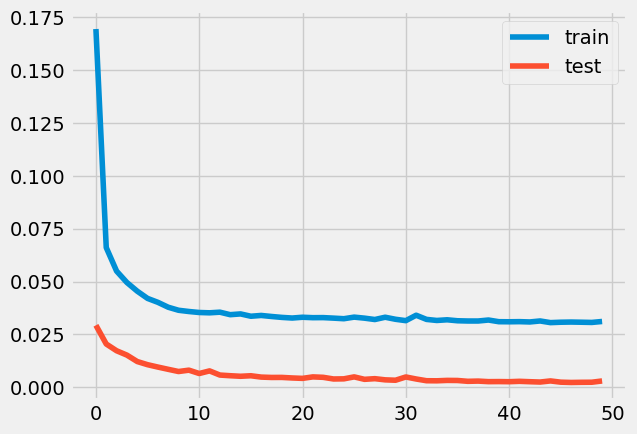

3.6123380072167994e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 105ms/step - loss: 0.1015 - accuracy: 0.0035 - val_loss: 0.0265 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0615 - accuracy: 0.0054 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Ep

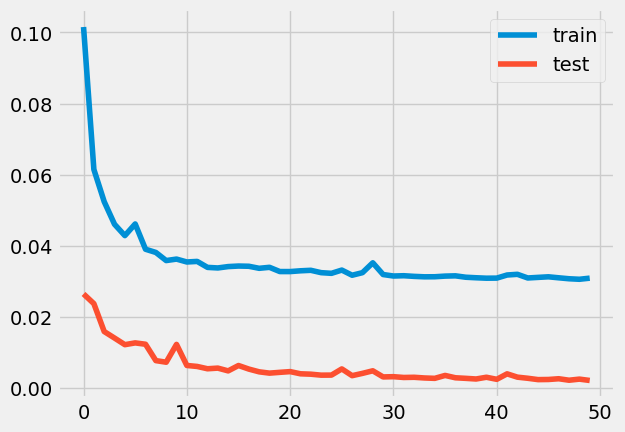

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 105ms/step - loss: 0.1348 - accuracy: 0.0048 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0567 - accuracy: 0.0060 - val_loss: 0.0192 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

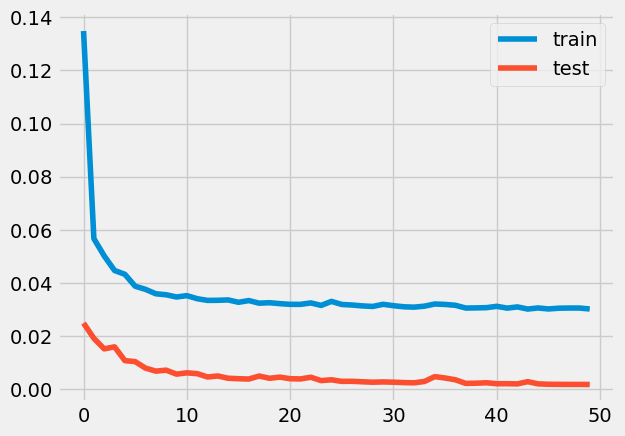

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.1179 - accuracy: 0.0017 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0617 - accuracy: 0.0051 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

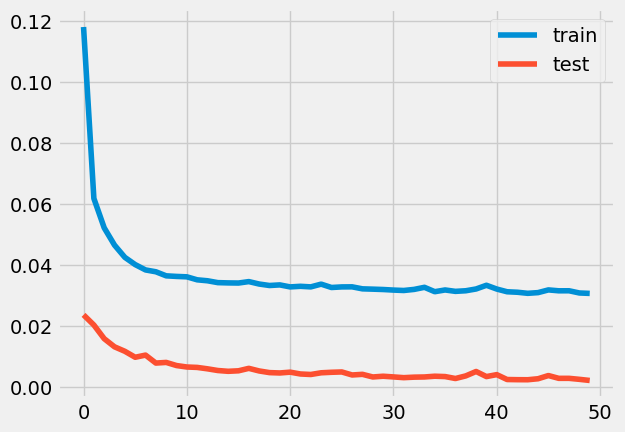

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 106ms/step - loss: 0.1215 - accuracy: 0.0041 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.0581 - accuracy: 0.0057 - val_loss: 0.0183 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

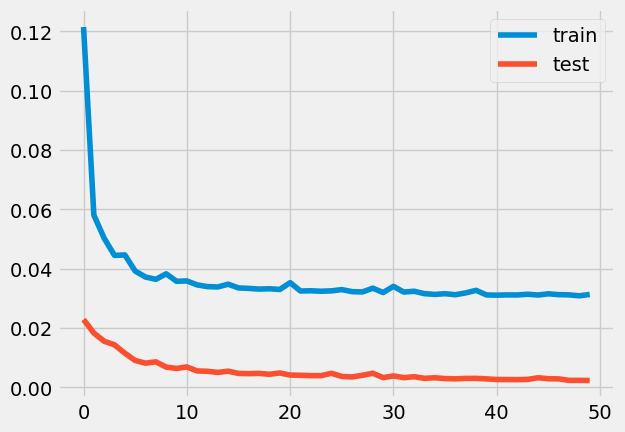

0.0009755850821601007
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 98ms/step - loss: 0.0846 - accuracy: 0.0055 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0556 - accuracy: 0.0054 - val_loss: 0.0181 - val_accuracy: 0.0000e+00
Epoc

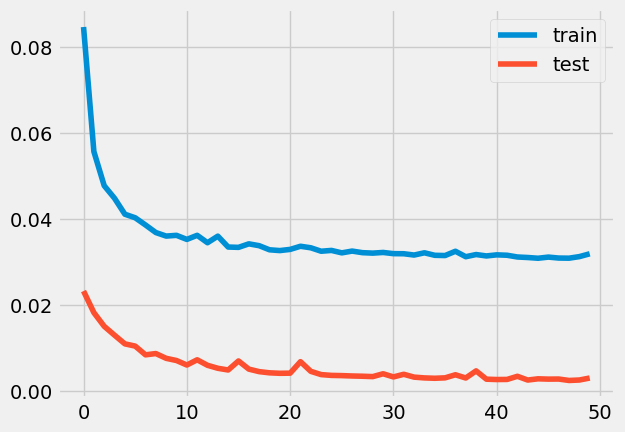

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 101ms/step - loss: 0.1239 - accuracy: 0.0040 - val_loss: 0.0261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0584 - accuracy: 0.0057 - val_loss: 0.0187 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

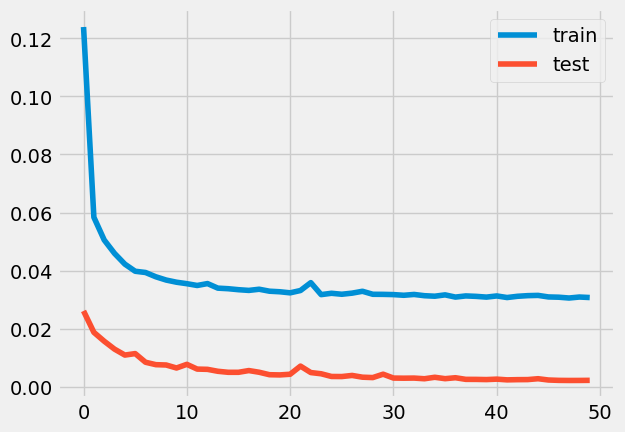

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 92ms/step - loss: 0.0980 - accuracy: 0.0060 - val_loss: 0.0253 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0618 - accuracy: 0.0058 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

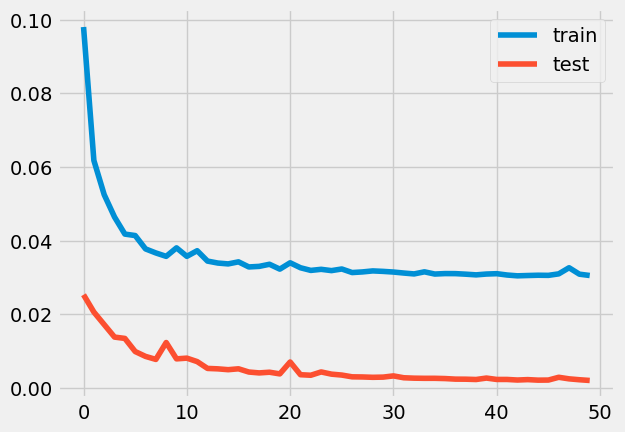

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 98ms/step - loss: 0.1164 - accuracy: 0.0049 - val_loss: 0.0258 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0636 - accuracy: 0.0051 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

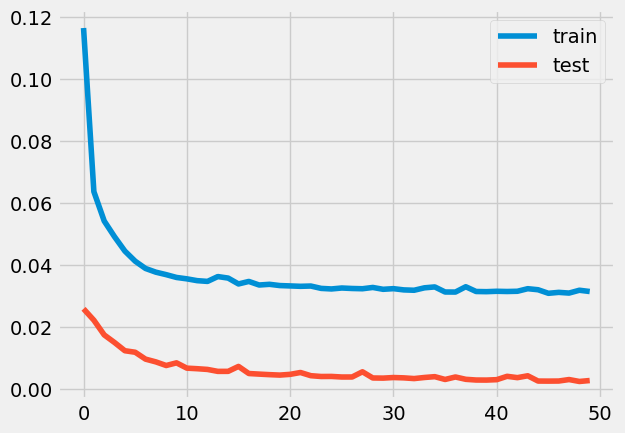

1.2556836796490106e-08
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1101 - accuracy: 0.0038 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0593 - accuracy: 0.0047 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epo

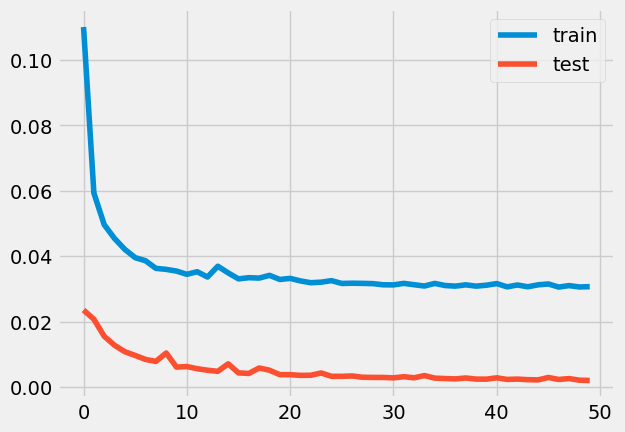

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 99ms/step - loss: 0.1092 - accuracy: 0.0040 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0610 - accuracy: 0.0064 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

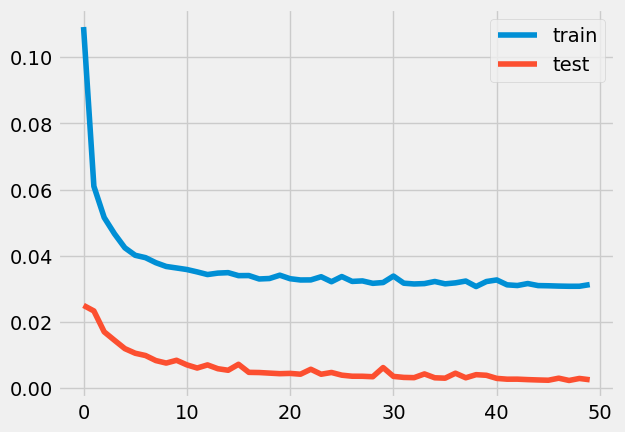

3.8578384250674785e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1132 - accuracy: 0.0065 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.0598 - accuracy: 0.0044 - val_loss: 0.0189 - val_accuracy: 0.0000e+00
Epo

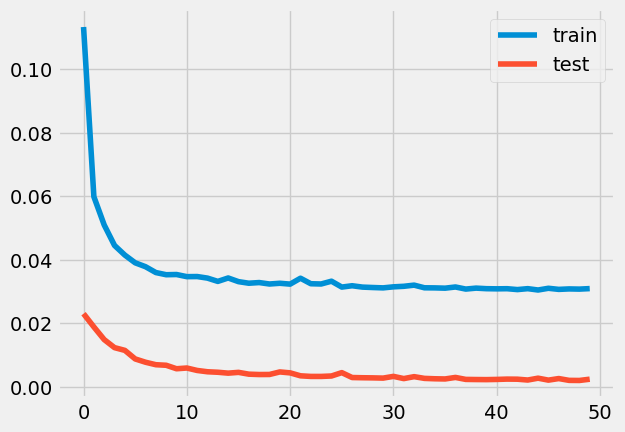

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 98ms/step - loss: 0.0961 - accuracy: 0.0053 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0599 - accuracy: 0.0051 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

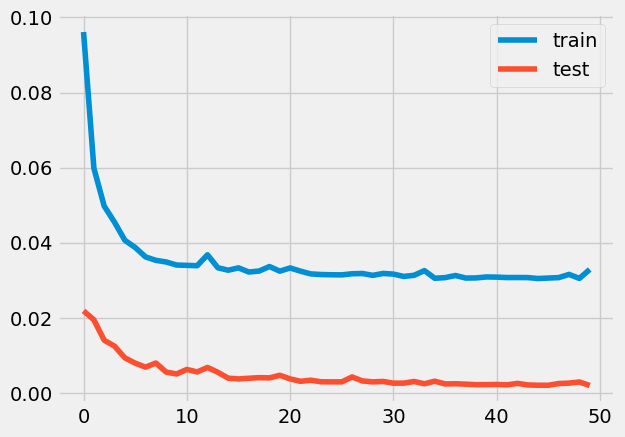

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 93ms/step - loss: 0.1488 - accuracy: 0.0029 - val_loss: 0.0321 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0617 - accuracy: 0.0053 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

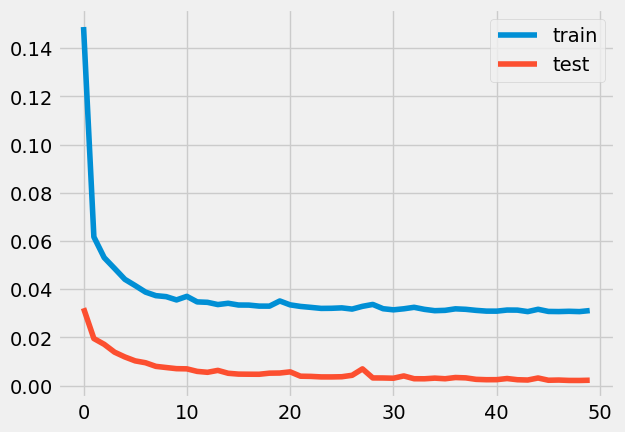

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 101ms/step - loss: 0.0932 - accuracy: 0.0063 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0569 - accuracy: 0.0051 - val_loss: 0.0185 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

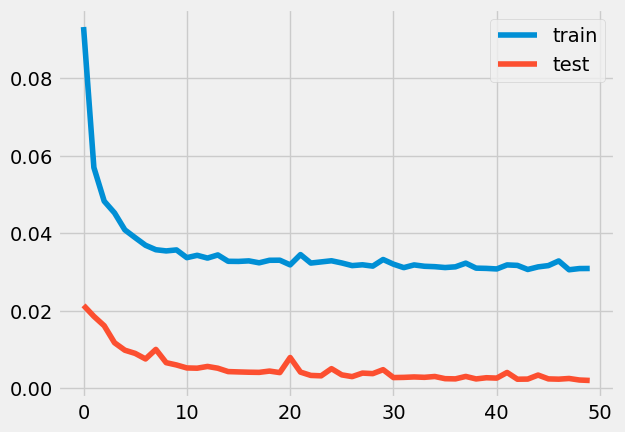

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 94ms/step - loss: 0.1754 - accuracy: 0.0052 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0614 - accuracy: 0.0054 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

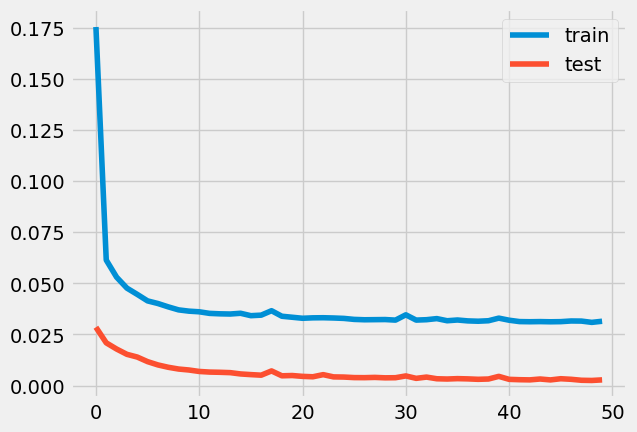

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 99ms/step - loss: 0.1236 - accuracy: 0.0043 - val_loss: 0.0288 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.0607 - accuracy: 0.0063 - val_loss: 0.0188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

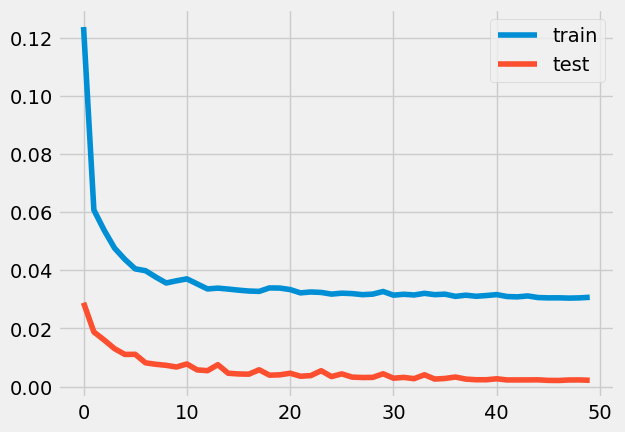

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 103ms/step - loss: 0.1061 - accuracy: 0.0035 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.0601 - accuracy: 0.0056 - val_loss: 0.0188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=======

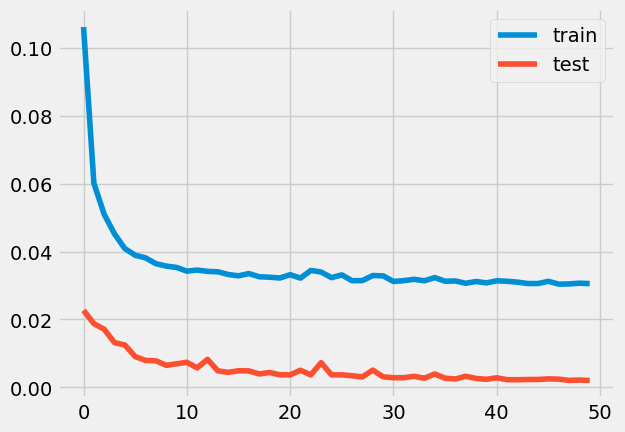

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 98ms/step - loss: 0.1047 - accuracy: 0.0052 - val_loss: 0.0296 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0629 - accuracy: 0.0047 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

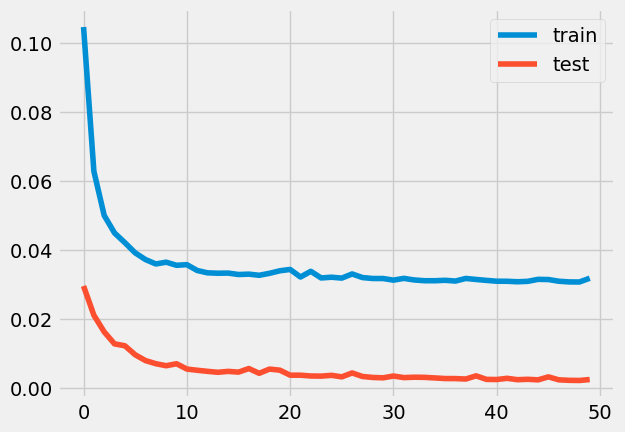

1.2638756505636631e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 101ms/step - loss: 0.0909 - accuracy: 0.0063 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0605 - accuracy: 0.0043 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Ep

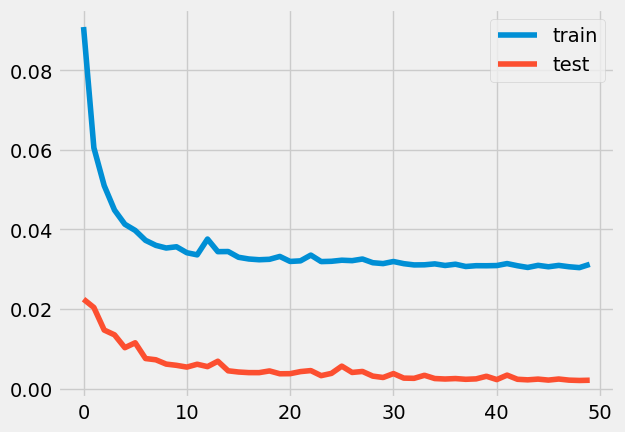

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 96ms/step - loss: 0.1412 - accuracy: 0.0069 - val_loss: 0.0278 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0597 - accuracy: 0.0055 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

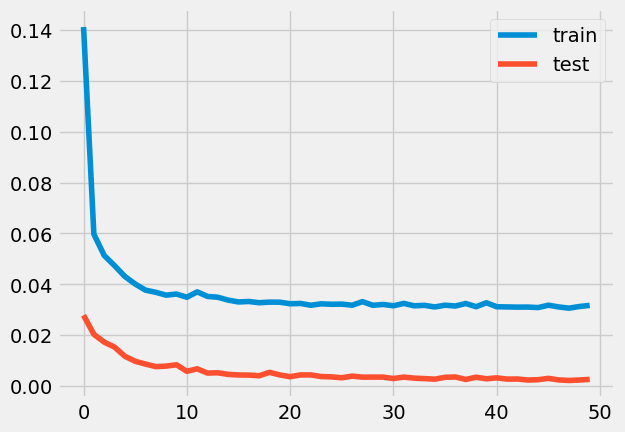

1.0688641628361696e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.1756 - accuracy: 0.0050 - val_loss: 0.0423 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0642 - accuracy: 0.0042 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epo

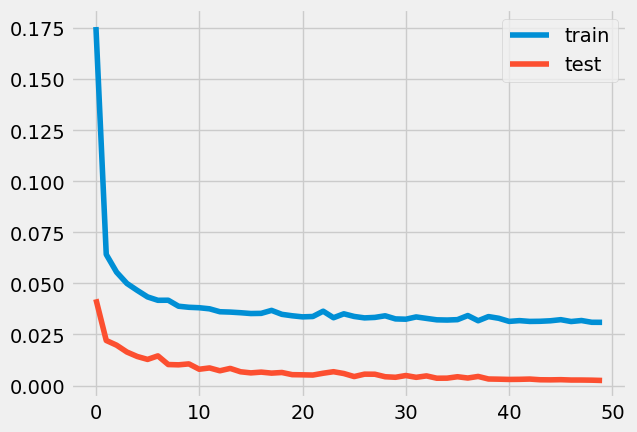

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 96ms/step - loss: 0.0940 - accuracy: 0.0014 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0582 - accuracy: 0.0045 - val_loss: 0.0176 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

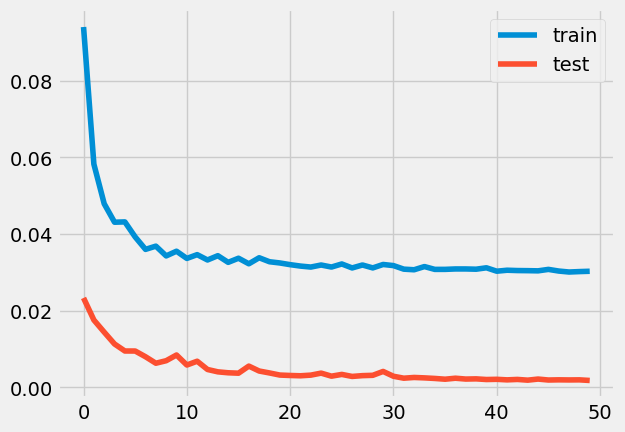

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 72ms/step - loss: 0.1461 - accuracy: 0.0060 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0615 - accuracy: 0.0051 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

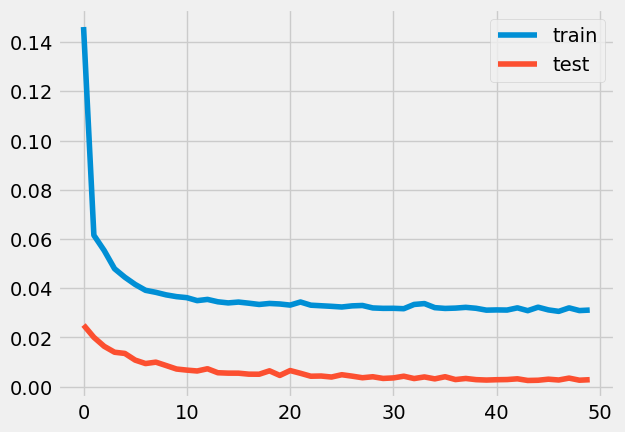

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1042 - accuracy: 0.0030 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0600 - accuracy: 0.0051 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

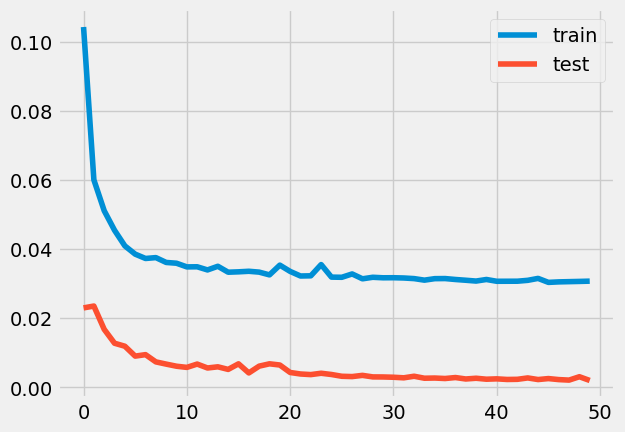

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1052 - accuracy: 0.0017 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0629 - accuracy: 0.0040 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

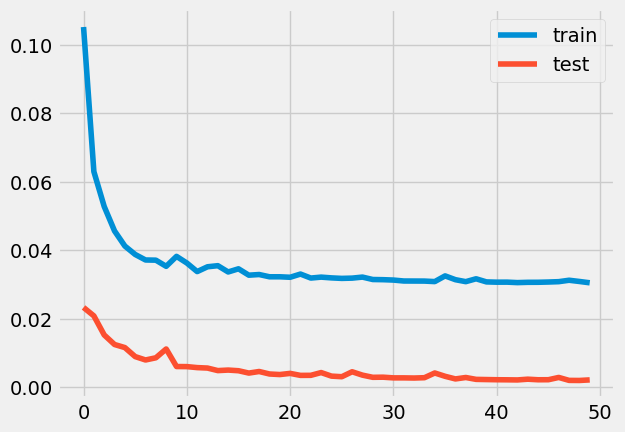

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1338 - accuracy: 0.0022 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0635 - accuracy: 0.0047 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

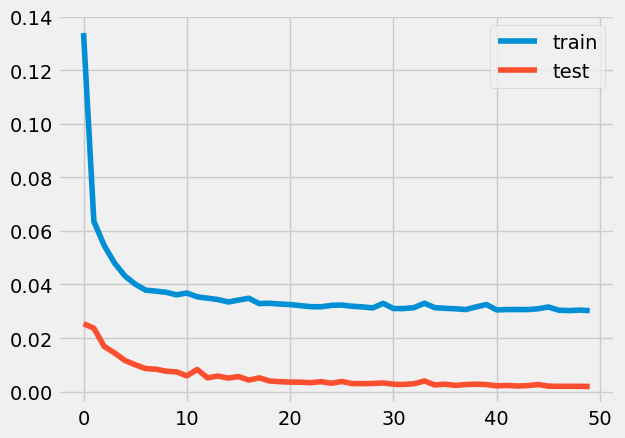

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1149 - accuracy: 0.0059 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0625 - accuracy: 0.0048 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

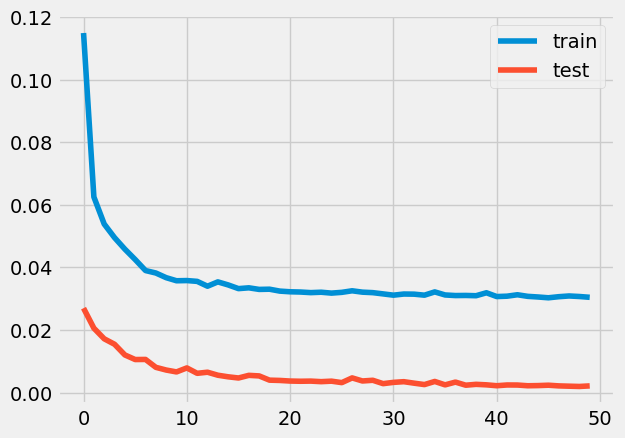

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 72ms/step - loss: 0.1109 - accuracy: 0.0032 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0607 - accuracy: 0.0037 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

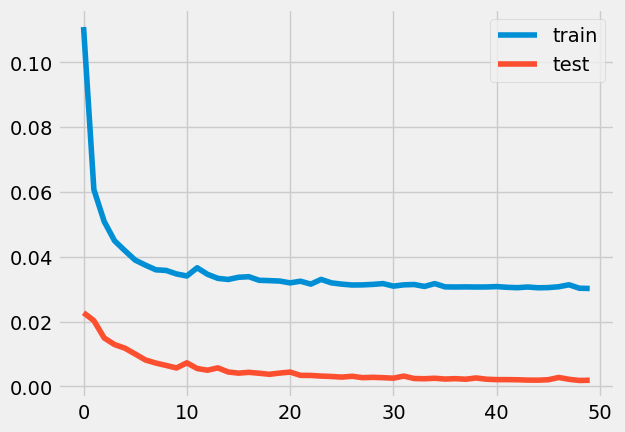

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1020 - accuracy: 0.0034 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0603 - accuracy: 0.0052 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

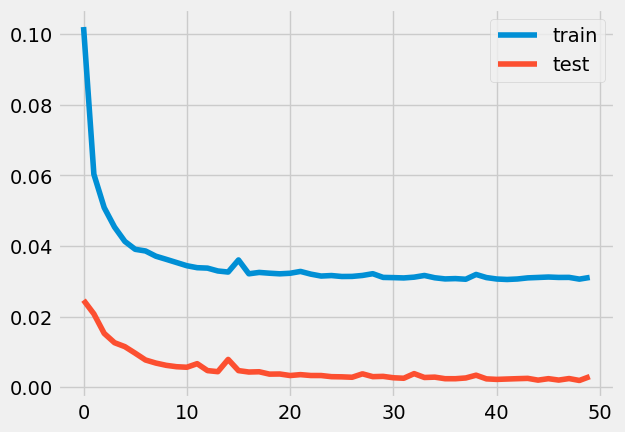

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1325 - accuracy: 0.0000e+00 - val_loss: 0.0296 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0599 - accuracy: 0.0053 - val_loss: 0.0186 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

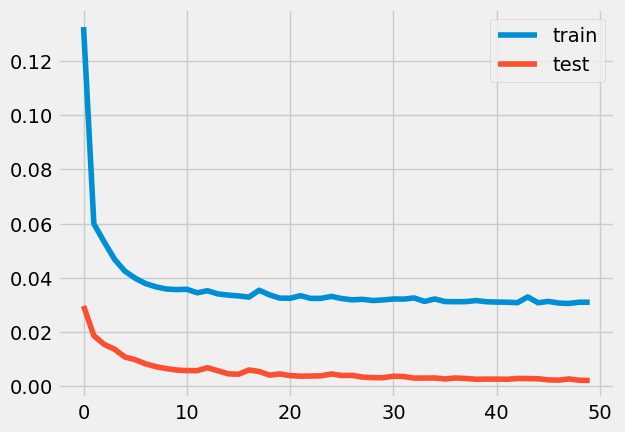

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1083 - accuracy: 0.0046 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0589 - accuracy: 0.0050 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

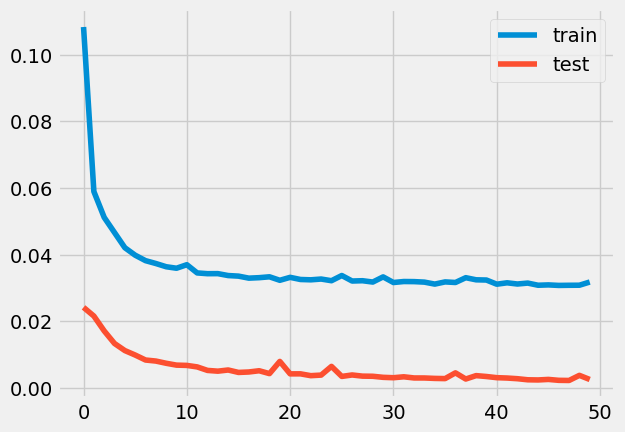

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1147 - accuracy: 0.0036 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0598 - accuracy: 0.0055 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

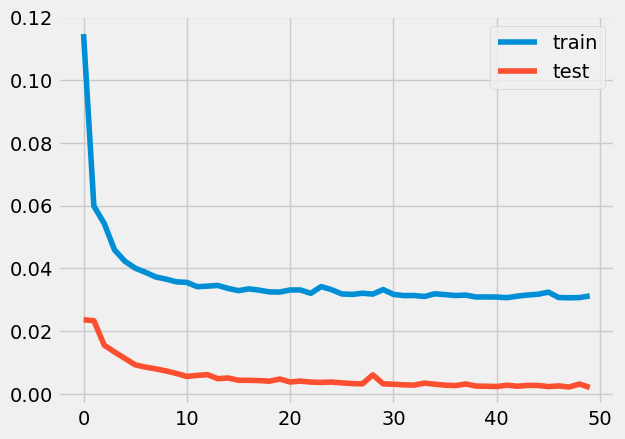

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1287 - accuracy: 0.0051 - val_loss: 0.0311 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0652 - accuracy: 0.0050 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

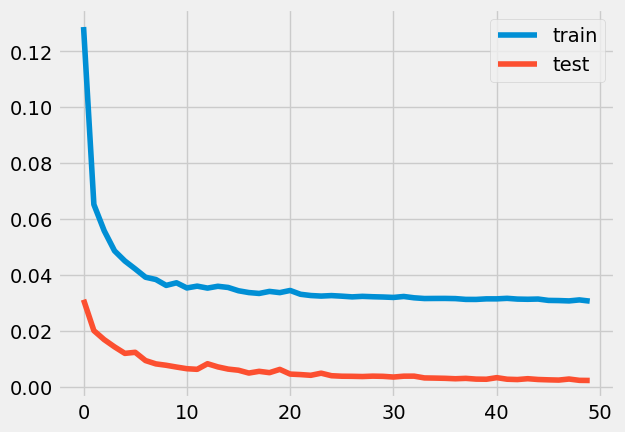

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.0918 - accuracy: 0.0048 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0618 - accuracy: 0.0044 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

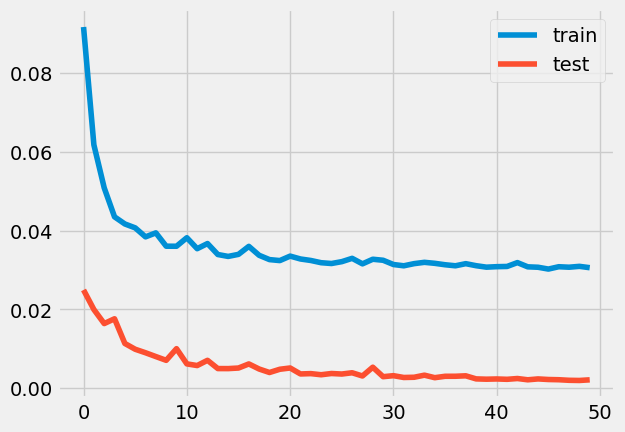

1.953125e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1146 - accuracy: 0.0043 - val_loss: 0.0256 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0608 - accuracy: 0.0054 - val_loss: 0.0197 - val_accuracy: 0.0000e+00
Epoch 3/50
20

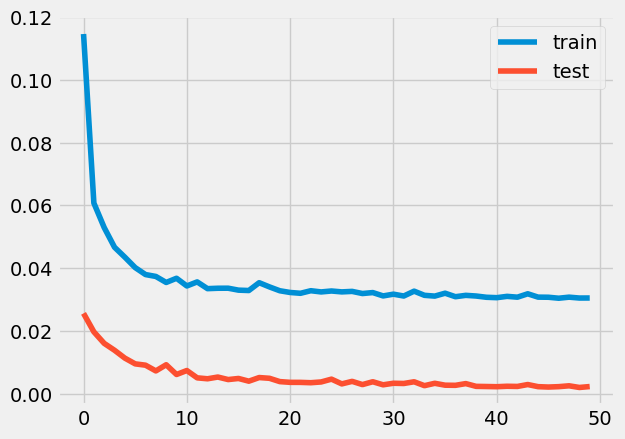

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1444 - accuracy: 0.0049 - val_loss: 0.0286 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0594 - accuracy: 0.0049 - val_loss: 0.0180 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

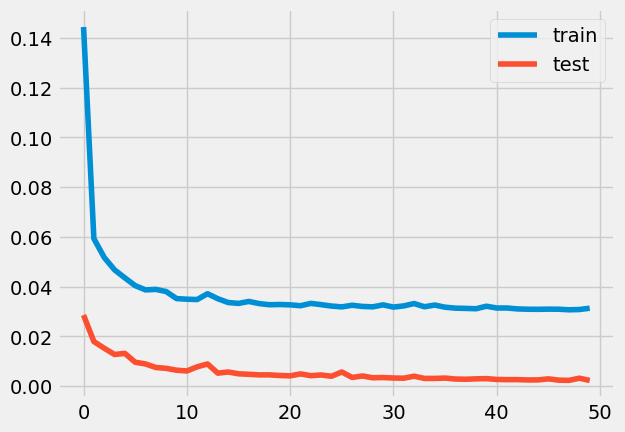

0.4827532864803977
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1572 - accuracy: 0.0046 - val_loss: 0.0321 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0636 - accuracy: 0.0041 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3

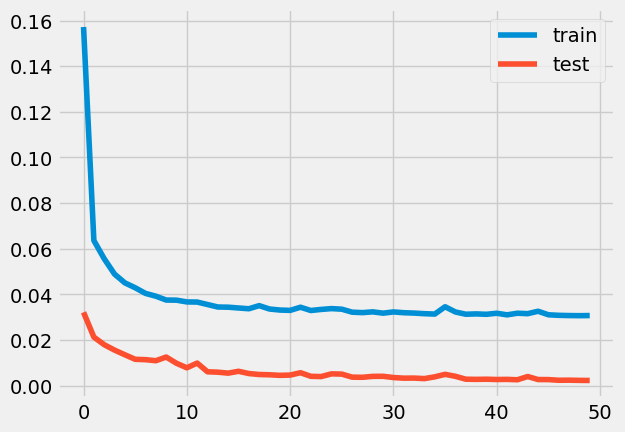

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1237 - accuracy: 0.0040 - val_loss: 0.0261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0656 - accuracy: 0.0042 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

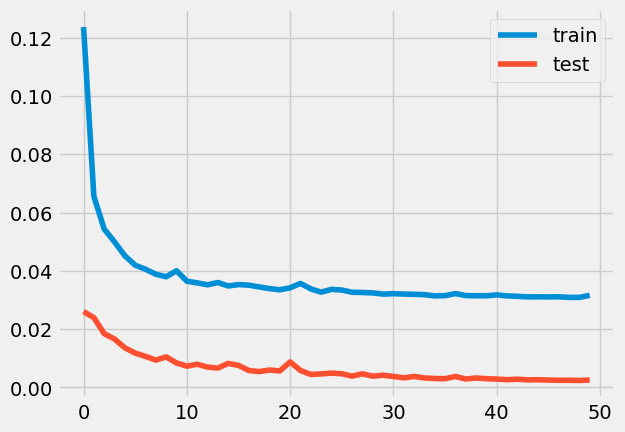

4.911178270964152e-07
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1090 - accuracy: 0.0018 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0603 - accuracy: 0.0053 - val_loss: 0.0192 - val_accuracy: 0.0000e+00
Epoc

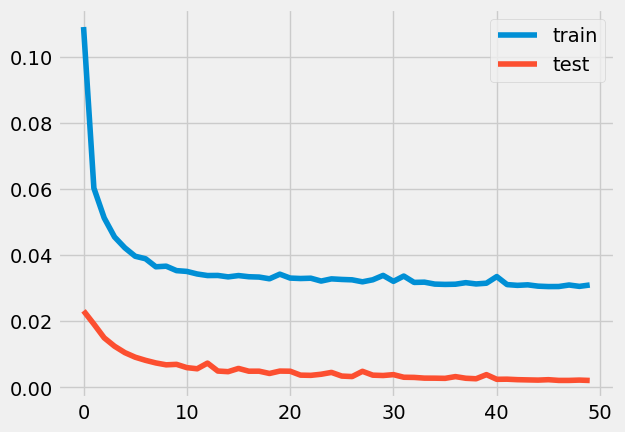

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1446 - accuracy: 0.0013 - val_loss: 0.0266 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0606 - accuracy: 0.0041 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

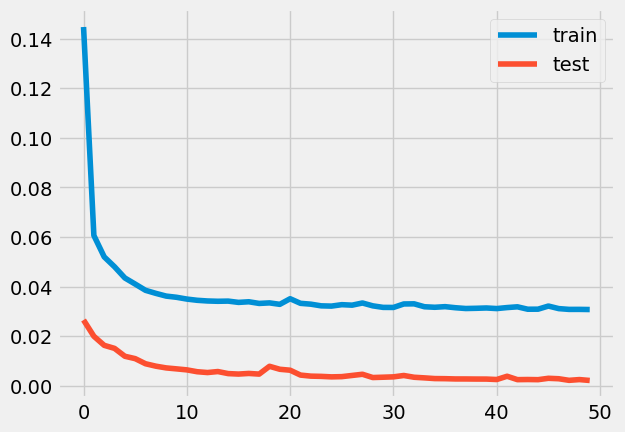

0.004379983526366712
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1135 - accuracy: 0.0038 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0594 - accuracy: 0.0045 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch

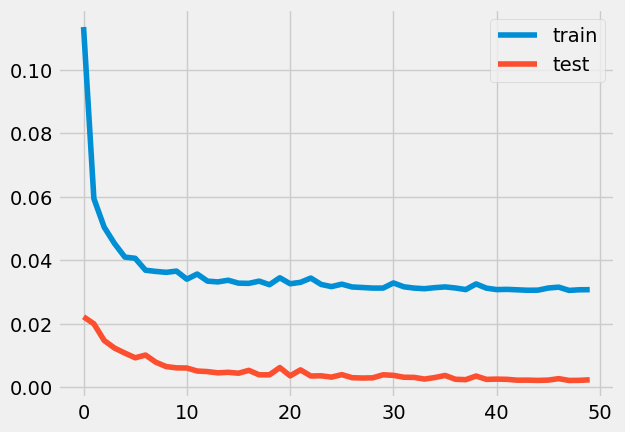

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.0889 - accuracy: 0.0059 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0598 - accuracy: 0.0054 - val_loss: 0.0192 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

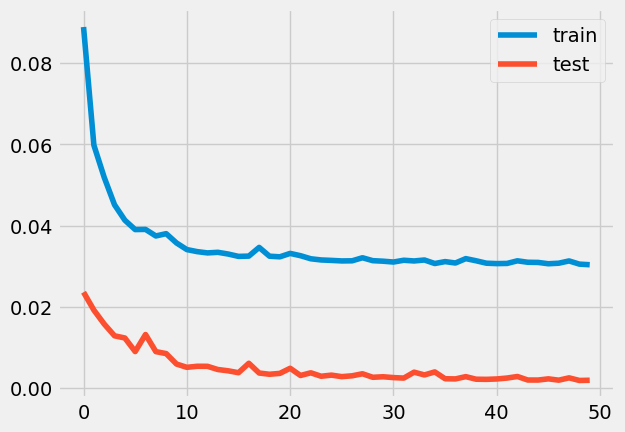

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1400 - accuracy: 0.0020 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0628 - accuracy: 0.0043 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

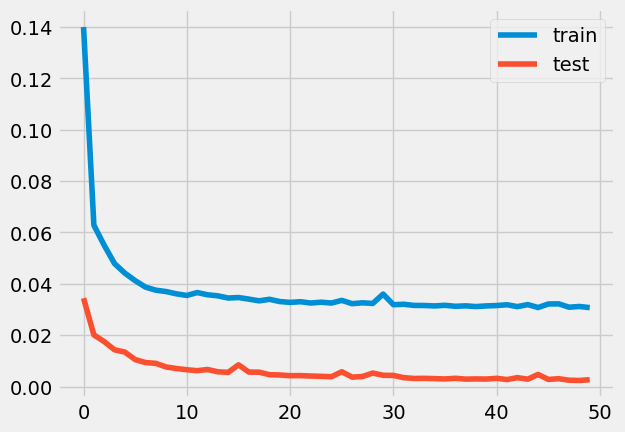

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1794 - accuracy: 0.0023 - val_loss: 0.0511 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0679 - accuracy: 0.0046 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

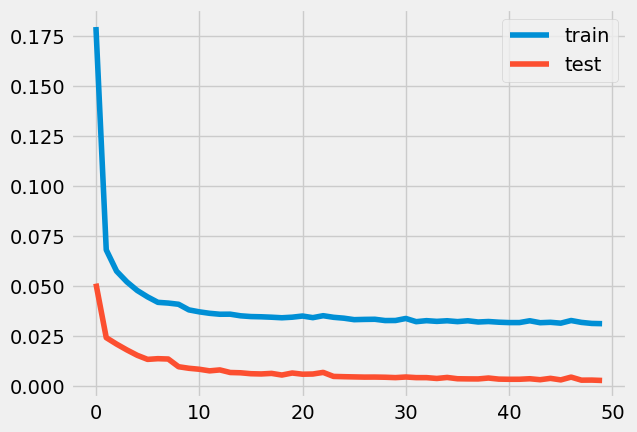

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1096 - accuracy: 0.0050 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0636 - accuracy: 0.0055 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

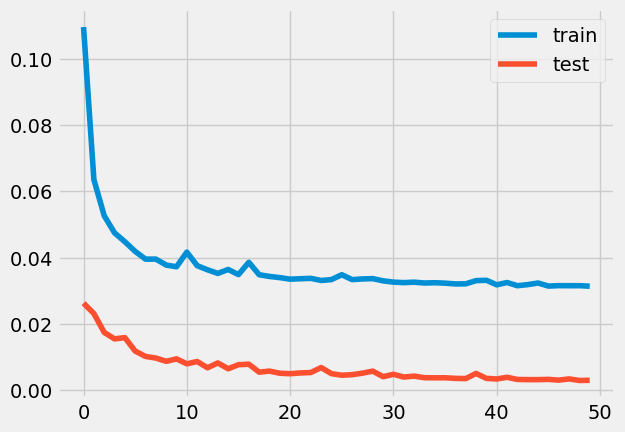

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1246 - accuracy: 0.0050 - val_loss: 0.0361 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0629 - accuracy: 0.0060 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

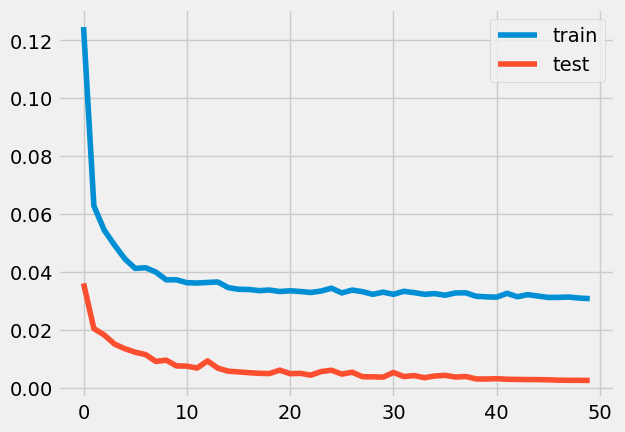

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 59ms/step - loss: 0.1267 - accuracy: 0.0027 - val_loss: 0.0316 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0626 - accuracy: 0.0061 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

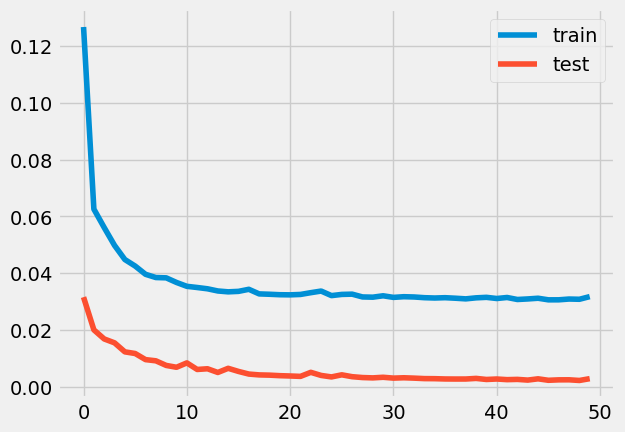

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1289 - accuracy: 0.0039 - val_loss: 0.0319 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0641 - accuracy: 0.0050 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

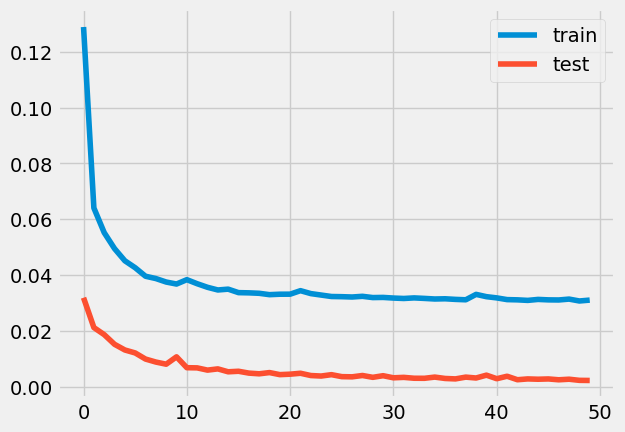

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.0897 - accuracy: 0.0029 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0616 - accuracy: 0.0051 - val_loss: 0.0192 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

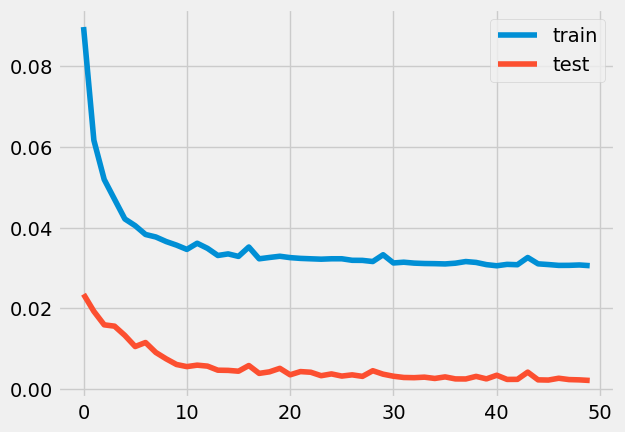

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 64ms/step - loss: 0.1132 - accuracy: 0.0037 - val_loss: 0.0277 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0635 - accuracy: 0.0047 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

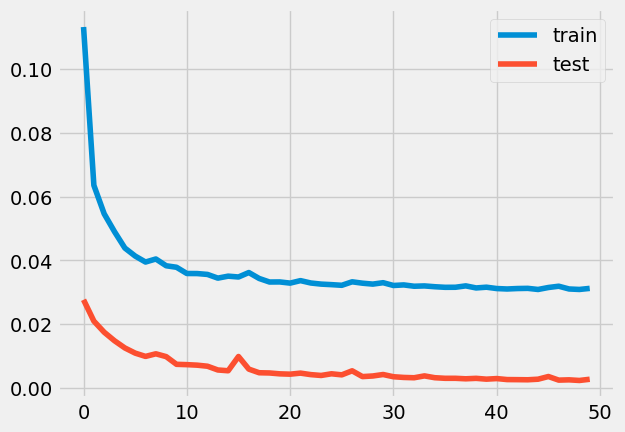

4.417056968199591e-15
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1277 - accuracy: 0.0036 - val_loss: 0.0311 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0642 - accuracy: 0.0052 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoc

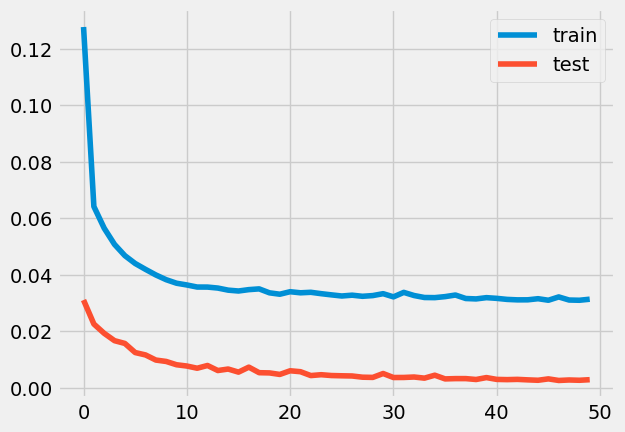

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1379 - accuracy: 0.0070 - val_loss: 0.0334 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0656 - accuracy: 0.0038 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

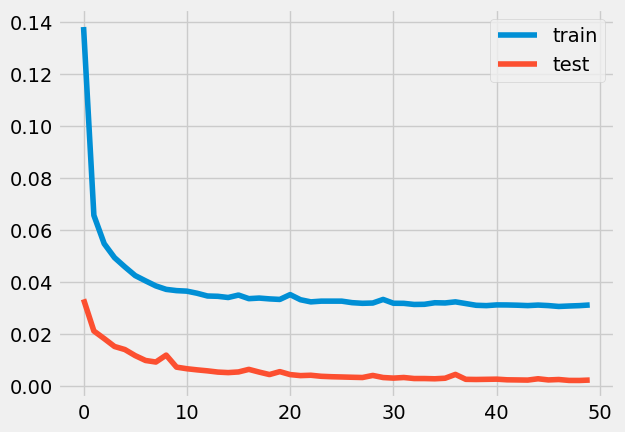

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1584 - accuracy: 0.0037 - val_loss: 0.0397 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0633 - accuracy: 0.0056 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

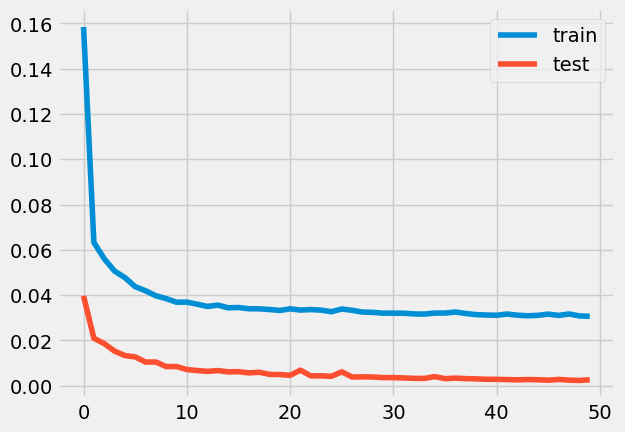

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1025 - accuracy: 0.0038 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0636 - accuracy: 0.0039 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

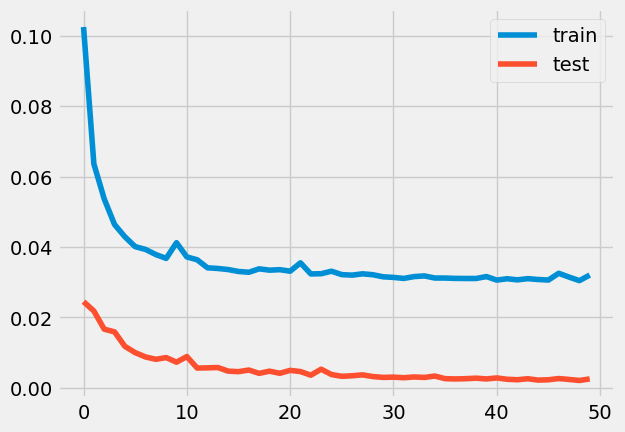

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1226 - accuracy: 0.0023 - val_loss: 0.0322 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0667 - accuracy: 0.0039 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

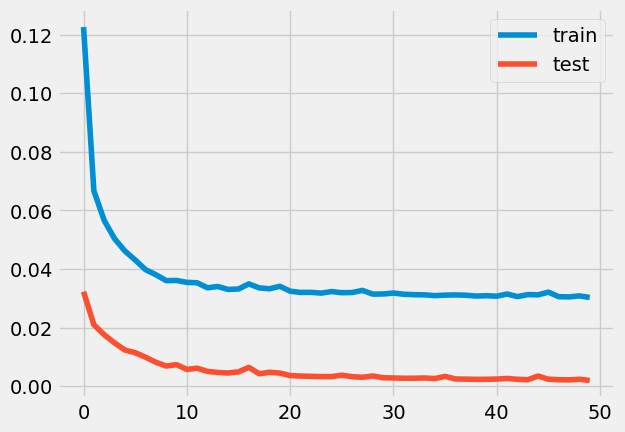

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.0924 - accuracy: 0.0012 - val_loss: 0.0253 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0602 - accuracy: 0.0052 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

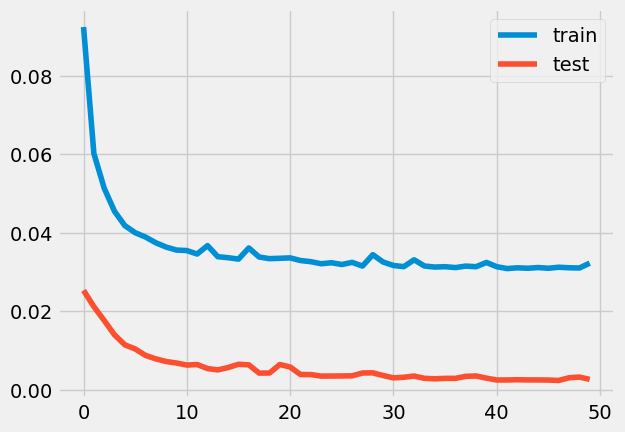

7.532352746920347e-16
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1685 - accuracy: 0.0036 - val_loss: 0.0467 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0608 - accuracy: 0.0050 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoc

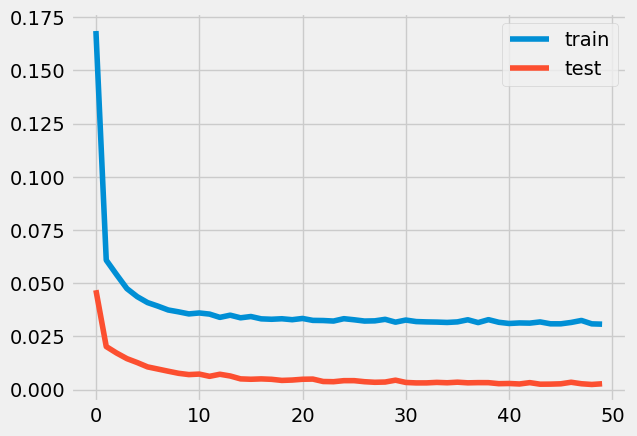

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1019 - accuracy: 0.0038 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0628 - accuracy: 0.0048 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

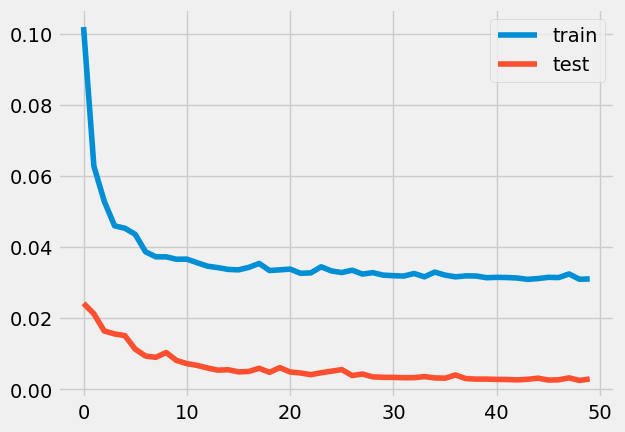

5.4376359651947915e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.0961 - accuracy: 0.0041 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0600 - accuracy: 0.0045 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epo

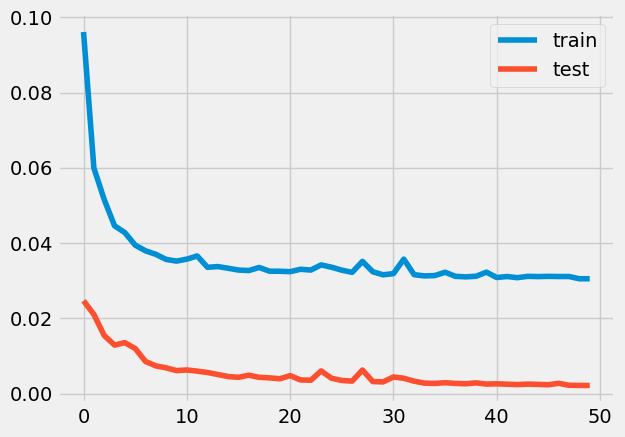

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1377 - accuracy: 0.0022 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0622 - accuracy: 0.0037 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

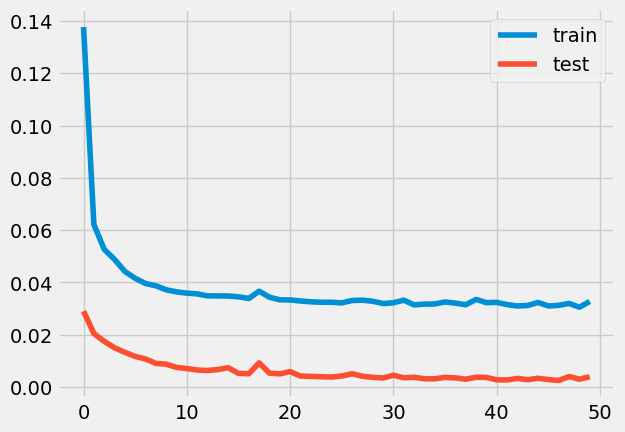

3.9056996027805786e-40
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1073 - accuracy: 0.0046 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0586 - accuracy: 0.0037 - val_loss: 0.0203 - val_accuracy: 0.0000e+00
Epo

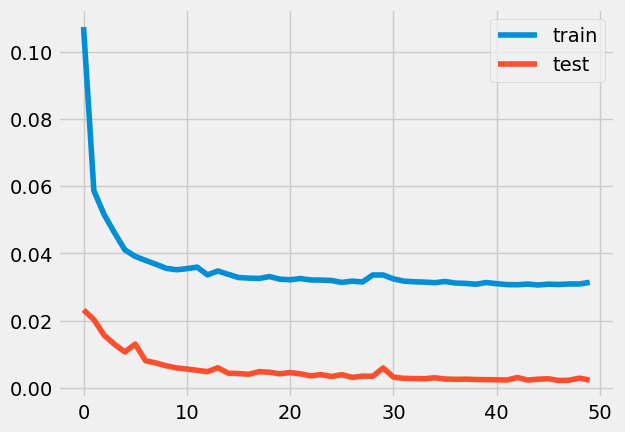

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1340 - accuracy: 0.0030 - val_loss: 0.0319 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0653 - accuracy: 0.0051 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

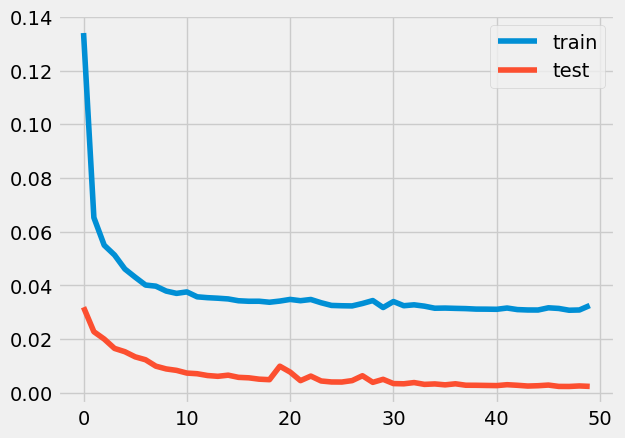

0.00032645067479367796
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1585 - accuracy: 0.0000e+00 - val_loss: 0.0335 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0635 - accuracy: 0.0058 - val_loss: 0.0222 - val_accuracy: 0.0000e+00

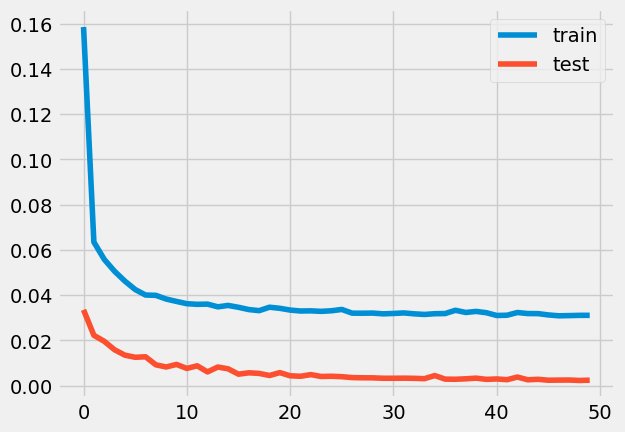

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 66ms/step - loss: 0.1235 - accuracy: 0.0041 - val_loss: 0.0298 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0630 - accuracy: 0.0043 - val_loss: 0.0197 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

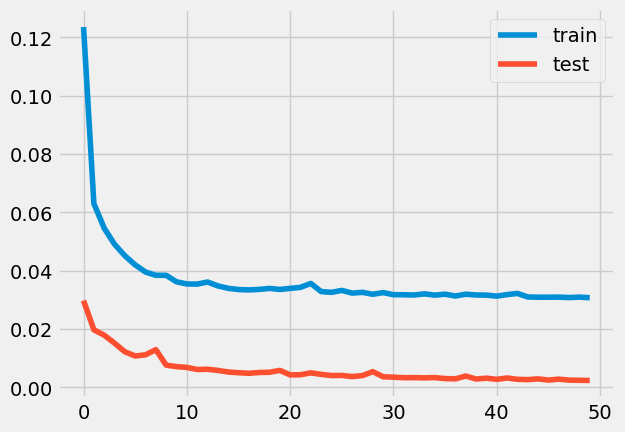

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1056 - accuracy: 1.9262e-04 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0620 - accuracy: 0.0052 - val_loss: 0.0193 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

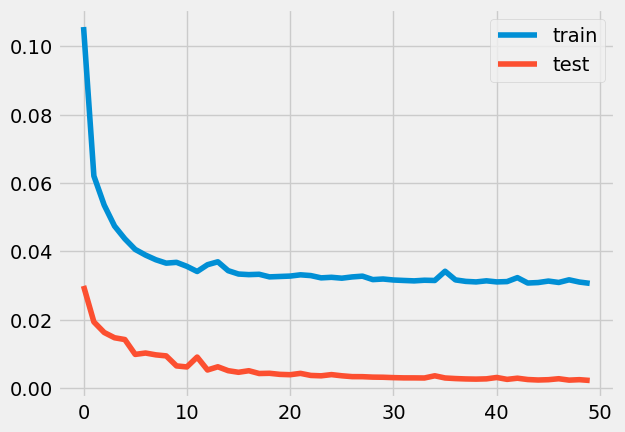

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1716 - accuracy: 0.0022 - val_loss: 0.0361 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0657 - accuracy: 0.0048 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

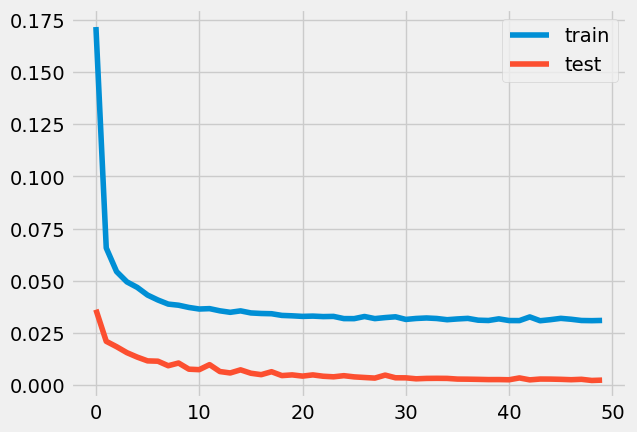

6.834299618681584e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.2042 - accuracy: 0.0047 - val_loss: 0.0502 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0638 - accuracy: 0.0044 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoc

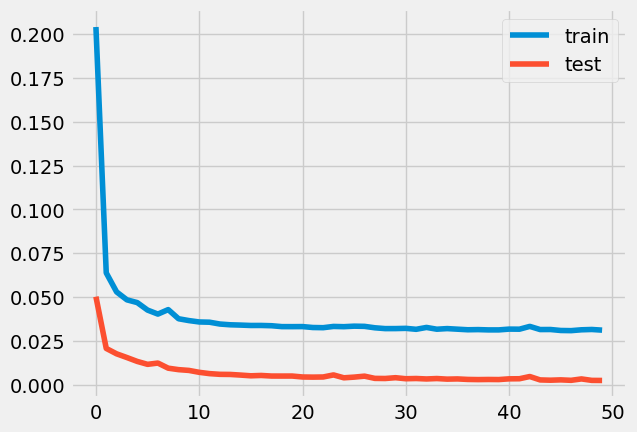

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1147 - accuracy: 0.0039 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0650 - accuracy: 0.0043 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

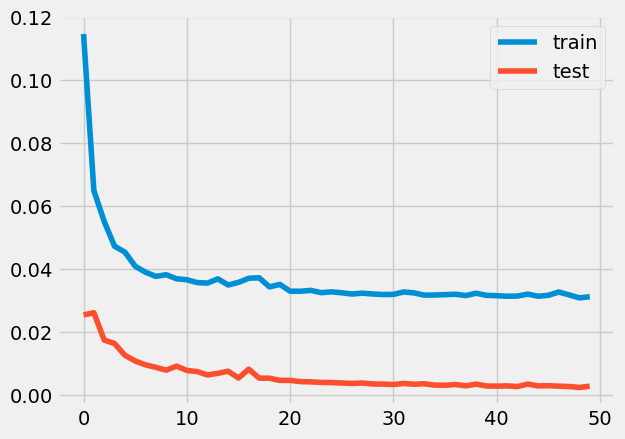

1.3918910599577535e-12
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1155 - accuracy: 0.0029 - val_loss: 0.0251 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0633 - accuracy: 0.0051 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epo

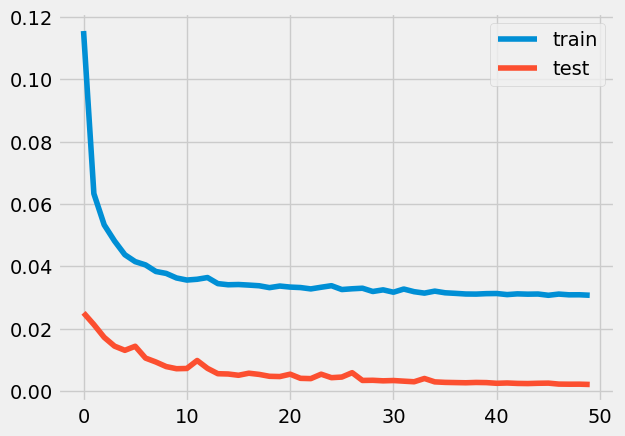

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1167 - accuracy: 0.0019 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0580 - accuracy: 0.0060 - val_loss: 0.0191 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

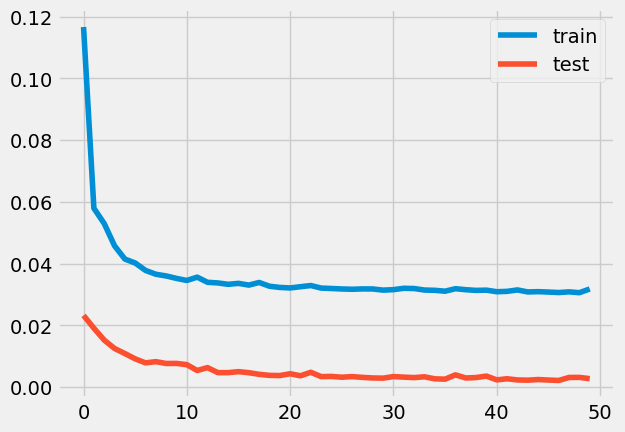

3.270162646620822e-15
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.0955 - accuracy: 0.0071 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0619 - accuracy: 0.0043 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoc

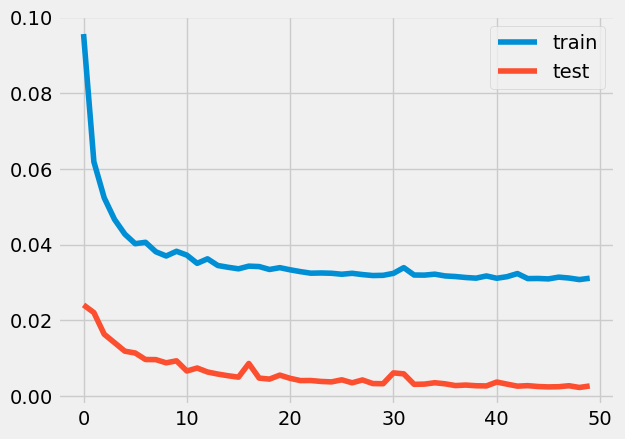

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1541 - accuracy: 0.0013 - val_loss: 0.0401 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0648 - accuracy: 0.0058 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

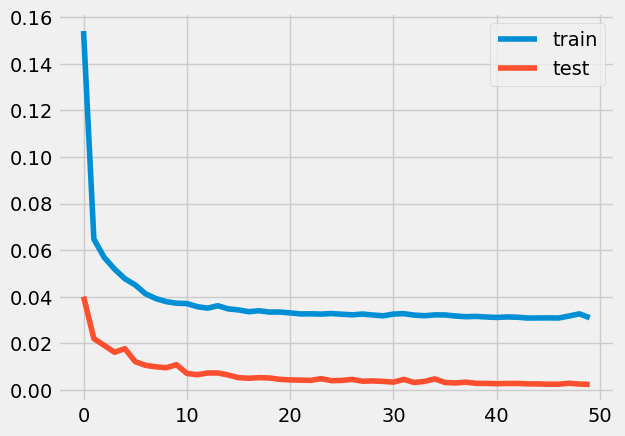

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1458 - accuracy: 0.0013 - val_loss: 0.0312 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0642 - accuracy: 0.0043 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

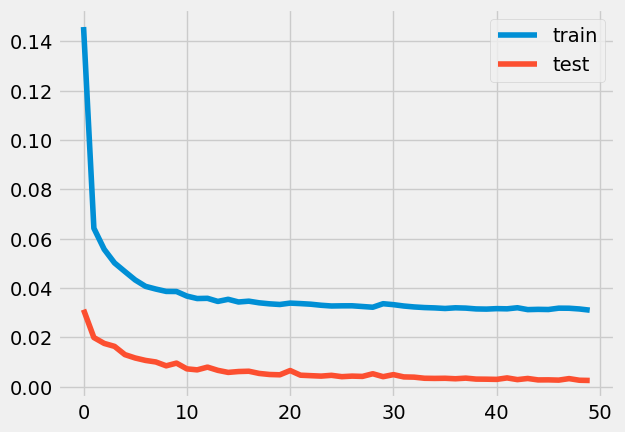

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1239 - accuracy: 0.0023 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0616 - accuracy: 0.0050 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

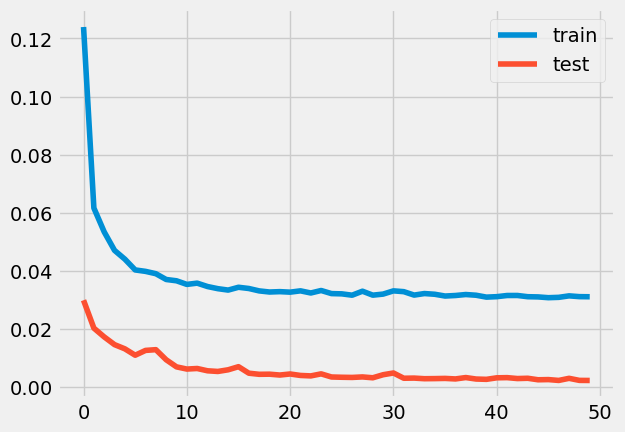

9.765625e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1403 - accuracy: 0.0050 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0632 - accuracy: 0.0050 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20

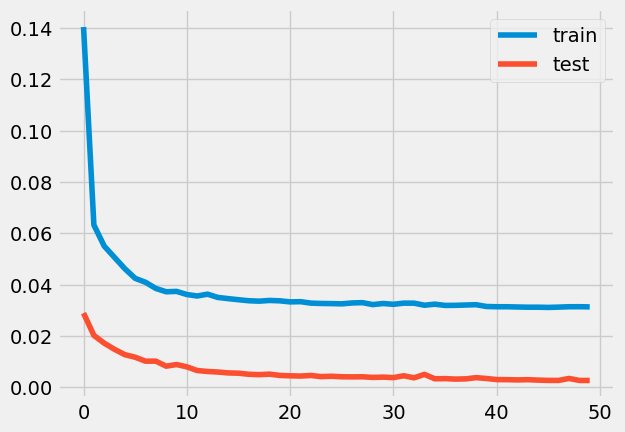

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.0911 - accuracy: 0.0064 - val_loss: 0.0244 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0620 - accuracy: 0.0049 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

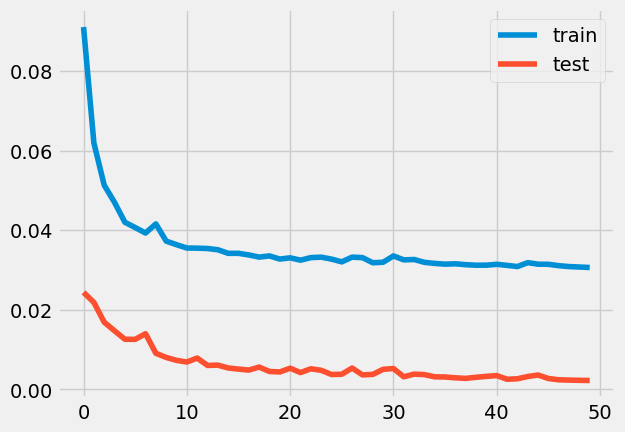

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1163 - accuracy: 0.0013 - val_loss: 0.0278 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0665 - accuracy: 0.0041 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

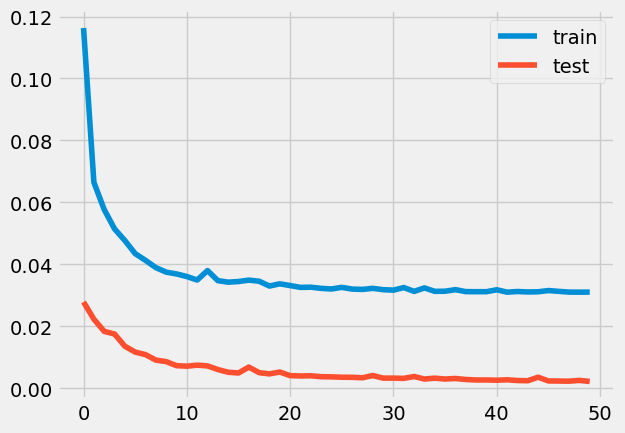

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1249 - accuracy: 0.0045 - val_loss: 0.0314 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0627 - accuracy: 0.0052 - val_loss: 0.0207 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

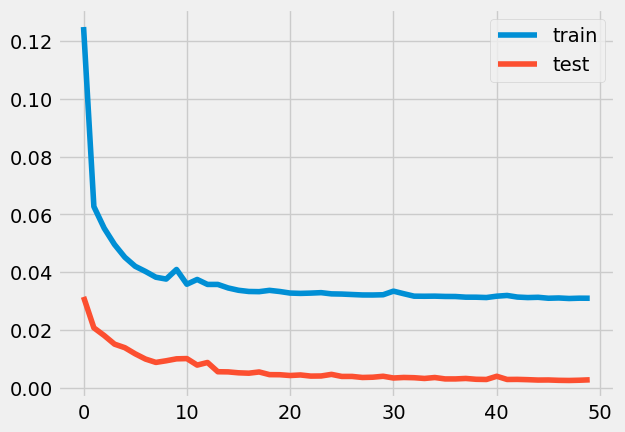

5.146752492576712e-24
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1068 - accuracy: 0.0043 - val_loss: 0.0264 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0615 - accuracy: 0.0053 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoc

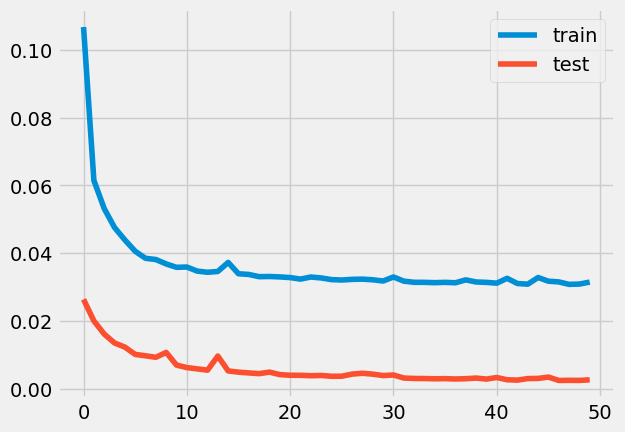

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1380 - accuracy: 0.0025 - val_loss: 0.0445 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0631 - accuracy: 0.0058 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

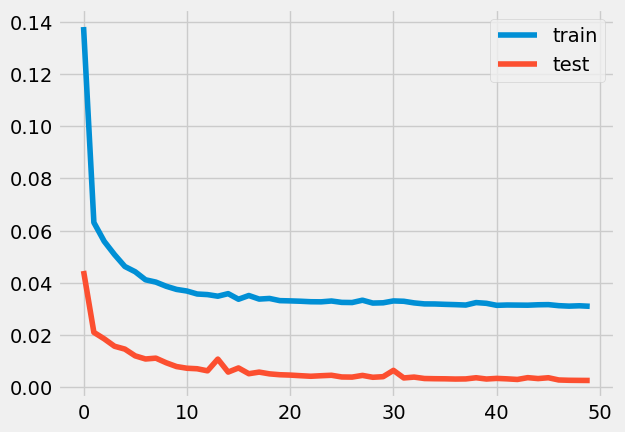

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 60ms/step - loss: 0.1519 - accuracy: 0.0038 - val_loss: 0.0417 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0637 - accuracy: 0.0060 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

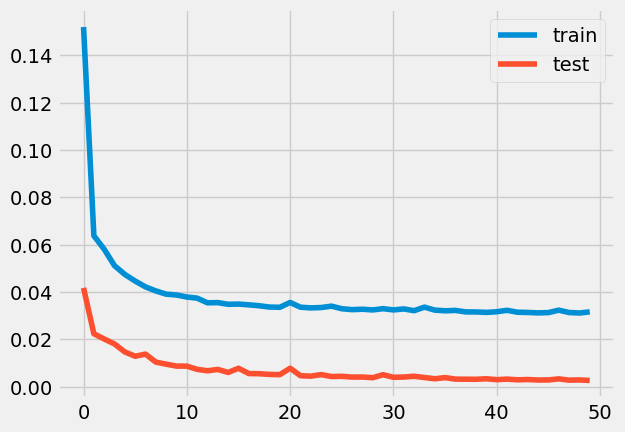

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1550 - accuracy: 0.0000e+00 - val_loss: 0.0427 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0657 - accuracy: 0.0055 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

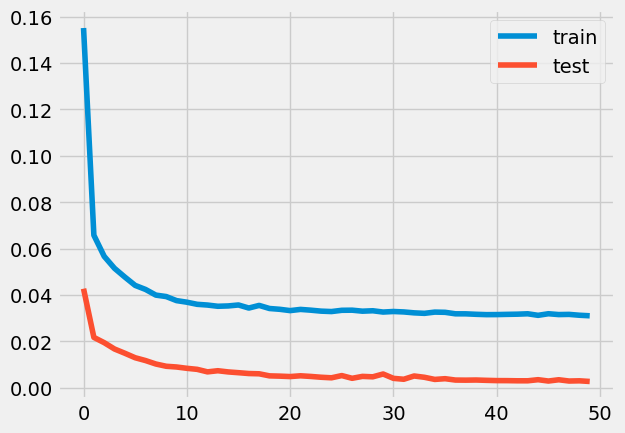

1.527342028255105e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1018 - accuracy: 0.0057 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0611 - accuracy: 0.0054 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoc

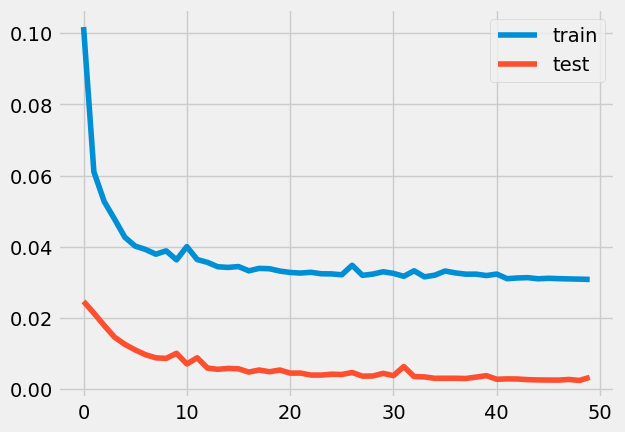

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1383 - accuracy: 1.0246e-05 - val_loss: 0.0347 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0672 - accuracy: 0.0051 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

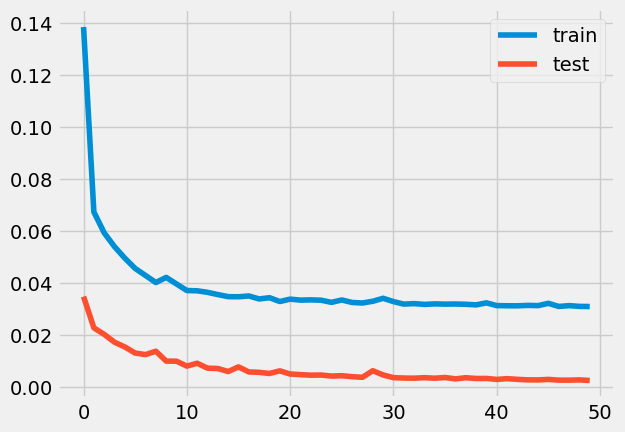

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1725 - accuracy: 0.0010 - val_loss: 0.0515 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0712 - accuracy: 0.0061 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

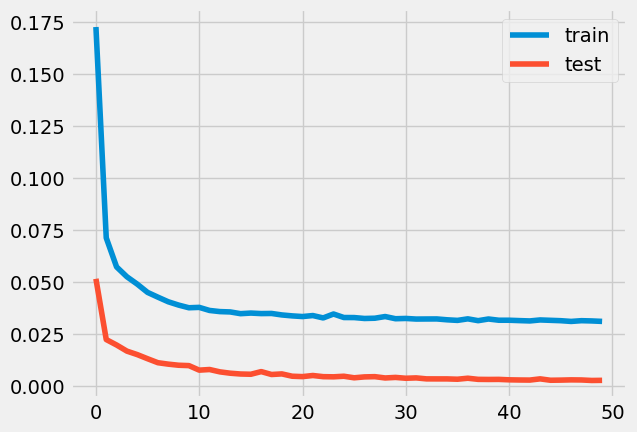

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1184 - accuracy: 0.0045 - val_loss: 0.0365 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0606 - accuracy: 0.0053 - val_loss: 0.0180 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

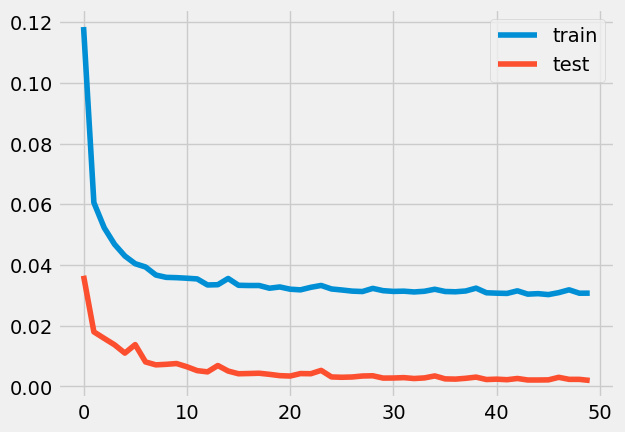

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1895 - accuracy: 0.0000e+00 - val_loss: 0.0512 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0671 - accuracy: 0.0050 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

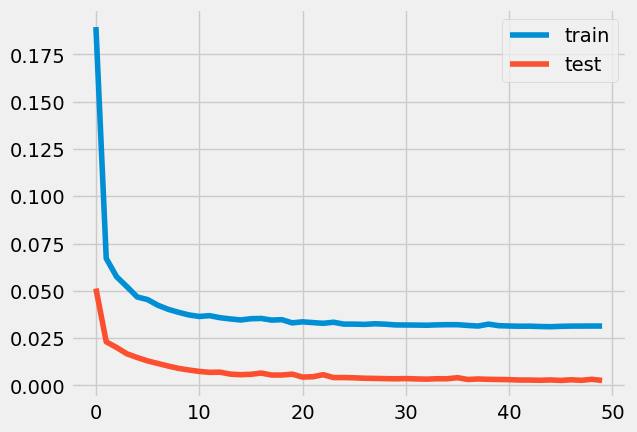

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1759 - accuracy: 0.0000e+00 - val_loss: 0.0538 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0687 - accuracy: 0.0055 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

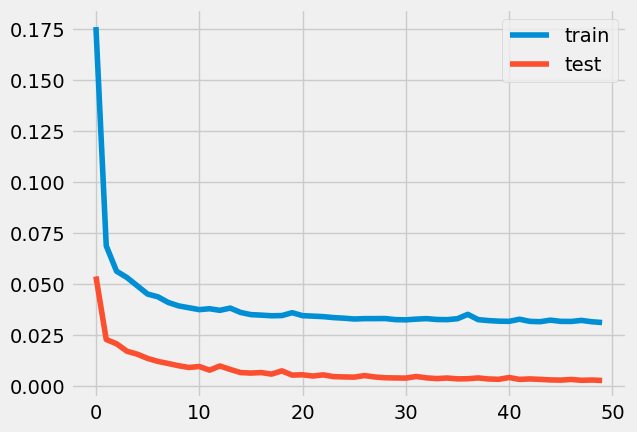

5.227131041225878e-12
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1329 - accuracy: 0.0020 - val_loss: 0.0351 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0637 - accuracy: 0.0048 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoc

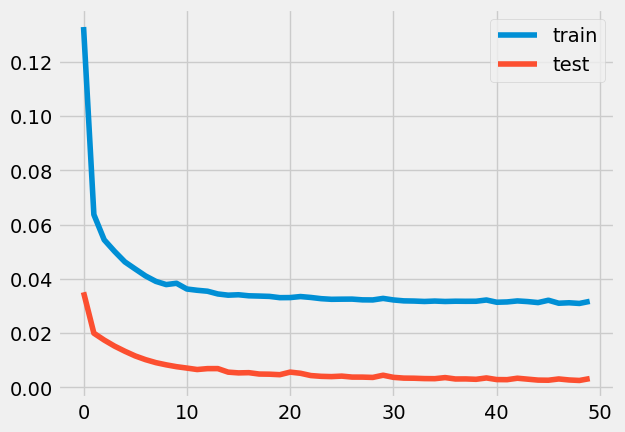

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1330 - accuracy: 0.0024 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0648 - accuracy: 0.0044 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

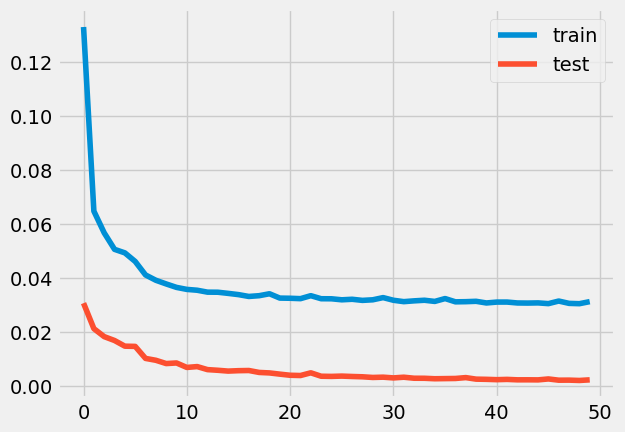

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1923 - accuracy: 0.0036 - val_loss: 0.0527 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0696 - accuracy: 0.0060 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

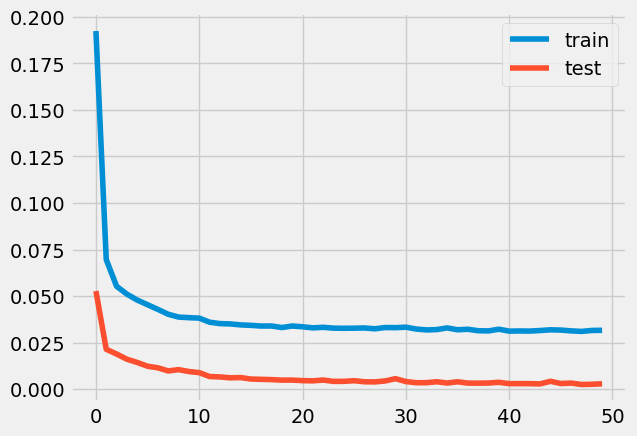

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1314 - accuracy: 0.0041 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0671 - accuracy: 0.0048 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

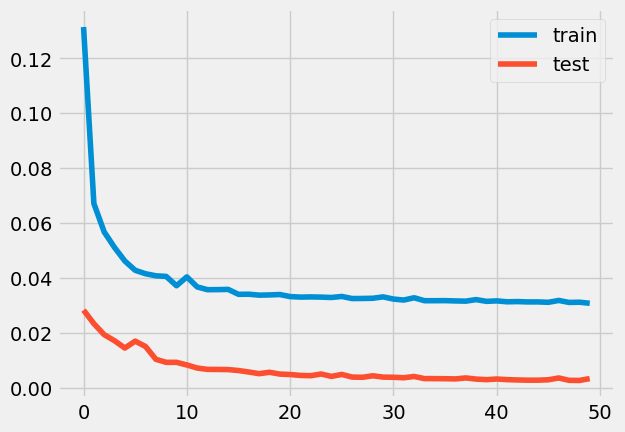

3.335859009080665e-24
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1882 - accuracy: 0.0040 - val_loss: 0.0474 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0683 - accuracy: 0.0041 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoc

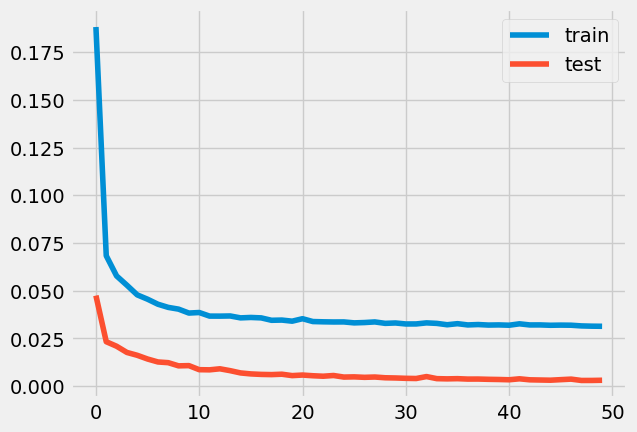

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.0821 - accuracy: 0.0053 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0569 - accuracy: 0.0062 - val_loss: 0.0179 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

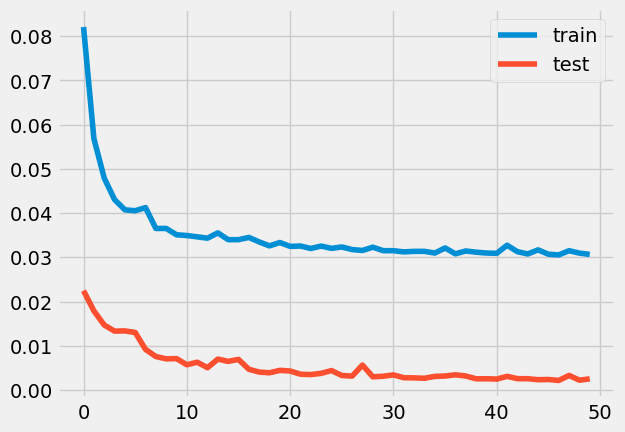

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1057 - accuracy: 0.0040 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0628 - accuracy: 0.0056 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

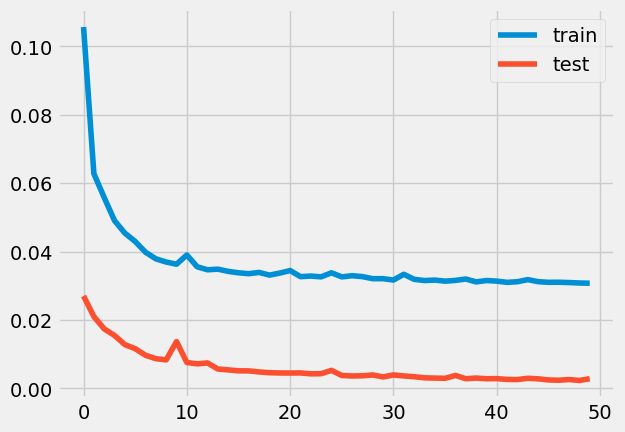

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 68ms/step - loss: 0.0895 - accuracy: 0.0056 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0629 - accuracy: 0.0044 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

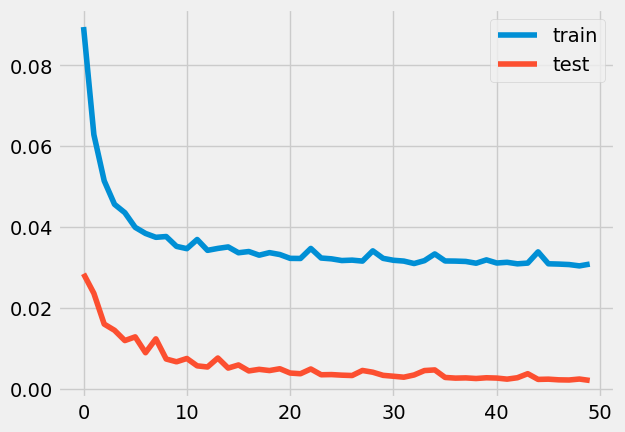

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 71ms/step - loss: 0.1301 - accuracy: 0.0041 - val_loss: 0.0309 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0588 - accuracy: 0.0051 - val_loss: 0.0182 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

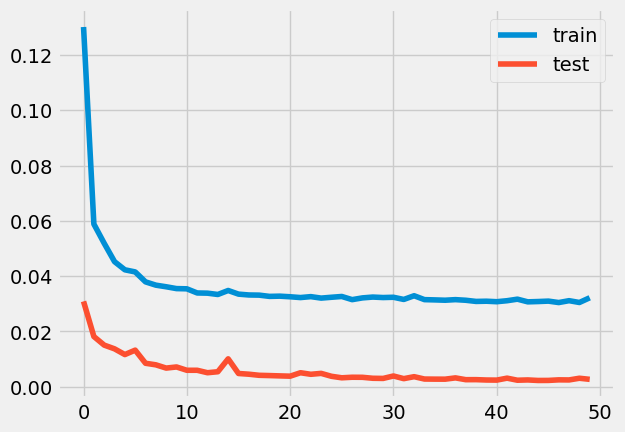

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1315 - accuracy: 0.0029 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0635 - accuracy: 0.0057 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

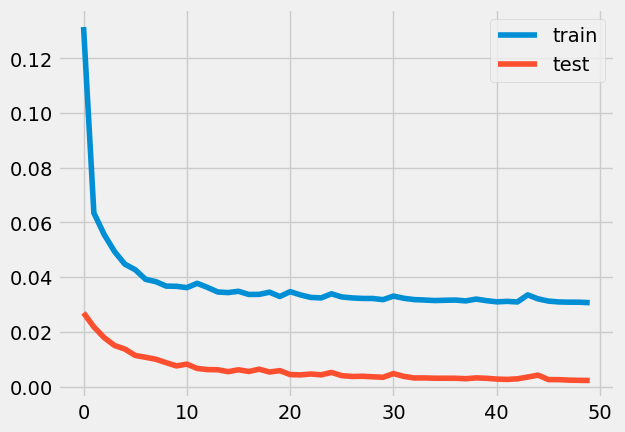

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 60ms/step - loss: 0.1287 - accuracy: 0.0046 - val_loss: 0.0271 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0655 - accuracy: 0.0038 - val_loss: 0.0225 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

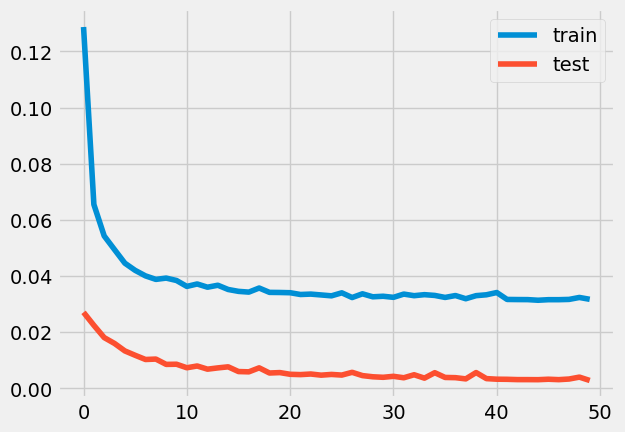

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.0866 - accuracy: 0.0056 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0582 - accuracy: 0.0057 - val_loss: 0.0194 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

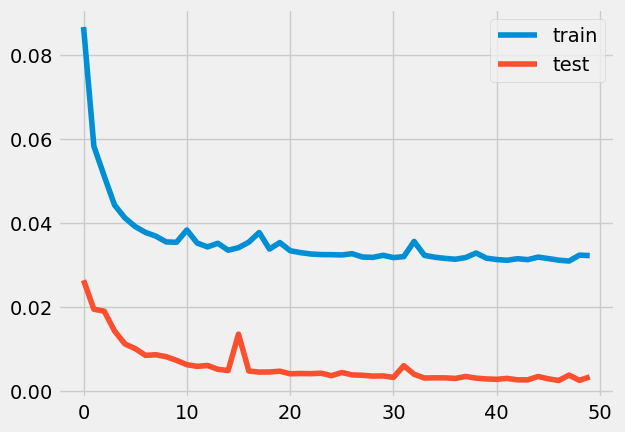

1.1610566008378423e-20
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1390 - accuracy: 0.0047 - val_loss: 0.0323 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0628 - accuracy: 0.0047 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epo

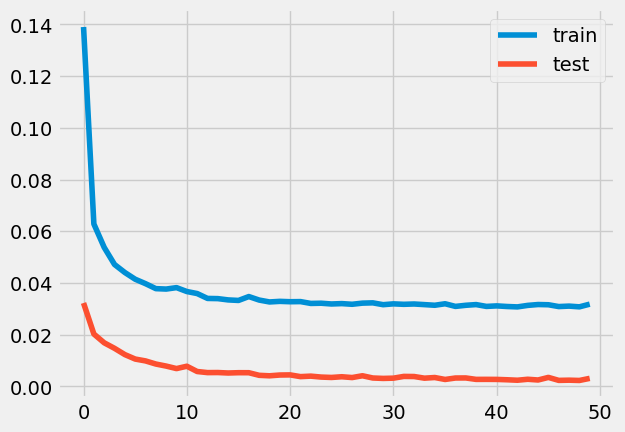

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 59ms/step - loss: 0.1301 - accuracy: 0.0014 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0592 - accuracy: 0.0040 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

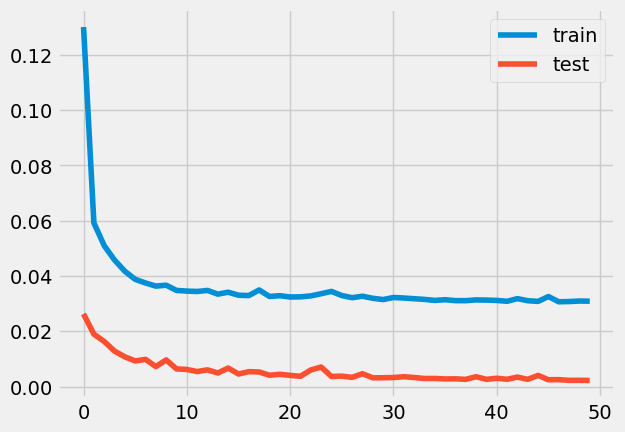

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1082 - accuracy: 0.0050 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0619 - accuracy: 0.0050 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

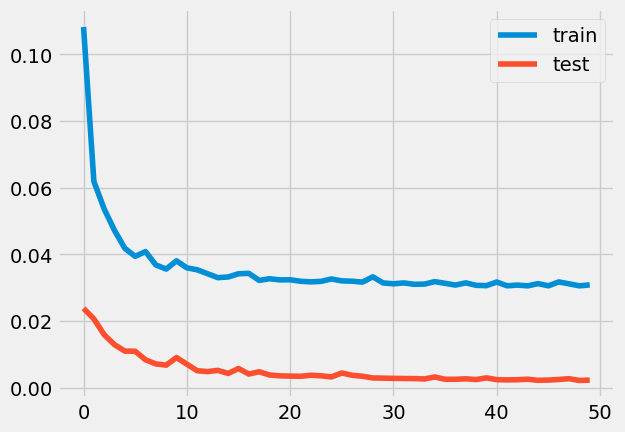

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1121 - accuracy: 0.0032 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0615 - accuracy: 0.0047 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

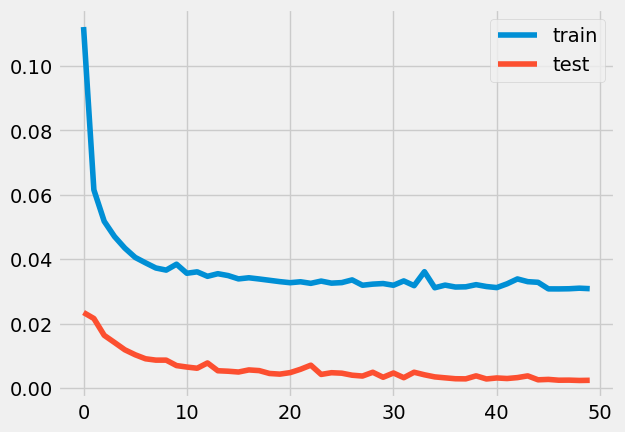

7.301743910457254e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1372 - accuracy: 0.0052 - val_loss: 0.0348 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0624 - accuracy: 0.0055 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoc

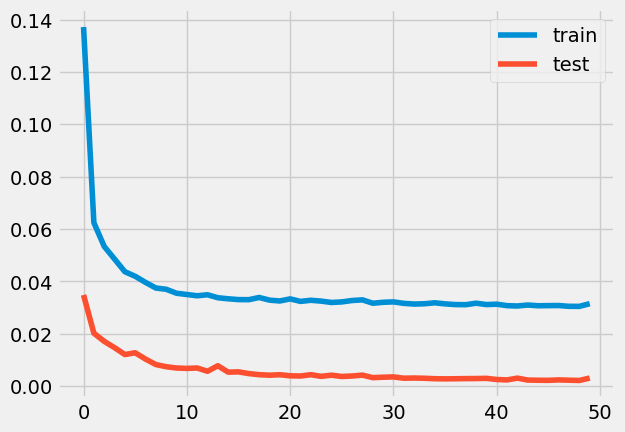

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1252 - accuracy: 0.0035 - val_loss: 0.0269 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0626 - accuracy: 0.0049 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

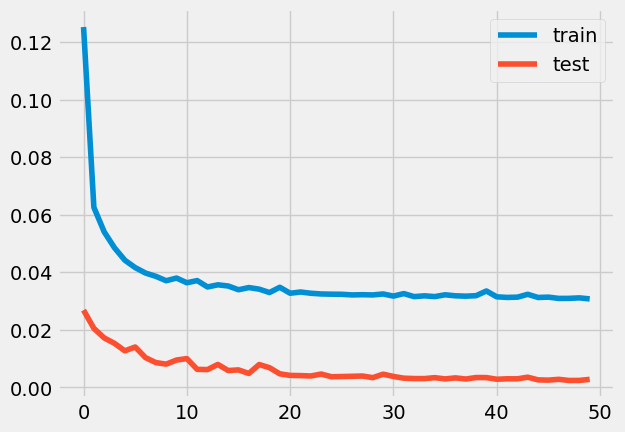

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.0991 - accuracy: 0.0062 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0633 - accuracy: 0.0052 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

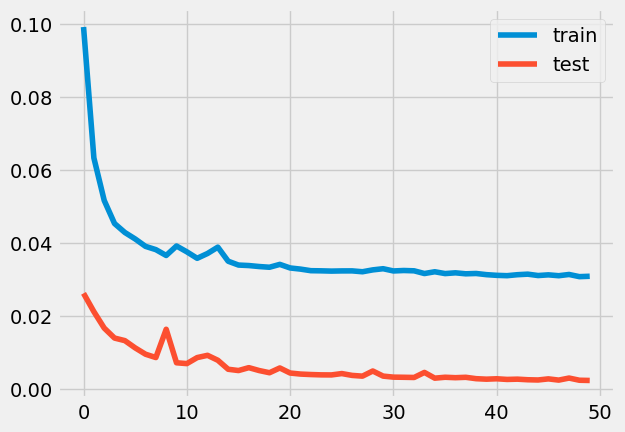

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1101 - accuracy: 0.0044 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0642 - accuracy: 0.0056 - val_loss: 0.0230 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

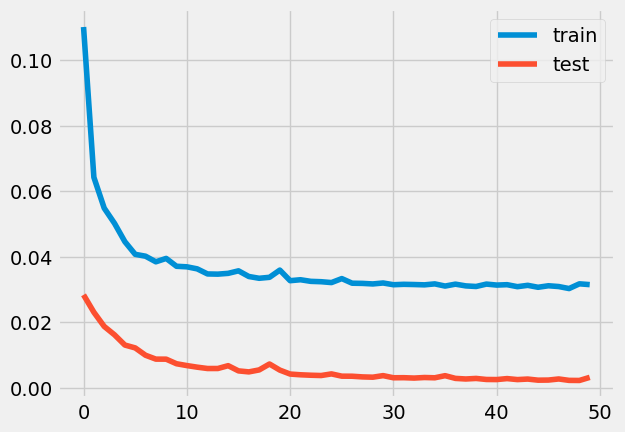

9.430860980959501e-35
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 71ms/step - loss: 0.1041 - accuracy: 0.0044 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0605 - accuracy: 0.0052 - val_loss: 0.0189 - val_accuracy: 0.0000e+00
Epoc

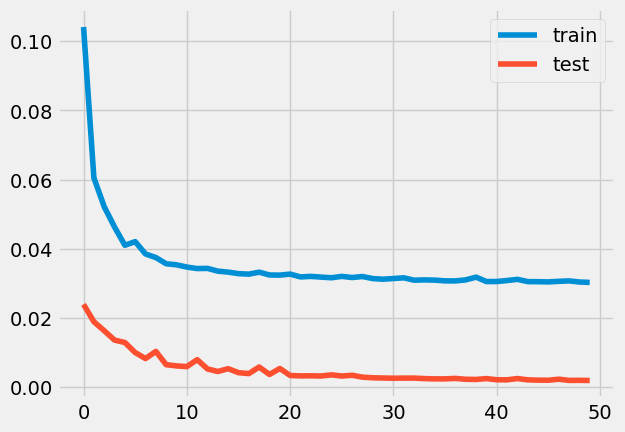

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1873 - accuracy: 0.0024 - val_loss: 0.0440 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0657 - accuracy: 0.0046 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

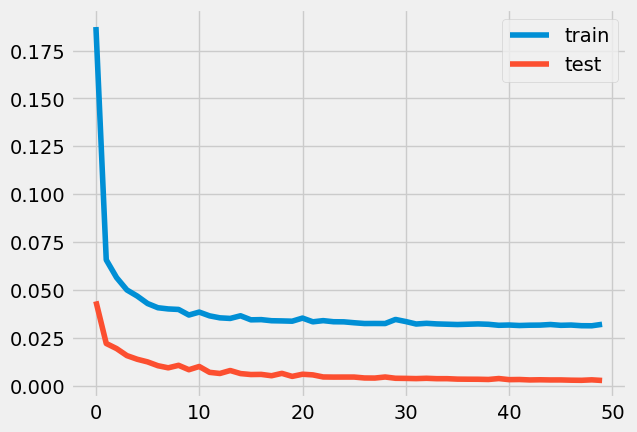

4.2644266673384484e-33
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1935 - accuracy: 0.0018 - val_loss: 0.0458 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0656 - accuracy: 0.0041 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epo

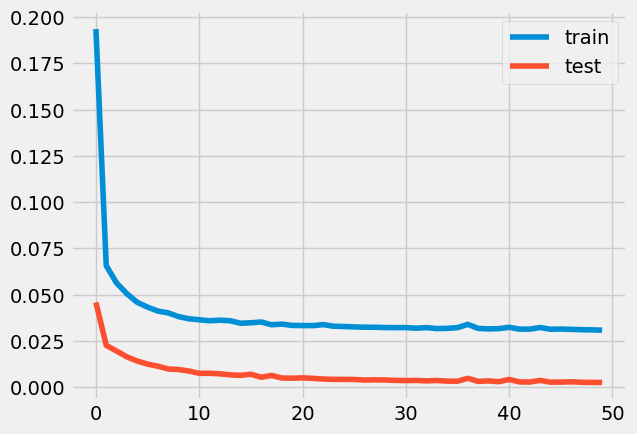

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1072 - accuracy: 0.0040 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0661 - accuracy: 0.0041 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

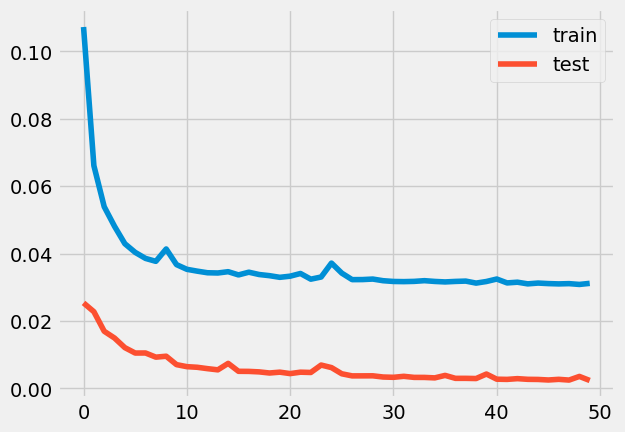

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 69ms/step - loss: 0.0982 - accuracy: 0.0063 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0606 - accuracy: 0.0054 - val_loss: 0.0191 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

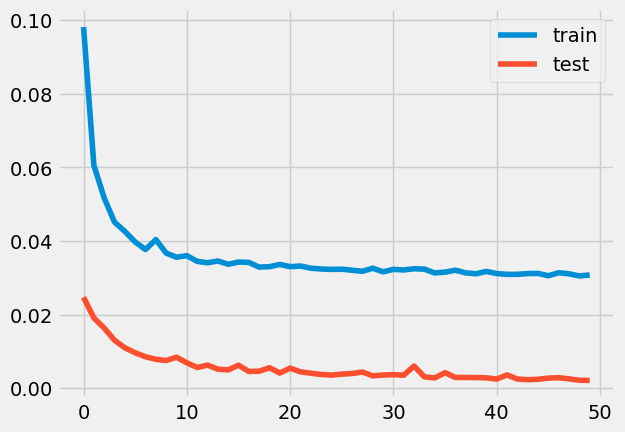

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1015 - accuracy: 0.0054 - val_loss: 0.0259 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0605 - accuracy: 0.0038 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

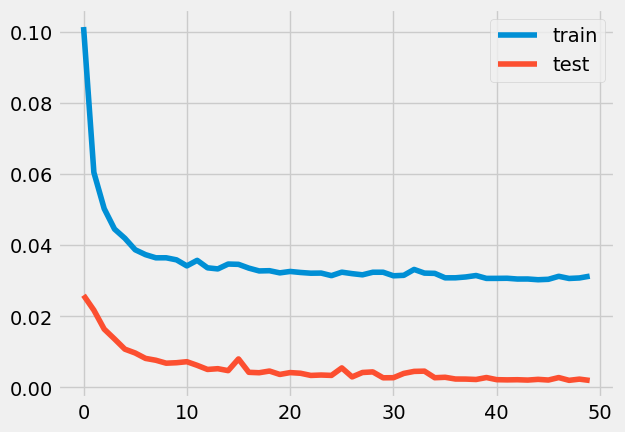

4.8828125e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1222 - accuracy: 0.0062 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0585 - accuracy: 0.0047 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epoch 3/50
2

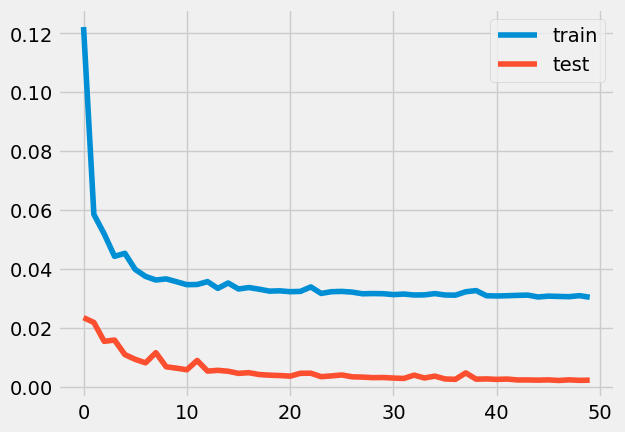

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1082 - accuracy: 0.0043 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0619 - accuracy: 0.0047 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

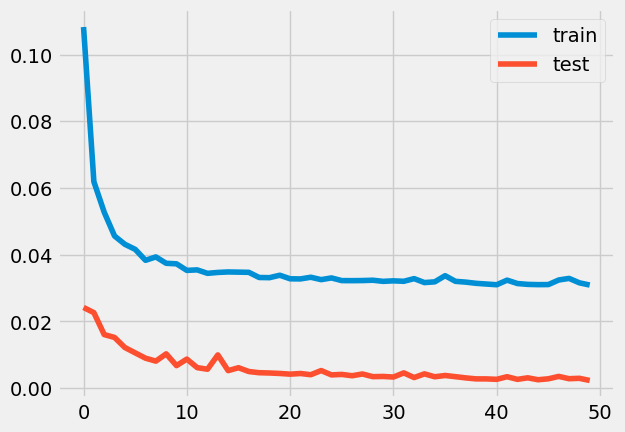

1.2399242011832769e-14
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 67ms/step - loss: 0.1909 - accuracy: 0.0000e+00 - val_loss: 0.0334 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0625 - accuracy: 0.0049 - val_loss: 0.0218 - val_accuracy: 0.0000e+00

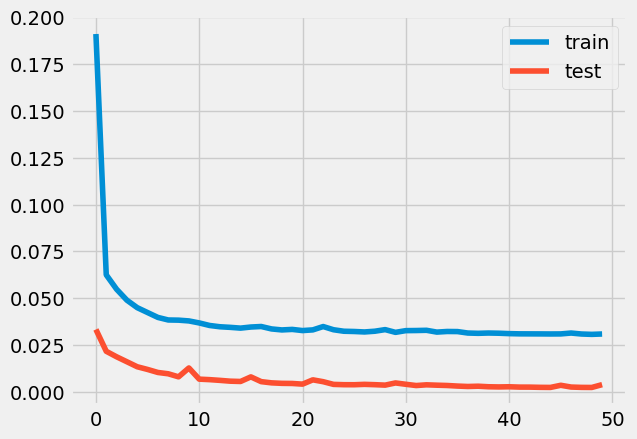

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1400 - accuracy: 0.0053 - val_loss: 0.0276 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0602 - accuracy: 0.0057 - val_loss: 0.0189 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

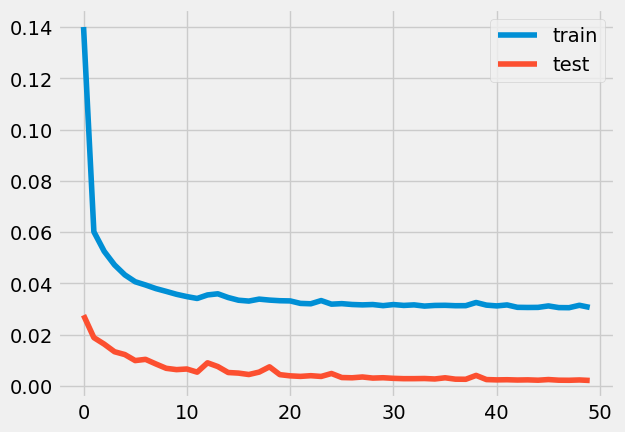

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1146 - accuracy: 9.6311e-05 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0583 - accuracy: 0.0061 - val_loss: 0.0185 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

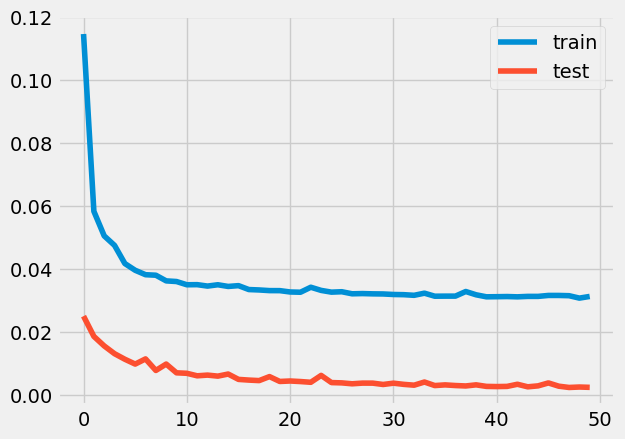

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 60ms/step - loss: 0.1114 - accuracy: 0.0016 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0618 - accuracy: 0.0055 - val_loss: 0.0202 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

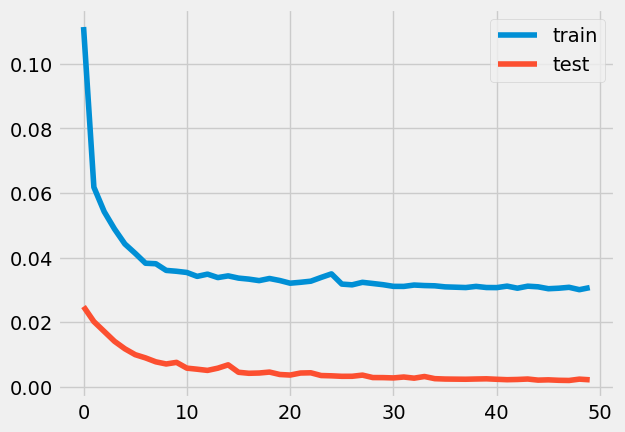

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1162 - accuracy: 0.0043 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0601 - accuracy: 0.0054 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

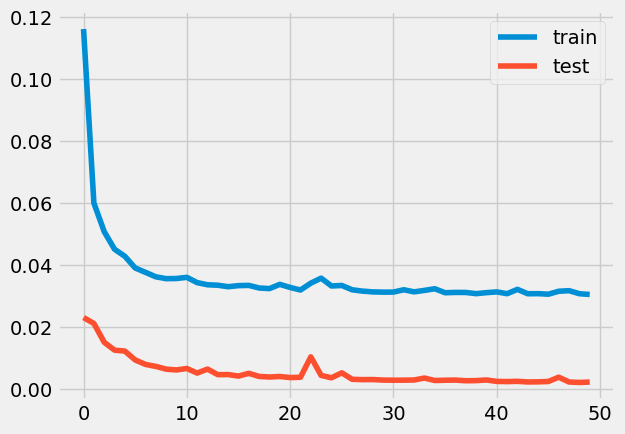

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1076 - accuracy: 0.0061 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0630 - accuracy: 0.0050 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

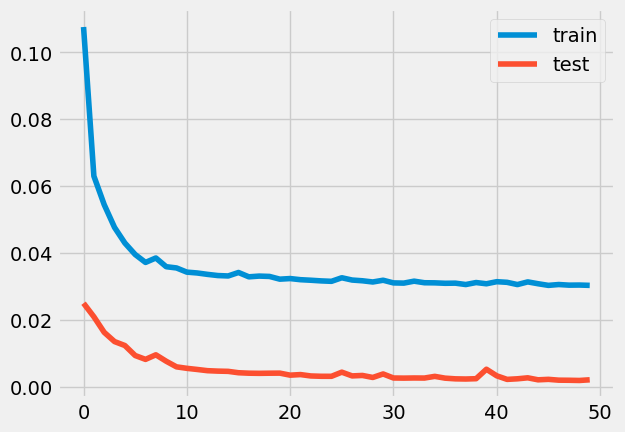

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1016 - accuracy: 0.0037 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0601 - accuracy: 0.0047 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

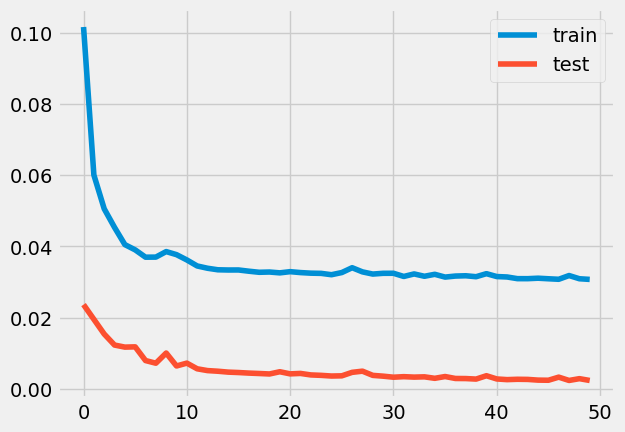

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1624 - accuracy: 0.0069 - val_loss: 0.0323 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0628 - accuracy: 0.0042 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

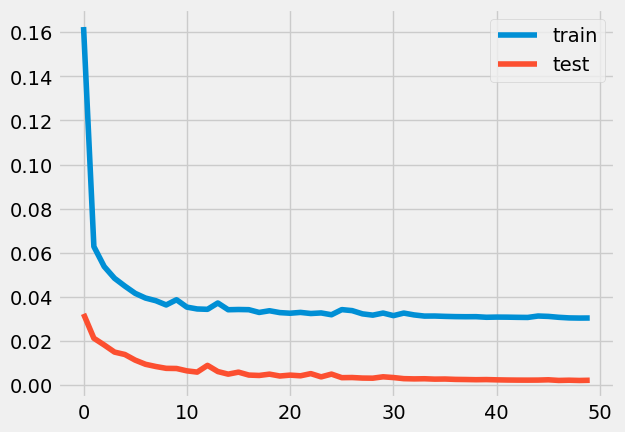

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 71ms/step - loss: 0.0946 - accuracy: 0.0056 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0623 - accuracy: 0.0046 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

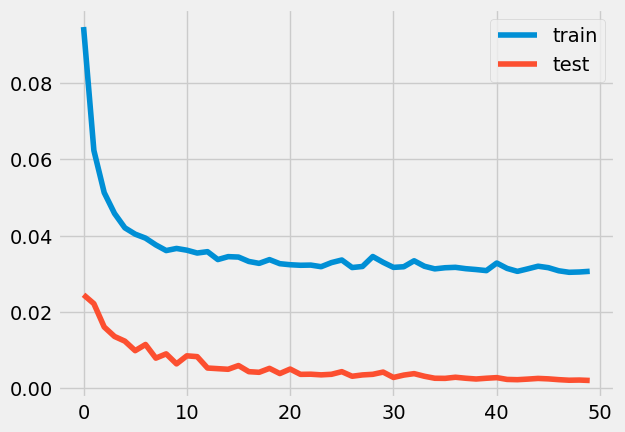

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1464 - accuracy: 0.0070 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0651 - accuracy: 0.0037 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

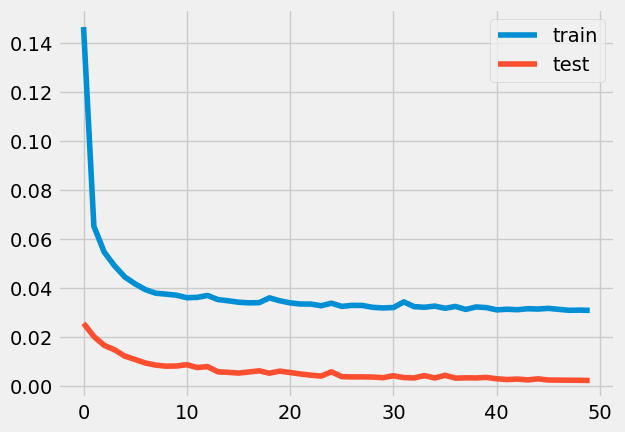

3.2673887301860305e-10
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1504 - accuracy: 0.0048 - val_loss: 0.0264 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0623 - accuracy: 0.0051 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epo

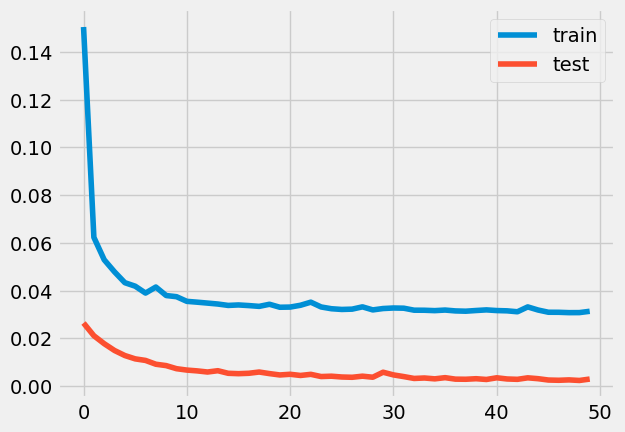

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1081 - accuracy: 0.0021 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0620 - accuracy: 0.0052 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

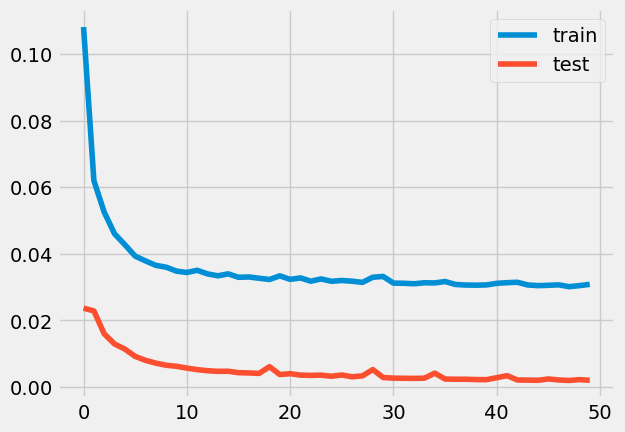

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1873 - accuracy: 0.0051 - val_loss: 0.0503 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0668 - accuracy: 0.0051 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

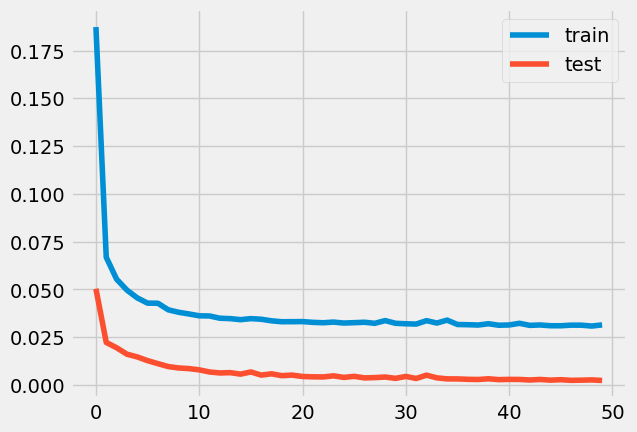

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1211 - accuracy: 0.0025 - val_loss: 0.0292 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0640 - accuracy: 0.0050 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

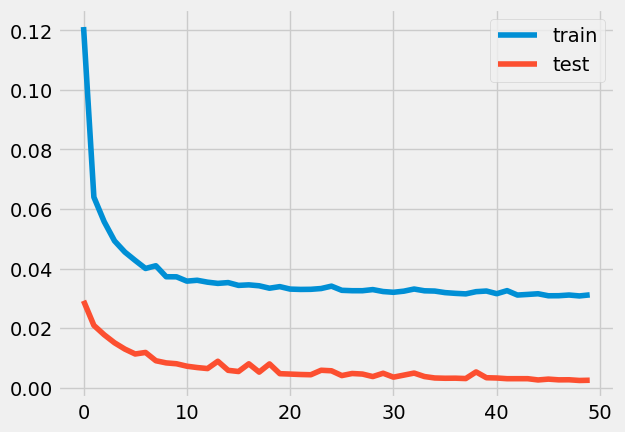

2.5563522396970537e-19
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.0988 - accuracy: 0.0051 - val_loss: 0.0235 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0604 - accuracy: 0.0058 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epo

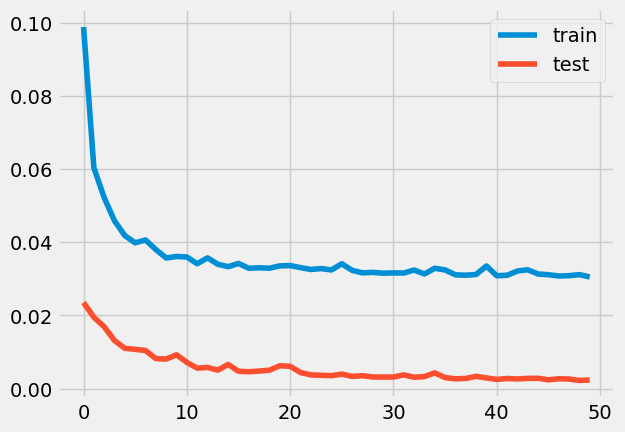

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1262 - accuracy: 0.0052 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0598 - accuracy: 0.0061 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

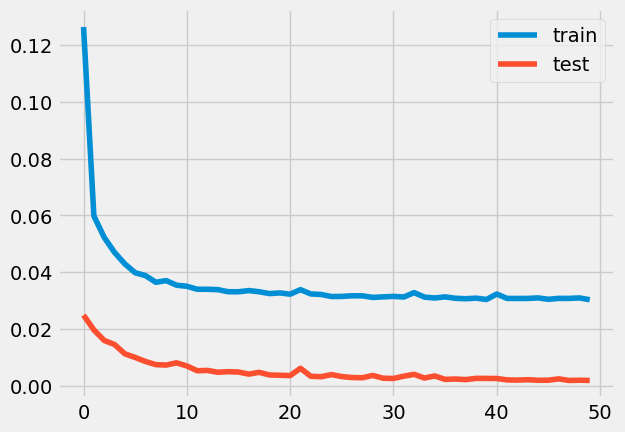

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1385 - accuracy: 0.0048 - val_loss: 0.0265 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0625 - accuracy: 0.0061 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

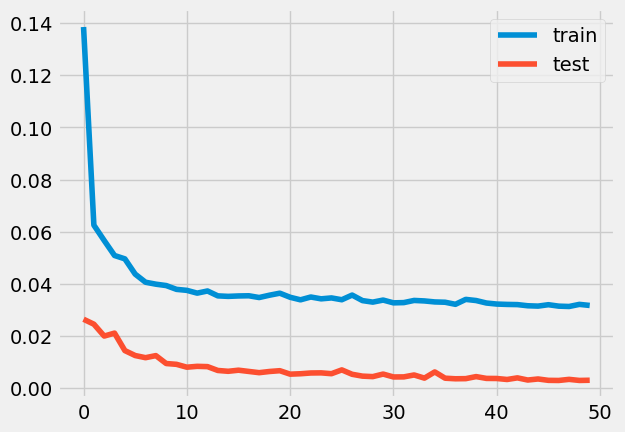

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 71ms/step - loss: 0.1121 - accuracy: 0.0048 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0596 - accuracy: 0.0051 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

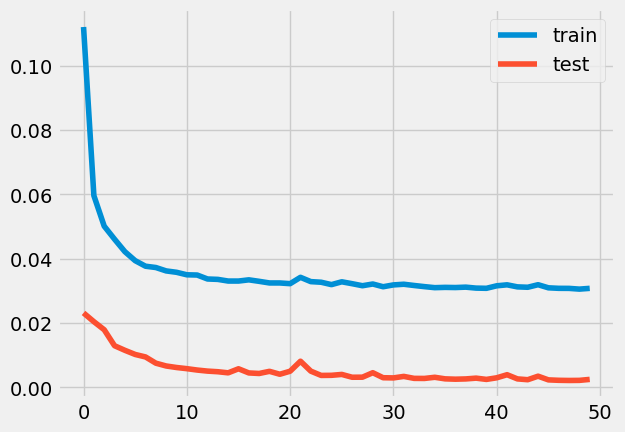

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 64ms/step - loss: 0.1579 - accuracy: 0.0050 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0575 - accuracy: 0.0057 - val_loss: 0.0176 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

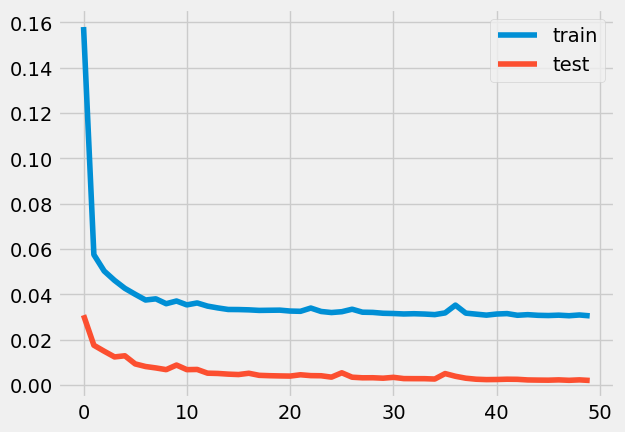

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1160 - accuracy: 0.0014 - val_loss: 0.0229 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0595 - accuracy: 0.0059 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

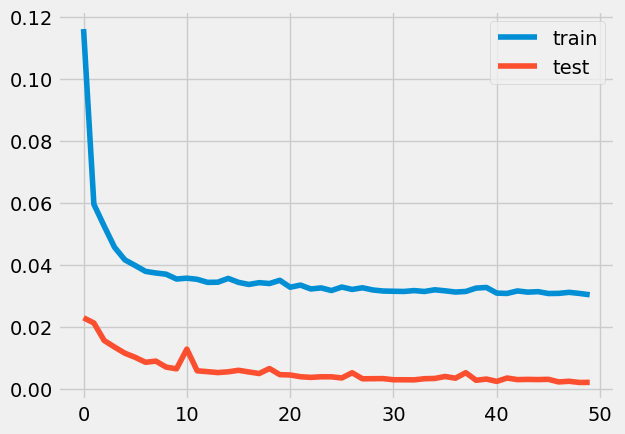

2.3273475572365854e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.0868 - accuracy: 0.0030 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0592 - accuracy: 0.0056 - val_loss: 0.0180 - val_accuracy: 0.0000e+00
Epo

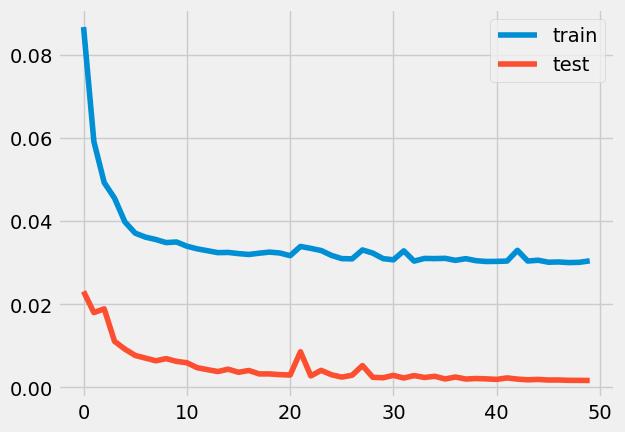

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1135 - accuracy: 0.0021 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0645 - accuracy: 0.0038 - val_loss: 0.0208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

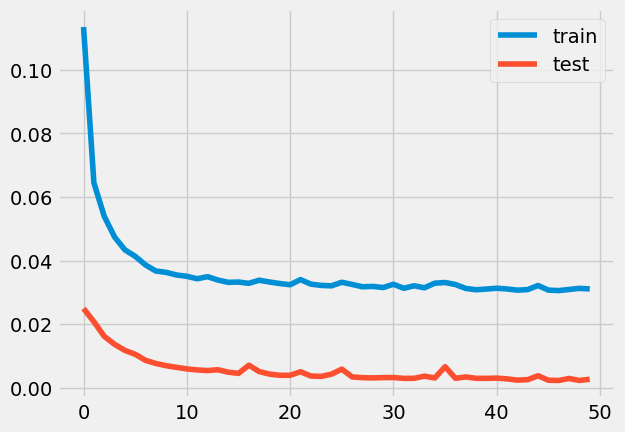

4.6436444141796825e-92
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 67ms/step - loss: 0.1521 - accuracy: 0.0019 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0597 - accuracy: 0.0035 - val_loss: 0.0185 - val_accuracy: 0.0000e+00
Epo

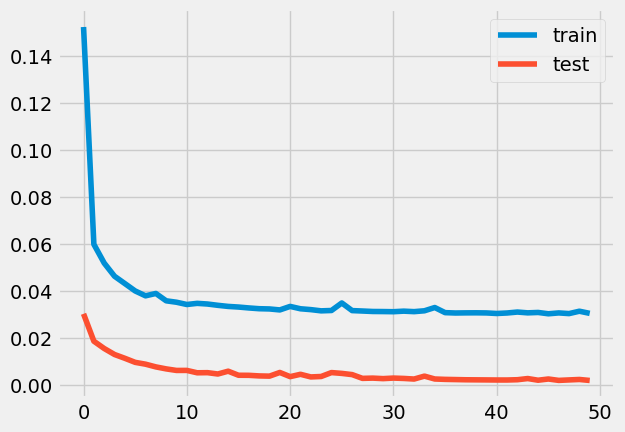

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1428 - accuracy: 0.0026 - val_loss: 0.0304 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0609 - accuracy: 0.0051 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

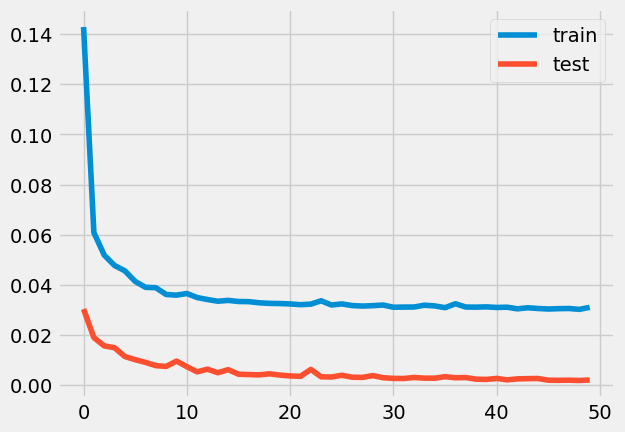

1.1590954375713378e-25
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1126 - accuracy: 0.0020 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0624 - accuracy: 0.0050 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epo

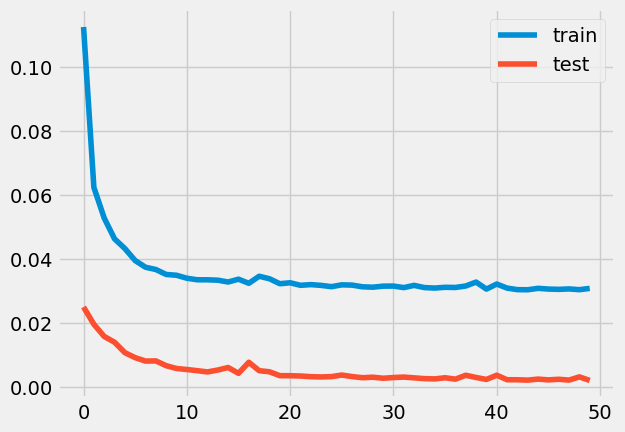

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1302 - accuracy: 0.0043 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0595 - accuracy: 0.0055 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

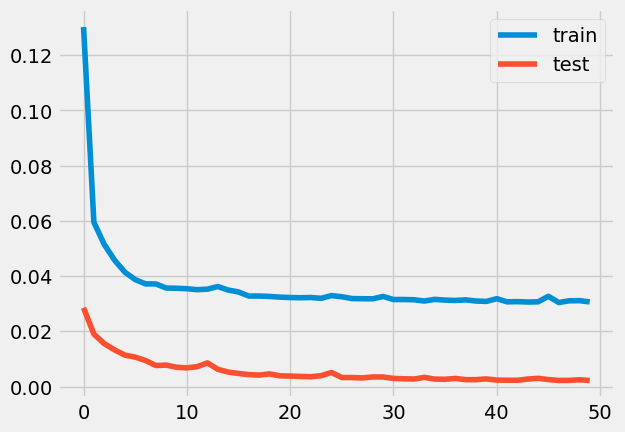

6.631617136592064e-26
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1300 - accuracy: 0.0049 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0605 - accuracy: 0.0049 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoc

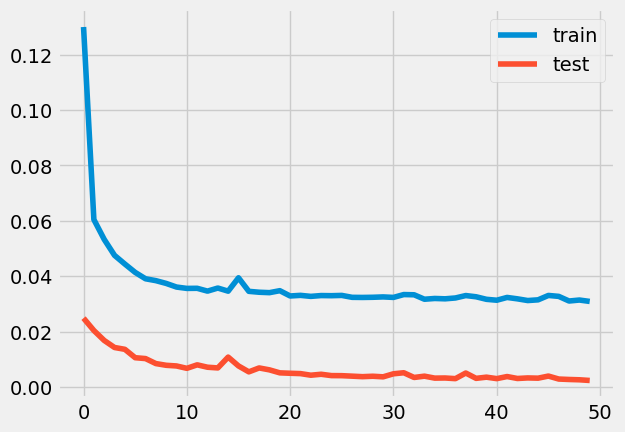

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1280 - accuracy: 0.0061 - val_loss: 0.0228 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0627 - accuracy: 0.0026 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

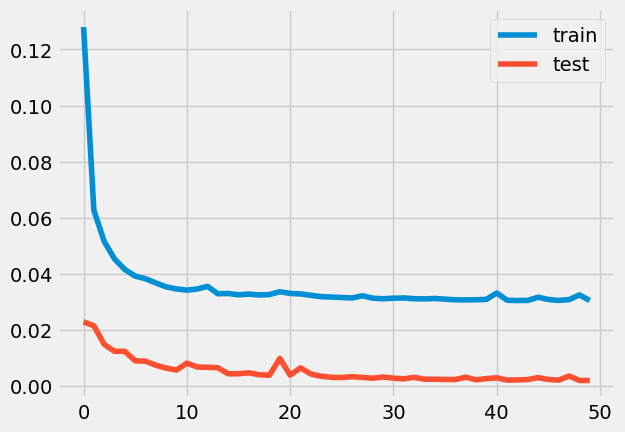

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1058 - accuracy: 0.0025 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0602 - accuracy: 0.0066 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

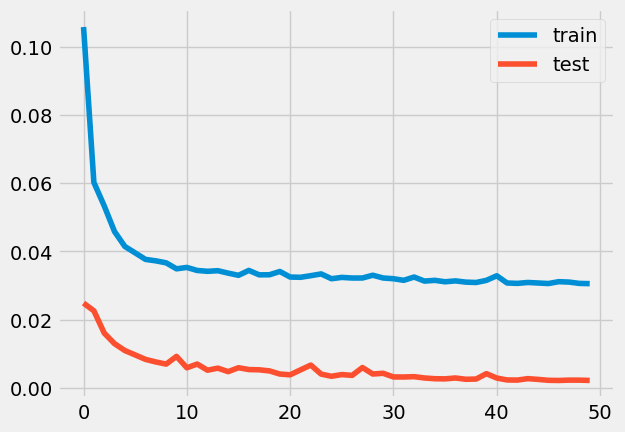

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1102 - accuracy: 0.0044 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0608 - accuracy: 0.0050 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

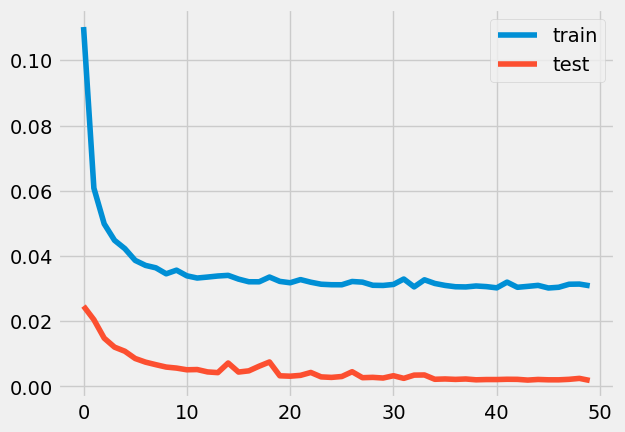

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1212 - accuracy: 0.0040 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0598 - accuracy: 0.0056 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

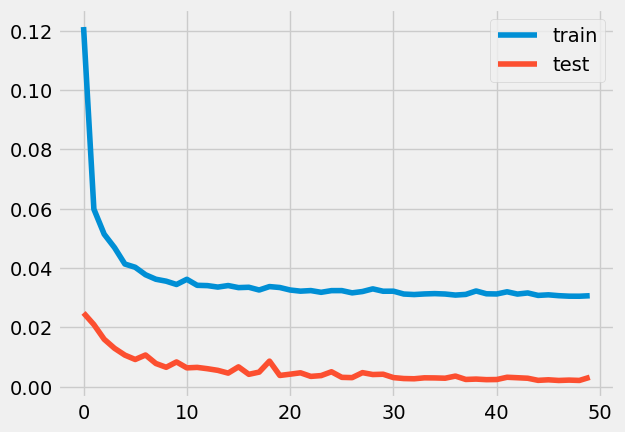

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 72ms/step - loss: 0.0881 - accuracy: 4.2623e-04 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0553 - accuracy: 0.0061 - val_loss: 0.0179 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

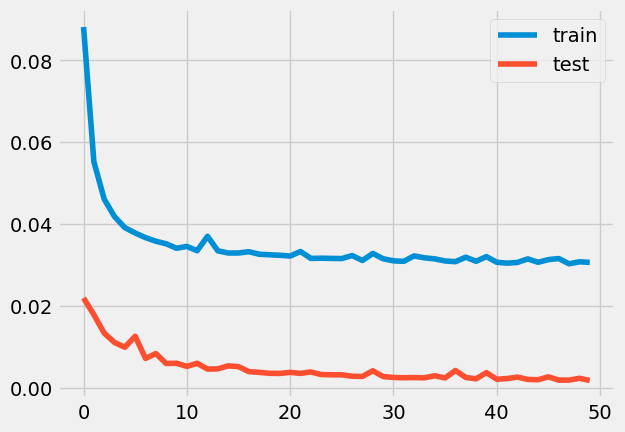

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 76ms/step - loss: 0.1446 - accuracy: 0.0040 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 44ms/step - loss: 0.0602 - accuracy: 0.0051 - val_loss: 0.0197 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

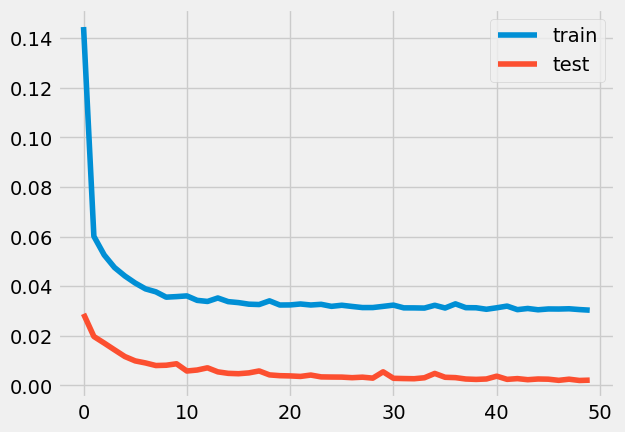

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.0950 - accuracy: 0.0049 - val_loss: 0.0266 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0604 - accuracy: 0.0056 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

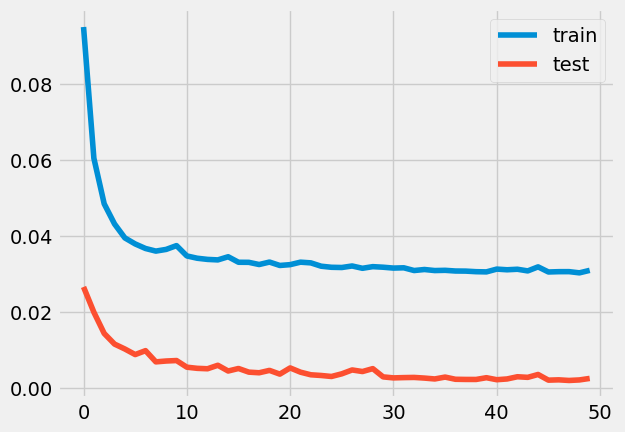

9.382418386403002e-35
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1315 - accuracy: 0.0053 - val_loss: 0.0272 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0612 - accuracy: 0.0050 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoc

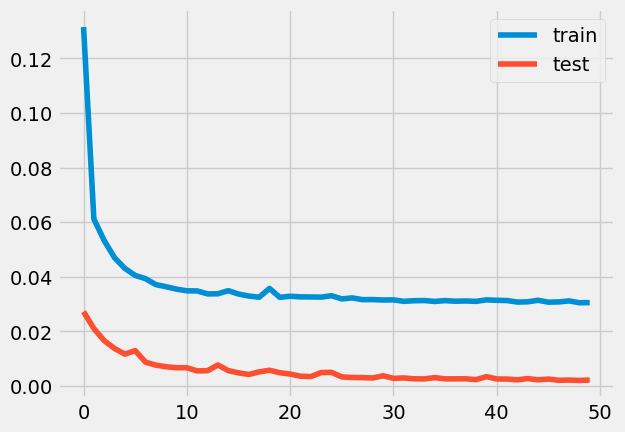

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.0844 - accuracy: 0.0058 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0556 - accuracy: 0.0067 - val_loss: 0.0177 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

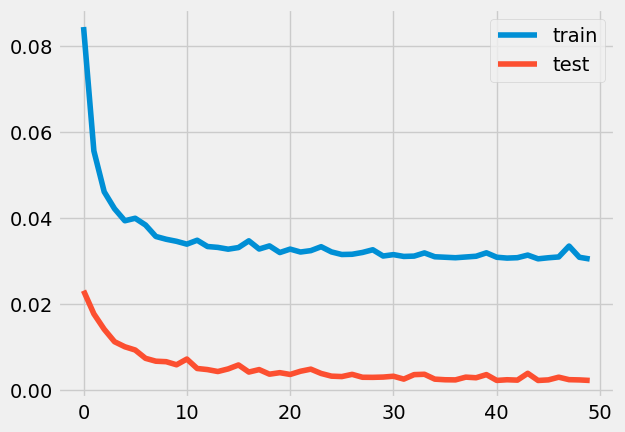

0.0009616597856702229
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1240 - accuracy: 0.0022 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0594 - accuracy: 0.0055 - val_loss: 0.0192 - val_accuracy: 0.0000e+00
Epoc

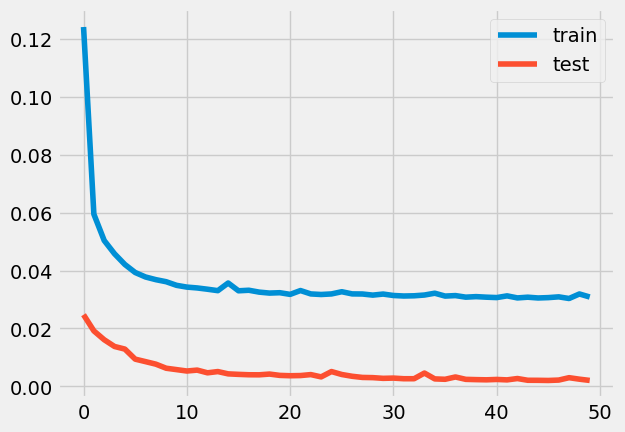

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1344 - accuracy: 0.0047 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0585 - accuracy: 0.0050 - val_loss: 0.0185 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

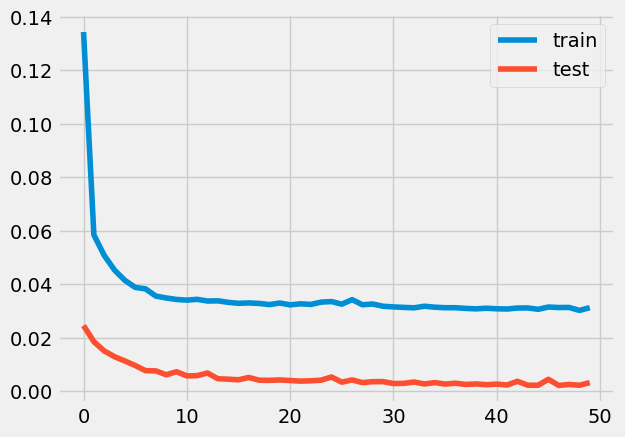

1.1856332333441811e-93
2.44140625e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 71ms/step - loss: 0.1499 - accuracy: 0.0041 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0595 - accuracy: 0.0051 - val_loss: 0.0189 - val_accuracy:

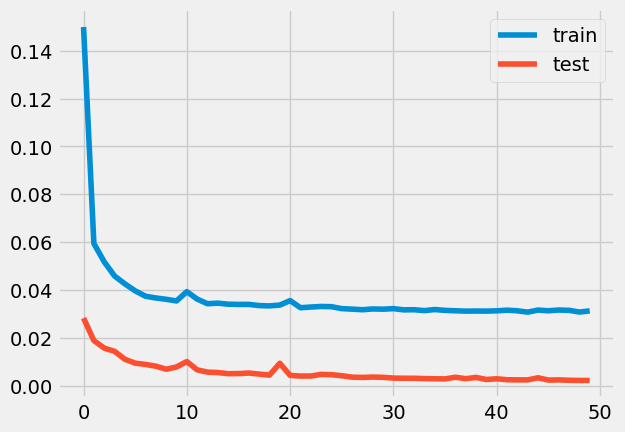

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 71ms/step - loss: 0.1264 - accuracy: 0.0021 - val_loss: 0.0236 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 41ms/step - loss: 0.0626 - accuracy: 0.0043 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

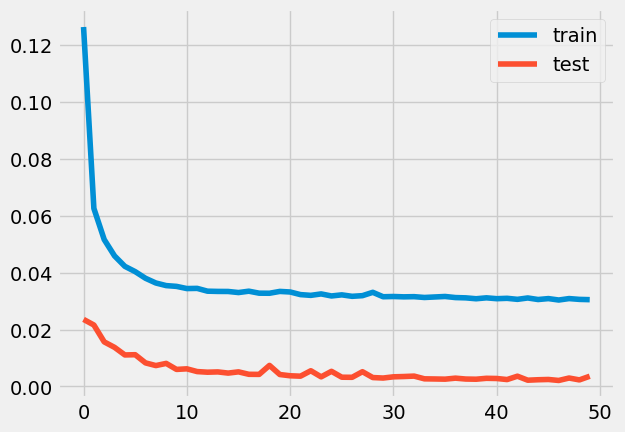

4.322446762908047e-232
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1583 - accuracy: 0.0049 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0574 - accuracy: 0.0049 - val_loss: 0.0177 - val_accuracy: 0.0000e+00
Epo

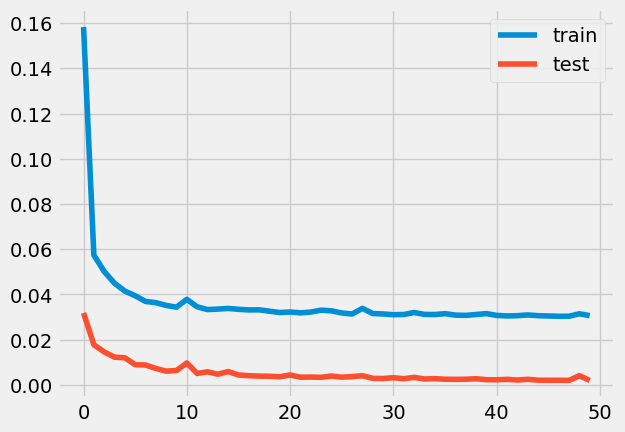

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1447 - accuracy: 0.0023 - val_loss: 0.0273 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0601 - accuracy: 0.0044 - val_loss: 0.0183 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

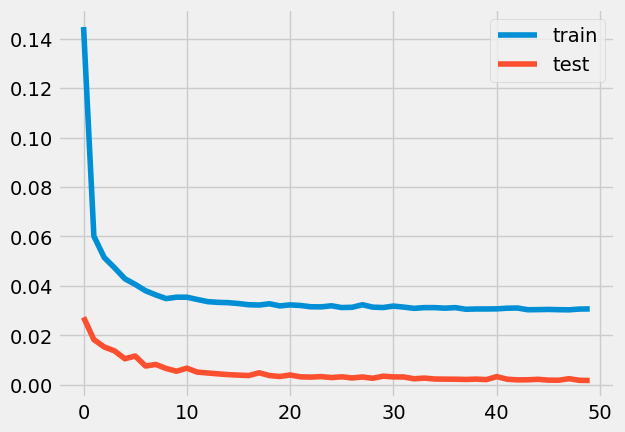

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1382 - accuracy: 0.0048 - val_loss: 0.0291 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0620 - accuracy: 0.0050 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

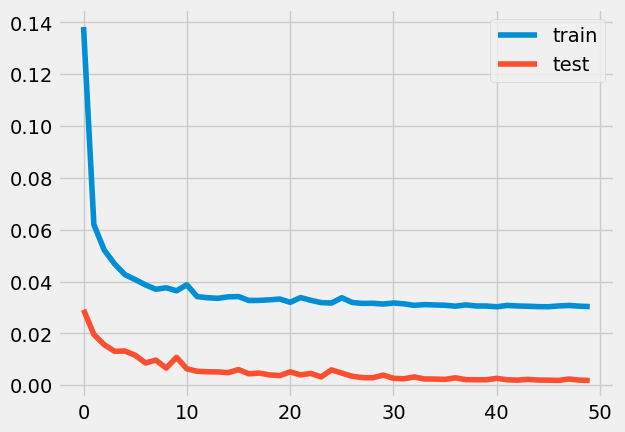

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1174 - accuracy: 0.0054 - val_loss: 0.0240 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0583 - accuracy: 0.0044 - val_loss: 0.0193 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

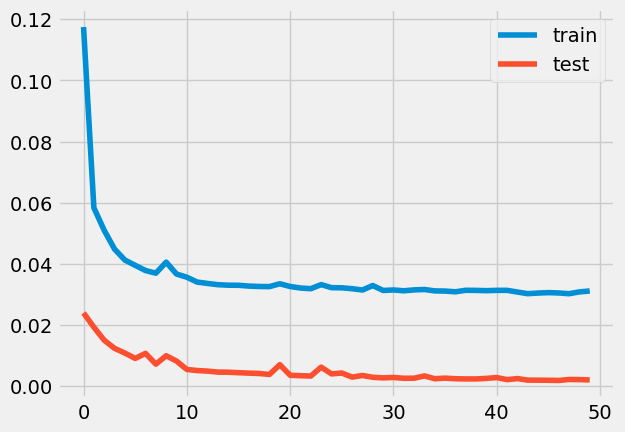

4.538204276670605e-41
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.0924 - accuracy: 0.0055 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0590 - accuracy: 0.0048 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Epoc

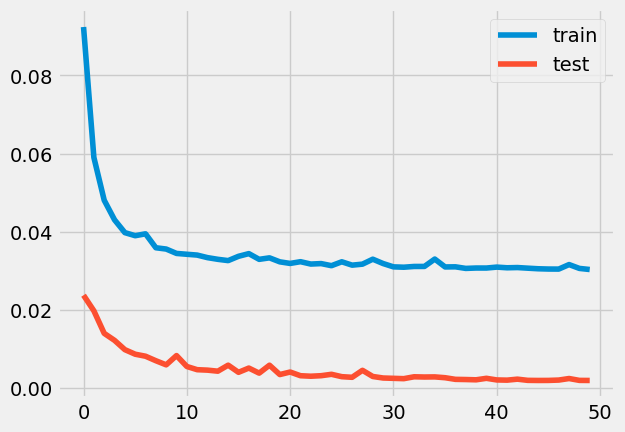

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 69ms/step - loss: 0.1387 - accuracy: 0.0041 - val_loss: 0.0276 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0616 - accuracy: 0.0050 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

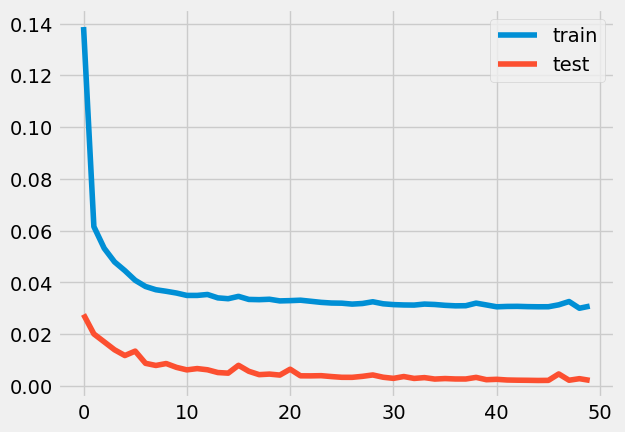

4.253968526454956e-39
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1155 - accuracy: 0.0065 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0605 - accuracy: 0.0047 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoc

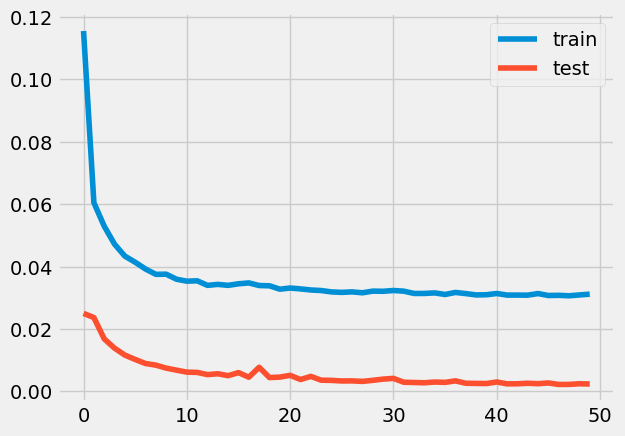

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1610 - accuracy: 0.0049 - val_loss: 0.0335 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0582 - accuracy: 0.0058 - val_loss: 0.0188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

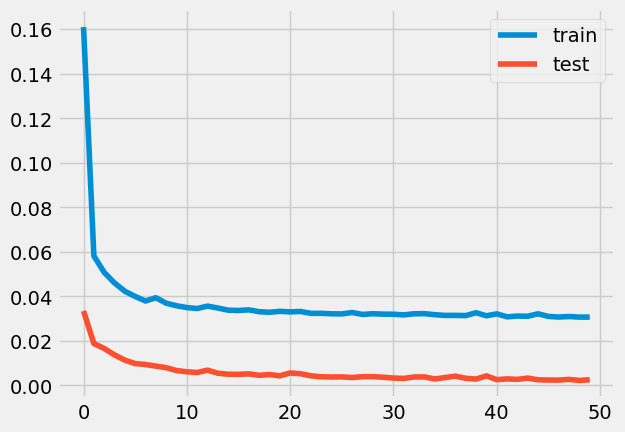

1.8194058140417213e-39
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 65ms/step - loss: 0.1164 - accuracy: 0.0068 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0588 - accuracy: 0.0049 - val_loss: 0.0185 - val_accuracy: 0.0000e+00
Epo

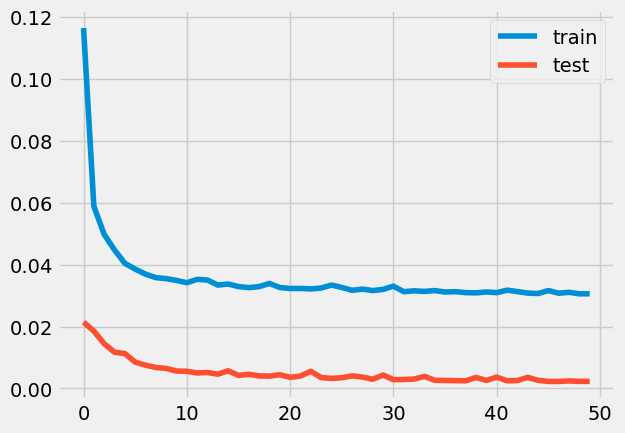

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1038 - accuracy: 0.0063 - val_loss: 0.0222 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0556 - accuracy: 0.0059 - val_loss: 0.0177 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

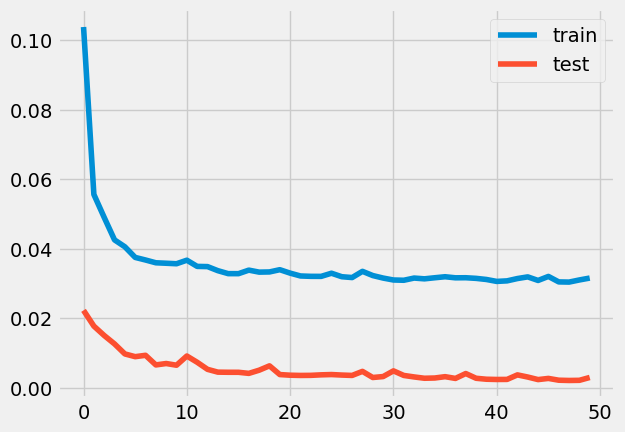

1.0706696909957297e-110
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1039 - accuracy: 0.0015 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0625 - accuracy: 0.0038 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Ep

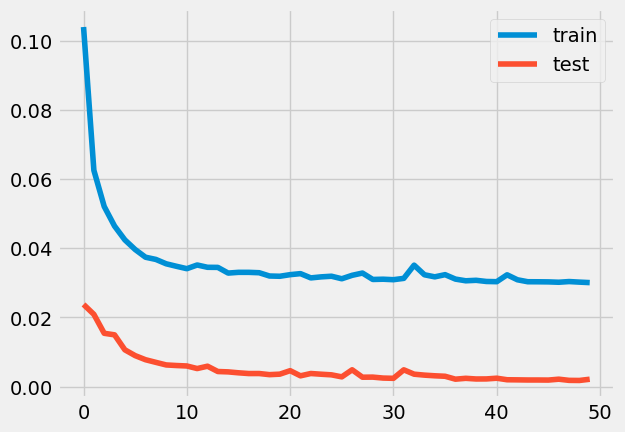

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 68ms/step - loss: 0.1177 - accuracy: 0.0066 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0619 - accuracy: 0.0043 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

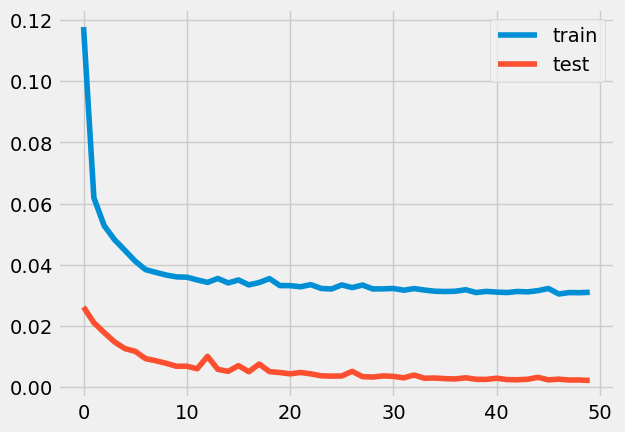

3.645329859474327e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.2027 - accuracy: 8.1967e-05 - val_loss: 0.0469 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0630 - accuracy: 0.0055 - val_loss: 0.0219 - val_accuracy: 0.0000e+00


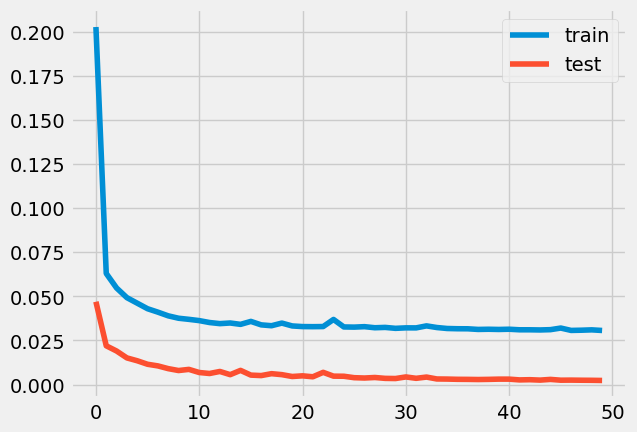

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 70ms/step - loss: 0.1052 - accuracy: 0.0067 - val_loss: 0.0217 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0604 - accuracy: 0.0050 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

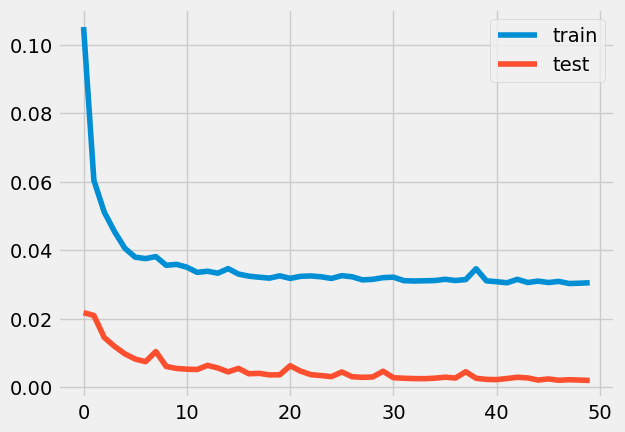

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 72ms/step - loss: 0.1185 - accuracy: 0.0035 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 40ms/step - loss: 0.0631 - accuracy: 0.0055 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

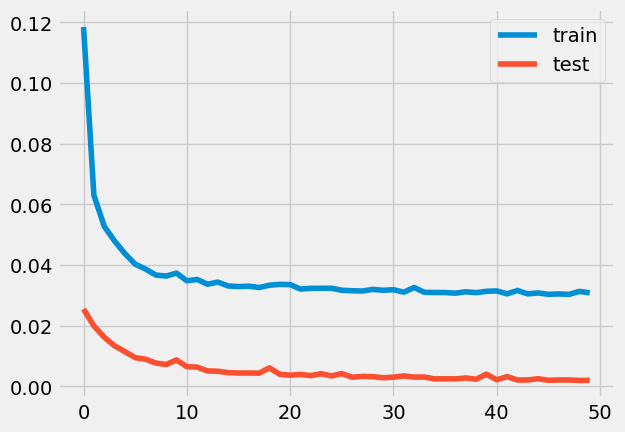

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1147 - accuracy: 0.0065 - val_loss: 0.0231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 39ms/step - loss: 0.0588 - accuracy: 0.0044 - val_loss: 0.0179 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

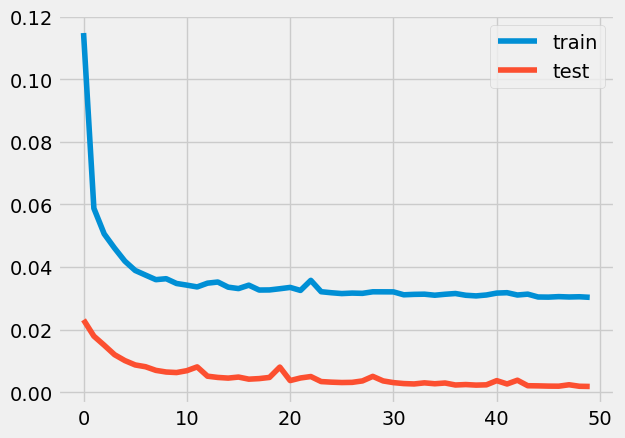

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1240 - accuracy: 0.0053 - val_loss: 0.0246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0601 - accuracy: 0.0052 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

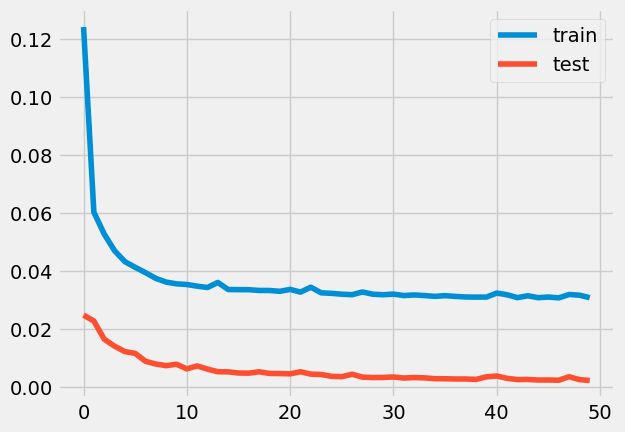

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 68ms/step - loss: 0.1052 - accuracy: 0.0063 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0579 - accuracy: 0.0064 - val_loss: 0.0179 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

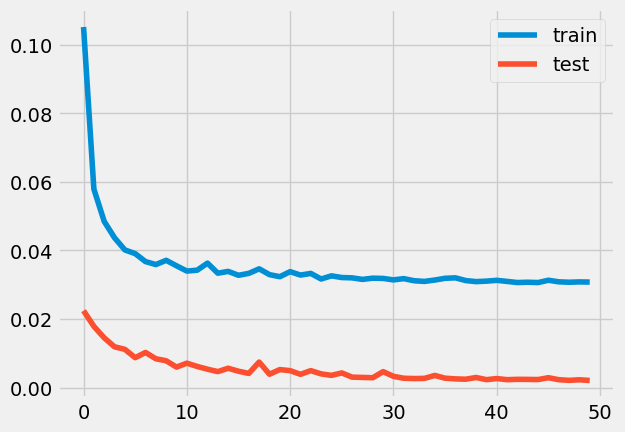

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1615 - accuracy: 0.0024 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0619 - accuracy: 0.0034 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

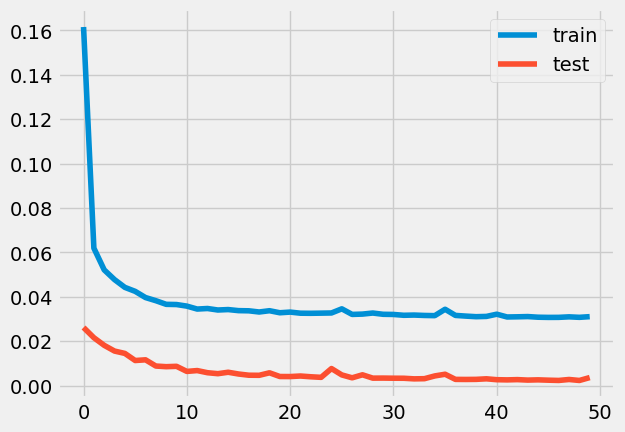

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1099 - accuracy: 0.0033 - val_loss: 0.0274 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0654 - accuracy: 0.0051 - val_loss: 0.0248 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

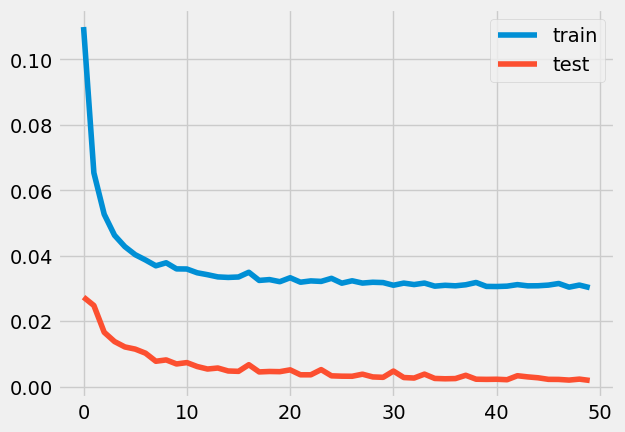

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 66ms/step - loss: 0.1475 - accuracy: 0.0025 - val_loss: 0.0273 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0640 - accuracy: 0.0037 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

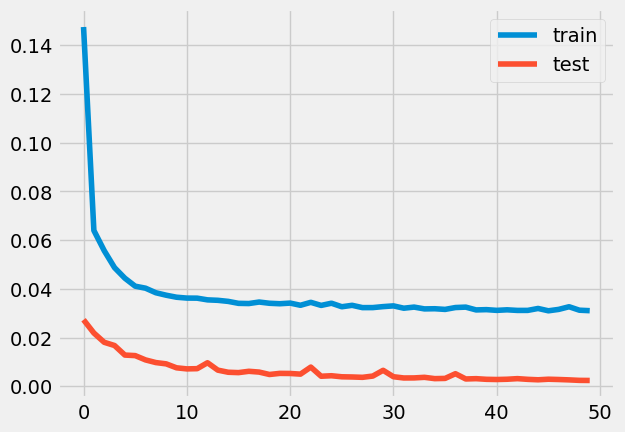

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.0857 - accuracy: 0.0032 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0585 - accuracy: 0.0063 - val_loss: 0.0185 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

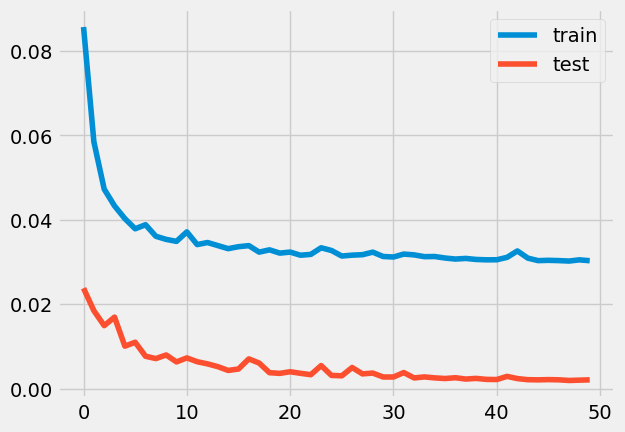

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1049 - accuracy: 0.0044 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0619 - accuracy: 0.0036 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

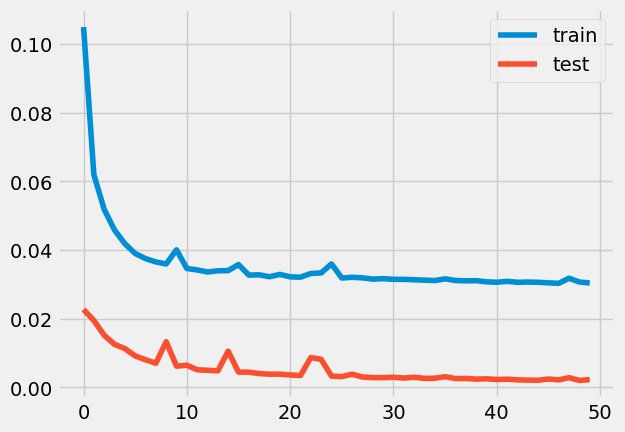

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 66ms/step - loss: 0.1890 - accuracy: 0.0015 - val_loss: 0.0600 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0691 - accuracy: 0.0050 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

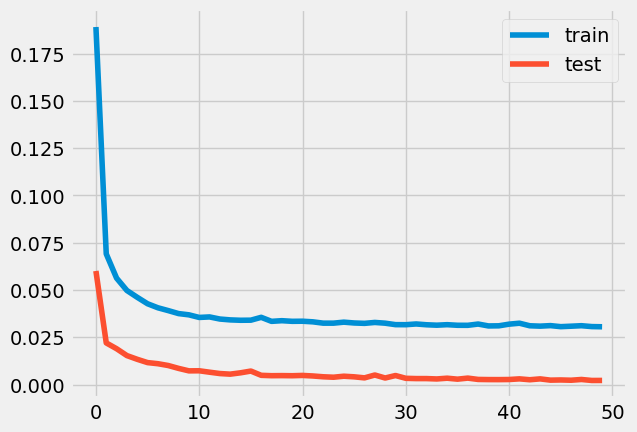

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.0983 - accuracy: 0.0036 - val_loss: 0.0232 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0603 - accuracy: 0.0057 - val_loss: 0.0195 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

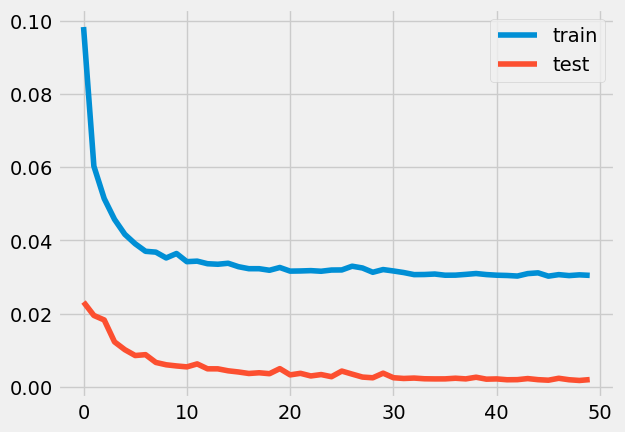

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 60ms/step - loss: 0.1761 - accuracy: 0.0036 - val_loss: 0.0447 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0617 - accuracy: 0.0056 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

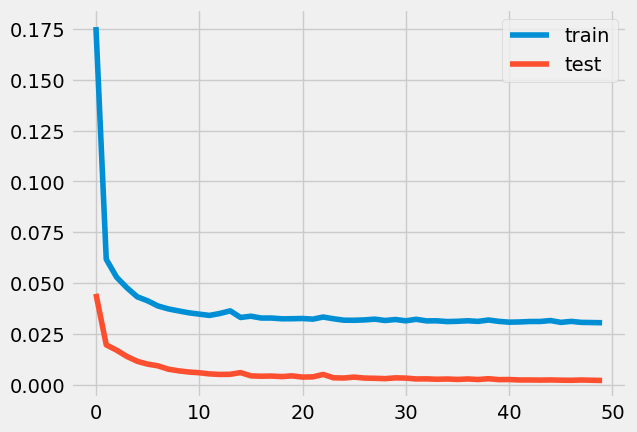

3.9263744547550115e-10
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 60ms/step - loss: 0.1119 - accuracy: 0.0039 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0628 - accuracy: 0.0041 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epo

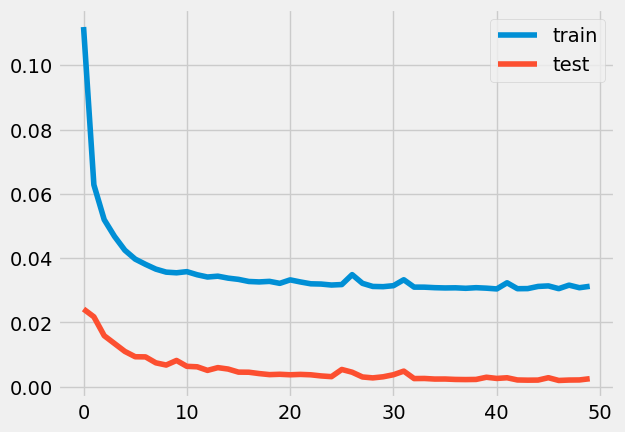

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1297 - accuracy: 0.0061 - val_loss: 0.0296 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0591 - accuracy: 0.0050 - val_loss: 0.0187 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

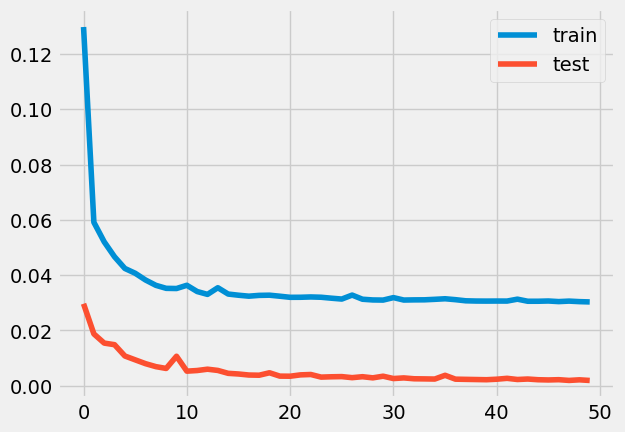

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 61ms/step - loss: 0.1265 - accuracy: 0.0043 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0586 - accuracy: 0.0066 - val_loss: 0.0212 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

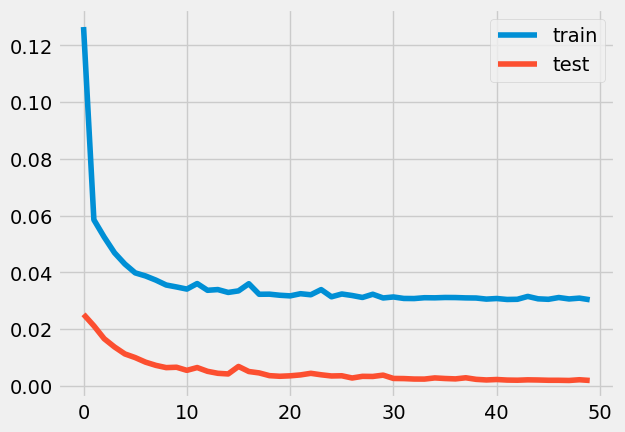

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 62ms/step - loss: 0.0989 - accuracy: 0.0051 - val_loss: 0.0234 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0596 - accuracy: 0.0052 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

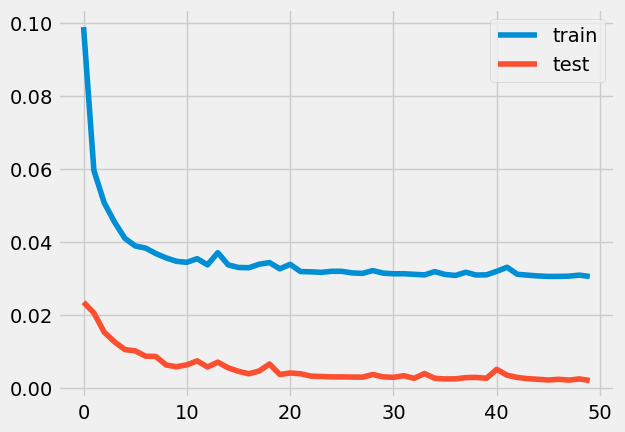

1.2598744694213341e-08
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1028 - accuracy: 0.0057 - val_loss: 0.0244 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0621 - accuracy: 0.0052 - val_loss: 0.0214 - val_accuracy: 0.0000e+00
Epo

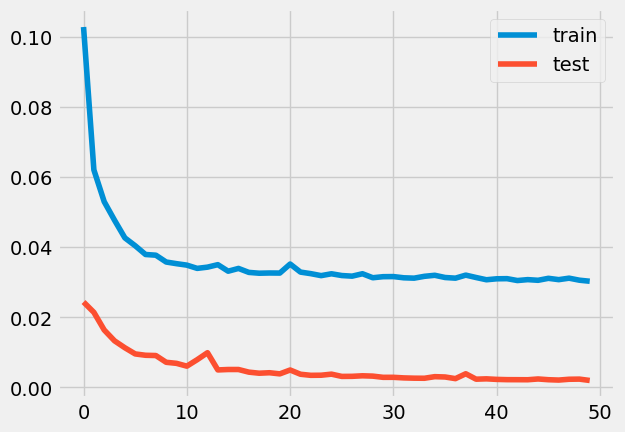

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.0872 - accuracy: 0.0064 - val_loss: 0.0247 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0599 - accuracy: 0.0052 - val_loss: 0.0189 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

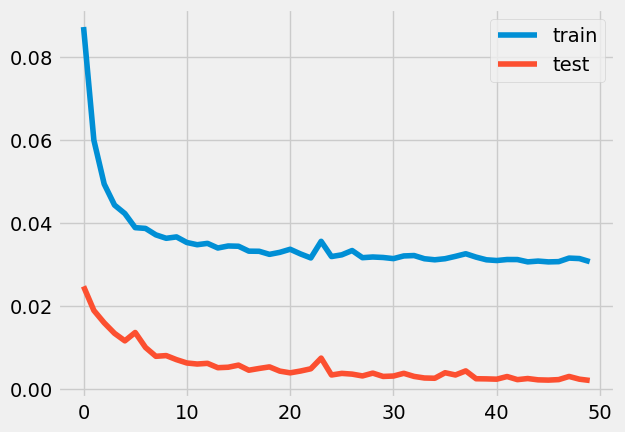

1.811314145234401e-20
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 67ms/step - loss: 0.1226 - accuracy: 0.0059 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0598 - accuracy: 0.0060 - val_loss: 0.0196 - val_accuracy: 0.0000e+00
Epoc

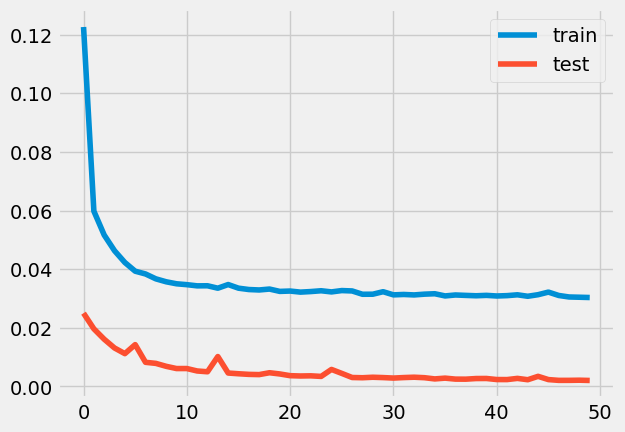

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1518 - accuracy: 0.0042 - val_loss: 0.0332 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0640 - accuracy: 0.0046 - val_loss: 0.0215 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

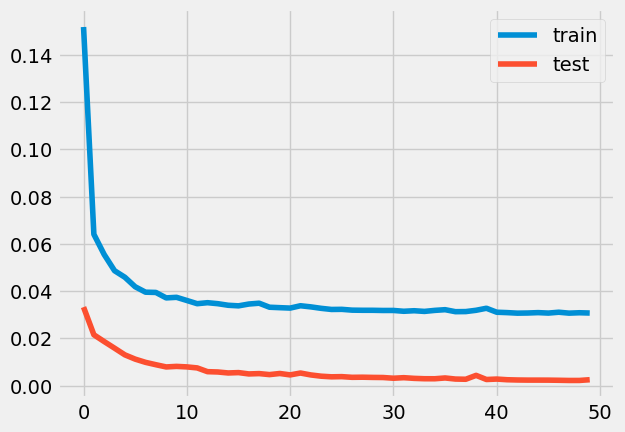

9.939383140005835e-75
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.0815 - accuracy: 0.0053 - val_loss: 0.0233 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0557 - accuracy: 0.0060 - val_loss: 0.0201 - val_accuracy: 0.0000e+00
Epoc

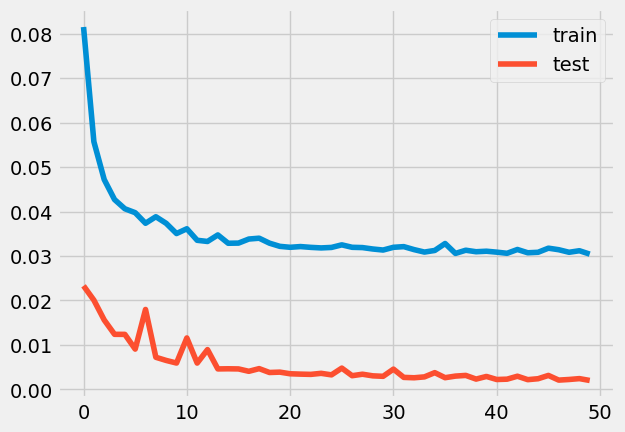

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 66ms/step - loss: 0.1206 - accuracy: 0.0046 - val_loss: 0.0250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0619 - accuracy: 0.0040 - val_loss: 0.0260 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

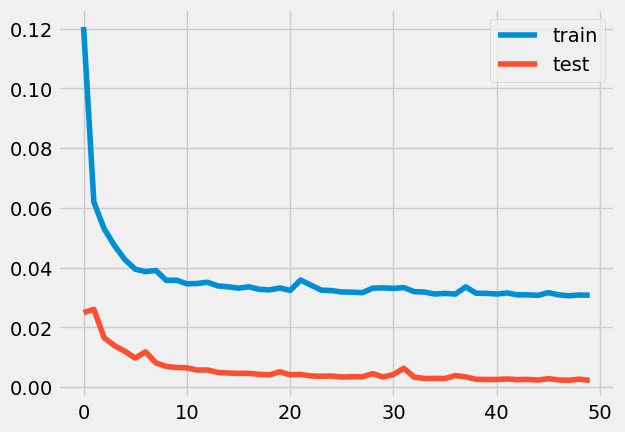

1.2498464116780542e-41
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1056 - accuracy: 0.0053 - val_loss: 0.0256 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0623 - accuracy: 0.0058 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epo

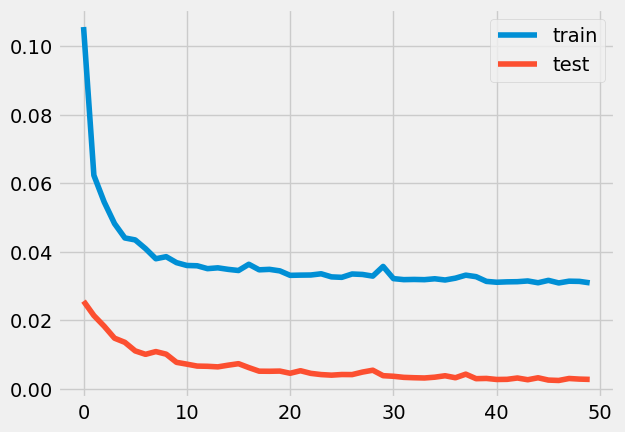

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1315 - accuracy: 0.0047 - val_loss: 0.0277 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0643 - accuracy: 0.0053 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

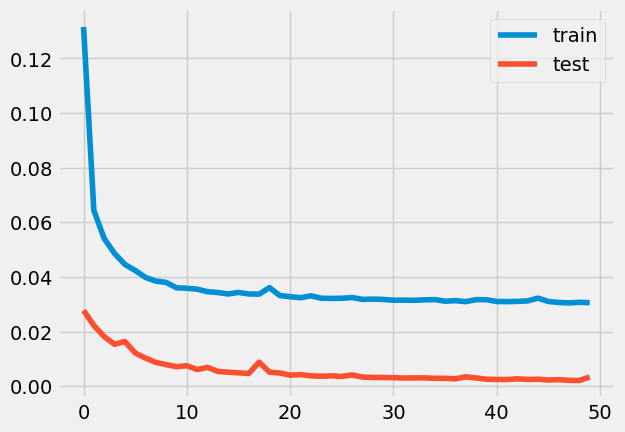

7.070590786923248e-120
1.220703125e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 59ms/step - loss: 0.0942 - accuracy: 0.0032 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0615 - accuracy: 0.0037 - val_loss: 0.0201 - val_accuracy

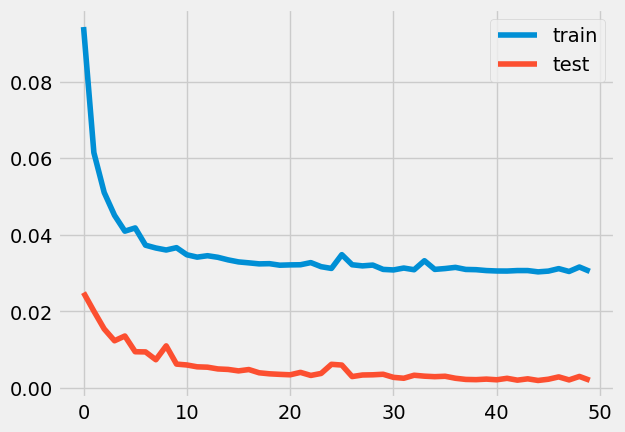

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1130 - accuracy: 0.0036 - val_loss: 0.0243 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0622 - accuracy: 0.0047 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

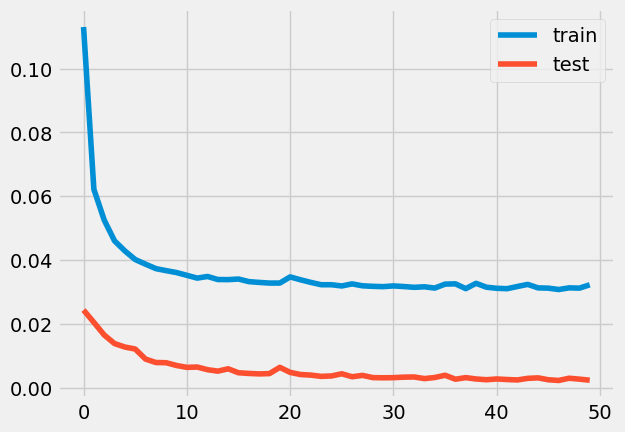

3.488992155234826e-116
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1033 - accuracy: 0.0064 - val_loss: 0.0239 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0617 - accuracy: 0.0047 - val_loss: 0.0218 - val_accuracy: 0.0000e+00
Epo

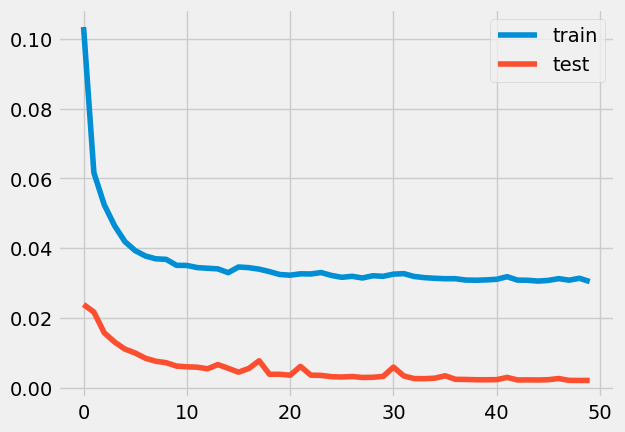

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 66ms/step - loss: 0.1234 - accuracy: 0.0042 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0641 - accuracy: 0.0043 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

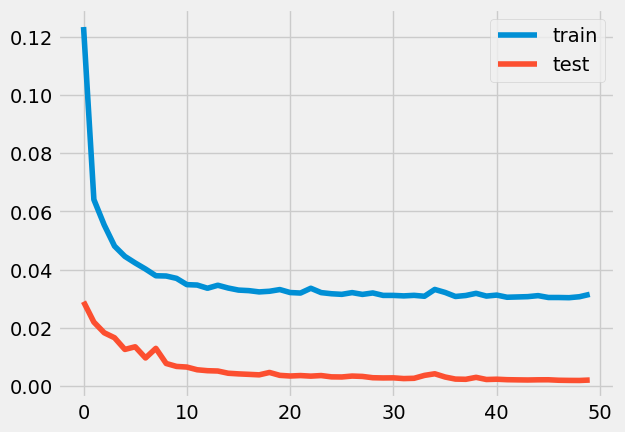

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1180 - accuracy: 0.0020 - val_loss: 0.0249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0599 - accuracy: 0.0056 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

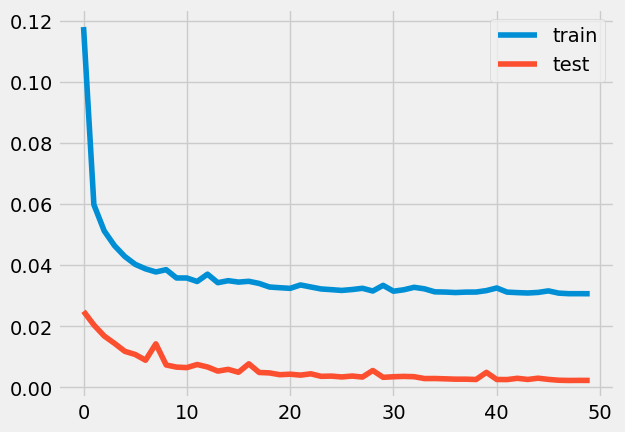

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.0989 - accuracy: 0.0063 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0594 - accuracy: 0.0049 - val_loss: 0.0205 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

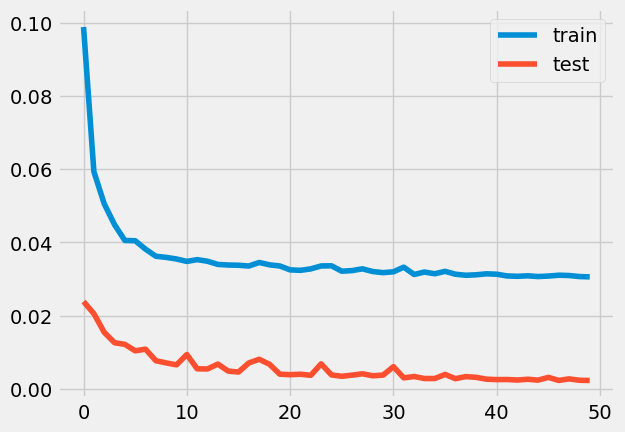

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 63ms/step - loss: 0.2508 - accuracy: 0.0020 - val_loss: 0.0528 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0624 - accuracy: 0.0056 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

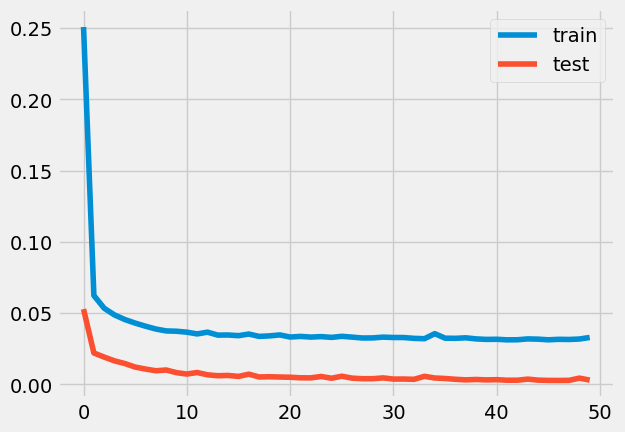

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1333 - accuracy: 0.0056 - val_loss: 0.0323 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0598 - accuracy: 0.0052 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

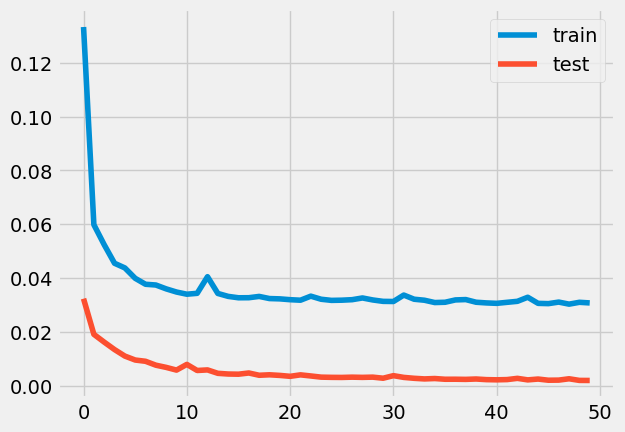

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1006 - accuracy: 0.0052 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0609 - accuracy: 0.0055 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

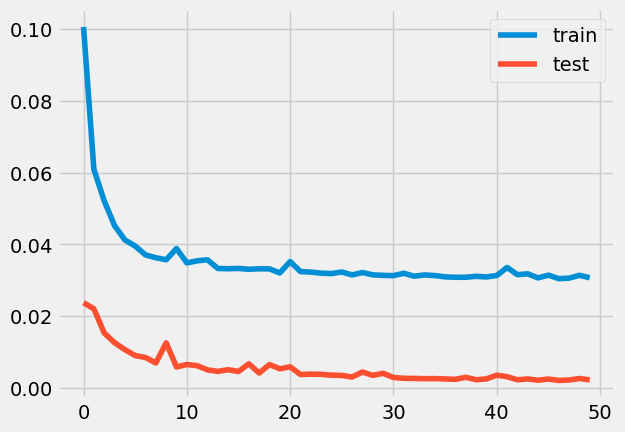

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 67ms/step - loss: 0.1178 - accuracy: 0.0043 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0624 - accuracy: 0.0051 - val_loss: 0.0206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

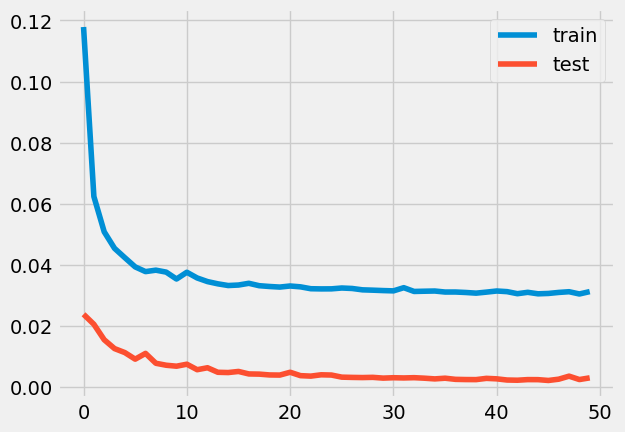

3.7250099836952213e-258
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.0980 - accuracy: 0.0044 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0588 - accuracy: 0.0072 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Ep

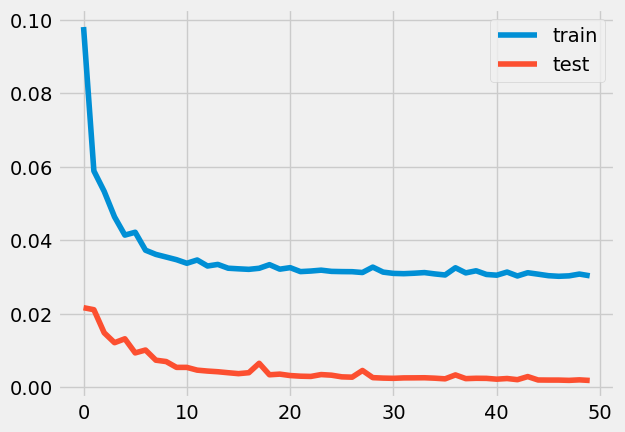

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.1426 - accuracy: 0.0018 - val_loss: 0.0361 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 32ms/step - loss: 0.0638 - accuracy: 0.0046 - val_loss: 0.0194 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

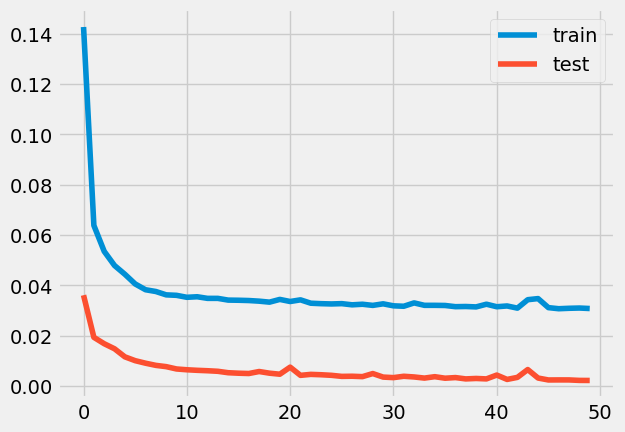

6.272975355570852e-179
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1053 - accuracy: 0.0047 - val_loss: 0.0258 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0622 - accuracy: 0.0047 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Epo

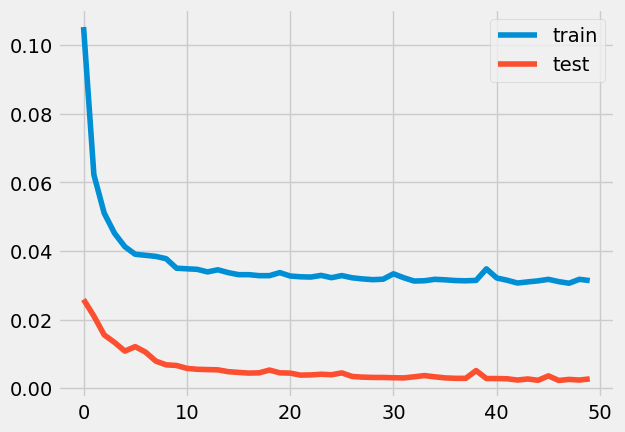

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1238 - accuracy: 0.0021 - val_loss: 0.0248 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0635 - accuracy: 0.0051 - val_loss: 0.0213 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

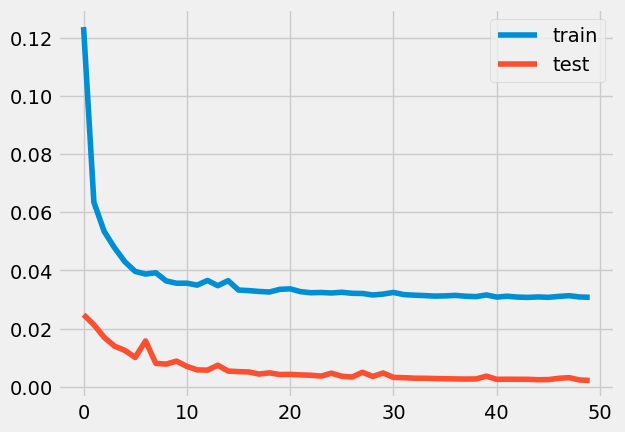

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1695 - accuracy: 0.0028 - val_loss: 0.0402 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0665 - accuracy: 0.0041 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

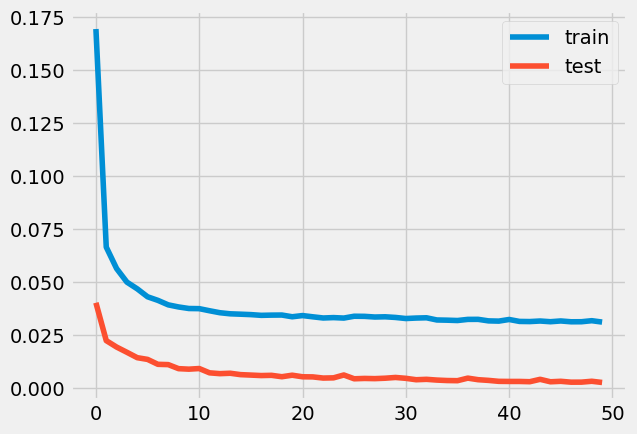

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 62ms/step - loss: 0.1090 - accuracy: 0.0021 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0612 - accuracy: 0.0061 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

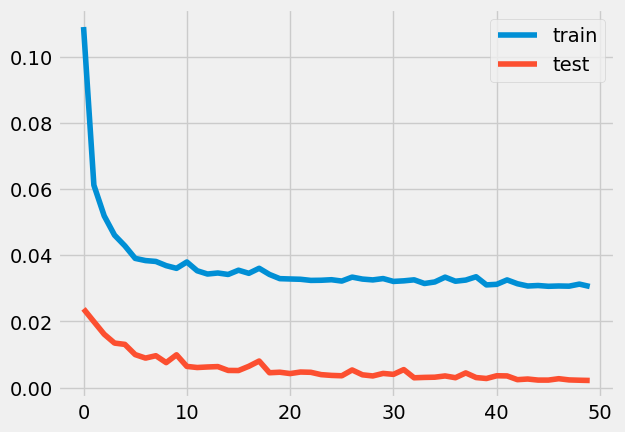

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 59ms/step - loss: 0.1360 - accuracy: 0.0065 - val_loss: 0.0257 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0625 - accuracy: 0.0045 - val_loss: 0.0204 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

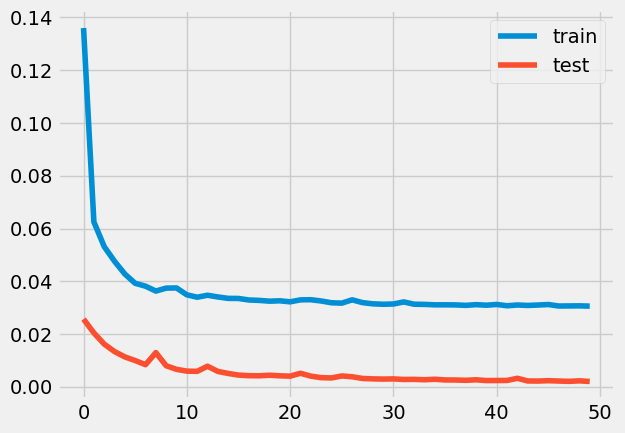

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.0990 - accuracy: 0.0033 - val_loss: 0.0270 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0622 - accuracy: 0.0045 - val_loss: 0.0226 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

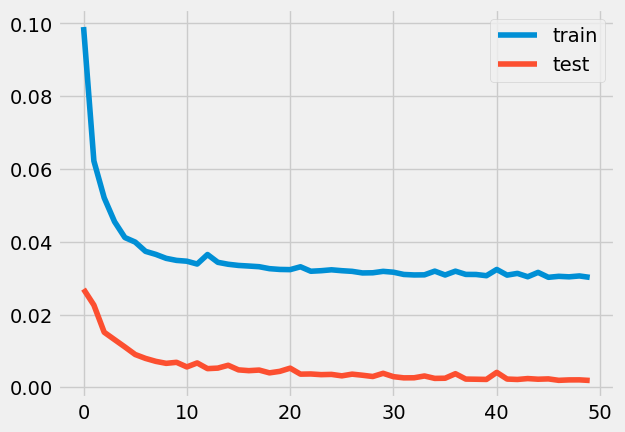

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 67ms/step - loss: 0.1132 - accuracy: 0.0035 - val_loss: 0.0265 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 38ms/step - loss: 0.0612 - accuracy: 0.0056 - val_loss: 0.0245 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

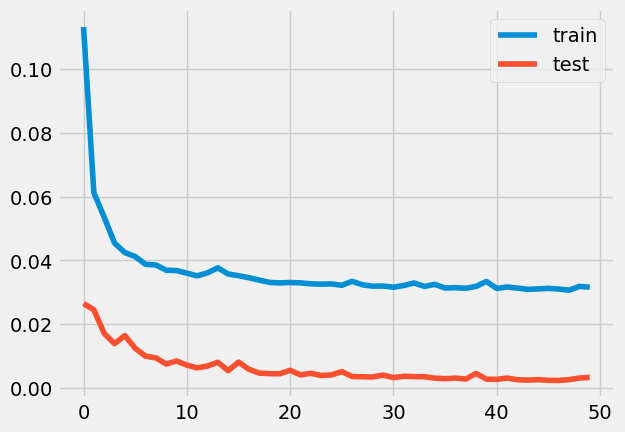

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 64ms/step - loss: 0.1166 - accuracy: 0.0059 - val_loss: 0.0242 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0605 - accuracy: 0.0039 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

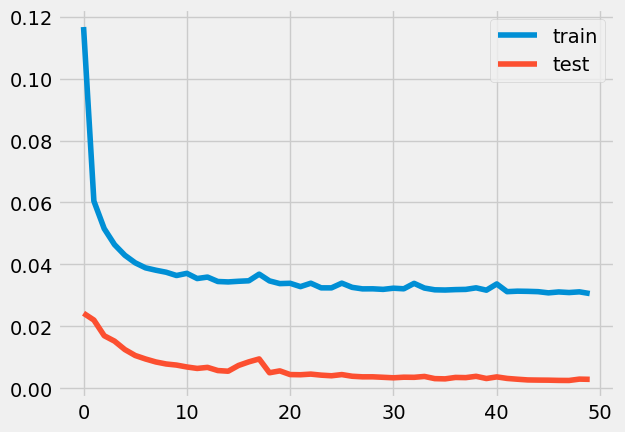

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1479 - accuracy: 0.0054 - val_loss: 0.0309 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0630 - accuracy: 0.0038 - val_loss: 0.0219 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

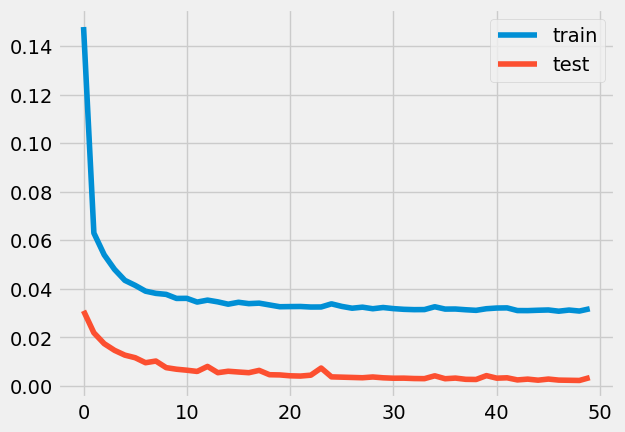

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 68ms/step - loss: 0.0802 - accuracy: 0.0058 - val_loss: 0.0221 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0562 - accuracy: 0.0053 - val_loss: 0.0171 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

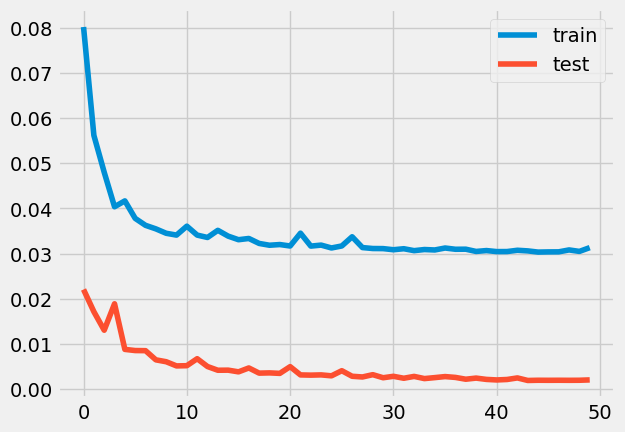

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 59ms/step - loss: 0.1045 - accuracy: 0.0057 - val_loss: 0.0252 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0613 - accuracy: 0.0055 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

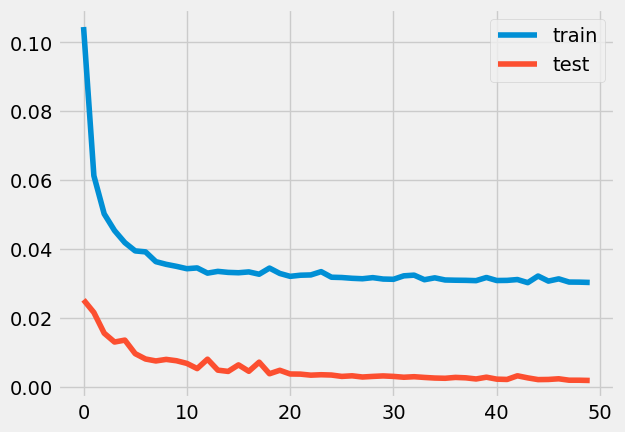

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 65ms/step - loss: 0.1664 - accuracy: 0.0032 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 33ms/step - loss: 0.0594 - accuracy: 0.0042 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

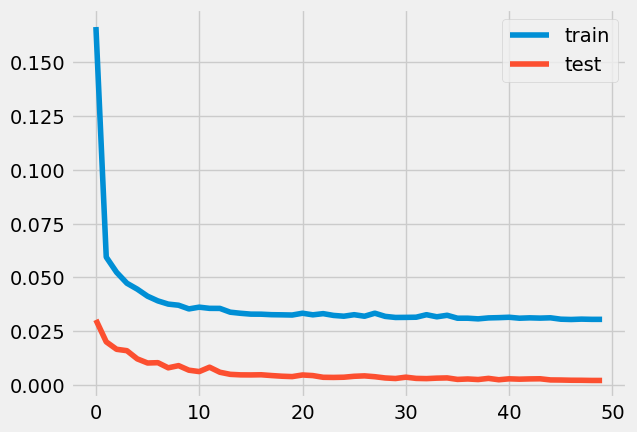

6.903950597913124e-69
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 65ms/step - loss: 0.1672 - accuracy: 0.0000e+00 - val_loss: 0.0324 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0604 - accuracy: 0.0071 - val_loss: 0.0208 - val_accuracy: 0.0000e+00


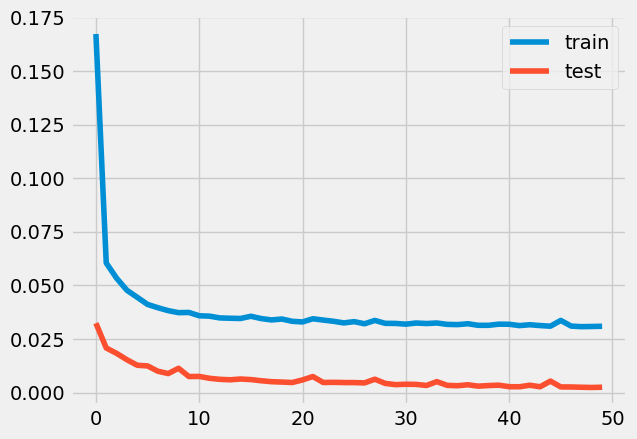

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.0981 - accuracy: 0.0061 - val_loss: 0.0220 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0582 - accuracy: 0.0061 - val_loss: 0.0179 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

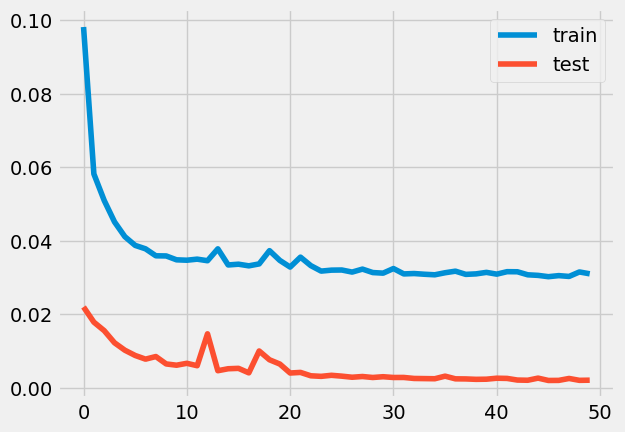

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1280 - accuracy: 4.4877e-04 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0603 - accuracy: 0.0062 - val_loss: 0.0190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

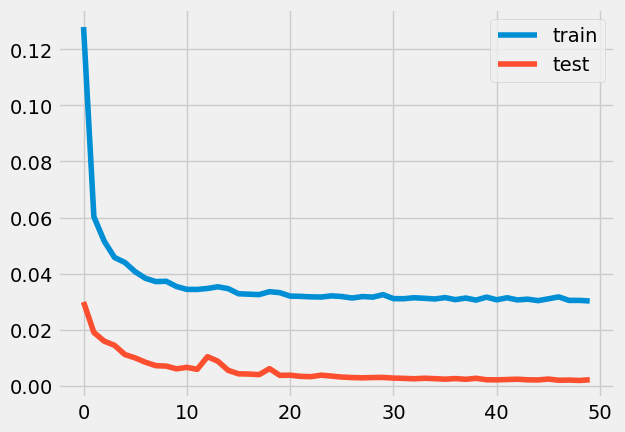

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 68ms/step - loss: 0.1179 - accuracy: 0.0065 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0586 - accuracy: 0.0051 - val_loss: 0.0184 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

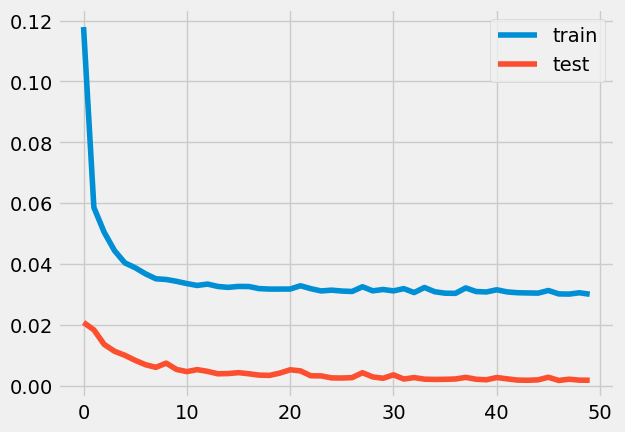

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 68ms/step - loss: 0.1779 - accuracy: 0.0019 - val_loss: 0.0454 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0588 - accuracy: 0.0056 - val_loss: 0.0181 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

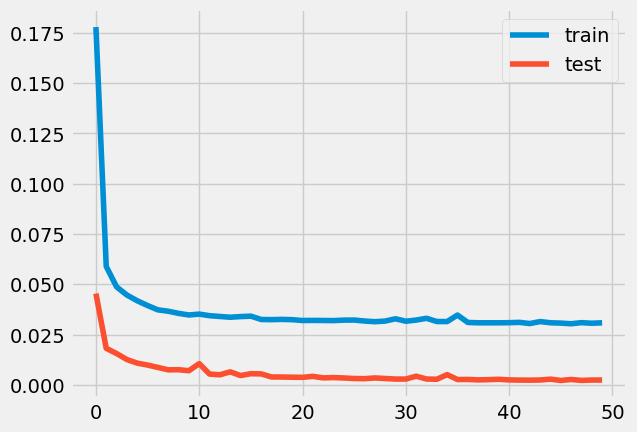

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1239 - accuracy: 0.0038 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0649 - accuracy: 0.0037 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

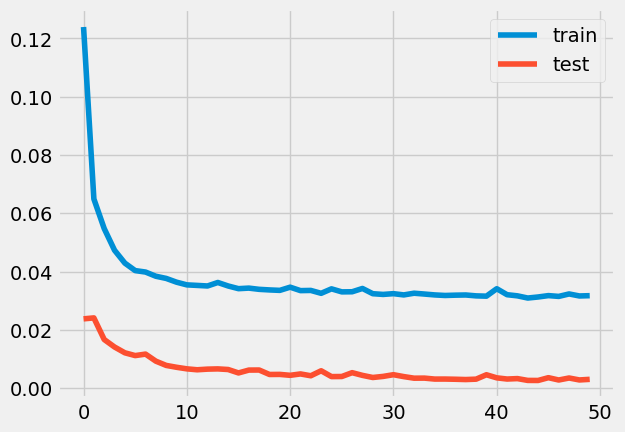

4.9927020312879923e-228
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 64ms/step - loss: 0.1139 - accuracy: 0.0056 - val_loss: 0.0241 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 37ms/step - loss: 0.0614 - accuracy: 0.0042 - val_loss: 0.0210 - val_accuracy: 0.0000e+00
Ep

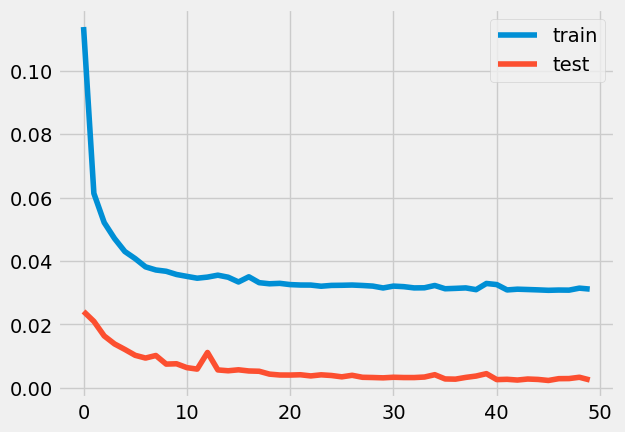

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 61ms/step - loss: 0.1285 - accuracy: 0.0036 - val_loss: 0.0254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0650 - accuracy: 0.0045 - val_loss: 0.0199 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

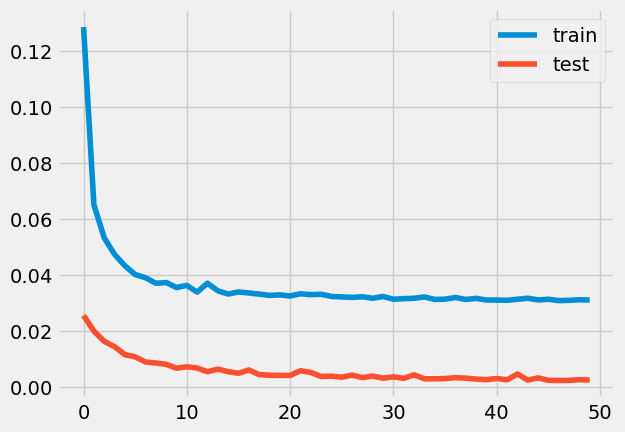

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1173 - accuracy: 0.0040 - val_loss: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0622 - accuracy: 0.0048 - val_loss: 0.0224 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

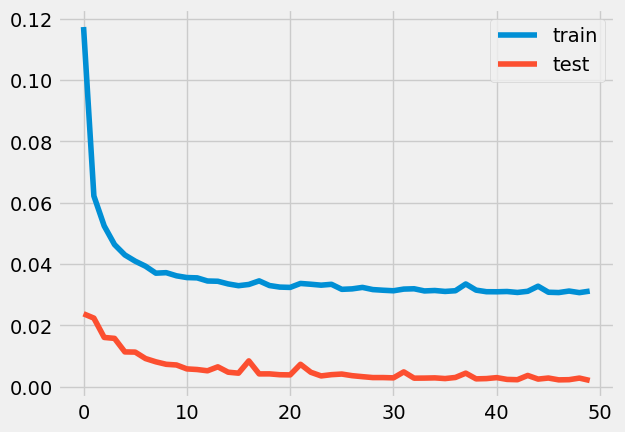

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 67ms/step - loss: 0.1427 - accuracy: 0.0020 - val_loss: 0.0291 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0600 - accuracy: 0.0060 - val_loss: 0.0200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

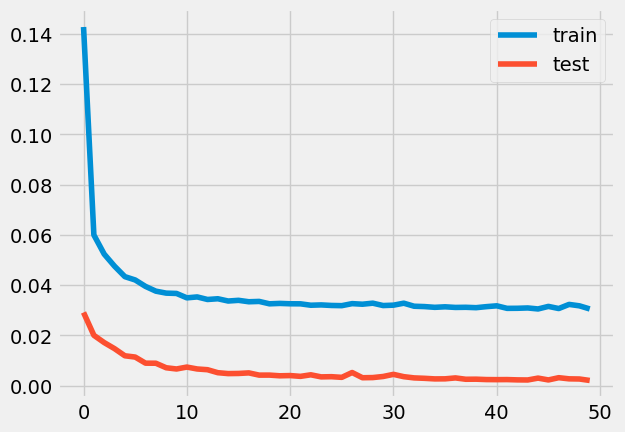

0.08093764521642217
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1184 - accuracy: 0.0023 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0634 - accuracy: 0.0047 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 

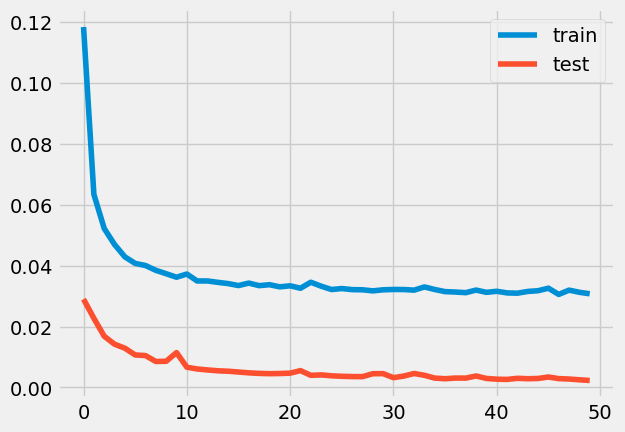

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1257 - accuracy: 0.0034 - val_loss: 0.0253 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0617 - accuracy: 0.0048 - val_loss: 0.0211 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

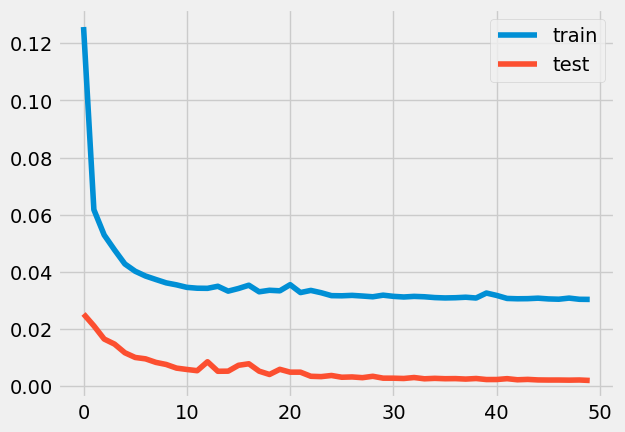

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 66ms/step - loss: 0.1248 - accuracy: 0.0016 - val_loss: 0.0257 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0640 - accuracy: 0.0045 - val_loss: 0.0216 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

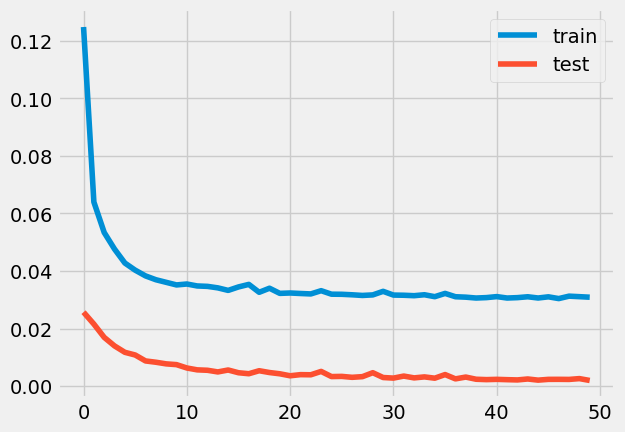

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 62ms/step - loss: 0.0914 - accuracy: 0.0035 - val_loss: 0.0237 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 36ms/step - loss: 0.0588 - accuracy: 0.0052 - val_loss: 0.0189 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

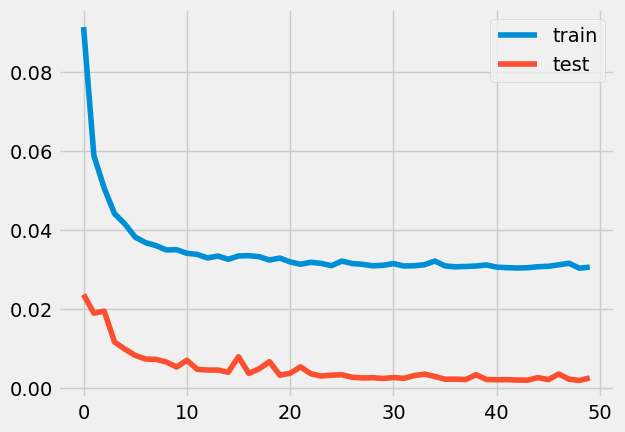

3.6745464475420815e-210
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 63ms/step - loss: 0.1247 - accuracy: 0.0019 - val_loss: 0.0227 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 34ms/step - loss: 0.0599 - accuracy: 0.0054 - val_loss: 0.0198 - val_accuracy: 0.0000e+00
Ep

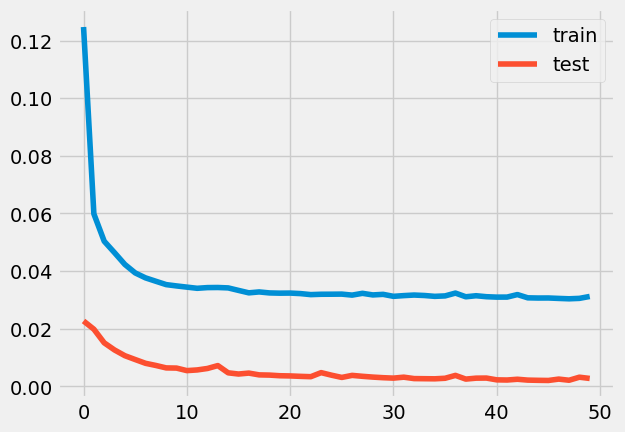

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 61ms/step - loss: 0.1060 - accuracy: 0.0062 - val_loss: 0.0262 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0638 - accuracy: 0.0058 - val_loss: 0.0209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

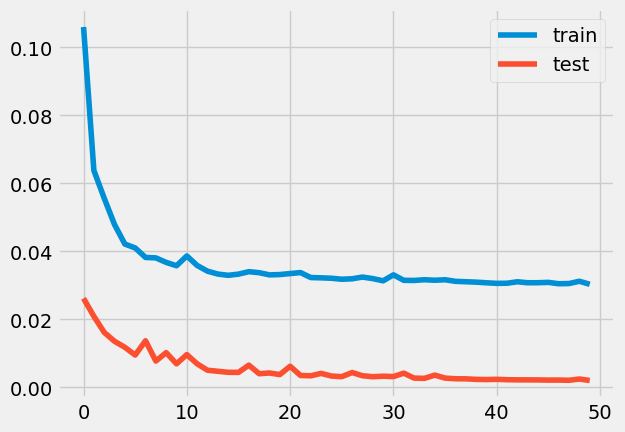

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 69ms/step - loss: 0.1156 - accuracy: 0.0044 - val_loss: 0.0253 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 35ms/step - loss: 0.0632 - accuracy: 0.0056 - val_loss: 0.0223 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

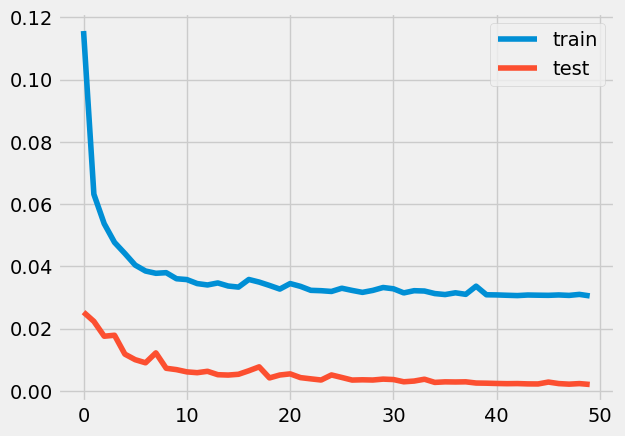

0.0007007754058308959 0.002064084867015481
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 2

In [14]:
T =0.01 # initiate temperature
Tmin =0.000001 # minimum value of terperature
x = np.random.uniform(low=1e-4, high=0.001)  # initiate x
k = 20  # times of internal circulation
y = 0  # initiate result
t = 0  # time

history = {'y': [], 'iteration': [], 'x': []}

while T >= Tmin:
    print(T)
    for i in range(k):
        history["iteration"].append(t)
        # calculate y
        y = fitness(x)
        history["y"].append(y)
        # generate a new x in the neighboorhood of x by transform function
        xNew = np.abs(x + np.random.uniform(low=-0.00005, high=0.00005))
        if (1e-6 <= xNew and xNew <= 0.001):
            yNew = fitness(xNew)
            if yNew - y < 0:
                x = xNew
                history["x"].append(x)
            else:
                # metropolis principle
                p = math.exp(-(yNew - y) / T)
                print(p)
                r = np.random.uniform(low=0, high=1)
                if r < p:
                    x = xNew
        t += 1
    T = 0.5*T  

print(x,fitness(x))  

print(history["iteration"])
print(history["y"])
print(history["x"])



In [15]:
history

{'y': [0.002676586853340268,
  0.00258602574467659,
  0.0018184214131906629,
  0.0020103100687265396,
  0.002286431612446904,
  0.002857312560081482,
  0.002181336982175708,
  0.0032641843426972628,
  0.002663267543539405,
  0.0020502812694758177,
  0.0019259980181232095,
  0.002225938020274043,
  0.002758326008915901,
  0.002151697874069214,
  0.002036629943177104,
  0.0027965903282165527,
  0.0021326164714992046,
  0.002274663420394063,
  0.002069046488031745,
  0.0026081802789121866,
  0.0024349819868803024,
  0.002536956686526537,
  0.0023054429329931736,
  0.002906746231019497,
  0.002501342911273241,
  0.002168001141399145,
  0.0025752566289156675,
  0.0029373455327004194,
  0.0022663539275527,
  0.0019012716365978122,
  0.0023640135768800974,
  0.0026743917260318995,
  0.0026500187814235687,
  0.002480651717633009,
  0.00324453879147768,
  0.0023162146098911762,
  0.0024697554763406515,
  0.002284928224980831,
  0.003626599907875061,
  0.002015281468629837,
  0.00218629511073231

In [20]:
output = pd.DataFrame(history['y'],history['iteration'])
output.to_csv('SA.csv', index = None, encoding = "utf-8_sig", header = None)

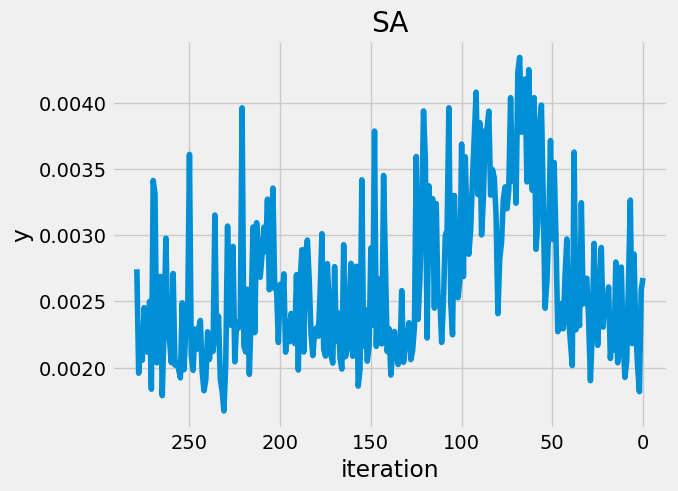

In [16]:
plt.plot(history['iteration'], history['y'])
plt.title('SA')
plt.xlabel('iteration')
plt.ylabel('y')
plt.gca().invert_xaxis()
plt.show()